<a href="https://colab.research.google.com/github/Leina400/Academic-Project/blob/main/ComputerVision/Section1/Copie_de_1_cd_CNNs.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<center><h1>1-cd: Convolutional Neural Networks (ConvNets)</h1></center>

<center><h2><a href="https://rdfia.github.io/">Course link</a></h2></center>

# Warning :
# Do "File -> Save a copy in Drive" before you start modifying the notebook, otherwise your modifications will not be saved.


In [ ]:
#!git clone https://github.com/cdancette/deep-learning-polytech-tp6-7.git
! wget https://github.com/rdfia/rdfia.github.io/raw/master/code/2-cd/utils.py

--2025-10-24 17:43:47--  https://github.com/rdfia/rdfia.github.io/raw/master/code/2-cd/utils.py
Resolving github.com (github.com)... 140.82.112.3
Connecting to github.com (github.com)|140.82.112.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/code/2-cd/utils.py [following]
--2025-10-24 17:43:47--  https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/code/2-cd/utils.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2627 (2.6K) [text/plain]
Saving to: ‘utils.py’

utils.py            100%[===================>]   2.57K  --.-KB/s    in 0s      

2025-10-24 17:43:47 (51.1 MB/s) - ‘utils.py’ saved [2627/2627]



In [ ]:
%run 'utils.py'

In [ ]:
import argparse
import os
import time

import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim
import torch.utils.data
import torchvision.transforms as transforms
import torchvision.datasets as datasets

from utils import *

PRINT_INTERVAL = 200
PATH="datasets"

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()

        self.features = nn.Sequential(
            nn.Conv2d(1, 6, (5, 5), stride=1, padding=2),
            nn.Tanh(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(6, 16, (5, 5), stride=1, padding=0),
            nn.Tanh(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
        )
        # class torch.nn.Conv2d(in_channels, out_channels, kernel_size, stride=1, padding=0, dilation=1, groups=1, bias=True, padding_mode='zeros', device=None, dtype=None)

        self.classifier = nn.Sequential(
            nn.Linear(400, 120),
            nn.Tanh(),
            nn.Linear(120, 84),
            nn.Tanh(),
            nn.Linear(84, 10)

        )


    def forward(self, input):
        bsize = input.size(0)
        output = self.features(input)
        output = output.view(bsize, -1)
        output = self.classifier(output)
        return output



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.MNIST(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))
    val_dataset = datasets.MNIST(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


100%|██████████| 9.91M/9.91M [00:00<00:00, 17.9MB/s]
100%|██████████| 28.9k/28.9k [00:00<00:00, 481kB/s]
100%|██████████| 1.65M/1.65M [00:00<00:00, 4.49MB/s]
100%|██████████| 4.54k/4.54k [00:00<00:00, 14.0MB/s]

=== EPOCH 1 =====



[TRAIN Batch 000/469]	Time 1.748s (1.748s)	Loss 2.3018 (2.3018)	Prec@1   8.6 (  8.6)	Prec@5  57.8 ( 57.8)


<Figure size 640x480 with 0 Axes>

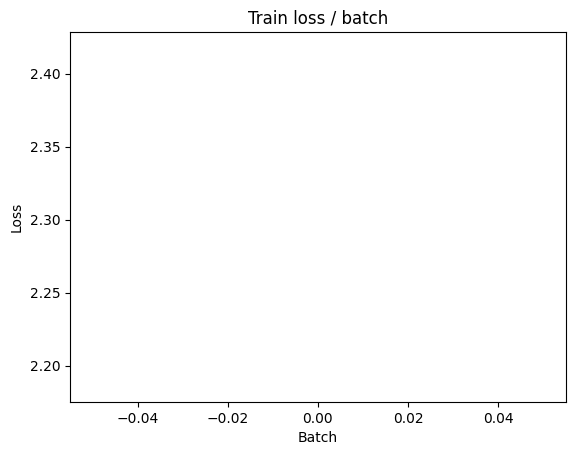

[TRAIN Batch 200/469]	Time 0.020s (0.024s)	Loss 0.2525 (1.2125)	Prec@1  94.5 ( 64.6)	Prec@5 100.0 ( 91.1)


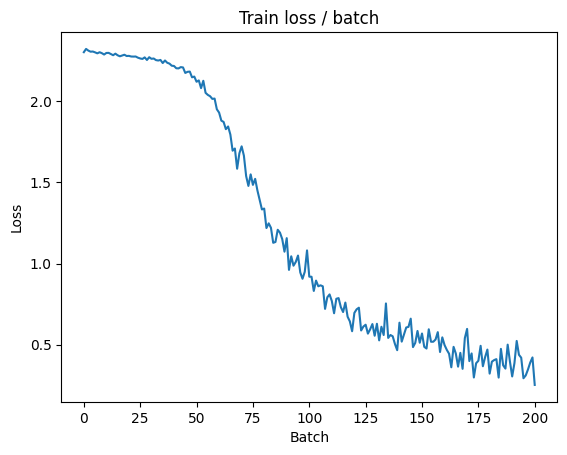

[TRAIN Batch 400/469]	Time 0.008s (0.019s)	Loss 0.1376 (0.7374)	Prec@1  95.3 ( 78.6)	Prec@5 100.0 ( 95.4)


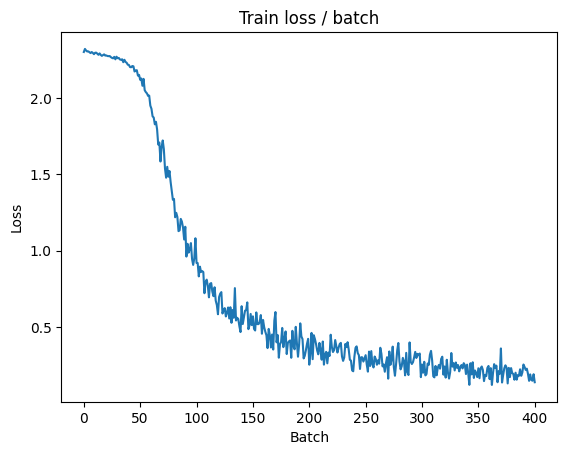


===============> Total time 8s	Avg loss 0.6560	Avg Prec@1 80.96 %	Avg Prec@5 96.01 %

[EVAL Batch 000/079]	Time 0.078s (0.078s)	Loss 0.1108 (0.1108)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.1524	Avg Prec@1 95.64 %	Avg Prec@5 99.92 %



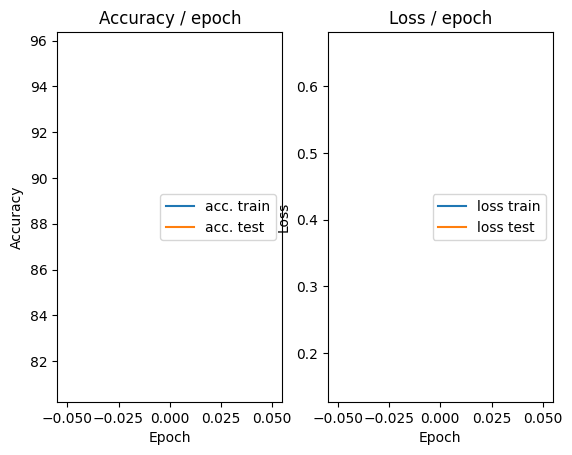

=== EPOCH 2 =====

[TRAIN Batch 000/469]	Time 0.095s (0.095s)	Loss 0.2524 (0.2524)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


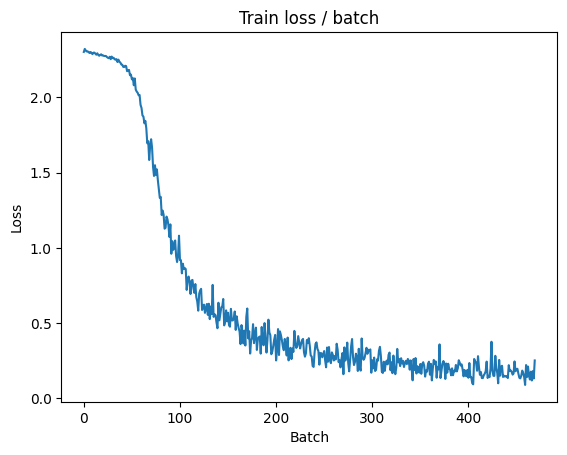

[TRAIN Batch 200/469]	Time 0.015s (0.020s)	Loss 0.1528 (0.1360)	Prec@1  95.3 ( 96.1)	Prec@5 100.0 ( 99.9)


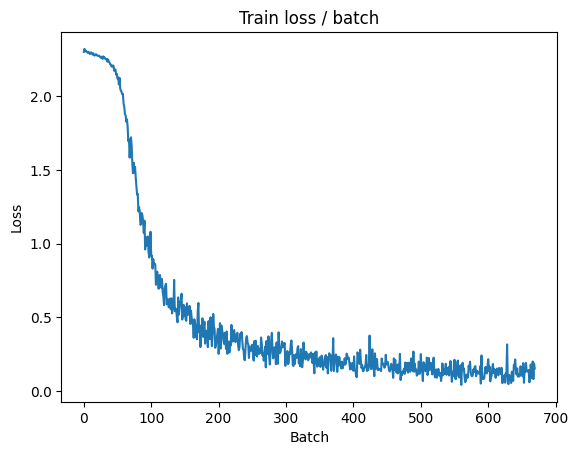

[TRAIN Batch 400/469]	Time 0.007s (0.018s)	Loss 0.1344 (0.1234)	Prec@1  95.3 ( 96.4)	Prec@5 100.0 ( 99.9)


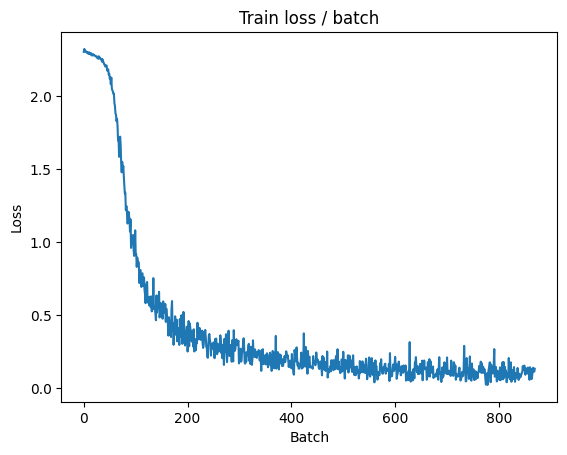


===============> Total time 8s	Avg loss 0.1195	Avg Prec@1 96.54 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.0519 (0.0519)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0802	Avg Prec@1 97.52 %	Avg Prec@5 99.99 %



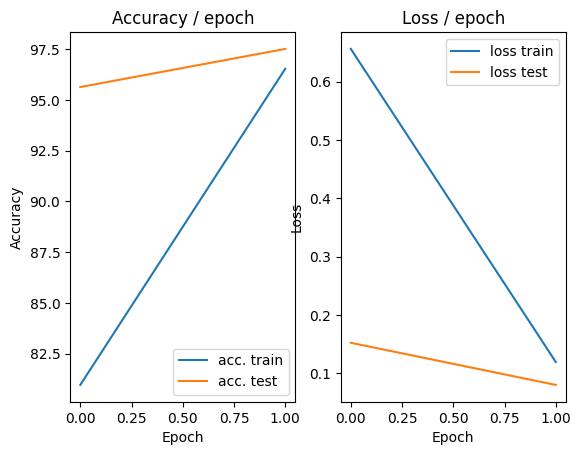

=== EPOCH 3 =====

[TRAIN Batch 000/469]	Time 0.101s (0.101s)	Loss 0.0647 (0.0647)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


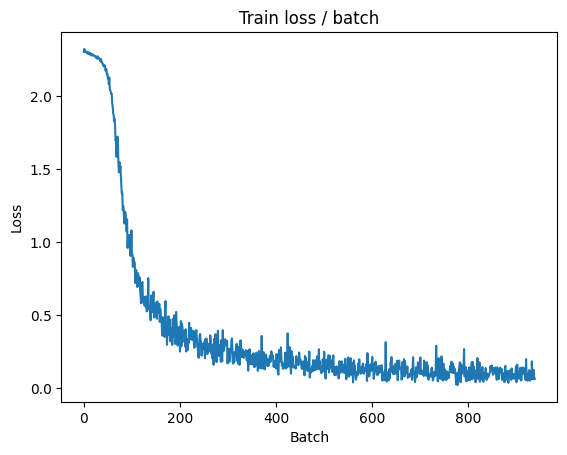

[TRAIN Batch 200/469]	Time 0.013s (0.015s)	Loss 0.0658 (0.0847)	Prec@1  98.4 ( 97.5)	Prec@5 100.0 ( 99.9)


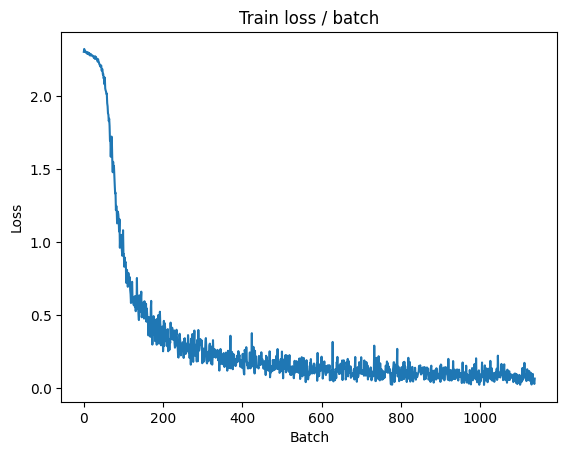

[TRAIN Batch 400/469]	Time 0.035s (0.017s)	Loss 0.0841 (0.0808)	Prec@1  96.9 ( 97.6)	Prec@5 100.0 (100.0)


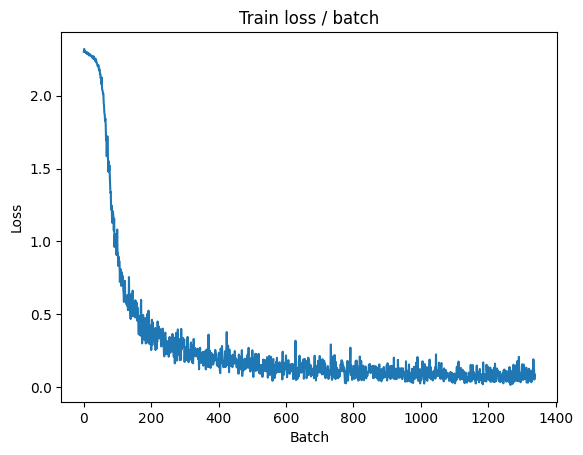


===============> Total time 8s	Avg loss 0.0802	Avg Prec@1 97.59 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 0.0362 (0.0362)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0610	Avg Prec@1 98.03 %	Avg Prec@5 100.00 %



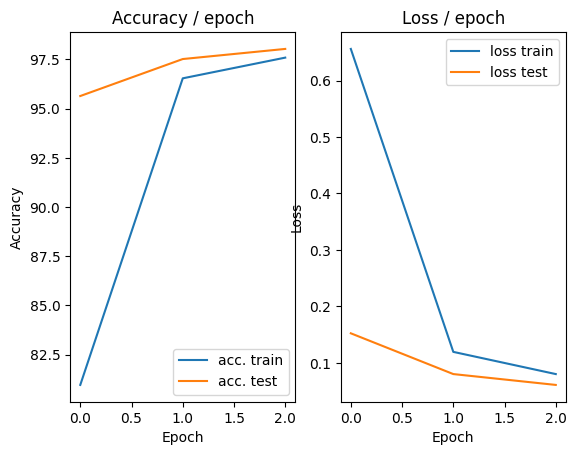

=== EPOCH 4 =====

[TRAIN Batch 000/469]	Time 0.099s (0.099s)	Loss 0.0420 (0.0420)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


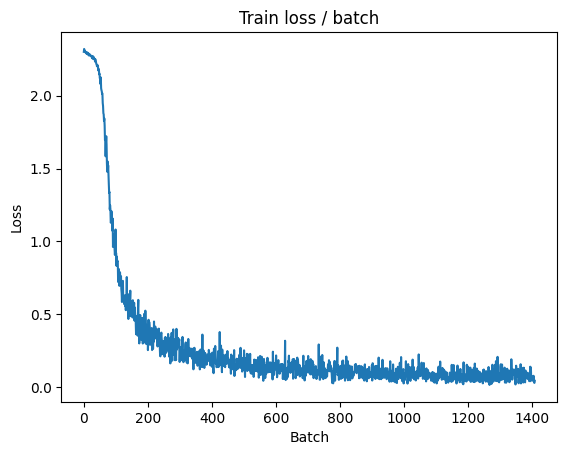

[TRAIN Batch 200/469]	Time 0.014s (0.016s)	Loss 0.0716 (0.0632)	Prec@1  98.4 ( 98.2)	Prec@5 100.0 (100.0)


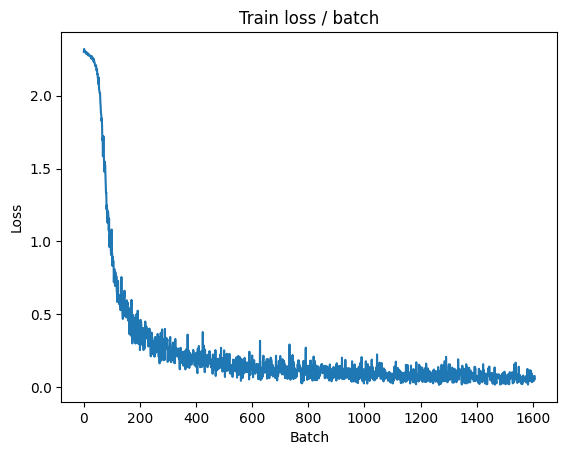

[TRAIN Batch 400/469]	Time 0.024s (0.015s)	Loss 0.0679 (0.0621)	Prec@1  98.4 ( 98.2)	Prec@5 100.0 (100.0)


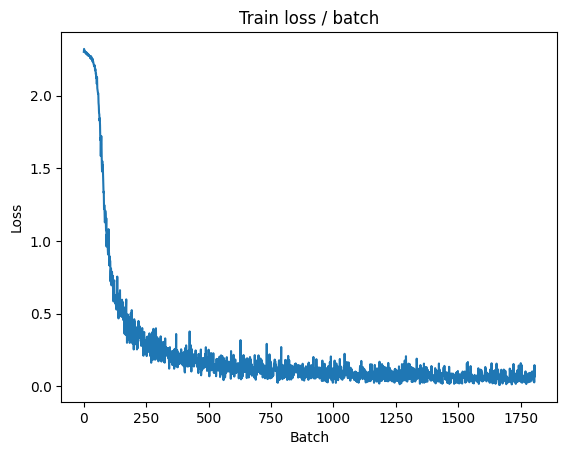


===============> Total time 7s	Avg loss 0.0618	Avg Prec@1 98.20 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 0.0295 (0.0295)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0544	Avg Prec@1 98.14 %	Avg Prec@5 100.00 %



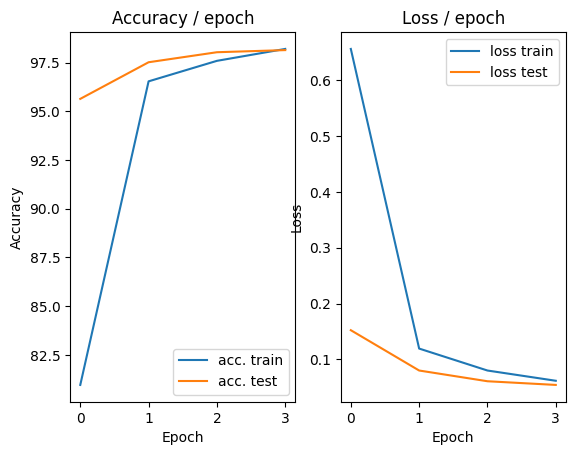

=== EPOCH 5 =====

[TRAIN Batch 000/469]	Time 0.160s (0.160s)	Loss 0.0362 (0.0362)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


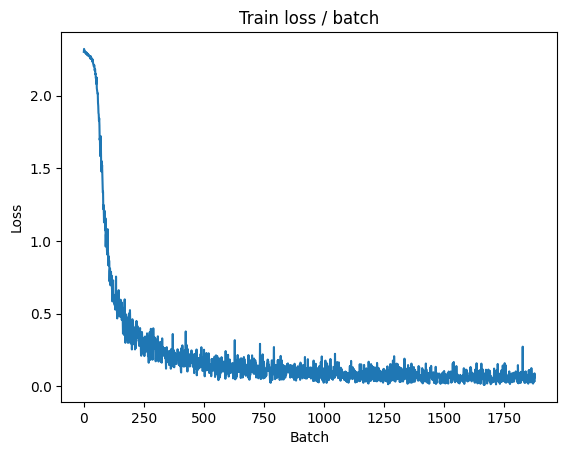

[TRAIN Batch 200/469]	Time 0.018s (0.017s)	Loss 0.0121 (0.0509)	Prec@1 100.0 ( 98.5)	Prec@5 100.0 (100.0)


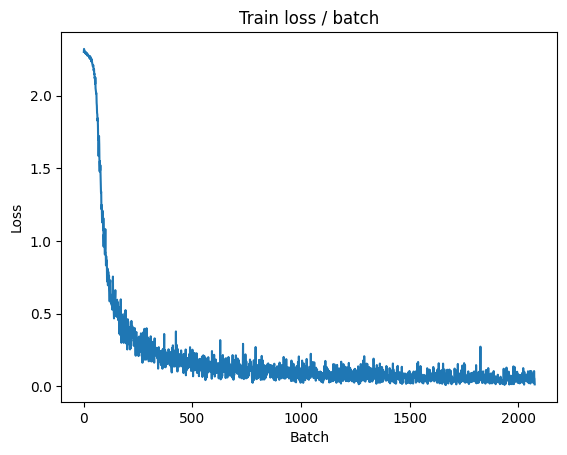

[TRAIN Batch 400/469]	Time 0.006s (0.016s)	Loss 0.0263 (0.0518)	Prec@1  99.2 ( 98.4)	Prec@5 100.0 (100.0)


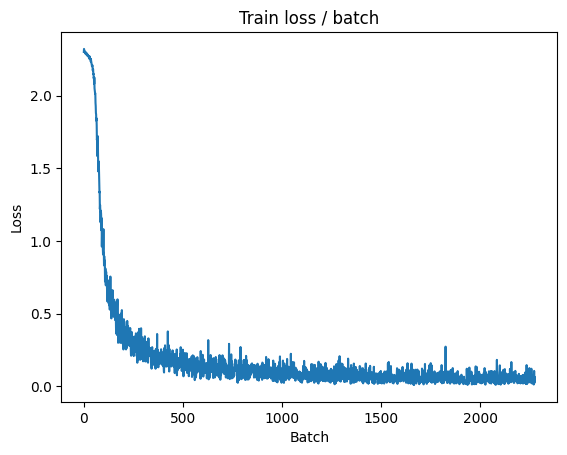


===============> Total time 7s	Avg loss 0.0518	Avg Prec@1 98.45 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.086s (0.086s)	Loss 0.0293 (0.0293)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0460	Avg Prec@1 98.44 %	Avg Prec@5 100.00 %



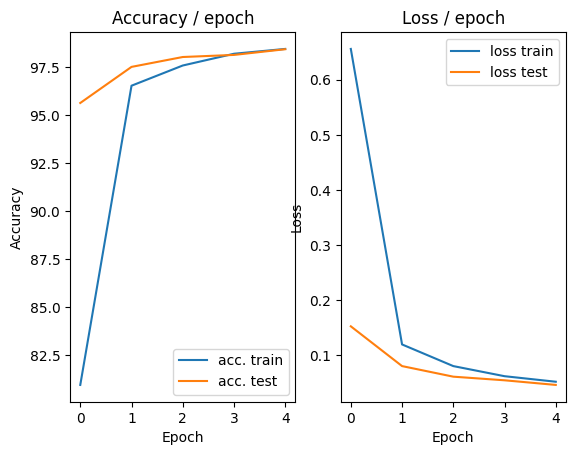

In [ ]:
main(128, 0.1, 5, cuda=True)

question15

In [ ]:

import torch.nn.functional as F

class ConvNet(nn.Module):
    def __init__(self):
        super(ConvNet, self).__init__()

        self.conv1 = nn.Conv2d(in_channels=3, out_channels=32, kernel_size=5, stride=1, padding=2)
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv2 = nn.Conv2d(in_channels=32, out_channels=64, kernel_size=5, stride=1, padding=2)
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv3 = nn.Conv2d(in_channels=64, out_channels=64, kernel_size=5, stride=1, padding=2)
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.fc4 = nn.Linear(4 * 4 * 64, 1000)   # apres 3 poolings: 32->16->8->4
        self.fc5 = nn.Linear(1000, 10)

    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = self.pool1(x)

        x = F.relu(self.conv2(x))
        x = self.pool2(x)

        x = F.relu(self.conv3(x))
        x = self.pool3(x)

        #  on applatit
        x = x.view(x.size(0), -1)

        # full connected layers
        x = F.relu(self.fc4(x))
        x = self.fc5(x)

        # x = F.softmax(x, dim=1)
        return x



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=30, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

100%|██████████| 170M/170M [00:04<00:00, 42.1MB/s]


=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 1.929s (1.929s)	Loss 2.3056 (2.3056)	Prec@1   7.0 (  7.0)	Prec@5  47.7 ( 47.7)


<Figure size 640x480 with 0 Axes>

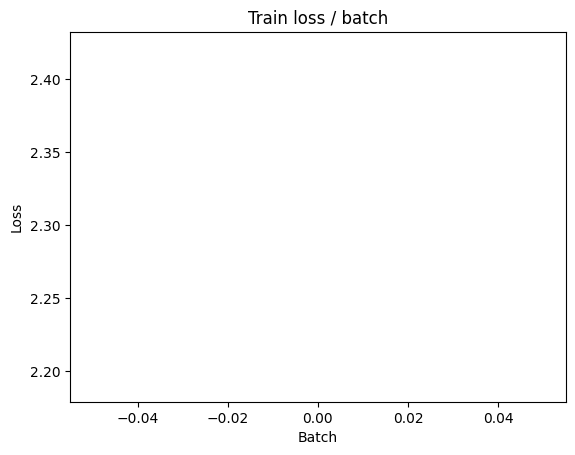

[TRAIN Batch 200/391]	Time 0.019s (0.027s)	Loss 2.2325 (2.2636)	Prec@1  16.4 ( 14.3)	Prec@5  68.8 ( 59.8)


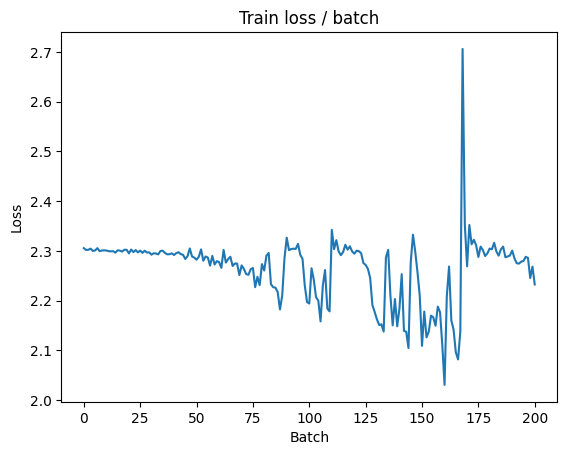


===============> Total time 9s	Avg loss 2.1841	Avg Prec@1 18.96 %	Avg Prec@5 66.57 %

[EVAL Batch 000/079]	Time 0.108s (0.108s)	Loss 1.8795 (1.8795)	Prec@1  34.4 ( 34.4)	Prec@5  84.4 ( 84.4)

===============> Total time 1s	Avg loss 1.9065	Avg Prec@1 30.53 %	Avg Prec@5 81.67 %



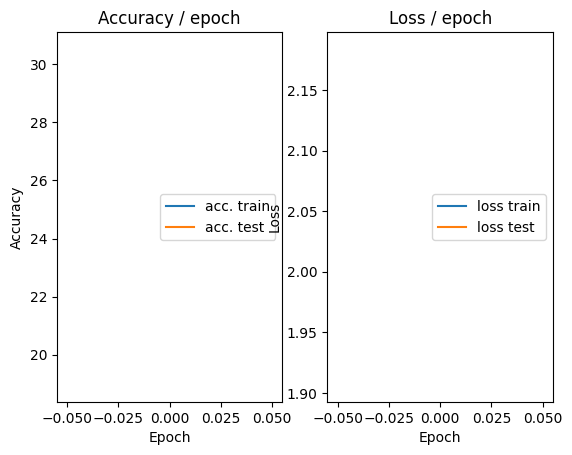

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.104s (0.104s)	Loss 1.9789 (1.9789)	Prec@1  29.7 ( 29.7)	Prec@5  77.3 ( 77.3)


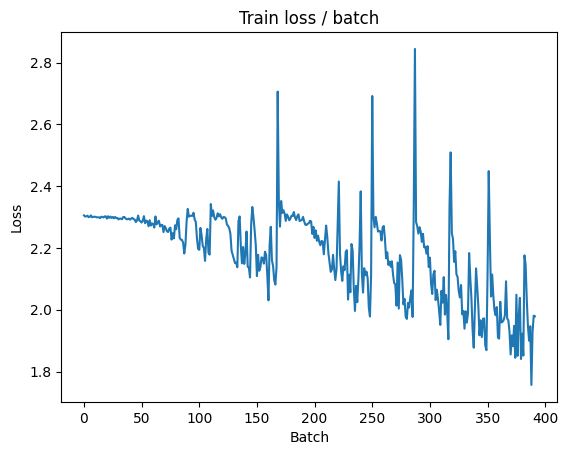

[TRAIN Batch 200/391]	Time 0.034s (0.019s)	Loss 1.6812 (1.8421)	Prec@1  38.3 ( 33.0)	Prec@5  91.4 ( 84.0)


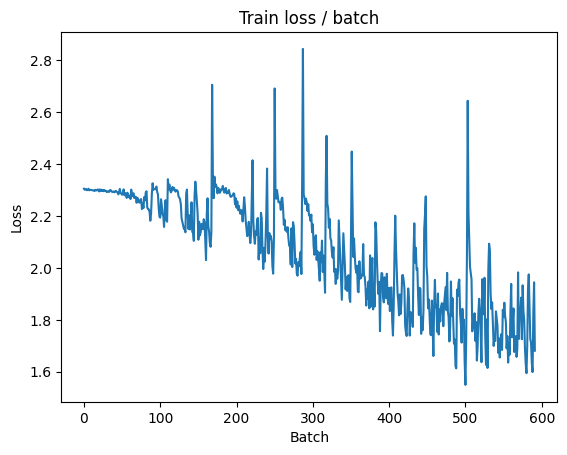


===============> Total time 7s	Avg loss 1.7516	Avg Prec@1 36.48 %	Avg Prec@5 86.30 %

[EVAL Batch 000/079]	Time 0.106s (0.106s)	Loss 1.5256 (1.5256)	Prec@1  43.8 ( 43.8)	Prec@5  89.8 ( 89.8)

===============> Total time 1s	Avg loss 1.5384	Avg Prec@1 43.19 %	Avg Prec@5 90.78 %



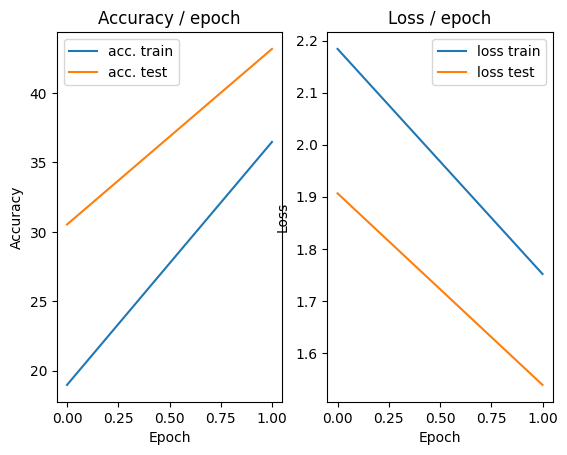

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.112s (0.112s)	Loss 1.4586 (1.4586)	Prec@1  50.8 ( 50.8)	Prec@5  93.8 ( 93.8)


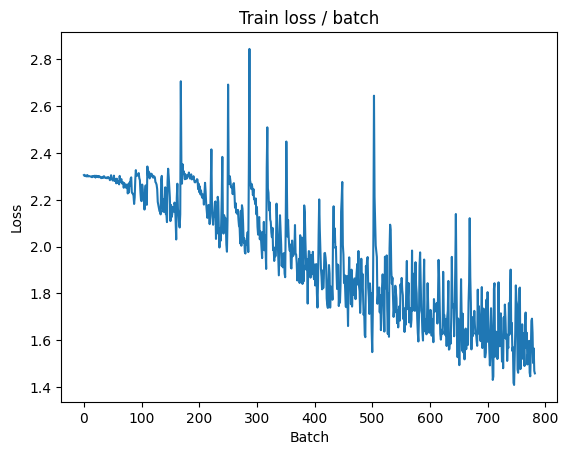

[TRAIN Batch 200/391]	Time 0.009s (0.024s)	Loss 1.3961 (1.5162)	Prec@1  49.2 ( 45.4)	Prec@5  93.8 ( 91.2)


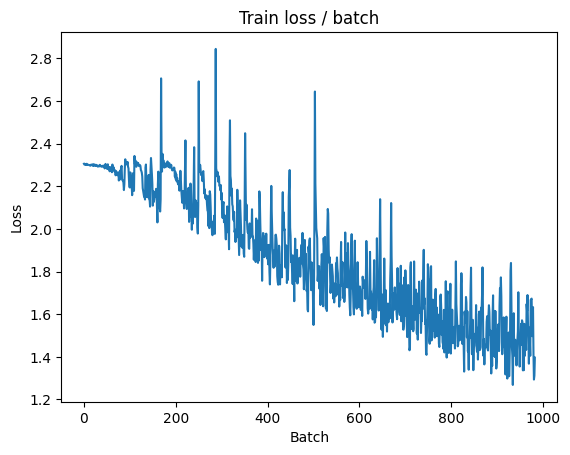


===============> Total time 8s	Avg loss 1.4748	Avg Prec@1 47.03 %	Avg Prec@5 91.73 %

[EVAL Batch 000/079]	Time 0.092s (0.092s)	Loss 1.2995 (1.2995)	Prec@1  56.2 ( 56.2)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.4349	Avg Prec@1 49.73 %	Avg Prec@5 91.55 %



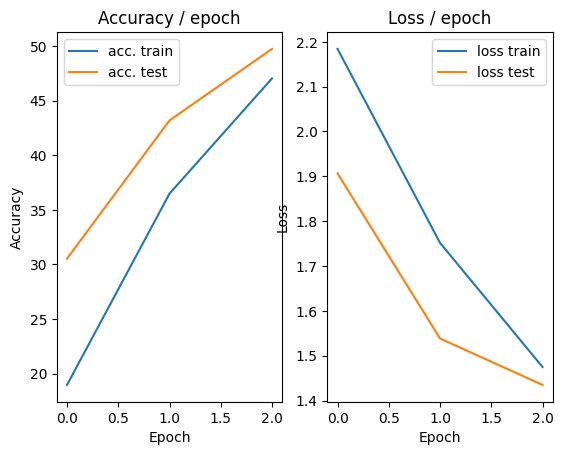

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.112s (0.112s)	Loss 1.5121 (1.5121)	Prec@1  43.8 ( 43.8)	Prec@5  89.1 ( 89.1)


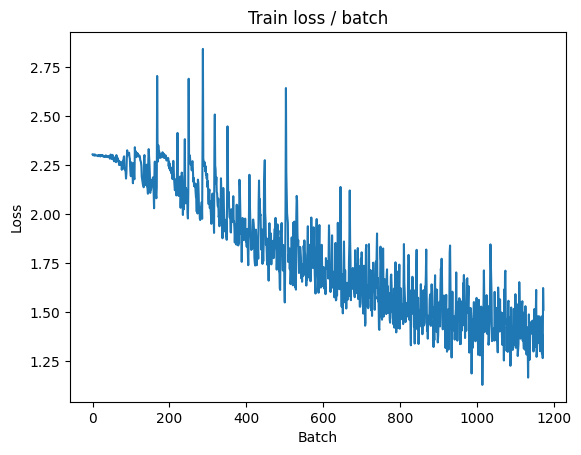

[TRAIN Batch 200/391]	Time 0.012s (0.021s)	Loss 1.4555 (1.3353)	Prec@1  48.4 ( 52.4)	Prec@5  93.0 ( 93.8)


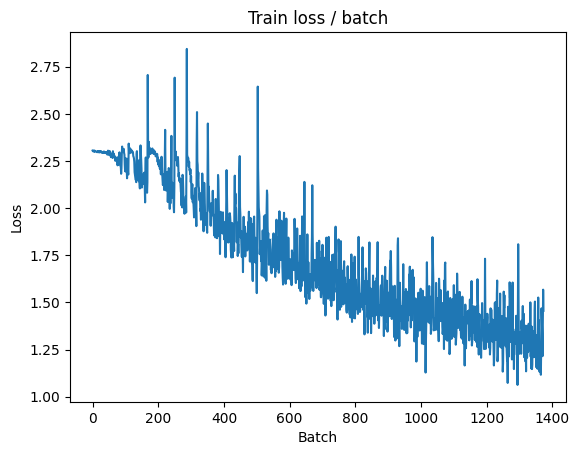


===============> Total time 8s	Avg loss 1.3020	Avg Prec@1 53.56 %	Avg Prec@5 94.08 %

[EVAL Batch 000/079]	Time 0.098s (0.098s)	Loss 1.0276 (1.0276)	Prec@1  67.2 ( 67.2)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.2233	Avg Prec@1 56.18 %	Avg Prec@5 94.54 %



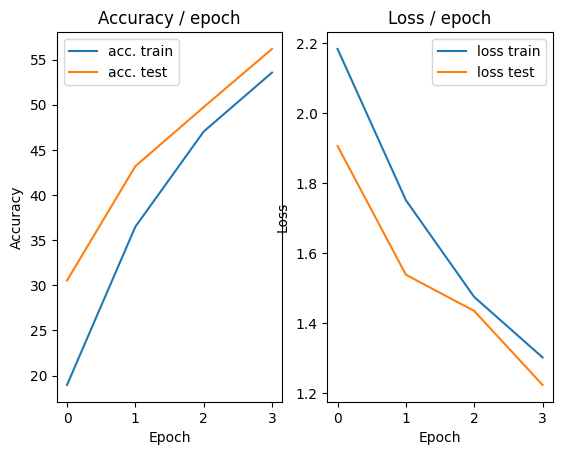

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.113s (0.113s)	Loss 1.2857 (1.2857)	Prec@1  55.5 ( 55.5)	Prec@5  92.2 ( 92.2)


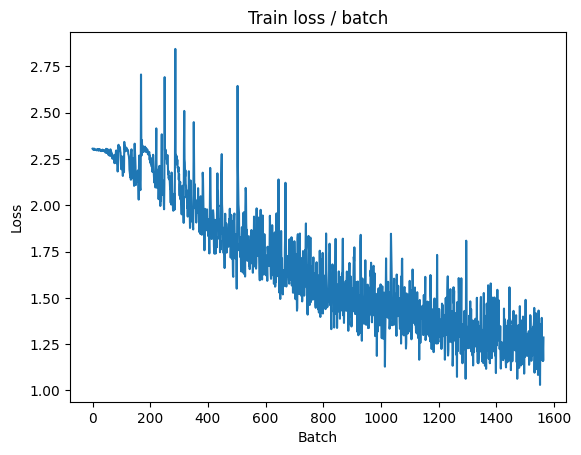

[TRAIN Batch 200/391]	Time 0.021s (0.020s)	Loss 1.2309 (1.1795)	Prec@1  55.5 ( 58.2)	Prec@5  93.0 ( 95.4)


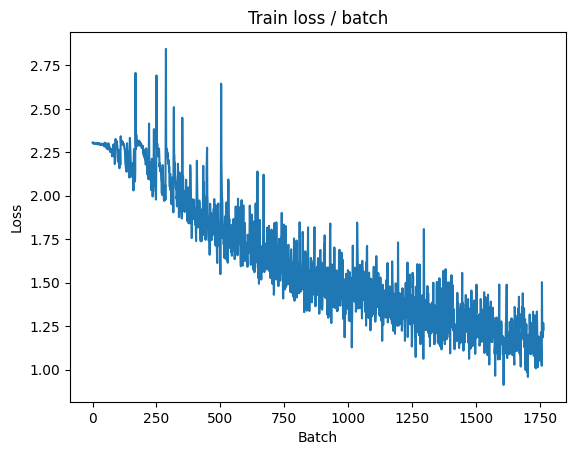


===============> Total time 8s	Avg loss 1.1594	Avg Prec@1 58.99 %	Avg Prec@5 95.43 %

[EVAL Batch 000/079]	Time 0.103s (0.103s)	Loss 1.0047 (1.0047)	Prec@1  64.1 ( 64.1)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.1398	Avg Prec@1 59.64 %	Avg Prec@5 95.91 %



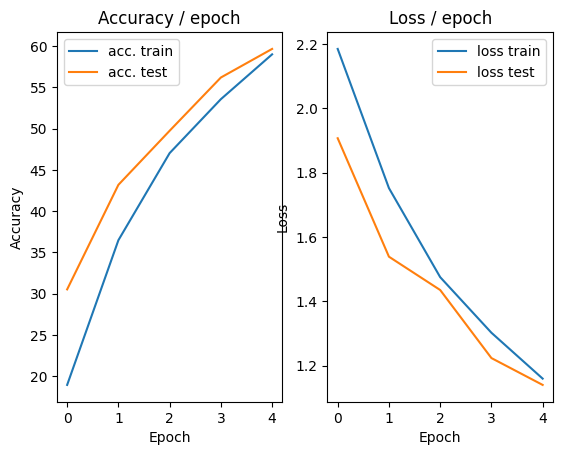

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.118s (0.118s)	Loss 0.9997 (0.9997)	Prec@1  61.7 ( 61.7)	Prec@5  99.2 ( 99.2)


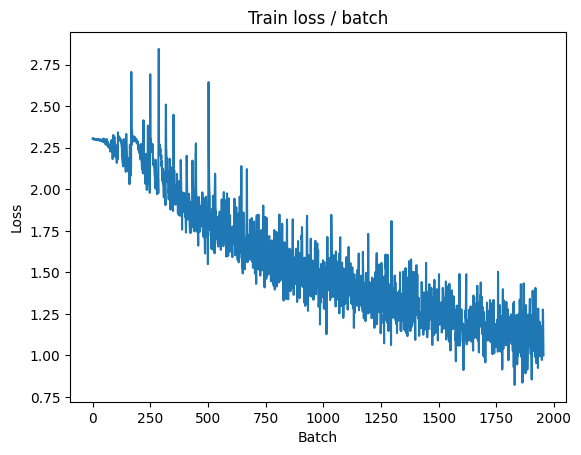

[TRAIN Batch 200/391]	Time 0.009s (0.019s)	Loss 1.1051 (1.0373)	Prec@1  61.7 ( 63.2)	Prec@5  96.9 ( 96.5)


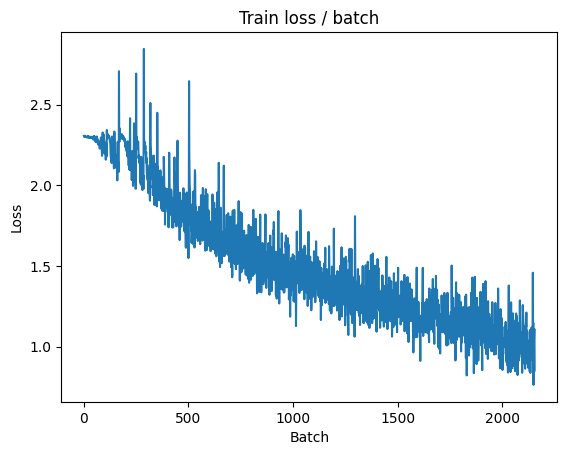


===============> Total time 7s	Avg loss 1.0307	Avg Prec@1 63.47 %	Avg Prec@5 96.48 %

[EVAL Batch 000/079]	Time 0.099s (0.099s)	Loss 1.0198 (1.0198)	Prec@1  63.3 ( 63.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.0973	Avg Prec@1 60.95 %	Avg Prec@5 96.13 %



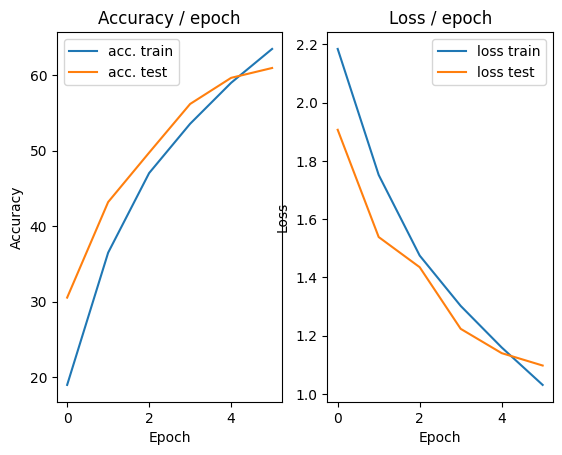

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.218s (0.218s)	Loss 1.1761 (1.1761)	Prec@1  56.2 ( 56.2)	Prec@5  95.3 ( 95.3)


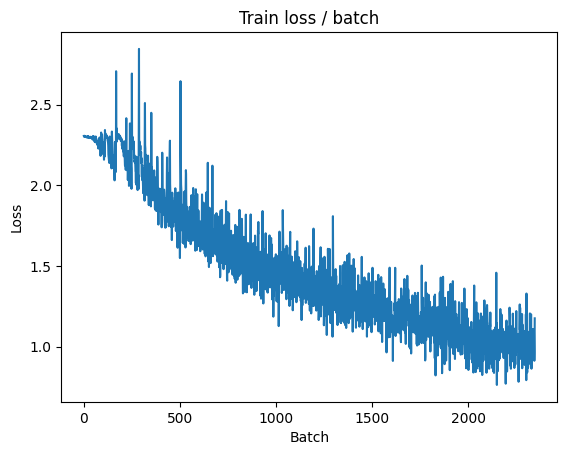

[TRAIN Batch 200/391]	Time 0.010s (0.021s)	Loss 0.8489 (0.9283)	Prec@1  73.4 ( 67.4)	Prec@5 100.0 ( 97.3)


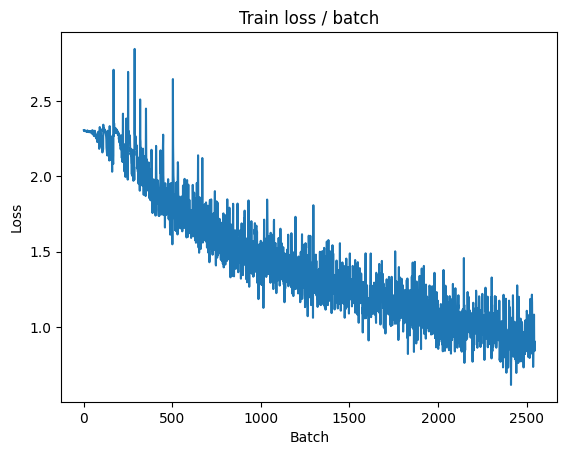


===============> Total time 7s	Avg loss 0.9205	Avg Prec@1 67.64 %	Avg Prec@5 97.35 %

[EVAL Batch 000/079]	Time 0.097s (0.097s)	Loss 0.9164 (0.9164)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9605	Avg Prec@1 65.68 %	Avg Prec@5 96.97 %



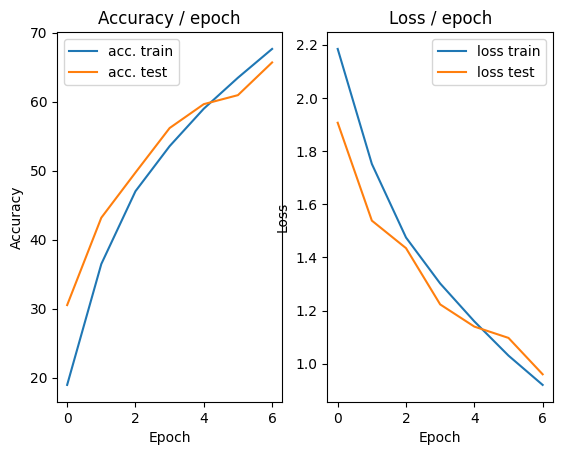

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.8271 (0.8271)	Prec@1  70.3 ( 70.3)	Prec@5  96.1 ( 96.1)


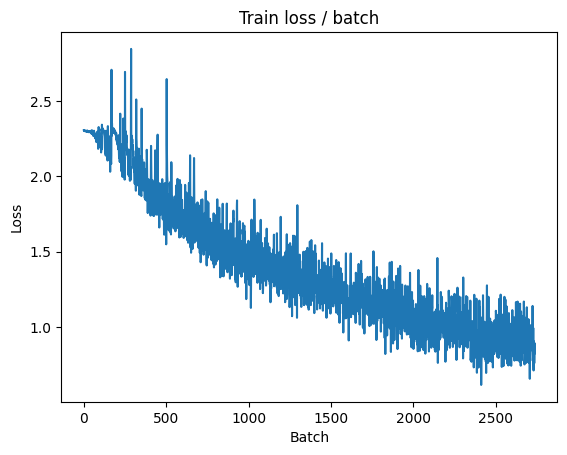

[TRAIN Batch 200/391]	Time 0.021s (0.024s)	Loss 0.6897 (0.8212)	Prec@1  75.8 ( 71.1)	Prec@5  98.4 ( 98.0)


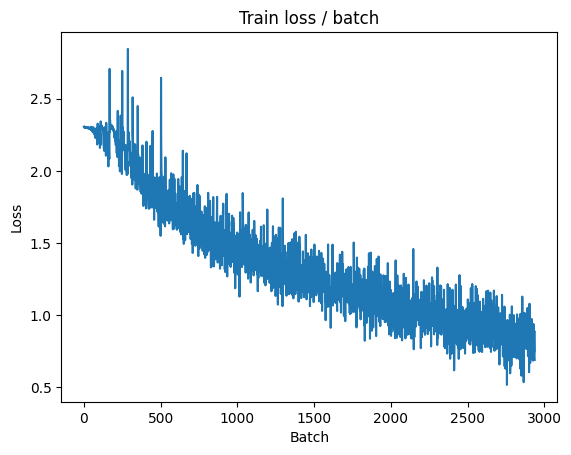


===============> Total time 8s	Avg loss 0.8150	Avg Prec@1 71.32 %	Avg Prec@5 98.04 %

[EVAL Batch 000/079]	Time 0.103s (0.103s)	Loss 1.0109 (1.0109)	Prec@1  64.1 ( 64.1)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 1.0255	Avg Prec@1 64.66 %	Avg Prec@5 96.74 %



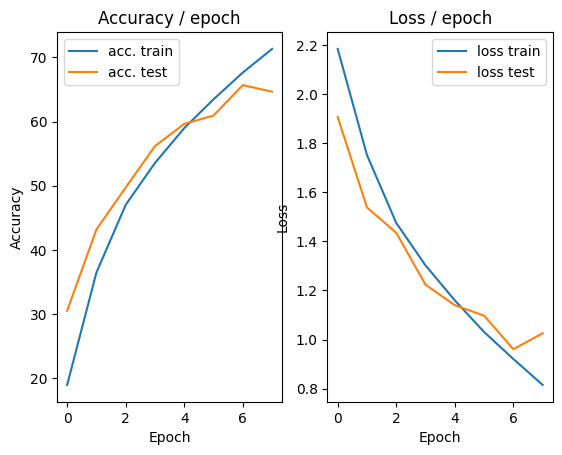

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.114s (0.114s)	Loss 0.8027 (0.8027)	Prec@1  68.8 ( 68.8)	Prec@5  98.4 ( 98.4)


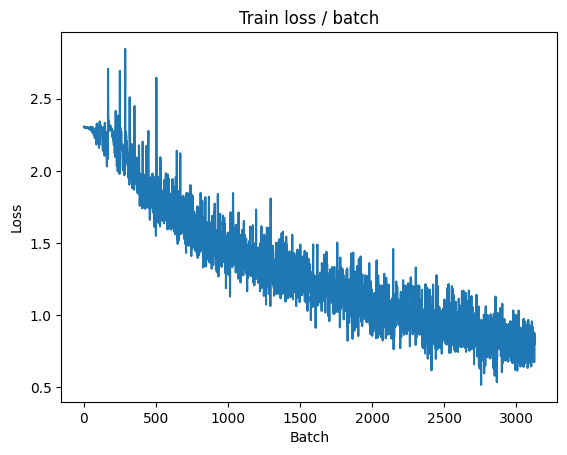

[TRAIN Batch 200/391]	Time 0.011s (0.019s)	Loss 0.9051 (0.7312)	Prec@1  68.0 ( 74.2)	Prec@5  95.3 ( 98.4)


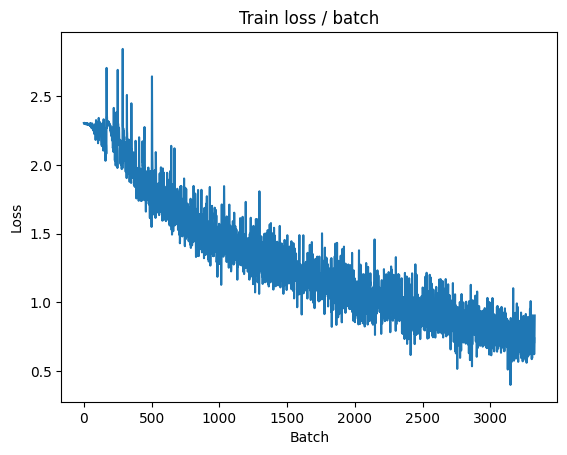


===============> Total time 8s	Avg loss 0.7289	Avg Prec@1 74.40 %	Avg Prec@5 98.50 %

[EVAL Batch 000/079]	Time 0.099s (0.099s)	Loss 1.0051 (1.0051)	Prec@1  64.1 ( 64.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9782	Avg Prec@1 66.46 %	Avg Prec@5 97.11 %



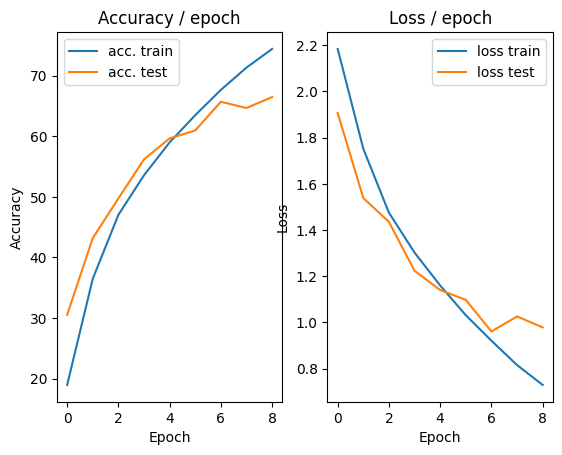

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 0.6397 (0.6397)	Prec@1  75.0 ( 75.0)	Prec@5 100.0 (100.0)


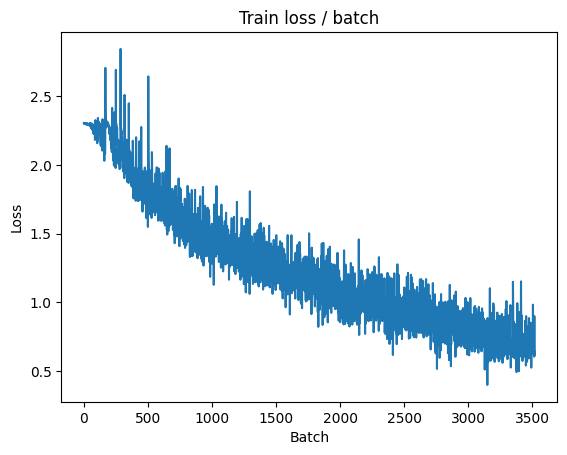

[TRAIN Batch 200/391]	Time 0.026s (0.019s)	Loss 0.6072 (0.6190)	Prec@1  78.1 ( 78.2)	Prec@5 100.0 ( 99.0)


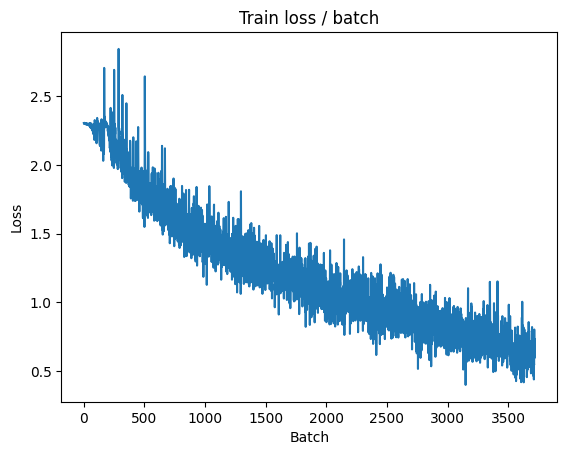


===============> Total time 7s	Avg loss 0.6320	Avg Prec@1 77.78 %	Avg Prec@5 98.98 %

[EVAL Batch 000/079]	Time 0.130s (0.130s)	Loss 1.0358 (1.0358)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.9994	Avg Prec@1 66.08 %	Avg Prec@5 97.13 %



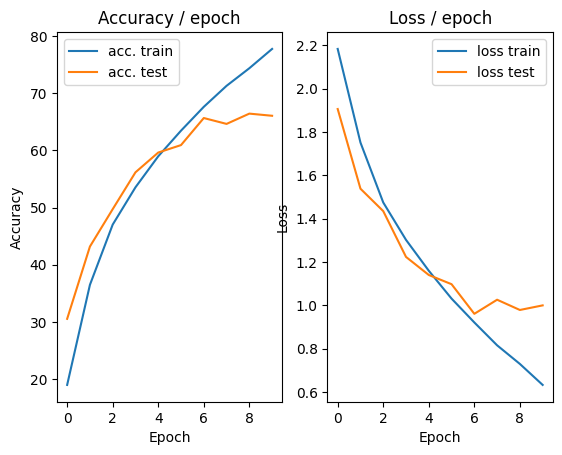

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.6085 (0.6085)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)


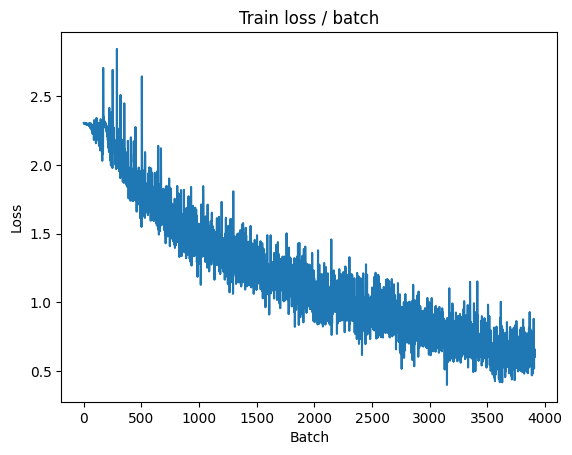

[TRAIN Batch 200/391]	Time 0.007s (0.019s)	Loss 0.5006 (0.5195)	Prec@1  78.9 ( 81.9)	Prec@5  99.2 ( 99.3)


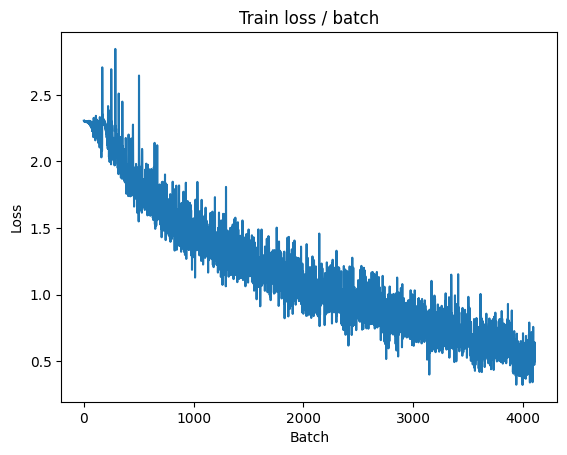


===============> Total time 7s	Avg loss 0.5341	Avg Prec@1 81.28 %	Avg Prec@5 99.33 %

[EVAL Batch 000/079]	Time 0.101s (0.101s)	Loss 0.9665 (0.9665)	Prec@1  69.5 ( 69.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.0090	Avg Prec@1 66.90 %	Avg Prec@5 96.88 %



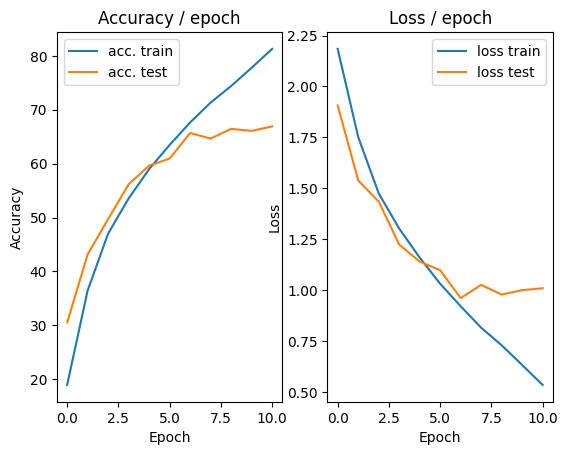

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 0.4159 (0.4159)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)


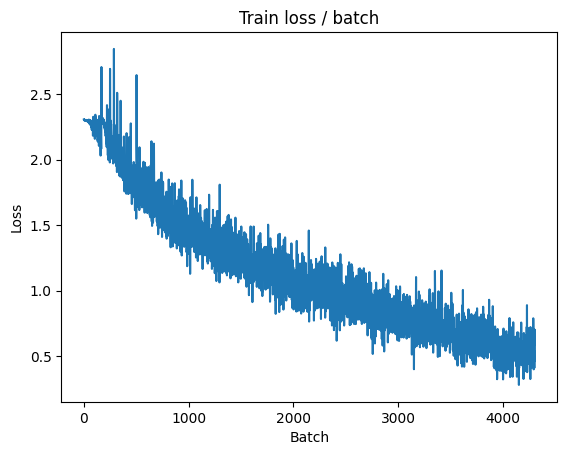

[TRAIN Batch 200/391]	Time 0.027s (0.024s)	Loss 0.4046 (0.4369)	Prec@1  85.9 ( 84.9)	Prec@5 100.0 ( 99.7)


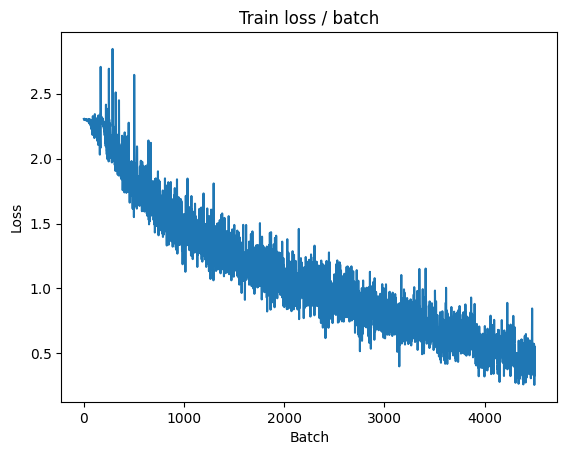


===============> Total time 8s	Avg loss 0.4477	Avg Prec@1 84.40 %	Avg Prec@5 99.62 %

[EVAL Batch 000/079]	Time 0.100s (0.100s)	Loss 1.2087 (1.2087)	Prec@1  70.3 ( 70.3)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.0893	Avg Prec@1 67.55 %	Avg Prec@5 97.11 %



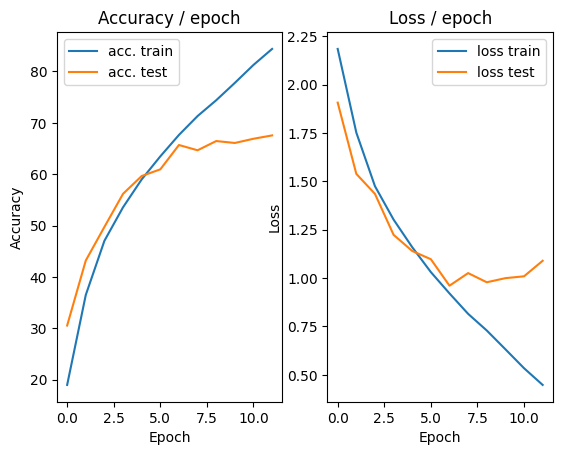

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.122s (0.122s)	Loss 0.6248 (0.6248)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


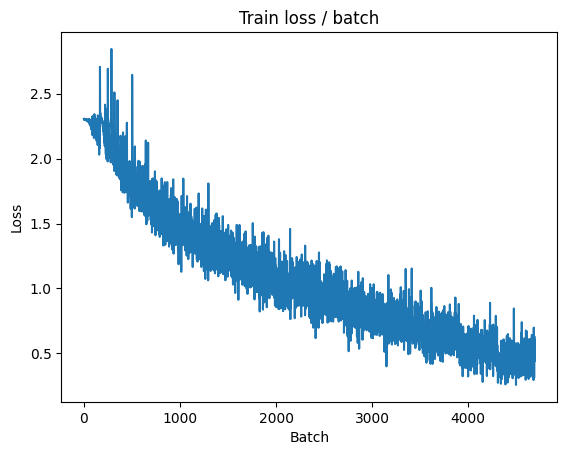

[TRAIN Batch 200/391]	Time 0.010s (0.020s)	Loss 0.3623 (0.3326)	Prec@1  87.5 ( 88.3)	Prec@5 100.0 ( 99.8)


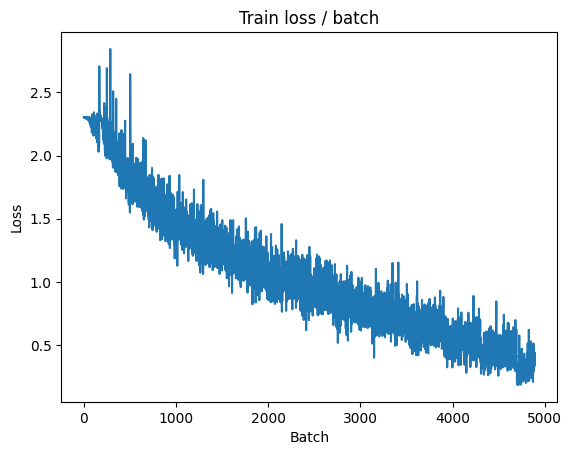


===============> Total time 8s	Avg loss 0.3552	Avg Prec@1 87.45 %	Avg Prec@5 99.77 %

[EVAL Batch 000/079]	Time 0.099s (0.099s)	Loss 1.1056 (1.1056)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.0645	Avg Prec@1 68.42 %	Avg Prec@5 96.88 %



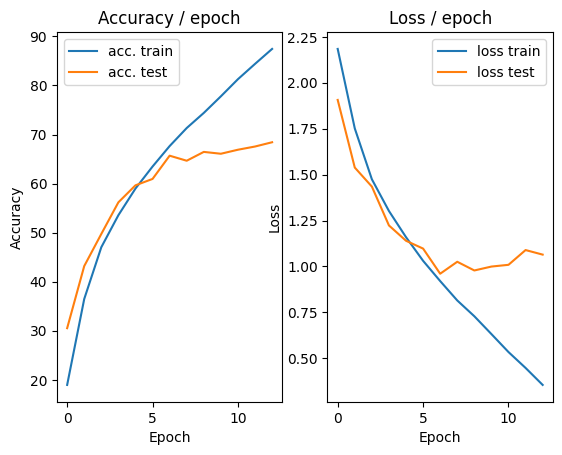

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.2989 (0.2989)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


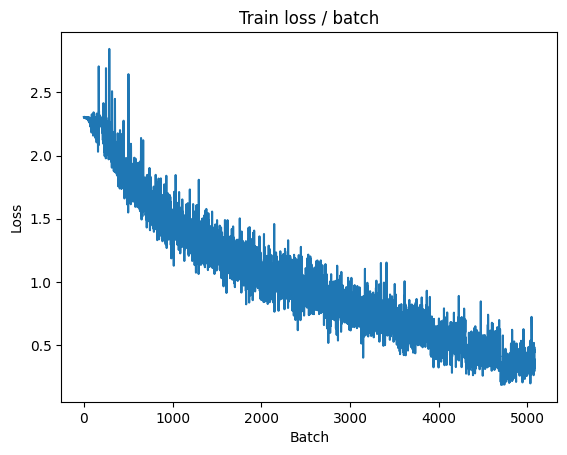

[TRAIN Batch 200/391]	Time 0.010s (0.019s)	Loss 0.3490 (0.2563)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 ( 99.9)


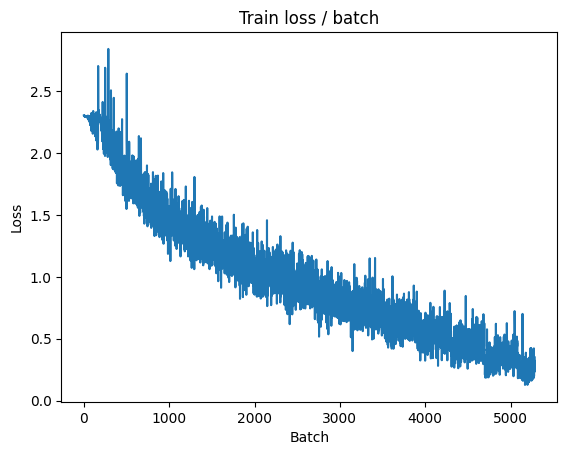


===============> Total time 7s	Avg loss 0.2747	Avg Prec@1 90.56 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 1.0945 (1.0945)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.1076	Avg Prec@1 70.03 %	Avg Prec@5 97.03 %



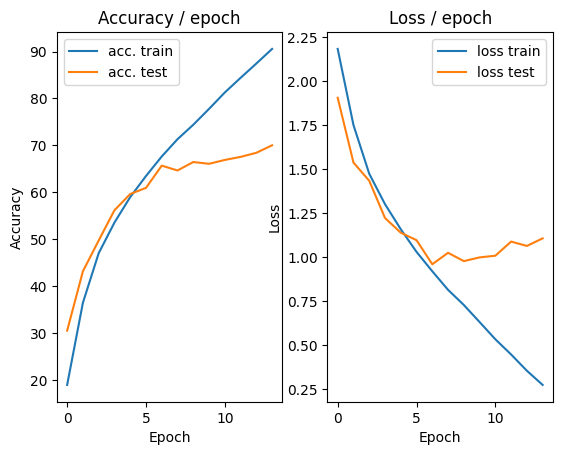

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.120s (0.120s)	Loss 0.2415 (0.2415)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


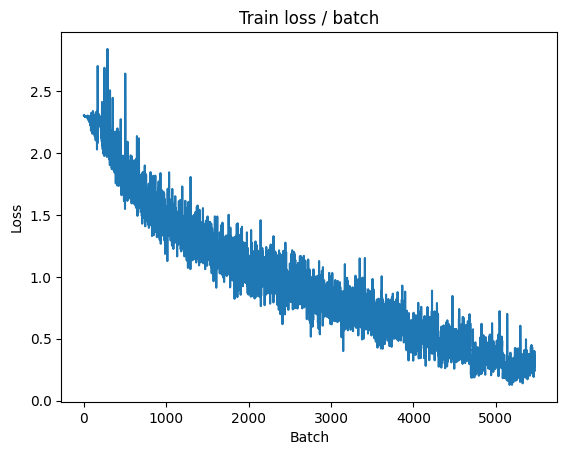

[TRAIN Batch 200/391]	Time 0.030s (0.019s)	Loss 0.1563 (0.1664)	Prec@1  94.5 ( 94.6)	Prec@5 100.0 (100.0)


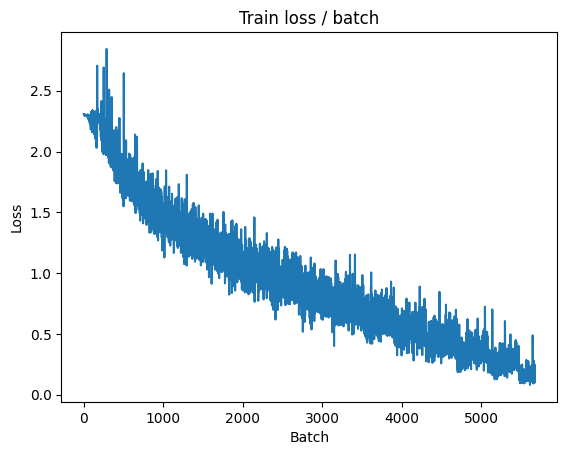


===============> Total time 7s	Avg loss 0.1966	Avg Prec@1 93.27 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.102s (0.102s)	Loss 1.2237 (1.2237)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.2005	Avg Prec@1 69.45 %	Avg Prec@5 97.11 %



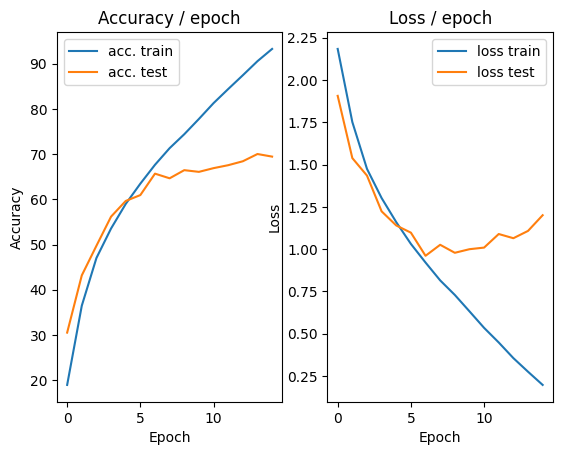

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.201s (0.201s)	Loss 0.1658 (0.1658)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


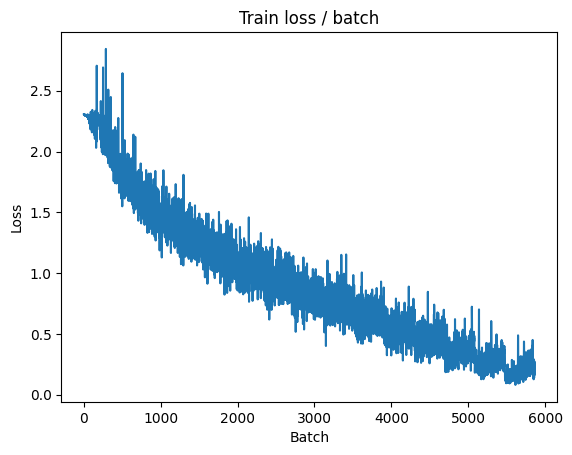

[TRAIN Batch 200/391]	Time 0.019s (0.023s)	Loss 0.1482 (0.1705)	Prec@1  95.3 ( 94.6)	Prec@5 100.0 ( 99.9)


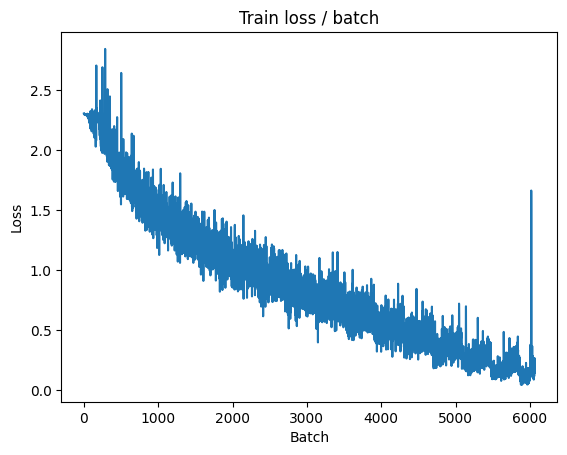


===============> Total time 8s	Avg loss 0.1648	Avg Prec@1 94.57 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.104s (0.104s)	Loss 1.3190 (1.3190)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.2399	Avg Prec@1 70.56 %	Avg Prec@5 97.19 %



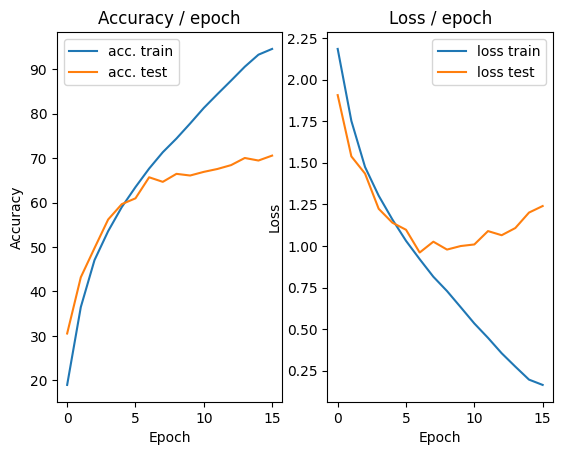

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.145s (0.145s)	Loss 0.1335 (0.1335)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


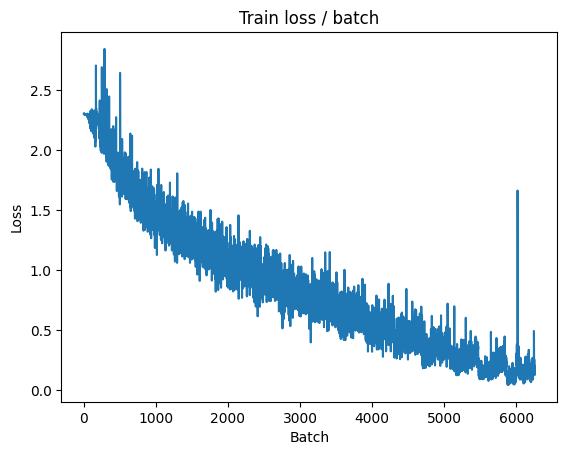

[TRAIN Batch 200/391]	Time 0.028s (0.023s)	Loss 0.0998 (0.1248)	Prec@1  96.9 ( 96.2)	Prec@5 100.0 ( 99.9)


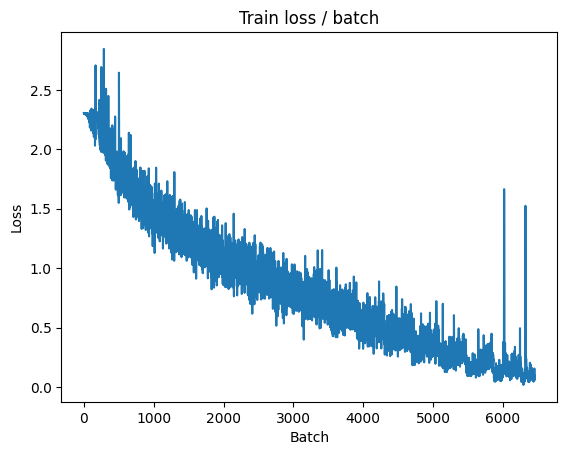


===============> Total time 8s	Avg loss 0.1213	Avg Prec@1 96.11 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.103s (0.103s)	Loss 1.5662 (1.5662)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.4102	Avg Prec@1 70.02 %	Avg Prec@5 97.27 %



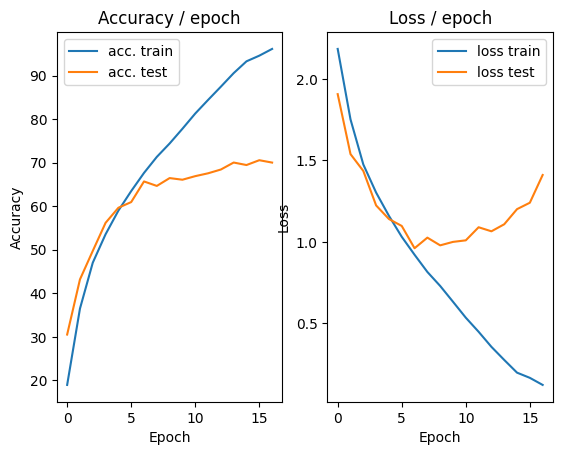

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.0479 (0.0479)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


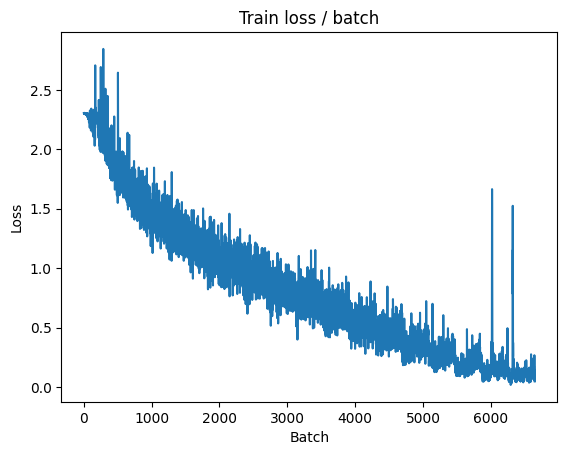

[TRAIN Batch 200/391]	Time 0.031s (0.019s)	Loss 0.1338 (0.0503)	Prec@1  93.8 ( 98.6)	Prec@5 100.0 (100.0)


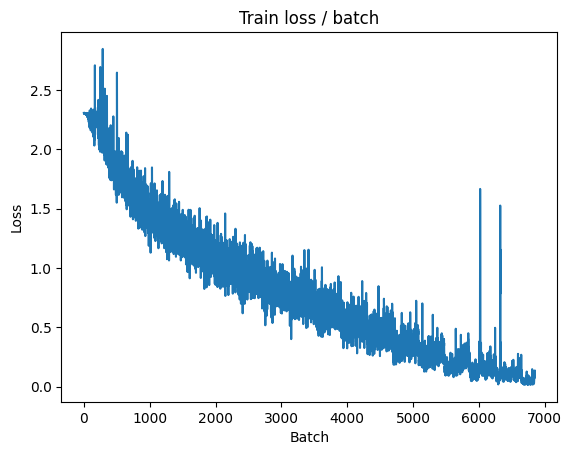


===============> Total time 8s	Avg loss 0.0632	Avg Prec@1 98.09 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.103s (0.103s)	Loss 1.7565 (1.7565)	Prec@1  71.1 ( 71.1)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.5922	Avg Prec@1 69.54 %	Avg Prec@5 96.67 %



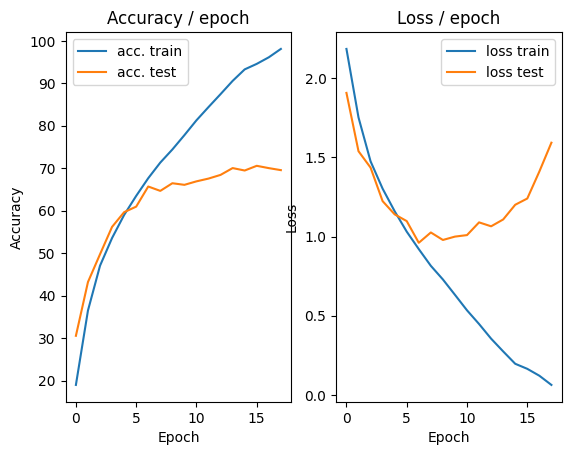

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 0.1031 (0.1031)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


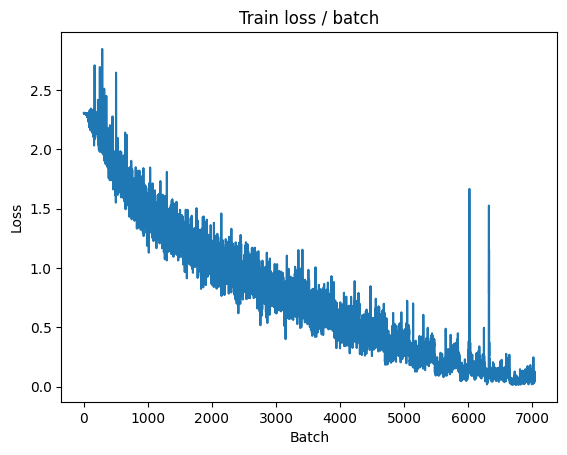

[TRAIN Batch 200/391]	Time 0.009s (0.019s)	Loss 0.0851 (0.0393)	Prec@1  97.7 ( 98.9)	Prec@5 100.0 (100.0)


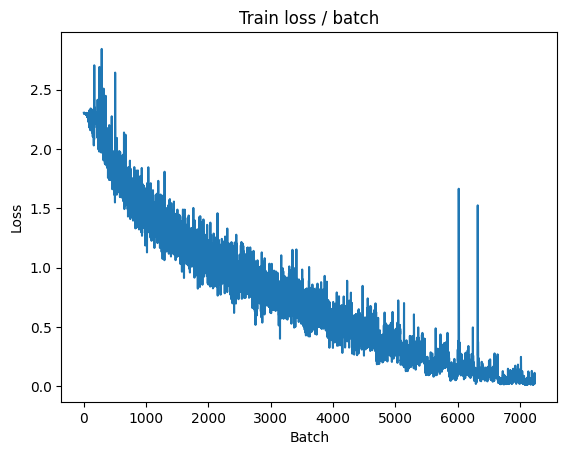


===============> Total time 7s	Avg loss 0.0487	Avg Prec@1 98.54 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.104s (0.104s)	Loss 1.8536 (1.8536)	Prec@1  71.9 ( 71.9)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.5988	Avg Prec@1 70.38 %	Avg Prec@5 97.15 %



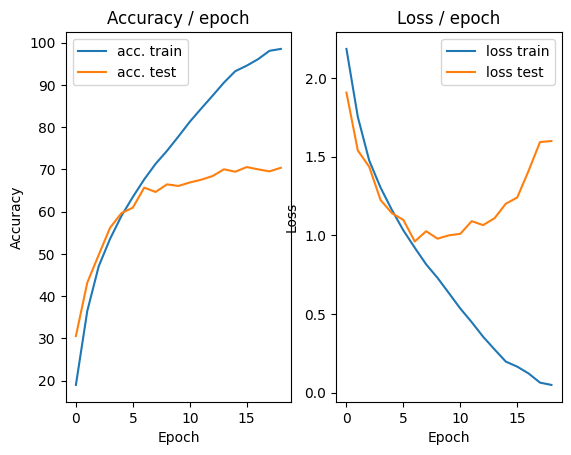

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.189s (0.189s)	Loss 0.0743 (0.0743)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


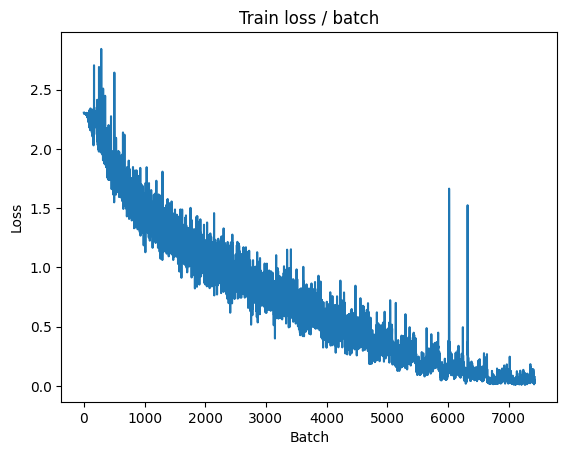

[TRAIN Batch 200/391]	Time 0.026s (0.021s)	Loss 0.0418 (0.0285)	Prec@1  97.7 ( 99.3)	Prec@5 100.0 (100.0)


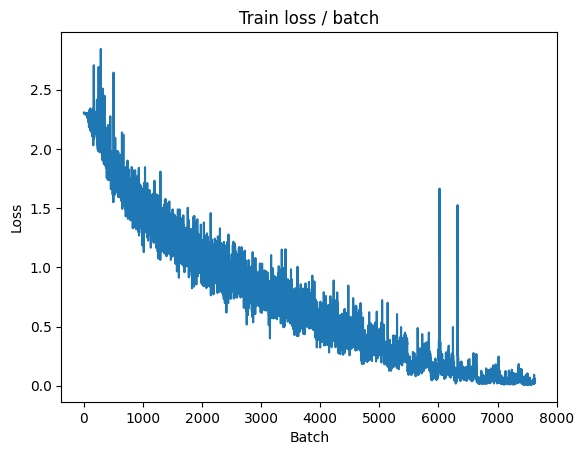


===============> Total time 7s	Avg loss 0.0748	Avg Prec@1 98.12 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.105s (0.105s)	Loss 1.3418 (1.3418)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.4198	Avg Prec@1 70.67 %	Avg Prec@5 97.24 %



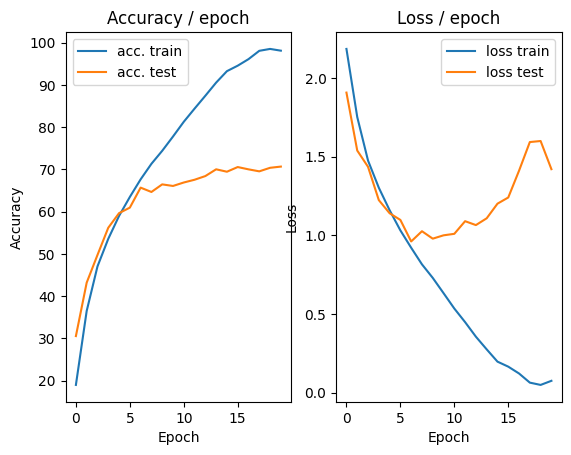

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.178s (0.178s)	Loss 0.0276 (0.0276)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


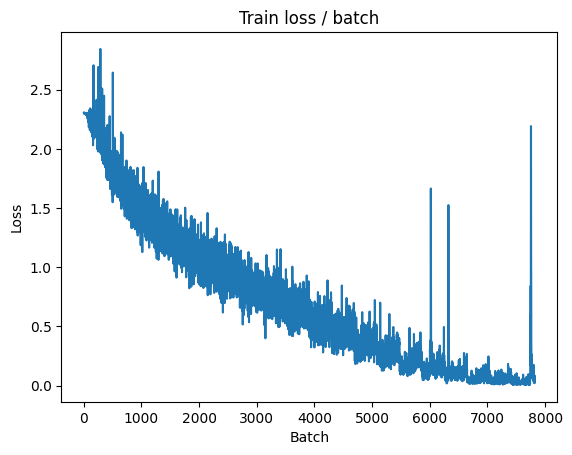

[TRAIN Batch 200/391]	Time 0.012s (0.023s)	Loss 0.0193 (0.0295)	Prec@1 100.0 ( 99.2)	Prec@5 100.0 (100.0)


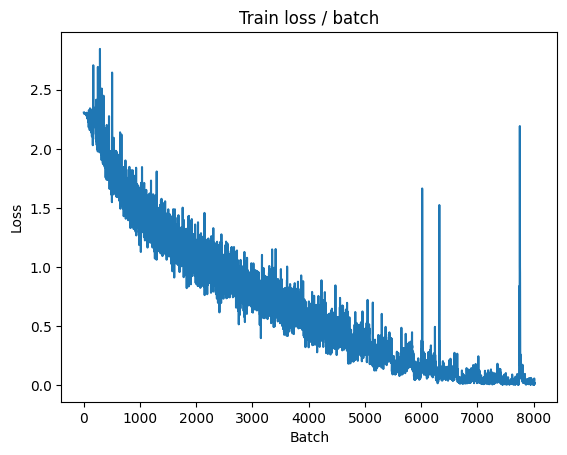


===============> Total time 8s	Avg loss 0.0324	Avg Prec@1 99.09 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.110s (0.110s)	Loss 2.0209 (2.0209)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.7019	Avg Prec@1 70.79 %	Avg Prec@5 97.34 %



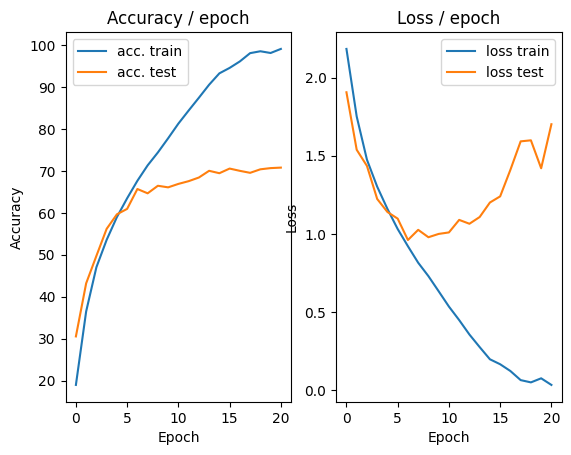

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.142s (0.142s)	Loss 0.0218 (0.0218)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


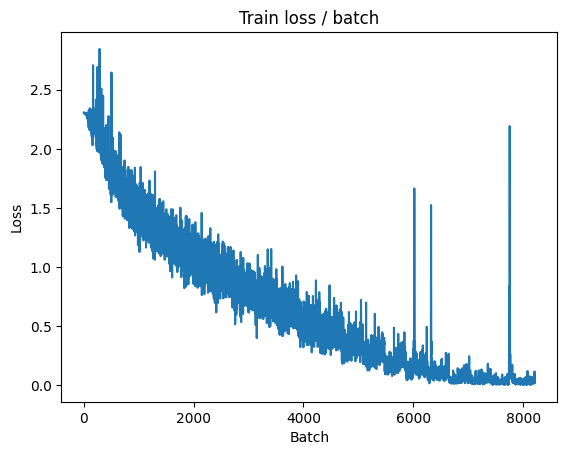

[TRAIN Batch 200/391]	Time 0.022s (0.019s)	Loss 0.0091 (0.0153)	Prec@1 100.0 ( 99.7)	Prec@5 100.0 (100.0)


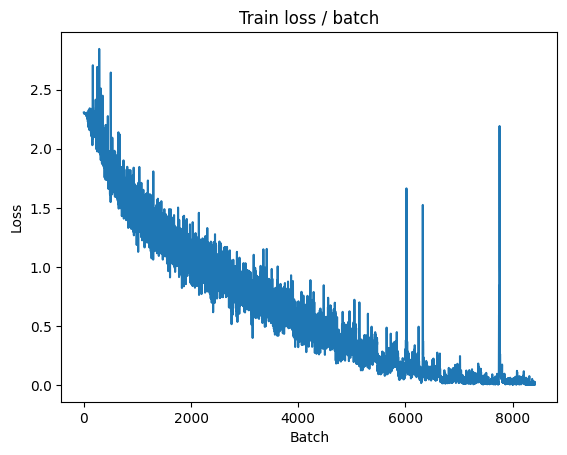


===============> Total time 8s	Avg loss 0.0202	Avg Prec@1 99.50 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 1.6843 (1.6843)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.8563	Avg Prec@1 70.51 %	Avg Prec@5 96.89 %



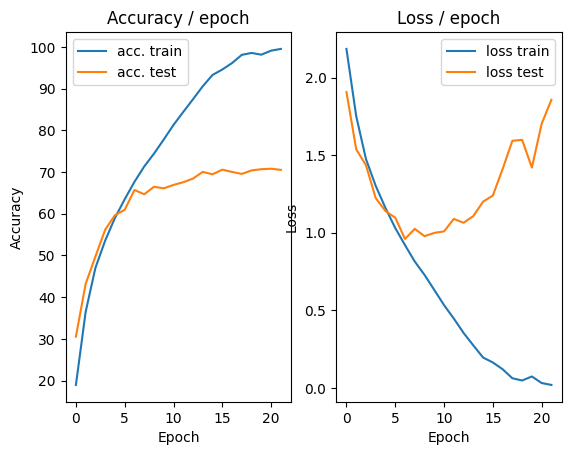

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 0.0034 (0.0034)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


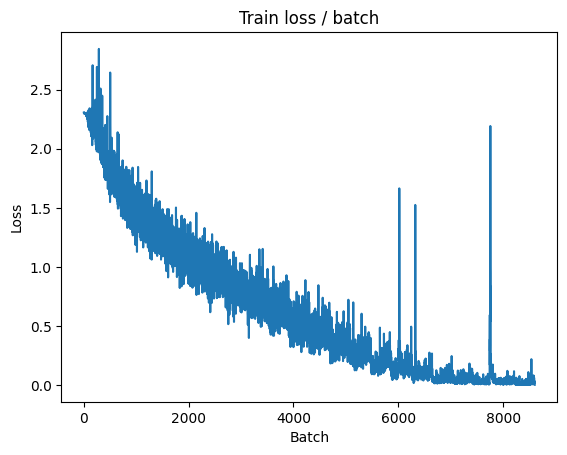

[TRAIN Batch 200/391]	Time 0.025s (0.019s)	Loss 0.0071 (0.0119)	Prec@1 100.0 ( 99.7)	Prec@5 100.0 (100.0)


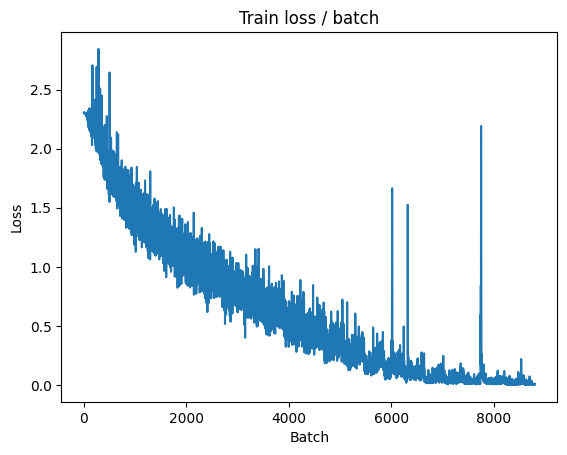


===============> Total time 7s	Avg loss 0.0141	Avg Prec@1 99.65 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 1.7311 (1.7311)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.8381	Avg Prec@1 71.62 %	Avg Prec@5 97.42 %



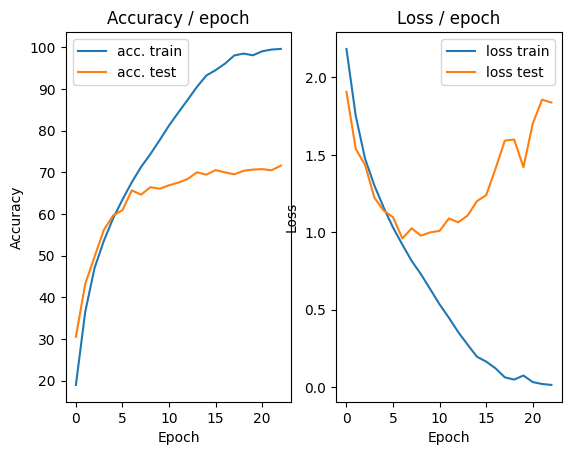

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.146s (0.146s)	Loss 0.0228 (0.0228)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


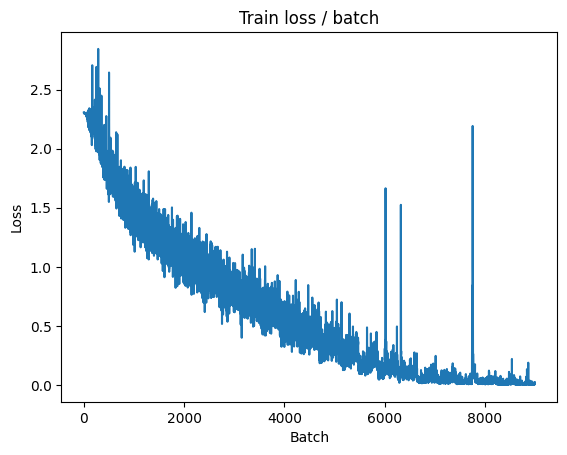

[TRAIN Batch 200/391]	Time 0.009s (0.019s)	Loss 0.0033 (0.0038)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


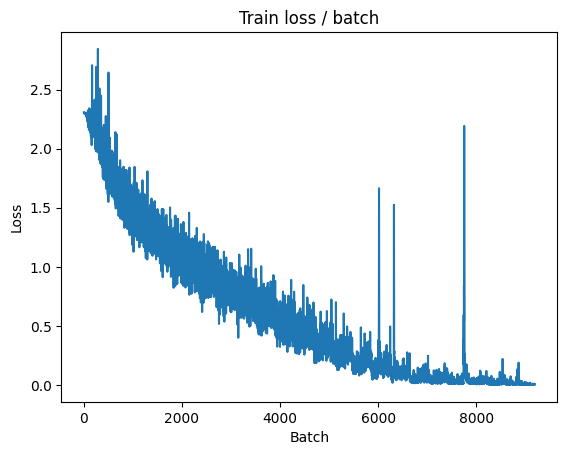


===============> Total time 7s	Avg loss 0.0031	Avg Prec@1 99.96 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 1.8548 (1.8548)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.8919	Avg Prec@1 72.13 %	Avg Prec@5 97.47 %



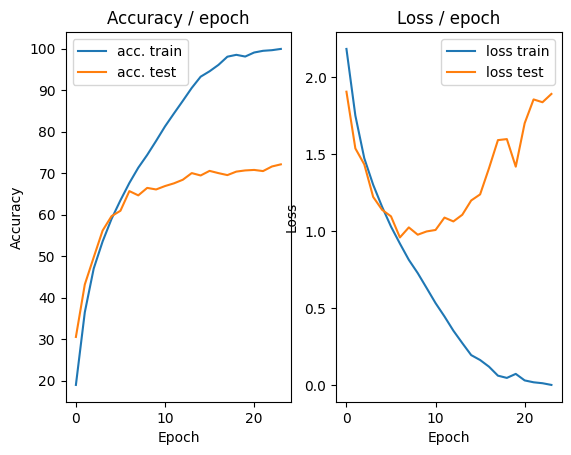

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.154s (0.154s)	Loss 0.0010 (0.0010)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


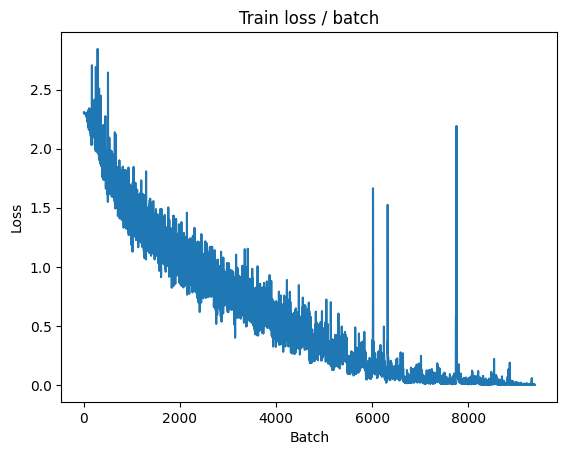

[TRAIN Batch 200/391]	Time 0.008s (0.029s)	Loss 0.0006 (0.0011)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


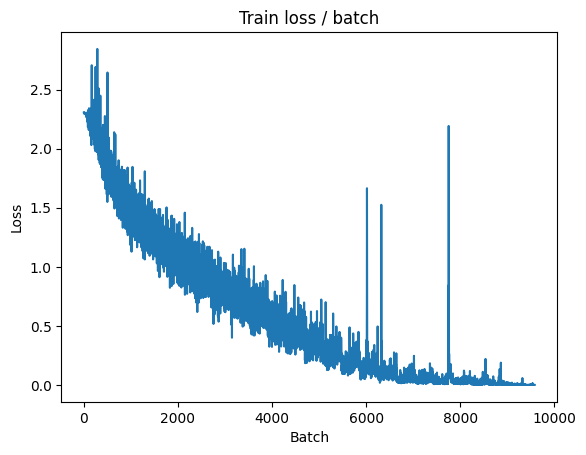


===============> Total time 9s	Avg loss 0.0014	Avg Prec@1 99.98 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.121s (0.121s)	Loss 1.8862 (1.8862)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.9625	Avg Prec@1 72.30 %	Avg Prec@5 97.44 %



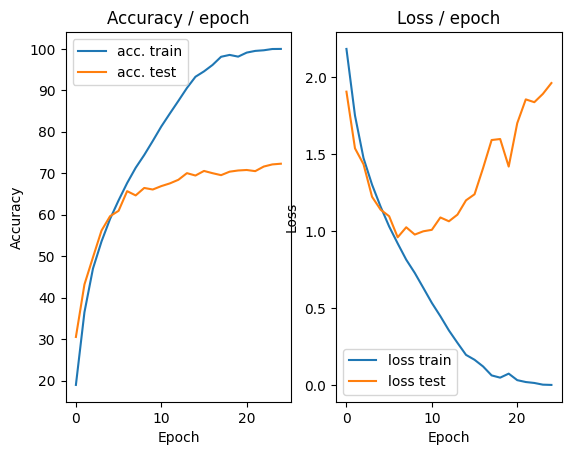

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.152s (0.152s)	Loss 0.0006 (0.0006)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


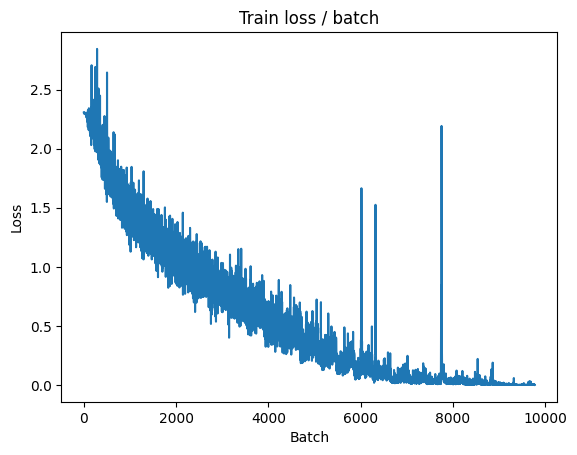

[TRAIN Batch 200/391]	Time 0.013s (0.022s)	Loss 0.0004 (0.0006)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


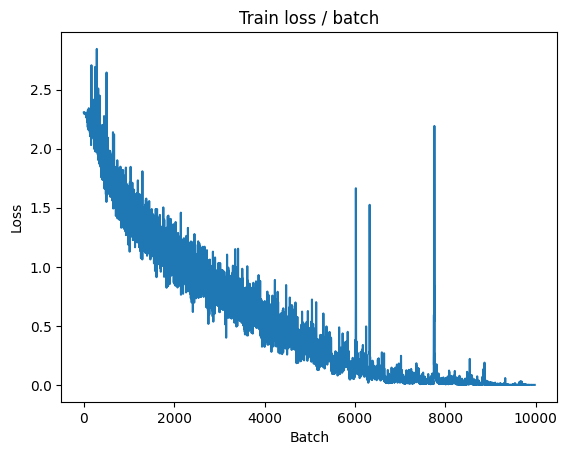


===============> Total time 8s	Avg loss 0.0006	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.103s (0.103s)	Loss 1.9578 (1.9578)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.0135	Avg Prec@1 72.42 %	Avg Prec@5 97.47 %



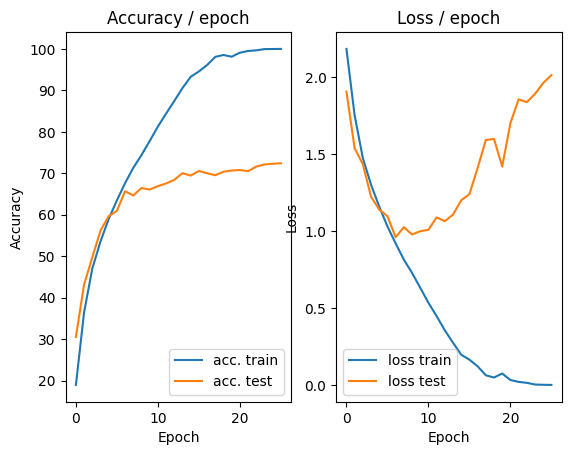

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.157s (0.157s)	Loss 0.0005 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


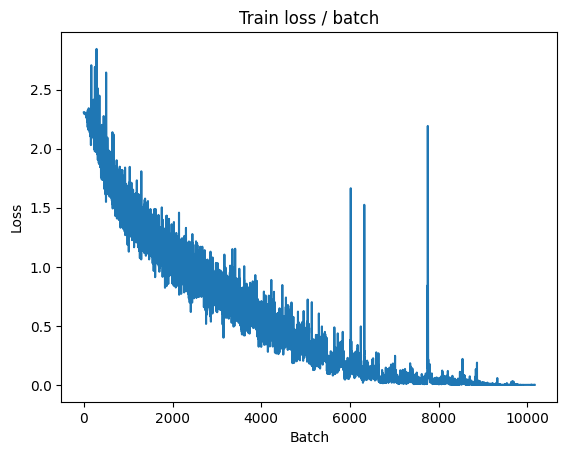

[TRAIN Batch 200/391]	Time 0.008s (0.019s)	Loss 0.0005 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


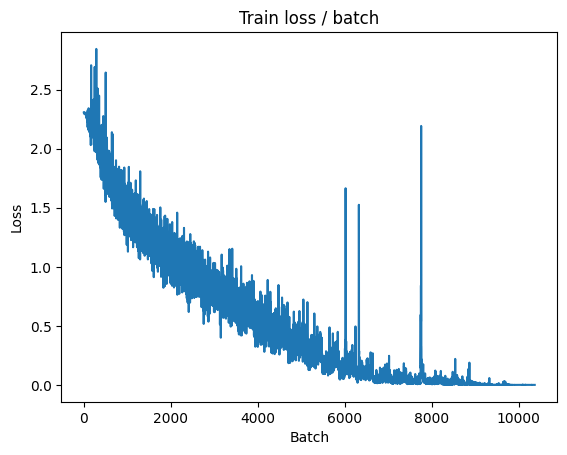


===============> Total time 8s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.098s (0.098s)	Loss 1.9772 (1.9772)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.0504	Avg Prec@1 72.37 %	Avg Prec@5 97.48 %



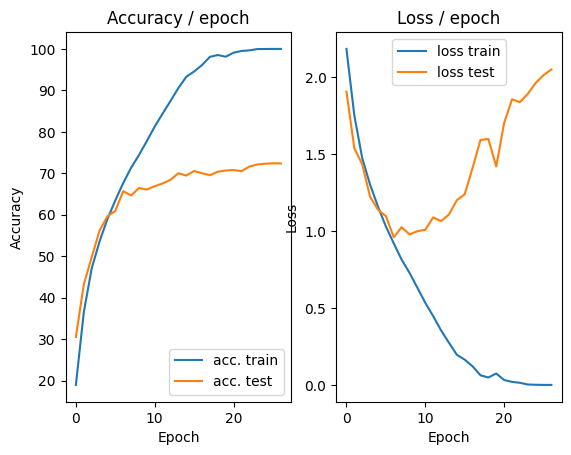

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.0007 (0.0007)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


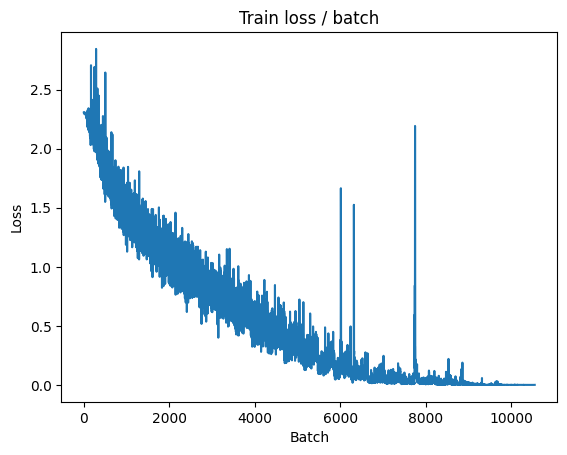

[TRAIN Batch 200/391]	Time 0.033s (0.019s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


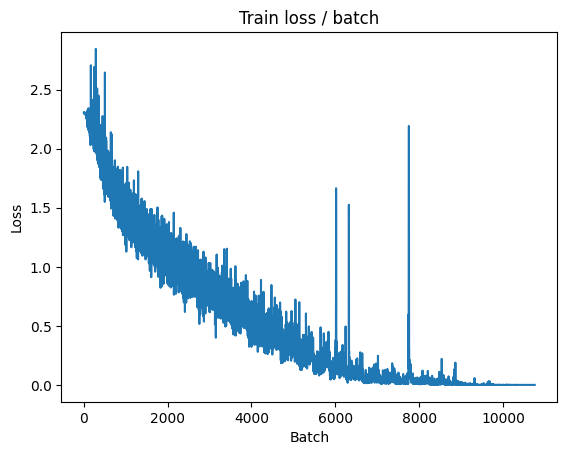


===============> Total time 7s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.108s (0.108s)	Loss 2.0106 (2.0106)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.0823	Avg Prec@1 72.41 %	Avg Prec@5 97.46 %



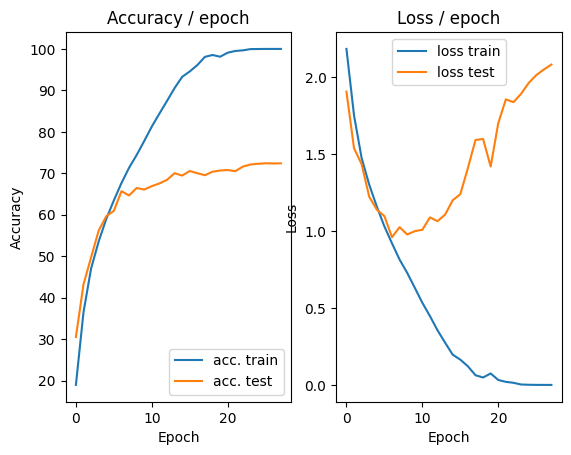

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.209s (0.209s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


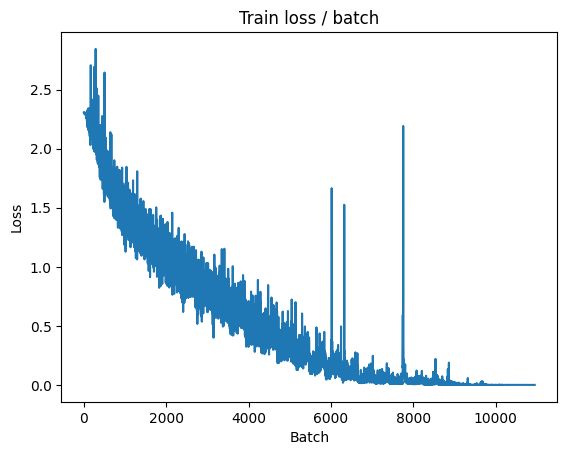

[TRAIN Batch 200/391]	Time 0.021s (0.020s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


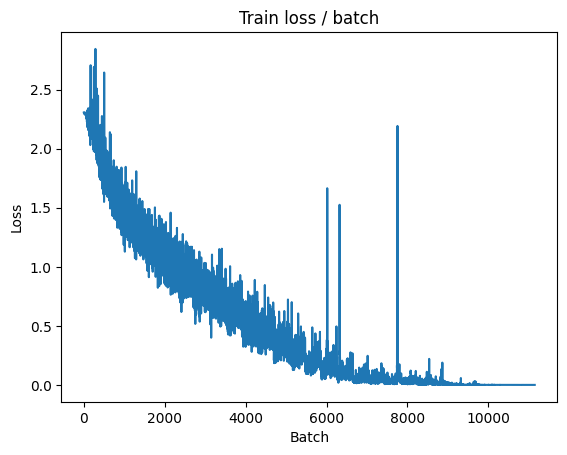


===============> Total time 7s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.106s (0.106s)	Loss 2.0453 (2.0453)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.1091	Avg Prec@1 72.46 %	Avg Prec@5 97.50 %



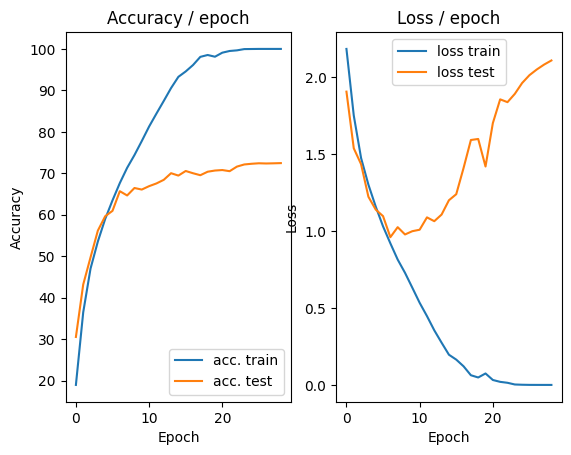

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.178s (0.178s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


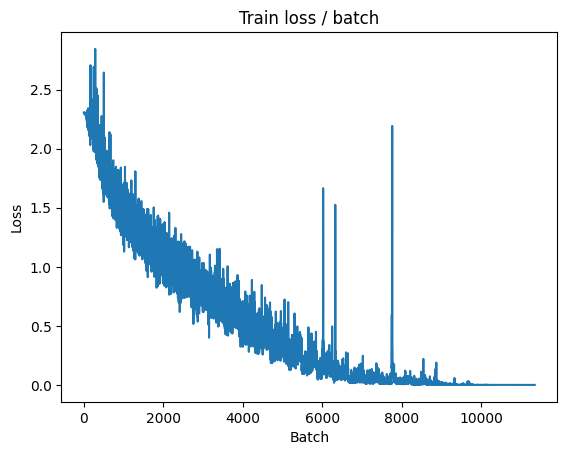

[TRAIN Batch 200/391]	Time 0.016s (0.024s)	Loss 0.0002 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


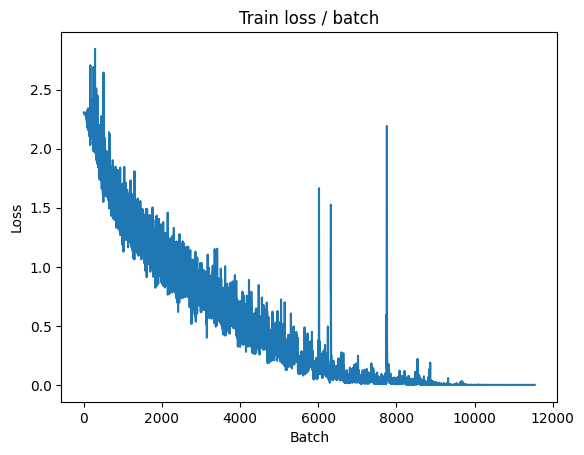


===============> Total time 8s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.123s (0.123s)	Loss 2.0628 (2.0628)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.1326	Avg Prec@1 72.43 %	Avg Prec@5 97.48 %



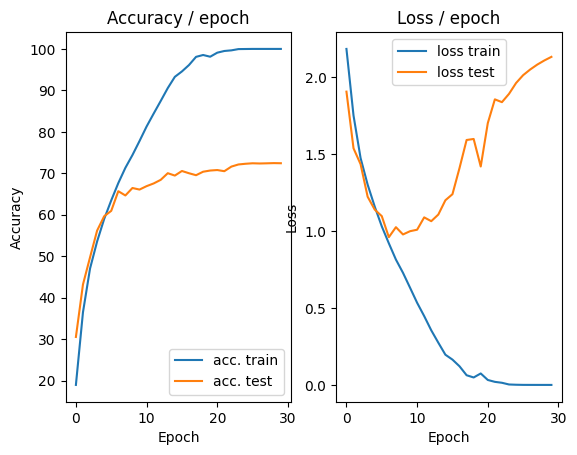

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.172s (0.172s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


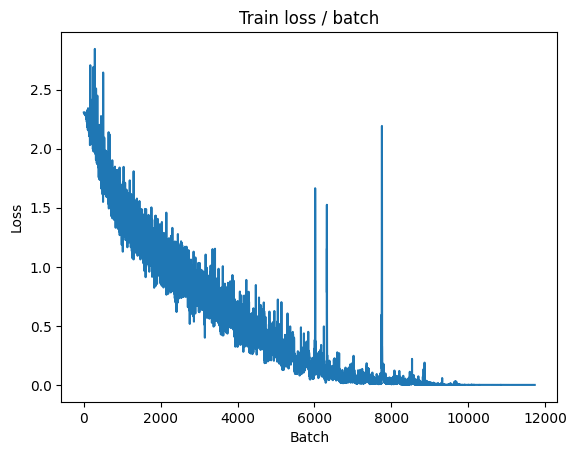

[TRAIN Batch 200/391]	Time 0.043s (0.020s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


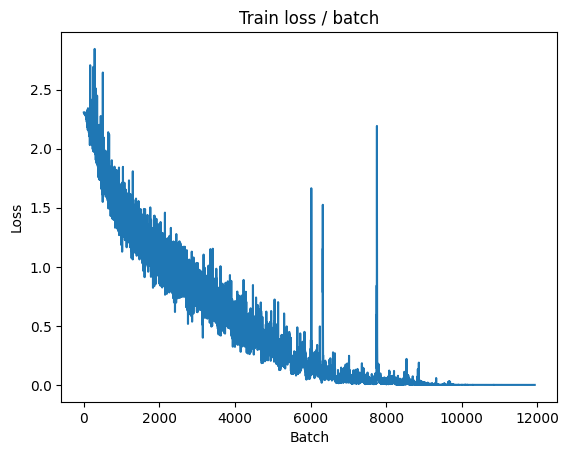


===============> Total time 8s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.111s (0.111s)	Loss 2.0906 (2.0906)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.1531	Avg Prec@1 72.51 %	Avg Prec@5 97.49 %



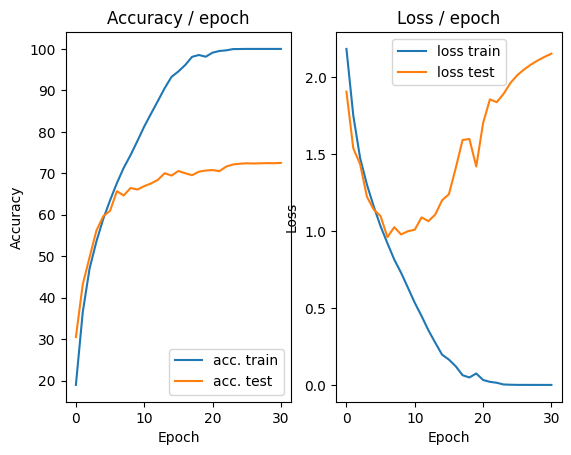

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.142s (0.142s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


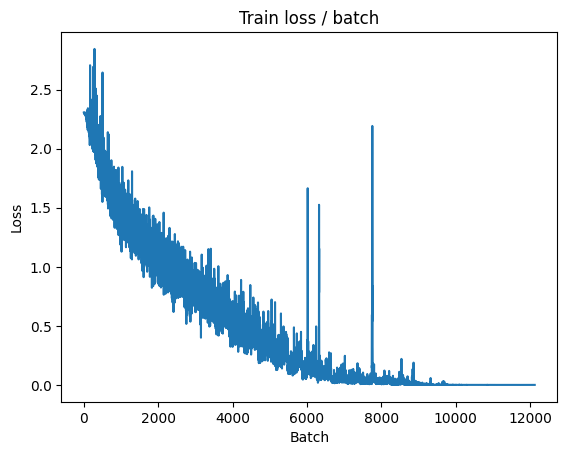

[TRAIN Batch 200/391]	Time 0.007s (0.019s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


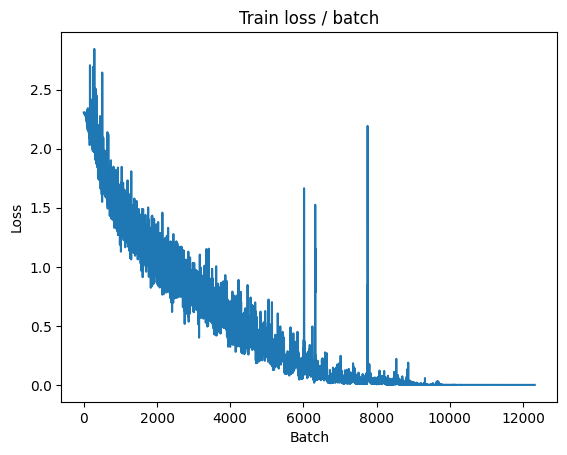


===============> Total time 7s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 2.1072 (2.1072)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.1740	Avg Prec@1 72.46 %	Avg Prec@5 97.48 %



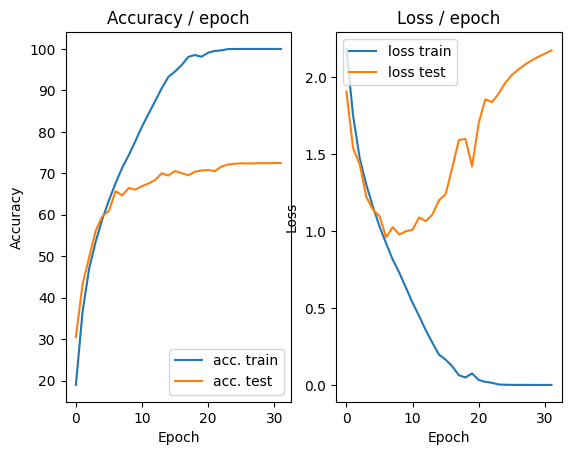

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


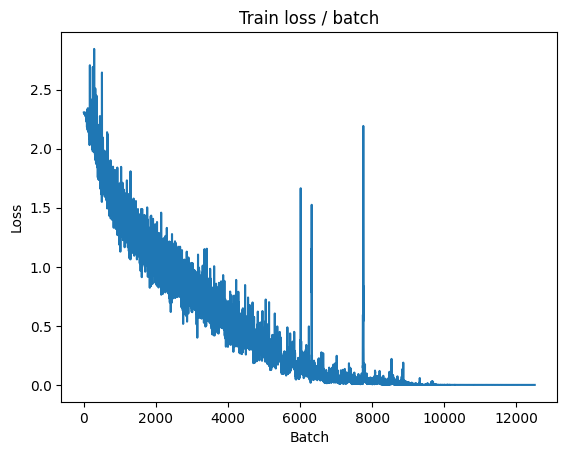

[TRAIN Batch 200/391]	Time 0.024s (0.020s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


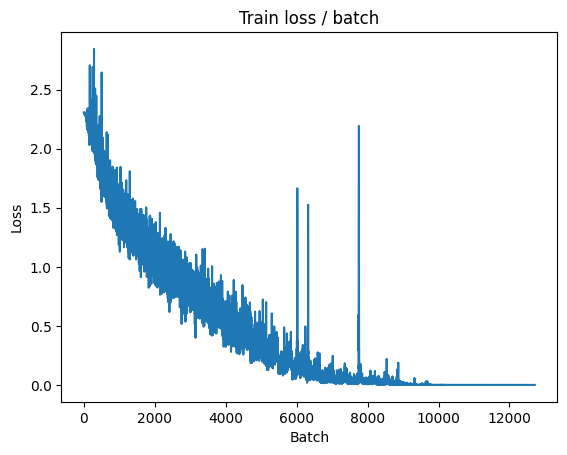


===============> Total time 7s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.108s (0.108s)	Loss 2.1185 (2.1185)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.1913	Avg Prec@1 72.54 %	Avg Prec@5 97.48 %



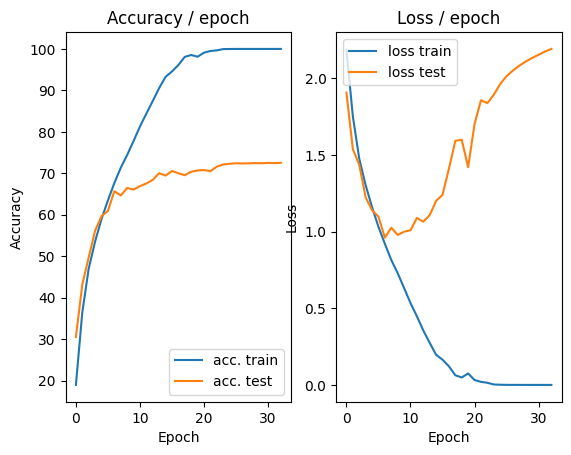

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.190s (0.190s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


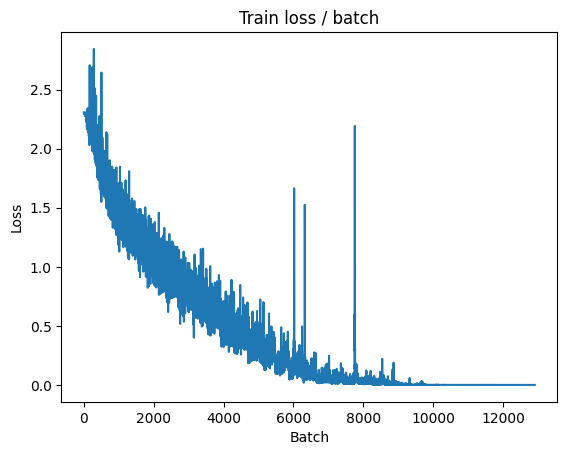

[TRAIN Batch 200/391]	Time 0.009s (0.023s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


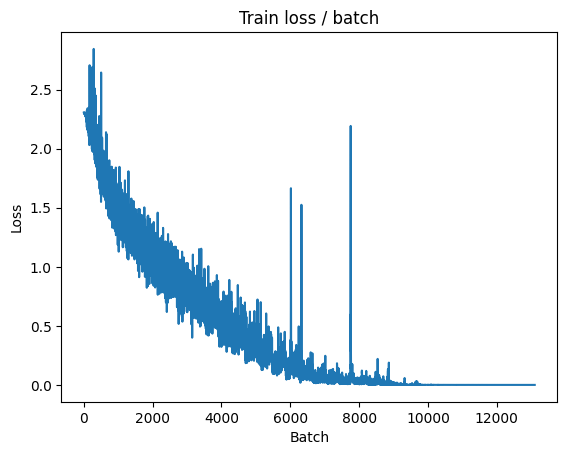


===============> Total time 8s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.107s (0.107s)	Loss 2.1385 (2.1385)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.2066	Avg Prec@1 72.50 %	Avg Prec@5 97.47 %



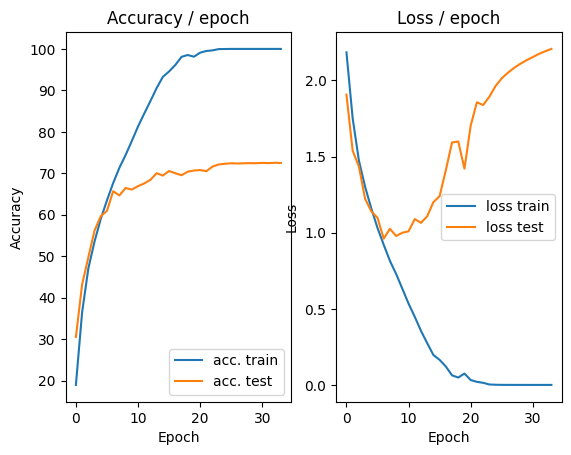

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.151s (0.151s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


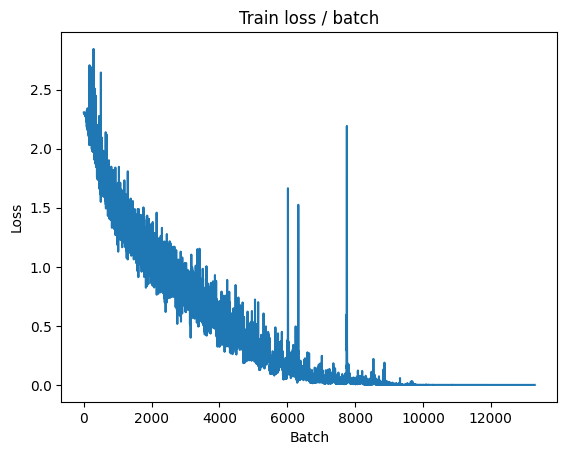

[TRAIN Batch 200/391]	Time 0.027s (0.024s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


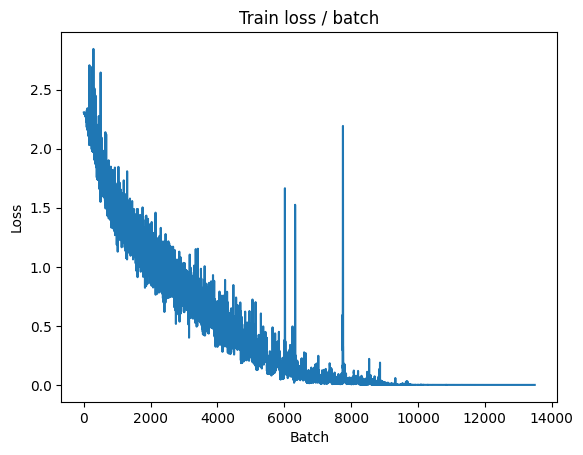


===============> Total time 8s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.117s (0.117s)	Loss 2.1448 (2.1448)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.2232	Avg Prec@1 72.61 %	Avg Prec@5 97.50 %



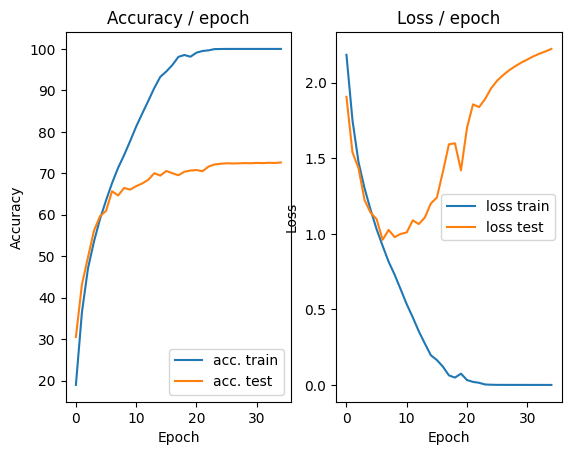

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.164s (0.164s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


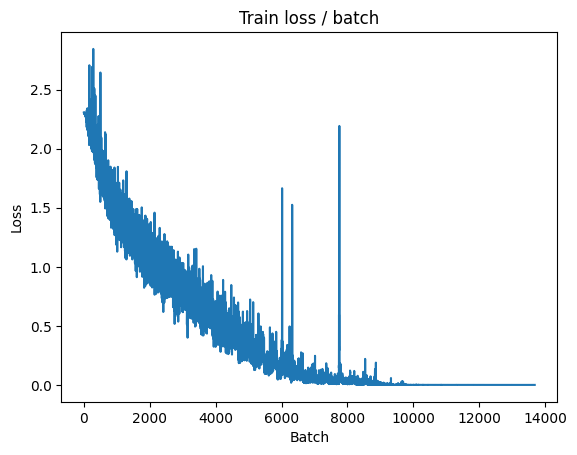

[TRAIN Batch 200/391]	Time 0.010s (0.019s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


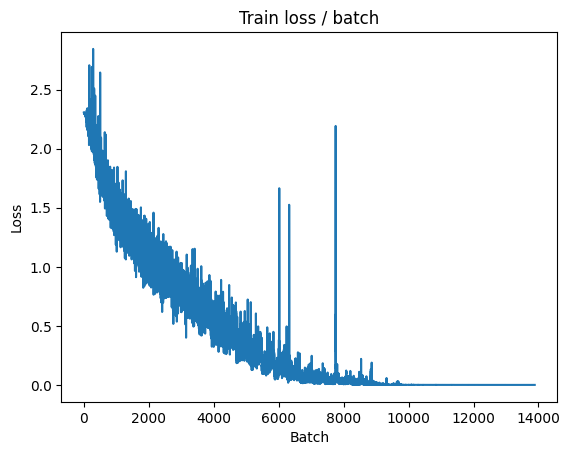


===============> Total time 8s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.114s (0.114s)	Loss 2.1620 (2.1620)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.2370	Avg Prec@1 72.57 %	Avg Prec@5 97.50 %



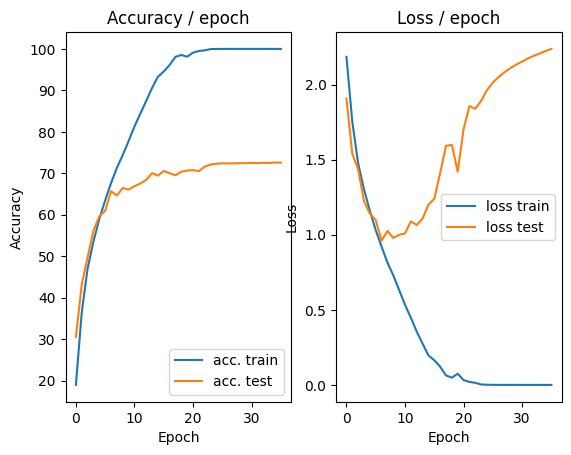

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


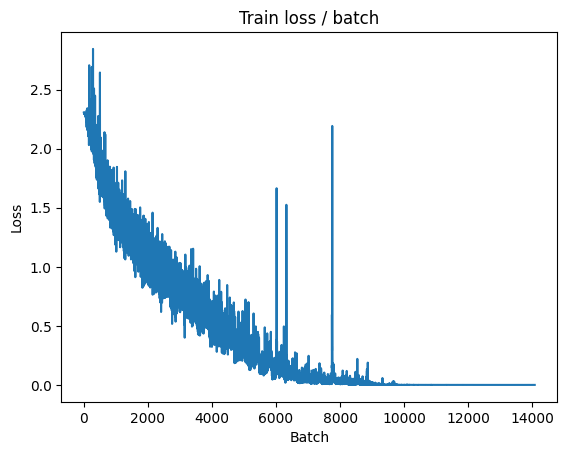

[TRAIN Batch 200/391]	Time 0.019s (0.019s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


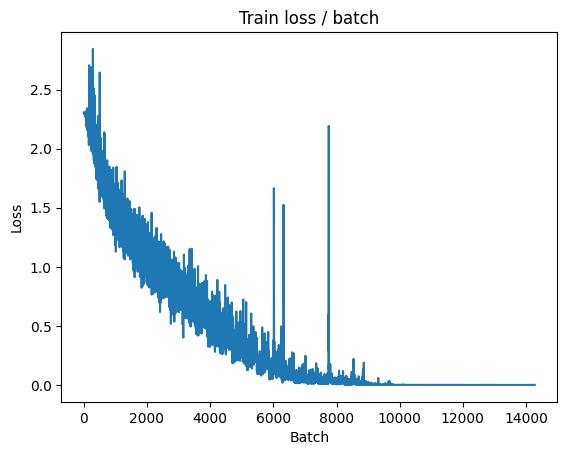


===============> Total time 7s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 2.1746 (2.1746)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 2.2504	Avg Prec@1 72.65 %	Avg Prec@5 97.53 %



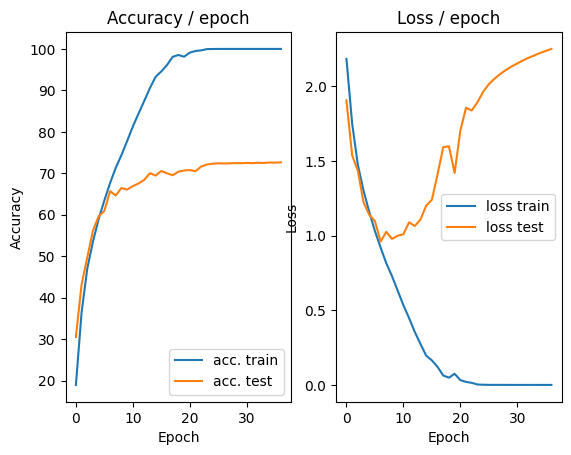

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


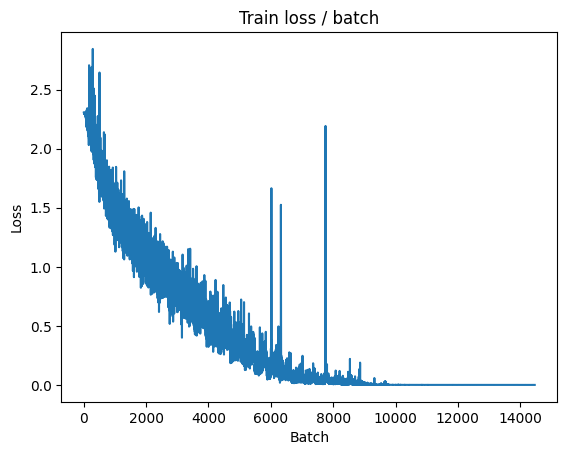

[TRAIN Batch 200/391]	Time 0.032s (0.019s)	Loss 0.0002 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


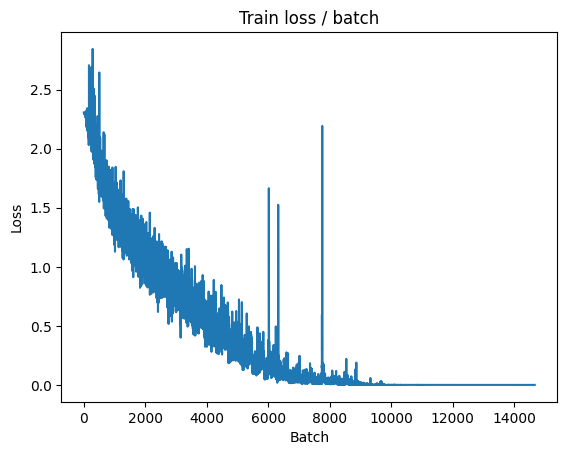


===============> Total time 7s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.104s (0.104s)	Loss 2.1868 (2.1868)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.2631	Avg Prec@1 72.64 %	Avg Prec@5 97.51 %



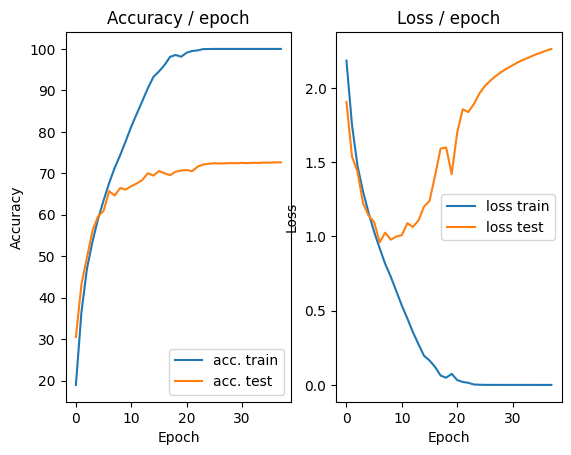

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.200s (0.200s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


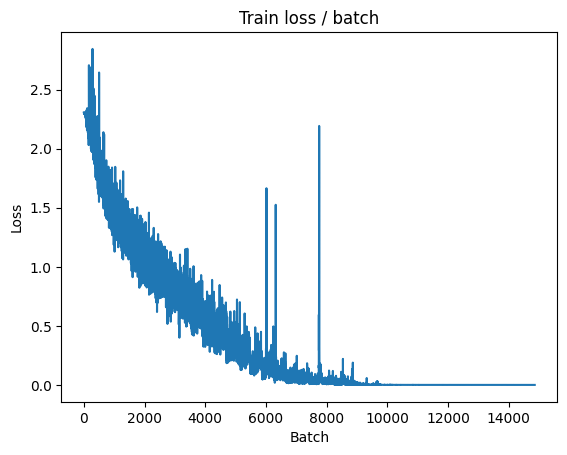

[TRAIN Batch 200/391]	Time 0.009s (0.024s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


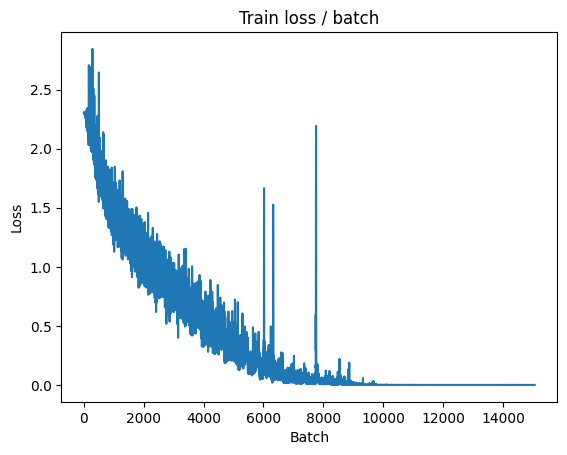


===============> Total time 8s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.097s (0.097s)	Loss 2.2009 (2.2009)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.2734	Avg Prec@1 72.63 %	Avg Prec@5 97.52 %



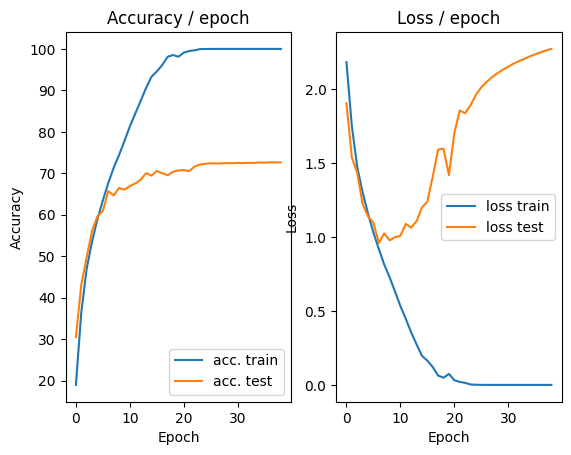

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.151s (0.151s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


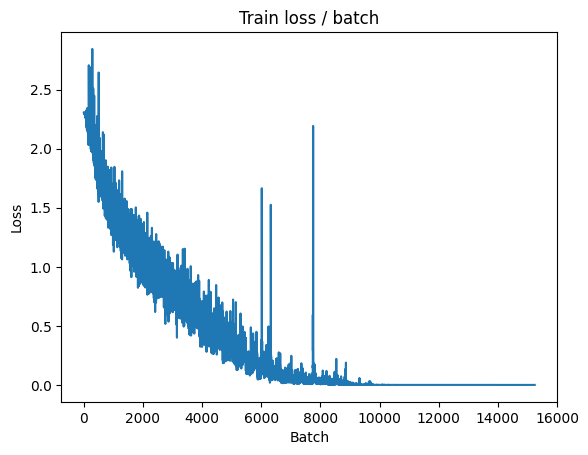

[TRAIN Batch 200/391]	Time 0.054s (0.024s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


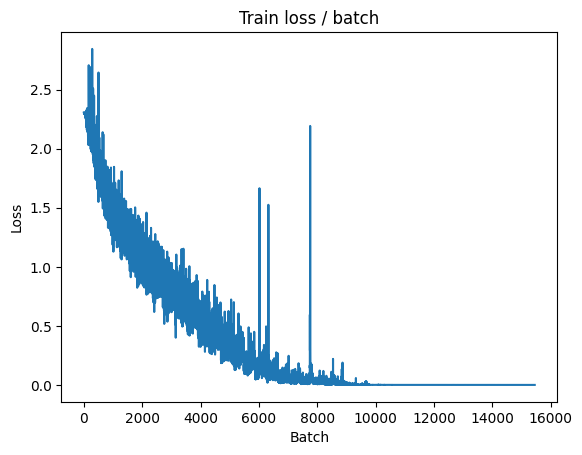


===============> Total time 8s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.117s (0.117s)	Loss 2.2110 (2.2110)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.2840	Avg Prec@1 72.60 %	Avg Prec@5 97.54 %



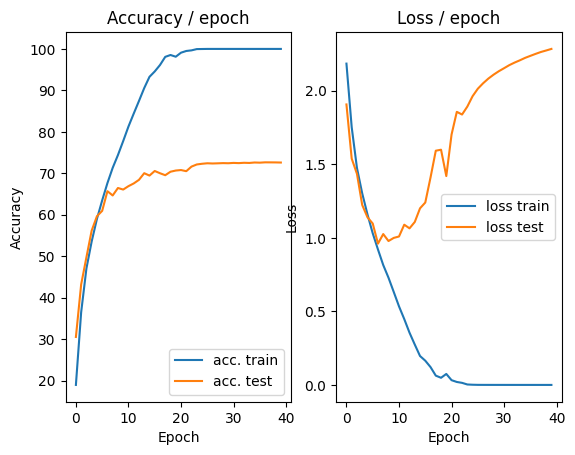

In [ ]:
main(128, 0.1, 40, cuda=True)

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.113s (0.113s)	Loss 2.3024 (2.3024)	Prec@1  16.4 ( 16.4)	Prec@5  48.4 ( 48.4)


<Figure size 640x480 with 0 Axes>

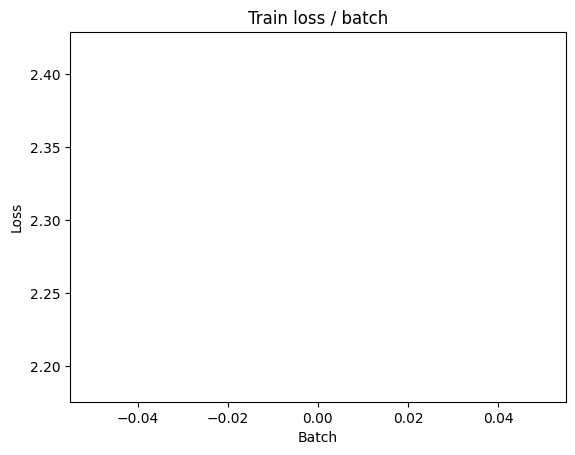

[TRAIN Batch 200/391]	Time 0.011s (0.023s)	Loss 2.2913 (2.3077)	Prec@1   9.4 ( 10.3)	Prec@5  56.2 ( 51.4)


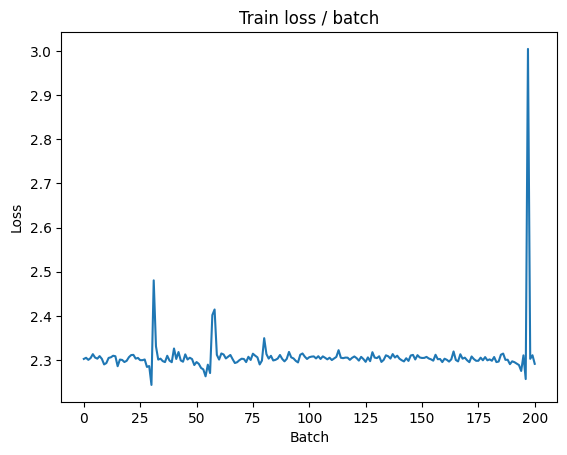


===============> Total time 8s	Avg loss 2.3195	Avg Prec@1 10.17 %	Avg Prec@5 50.71 %

[EVAL Batch 000/079]	Time 0.102s (0.102s)	Loss 2.3064 (2.3064)	Prec@1  10.2 ( 10.2)	Prec@5  47.7 ( 47.7)

===============> Total time 1s	Avg loss 2.3032	Avg Prec@1 10.03 %	Avg Prec@5 50.21 %



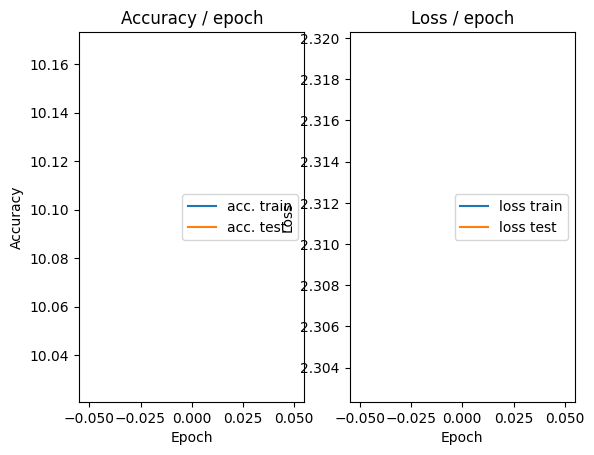

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.117s (0.117s)	Loss 2.3076 (2.3076)	Prec@1   7.8 (  7.8)	Prec@5  48.4 ( 48.4)


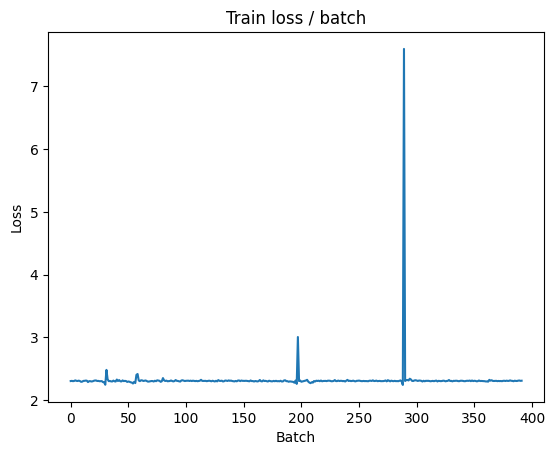

[TRAIN Batch 200/391]	Time 0.019s (0.019s)	Loss 2.3039 (2.3042)	Prec@1   5.5 (  9.9)	Prec@5  55.5 ( 50.3)


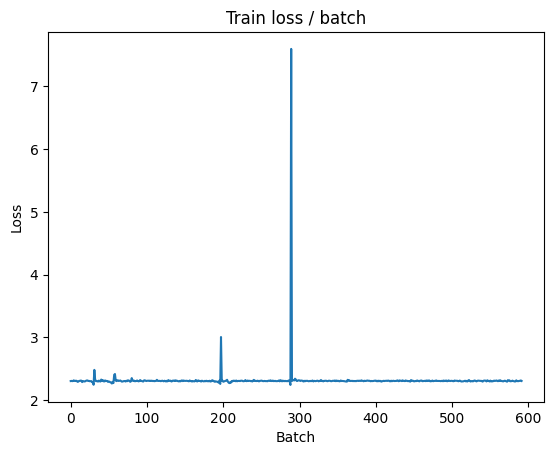


===============> Total time 8s	Avg loss 2.3044	Avg Prec@1  9.77 %	Avg Prec@5 49.86 %

[EVAL Batch 000/079]	Time 0.099s (0.099s)	Loss 2.3102 (2.3102)	Prec@1  10.2 ( 10.2)	Prec@5  41.4 ( 41.4)

===============> Total time 1s	Avg loss 2.3040	Avg Prec@1 10.03 %	Avg Prec@5 49.86 %



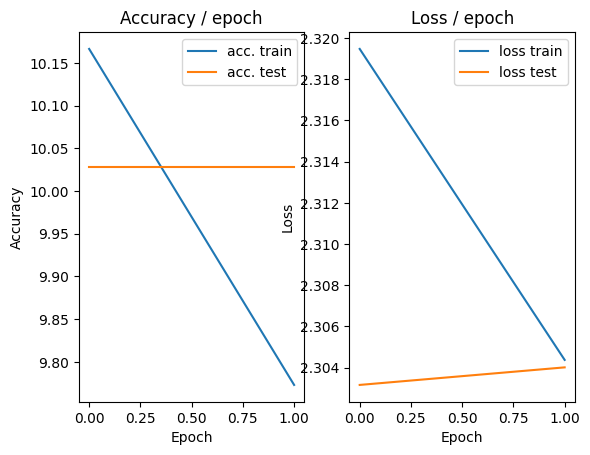

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.113s (0.113s)	Loss 2.2935 (2.2935)	Prec@1  14.1 ( 14.1)	Prec@5  64.1 ( 64.1)


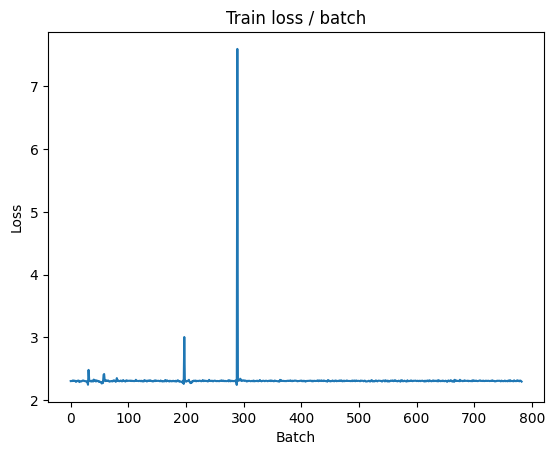

[TRAIN Batch 200/391]	Time 0.031s (0.019s)	Loss 2.2988 (2.3043)	Prec@1  12.5 ( 10.0)	Prec@5  54.7 ( 50.0)


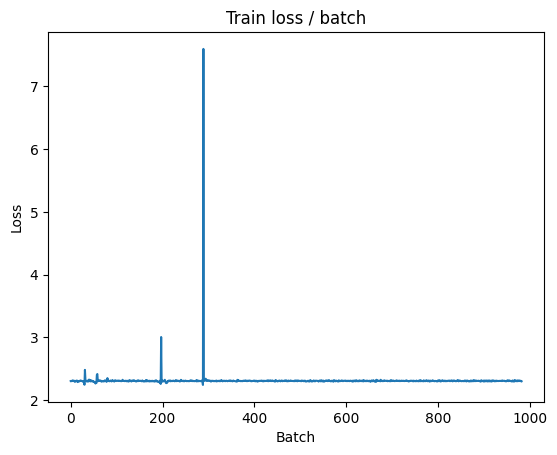


===============> Total time 7s	Avg loss 2.3043	Avg Prec@1  9.93 %	Avg Prec@5 49.92 %

[EVAL Batch 000/079]	Time 0.161s (0.161s)	Loss 2.3110 (2.3110)	Prec@1   7.8 (  7.8)	Prec@5  50.0 ( 50.0)

===============> Total time 1s	Avg loss 2.3050	Avg Prec@1  9.89 %	Avg Prec@5 50.21 %



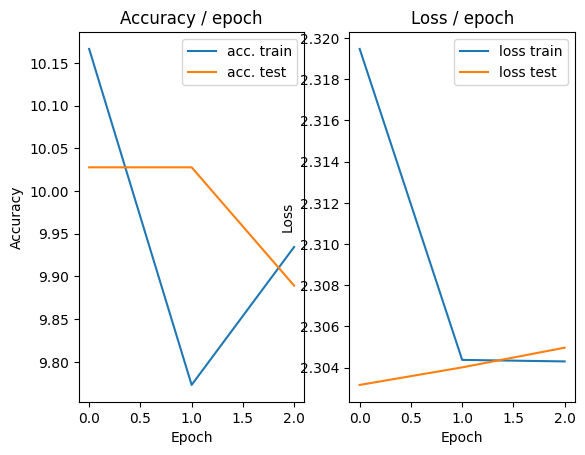

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.118s (0.118s)	Loss 2.2866 (2.2866)	Prec@1  14.1 ( 14.1)	Prec@5  62.5 ( 62.5)


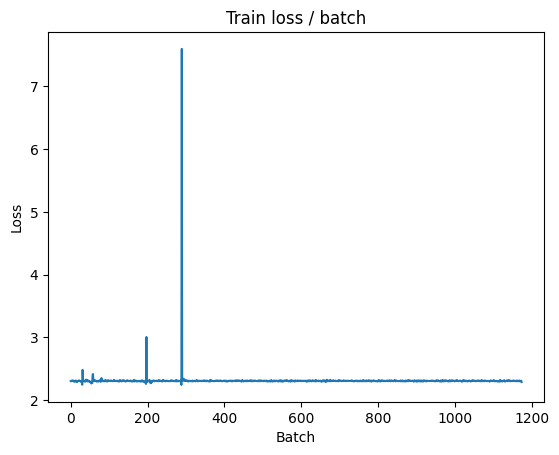

[TRAIN Batch 200/391]	Time 0.006s (0.019s)	Loss 2.2969 (2.3041)	Prec@1  10.2 (  9.8)	Prec@5  57.0 ( 50.1)


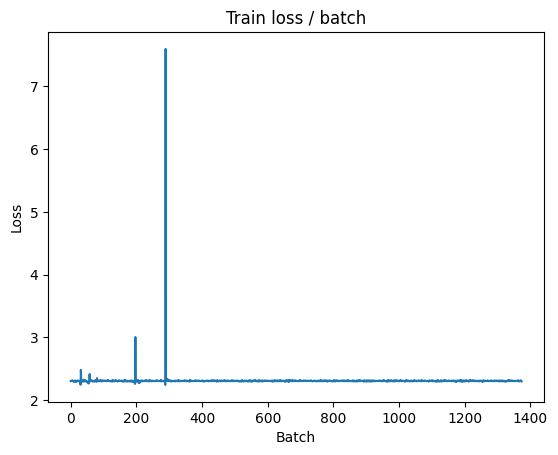


===============> Total time 7s	Avg loss 2.3041	Avg Prec@1  9.81 %	Avg Prec@5 50.05 %

[EVAL Batch 000/079]	Time 0.098s (0.098s)	Loss 2.3035 (2.3035)	Prec@1   8.6 (  8.6)	Prec@5  51.6 ( 51.6)

===============> Total time 1s	Avg loss 2.3053	Avg Prec@1  9.96 %	Avg Prec@5 50.00 %



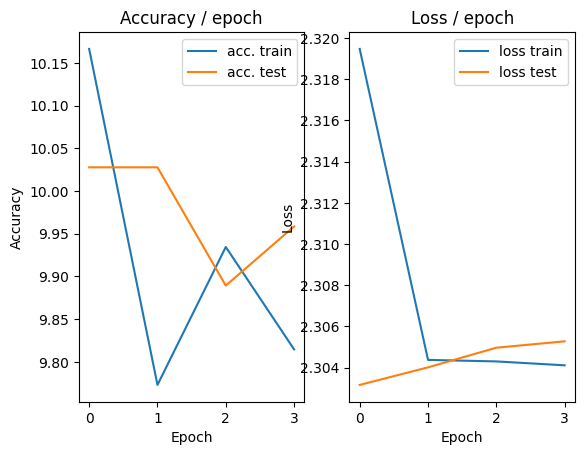

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.202s (0.202s)	Loss 2.3022 (2.3022)	Prec@1  10.2 ( 10.2)	Prec@5  48.4 ( 48.4)


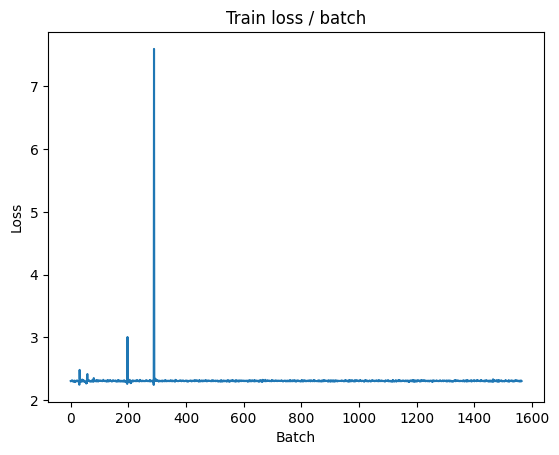

[TRAIN Batch 200/391]	Time 0.009s (0.023s)	Loss 2.3001 (2.3046)	Prec@1  13.3 (  9.7)	Prec@5  53.9 ( 49.6)


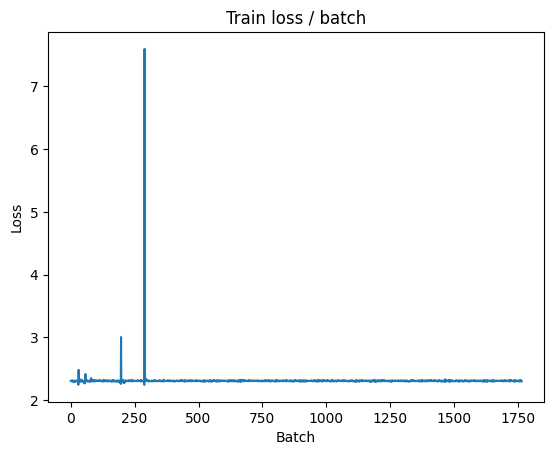


===============> Total time 8s	Avg loss 2.3045	Avg Prec@1  9.88 %	Avg Prec@5 49.53 %

[EVAL Batch 000/079]	Time 0.101s (0.101s)	Loss 2.3029 (2.3029)	Prec@1   7.0 (  7.0)	Prec@5  53.1 ( 53.1)

===============> Total time 1s	Avg loss 2.3037	Avg Prec@1 10.10 %	Avg Prec@5 50.00 %



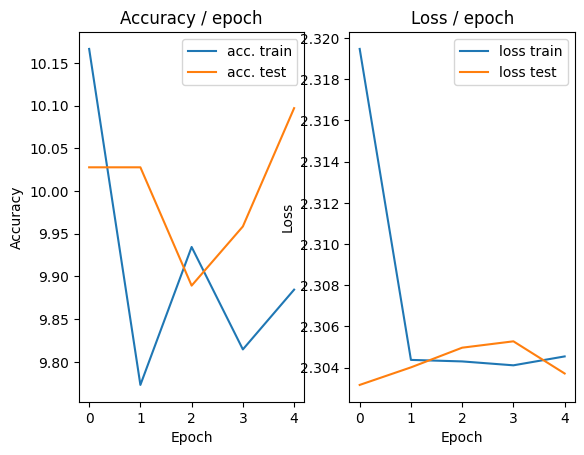

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.117s (0.117s)	Loss 2.3017 (2.3017)	Prec@1  14.8 ( 14.8)	Prec@5  51.6 ( 51.6)


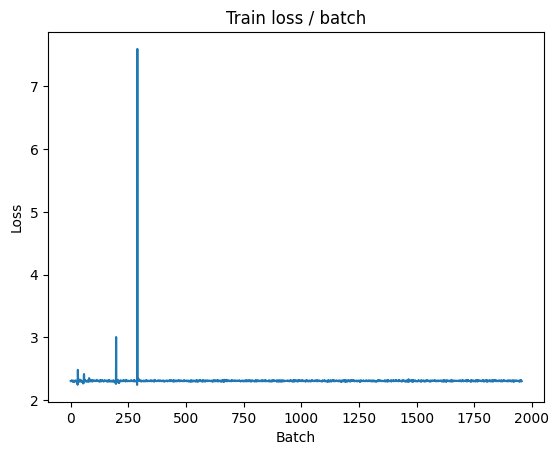

[TRAIN Batch 200/391]	Time 0.019s (0.023s)	Loss 2.3026 (2.3046)	Prec@1   7.8 (  9.9)	Prec@5  47.7 ( 49.3)


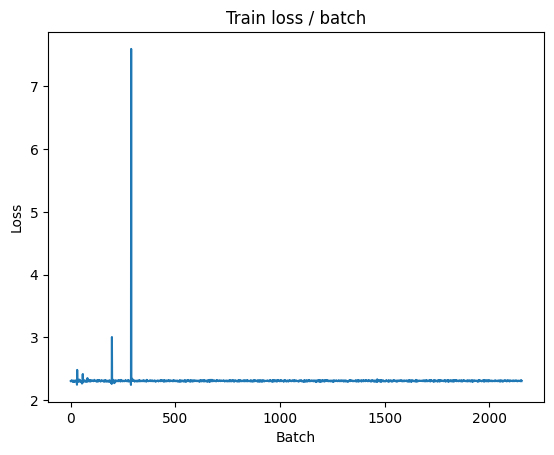


===============> Total time 8s	Avg loss 2.3045	Avg Prec@1  9.93 %	Avg Prec@5 49.53 %

[EVAL Batch 000/079]	Time 0.107s (0.107s)	Loss 2.3020 (2.3020)	Prec@1   7.8 (  7.8)	Prec@5  53.1 ( 53.1)

===============> Total time 1s	Avg loss 2.3044	Avg Prec@1  9.96 %	Avg Prec@5 49.93 %



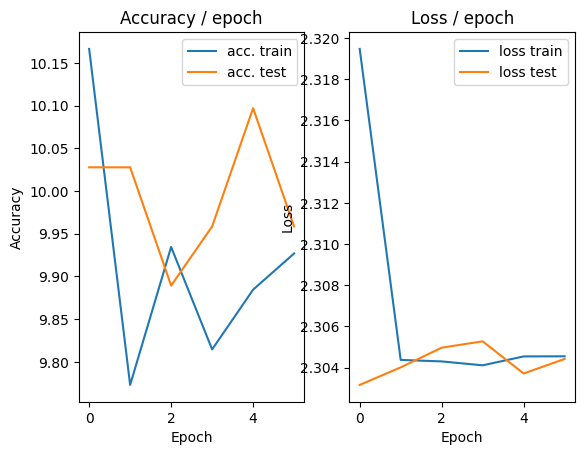

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 2.3094 (2.3094)	Prec@1   6.2 (  6.2)	Prec@5  45.3 ( 45.3)


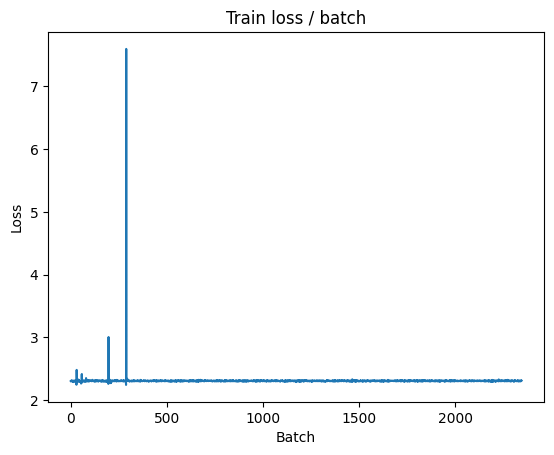

[TRAIN Batch 200/391]	Time 0.010s (0.019s)	Loss 2.3061 (2.3043)	Prec@1  10.2 (  9.8)	Prec@5  46.9 ( 50.2)


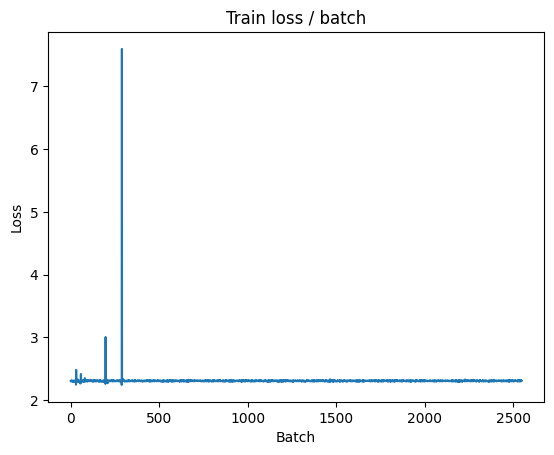


===============> Total time 8s	Avg loss 2.3044	Avg Prec@1  9.93 %	Avg Prec@5 50.00 %

[EVAL Batch 000/079]	Time 0.101s (0.101s)	Loss 2.3000 (2.3000)	Prec@1   8.6 (  8.6)	Prec@5  51.6 ( 51.6)

===============> Total time 1s	Avg loss 2.3035	Avg Prec@1  9.96 %	Avg Prec@5 50.00 %



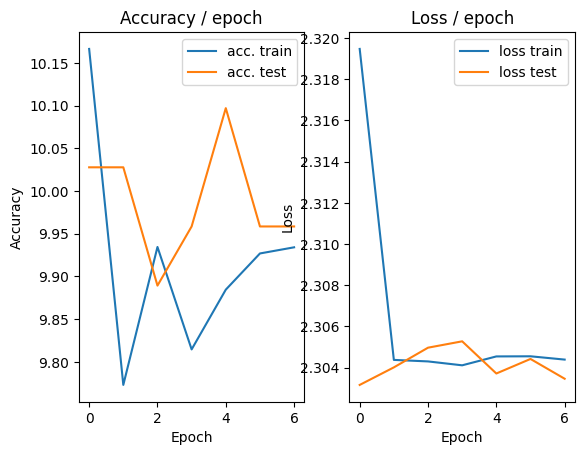

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 2.3092 (2.3092)	Prec@1   7.8 (  7.8)	Prec@5  43.0 ( 43.0)


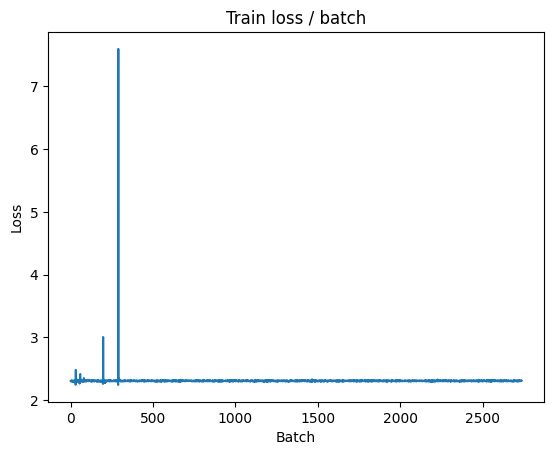

[TRAIN Batch 200/391]	Time 0.020s (0.019s)	Loss 2.3055 (2.3041)	Prec@1   9.4 ( 10.2)	Prec@5  47.7 ( 49.9)


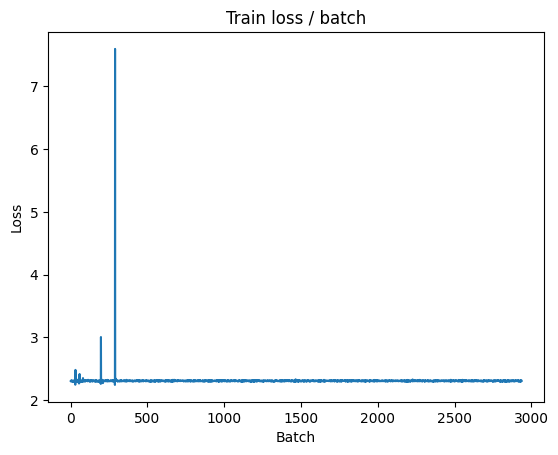


===============> Total time 7s	Avg loss 2.3044	Avg Prec@1  9.92 %	Avg Prec@5 49.79 %

[EVAL Batch 000/079]	Time 0.183s (0.183s)	Loss 2.3025 (2.3025)	Prec@1   7.8 (  7.8)	Prec@5  53.1 ( 53.1)

===============> Total time 2s	Avg loss 2.3032	Avg Prec@1  9.96 %	Avg Prec@5 49.79 %



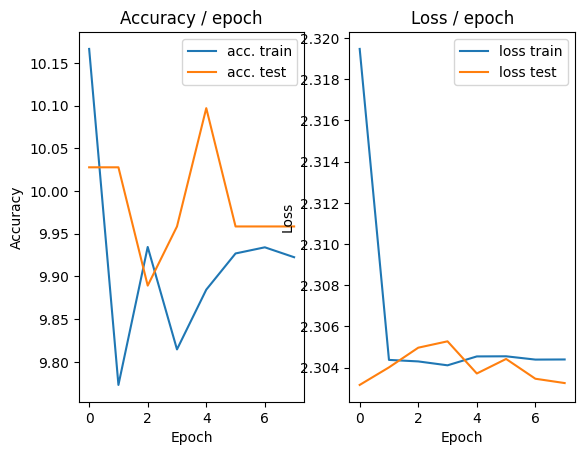

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.120s (0.120s)	Loss 2.3010 (2.3010)	Prec@1  13.3 ( 13.3)	Prec@5  55.5 ( 55.5)


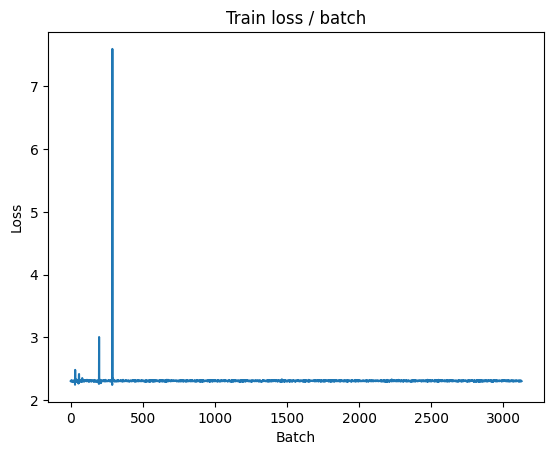

[TRAIN Batch 200/391]	Time 0.021s (0.019s)	Loss 2.3100 (2.3043)	Prec@1  10.2 ( 10.2)	Prec@5  49.2 ( 49.7)


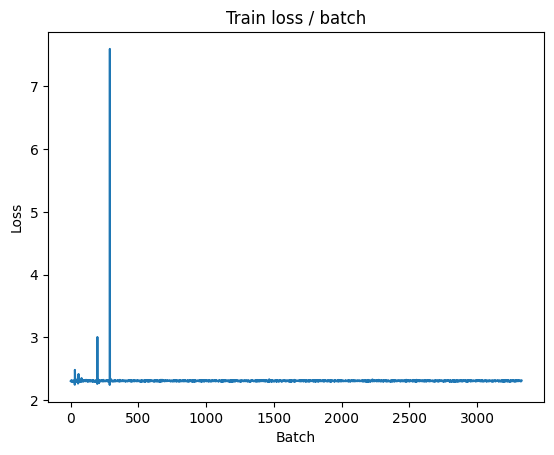


===============> Total time 7s	Avg loss 2.3043	Avg Prec@1 10.24 %	Avg Prec@5 49.76 %

[EVAL Batch 000/079]	Time 0.099s (0.099s)	Loss 2.3081 (2.3081)	Prec@1   8.6 (  8.6)	Prec@5  41.4 ( 41.4)

===============> Total time 1s	Avg loss 2.3037	Avg Prec@1  9.96 %	Avg Prec@5 49.93 %



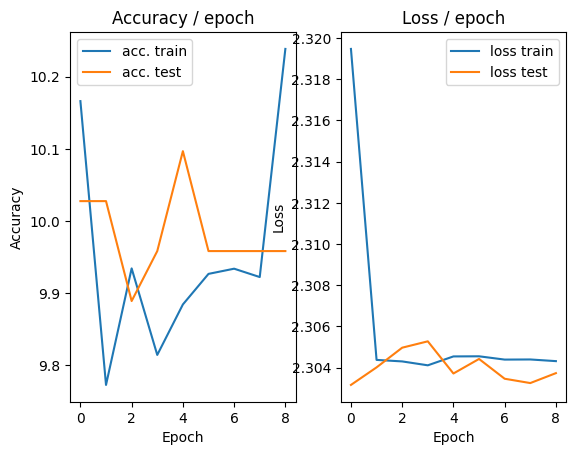

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.147s (0.147s)	Loss 2.3132 (2.3132)	Prec@1   7.0 (  7.0)	Prec@5  42.2 ( 42.2)


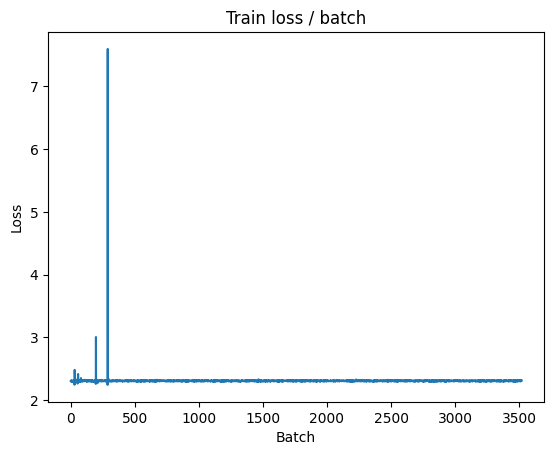

[TRAIN Batch 200/391]	Time 0.012s (0.024s)	Loss 2.3104 (2.3049)	Prec@1   6.2 (  9.9)	Prec@5  48.4 ( 48.7)


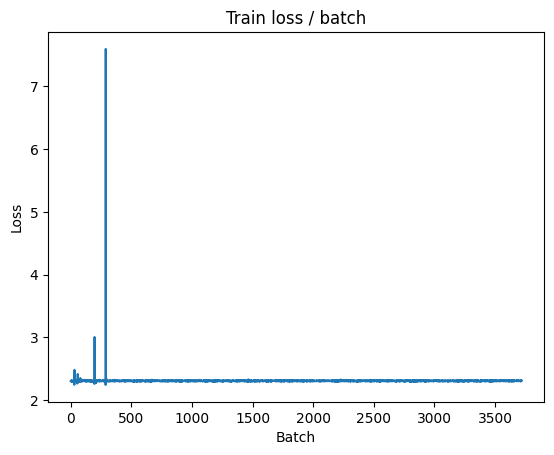


===============> Total time 8s	Avg loss 2.3048	Avg Prec@1  9.75 %	Avg Prec@5 49.24 %

[EVAL Batch 000/079]	Time 0.104s (0.104s)	Loss 2.3058 (2.3058)	Prec@1  10.2 ( 10.2)	Prec@5  49.2 ( 49.2)

===============> Total time 1s	Avg loss 2.3039	Avg Prec@1 10.03 %	Avg Prec@5 49.65 %



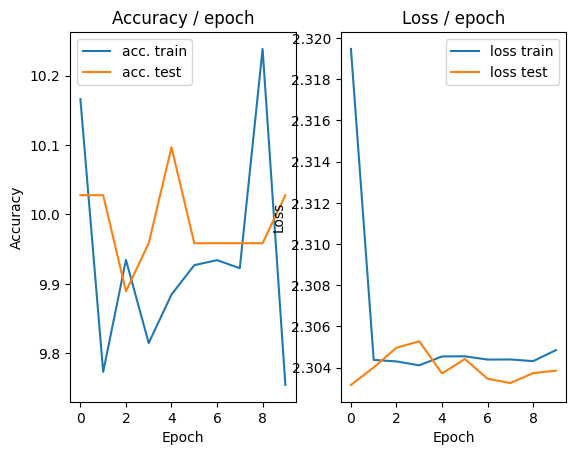

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.119s (0.119s)	Loss 2.3061 (2.3061)	Prec@1  10.9 ( 10.9)	Prec@5  52.3 ( 52.3)


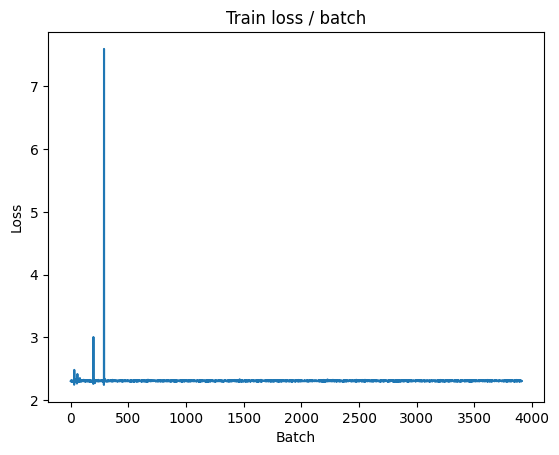

[TRAIN Batch 200/391]	Time 0.030s (0.021s)	Loss 2.3084 (2.3043)	Prec@1   7.0 ( 10.3)	Prec@5  48.4 ( 49.7)


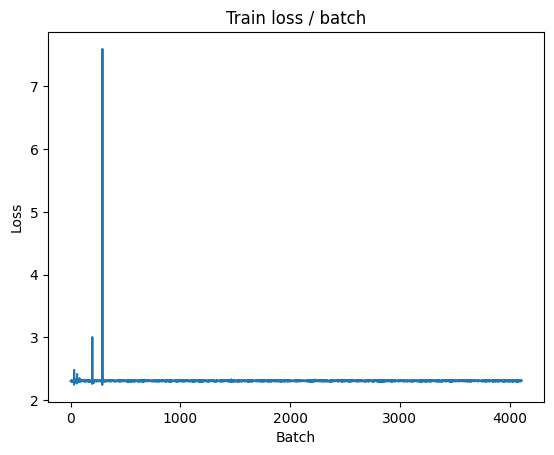


===============> Total time 8s	Avg loss 2.3044	Avg Prec@1 10.18 %	Avg Prec@5 49.68 %

[EVAL Batch 000/079]	Time 0.102s (0.102s)	Loss 2.3063 (2.3063)	Prec@1   7.8 (  7.8)	Prec@5  49.2 ( 49.2)

===============> Total time 1s	Avg loss 2.3040	Avg Prec@1  9.89 %	Avg Prec@5 49.65 %



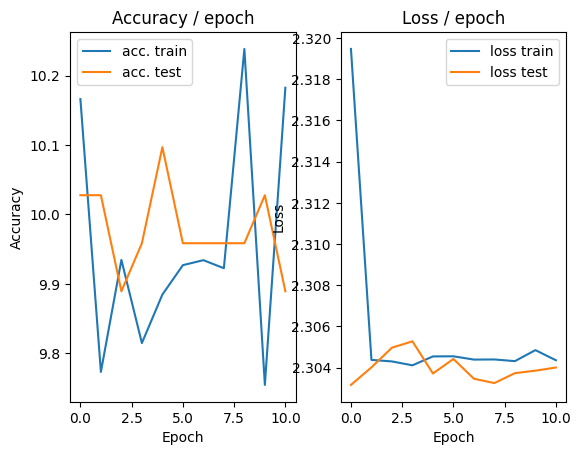

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 2.3045 (2.3045)	Prec@1  10.2 ( 10.2)	Prec@5  50.8 ( 50.8)


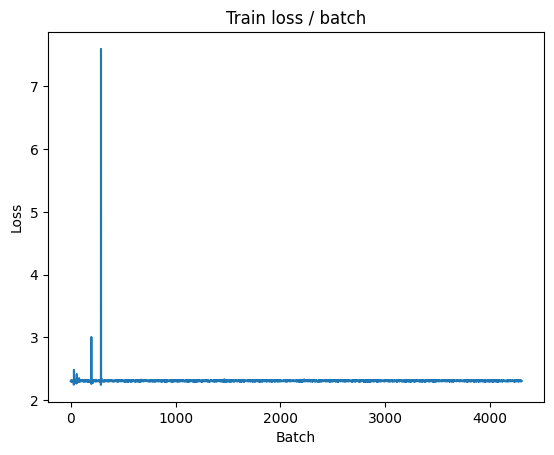

[TRAIN Batch 200/391]	Time 0.007s (0.019s)	Loss 2.2973 (2.3043)	Prec@1  10.9 ( 10.0)	Prec@5  57.0 ( 49.8)


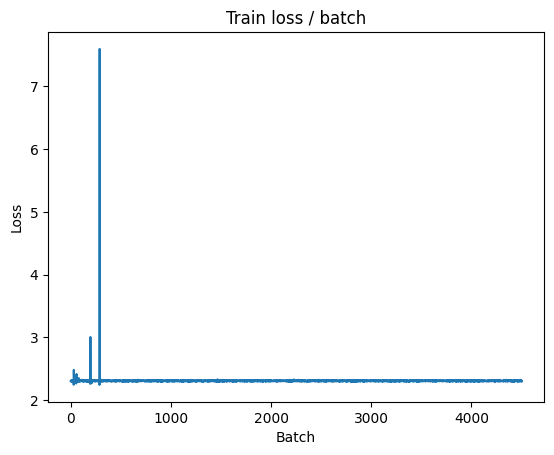


===============> Total time 8s	Avg loss 2.3042	Avg Prec@1 10.01 %	Avg Prec@5 50.04 %

[EVAL Batch 000/079]	Time 0.177s (0.177s)	Loss 2.3122 (2.3122)	Prec@1   7.8 (  7.8)	Prec@5  45.3 ( 45.3)

===============> Total time 1s	Avg loss 2.3047	Avg Prec@1  9.89 %	Avg Prec@5 50.07 %



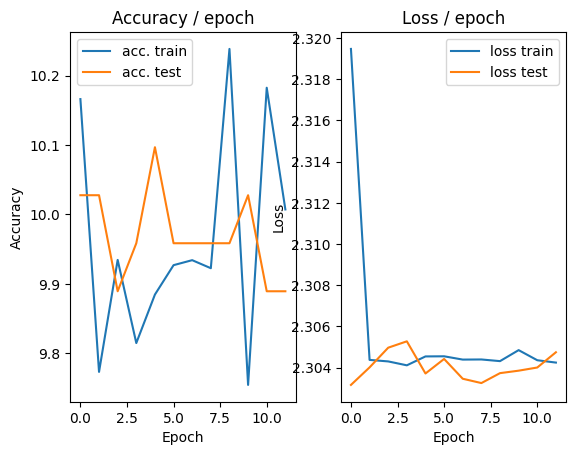

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 2.2960 (2.2960)	Prec@1  14.8 ( 14.8)	Prec@5  53.9 ( 53.9)


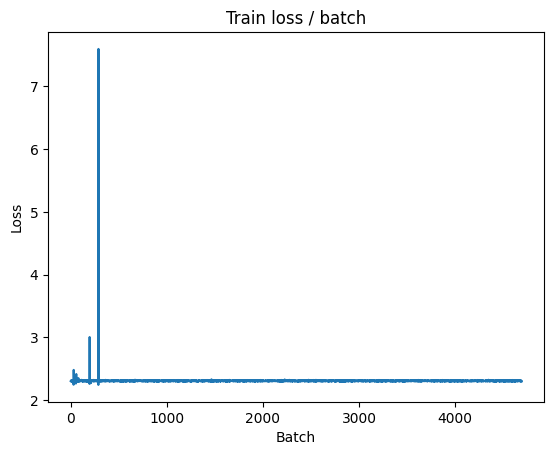

[TRAIN Batch 200/391]	Time 0.011s (0.019s)	Loss 2.3006 (2.3045)	Prec@1  14.8 ( 10.0)	Prec@5  51.6 ( 49.6)


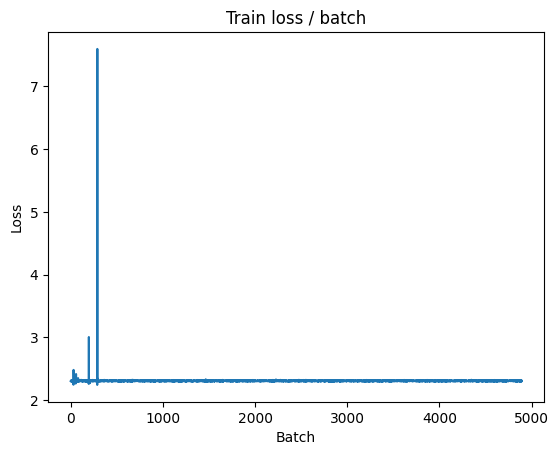


===============> Total time 7s	Avg loss 2.3043	Avg Prec@1  9.92 %	Avg Prec@5 49.79 %

[EVAL Batch 000/079]	Time 0.108s (0.108s)	Loss 2.3026 (2.3026)	Prec@1  13.3 ( 13.3)	Prec@5  53.9 ( 53.9)

===============> Total time 1s	Avg loss 2.3042	Avg Prec@1 10.10 %	Avg Prec@5 50.14 %



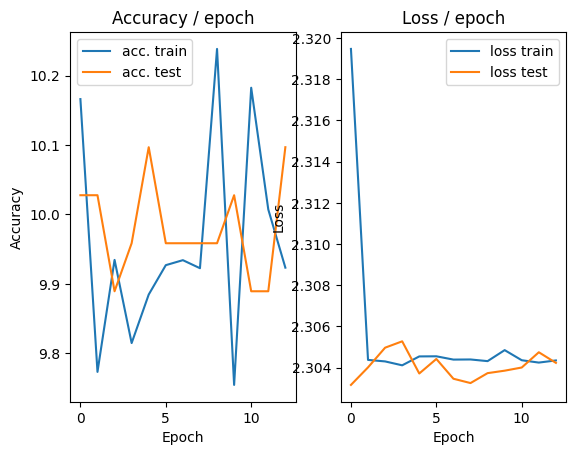

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.187s (0.187s)	Loss 2.3045 (2.3045)	Prec@1   9.4 (  9.4)	Prec@5  53.1 ( 53.1)


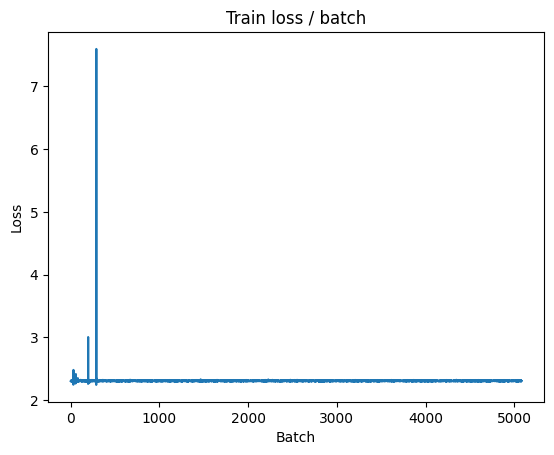

[TRAIN Batch 200/391]	Time 0.030s (0.022s)	Loss 2.3058 (2.3041)	Prec@1  10.9 ( 10.1)	Prec@5  48.4 ( 50.2)


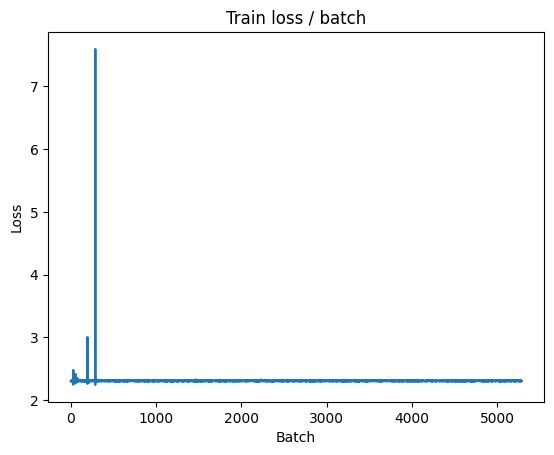


===============> Total time 7s	Avg loss 2.3041	Avg Prec@1  9.90 %	Avg Prec@5 50.07 %

[EVAL Batch 000/079]	Time 0.107s (0.107s)	Loss 2.3002 (2.3002)	Prec@1  14.8 ( 14.8)	Prec@5  48.4 ( 48.4)

===============> Total time 1s	Avg loss 2.3042	Avg Prec@1  9.89 %	Avg Prec@5 49.93 %



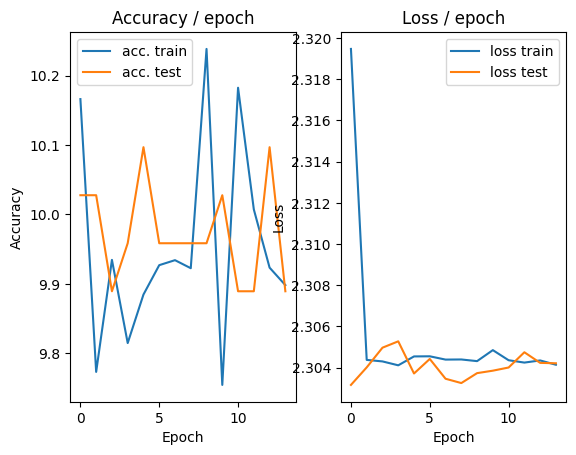

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 2.3086 (2.3086)	Prec@1   7.0 (  7.0)	Prec@5  43.0 ( 43.0)


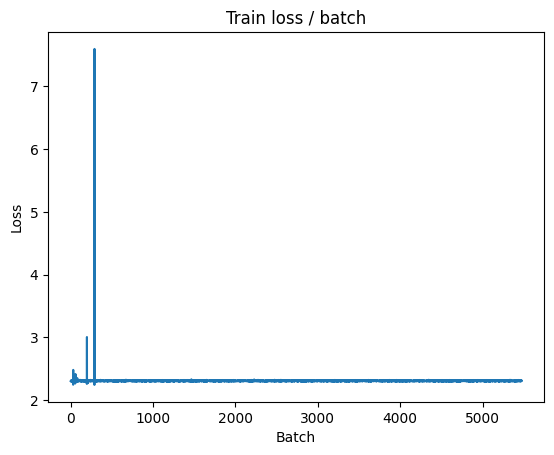

[TRAIN Batch 200/391]	Time 0.024s (0.024s)	Loss 2.3079 (2.3044)	Prec@1  10.2 ( 10.1)	Prec@5  47.7 ( 50.0)


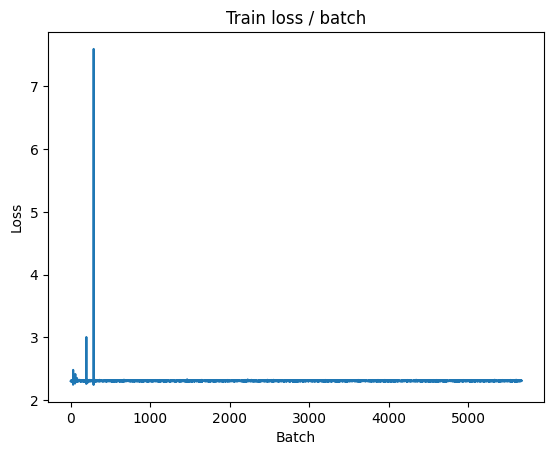


===============> Total time 8s	Avg loss 2.3042	Avg Prec@1 10.18 %	Avg Prec@5 50.19 %

[EVAL Batch 000/079]	Time 0.110s (0.110s)	Loss 2.3030 (2.3030)	Prec@1   8.6 (  8.6)	Prec@5  53.9 ( 53.9)

===============> Total time 1s	Avg loss 2.3040	Avg Prec@1  9.89 %	Avg Prec@5 50.21 %



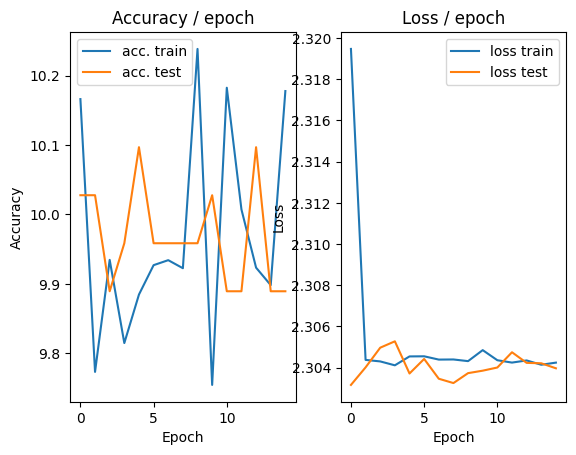

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.151s (0.151s)	Loss 2.2985 (2.2985)	Prec@1   9.4 (  9.4)	Prec@5  58.6 ( 58.6)


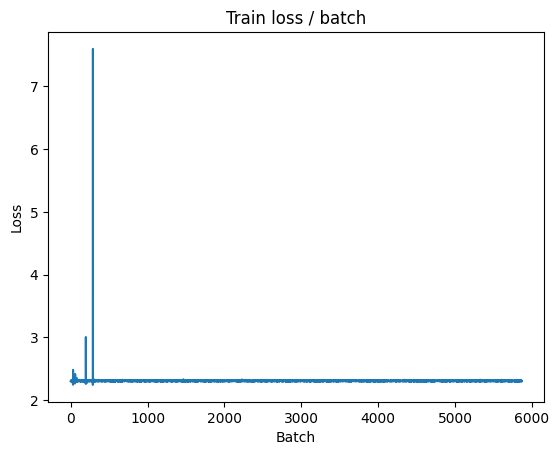

[TRAIN Batch 200/391]	Time 0.010s (0.020s)	Loss 2.3074 (2.3045)	Prec@1   7.0 (  9.7)	Prec@5  50.8 ( 49.5)


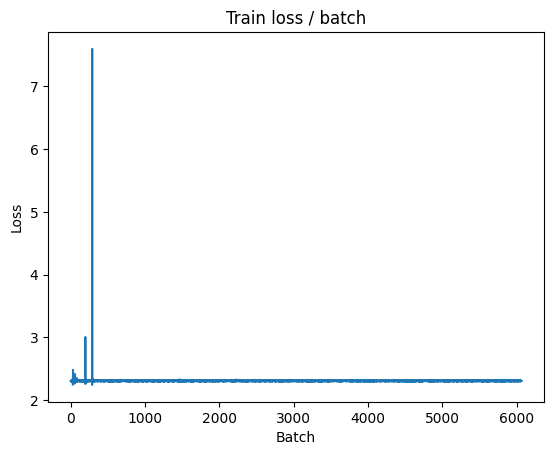


===============> Total time 8s	Avg loss 2.3044	Avg Prec@1  9.91 %	Avg Prec@5 49.60 %

[EVAL Batch 000/079]	Time 0.106s (0.106s)	Loss 2.3076 (2.3076)	Prec@1  10.2 ( 10.2)	Prec@5  47.7 ( 47.7)

===============> Total time 1s	Avg loss 2.3042	Avg Prec@1 10.03 %	Avg Prec@5 50.21 %



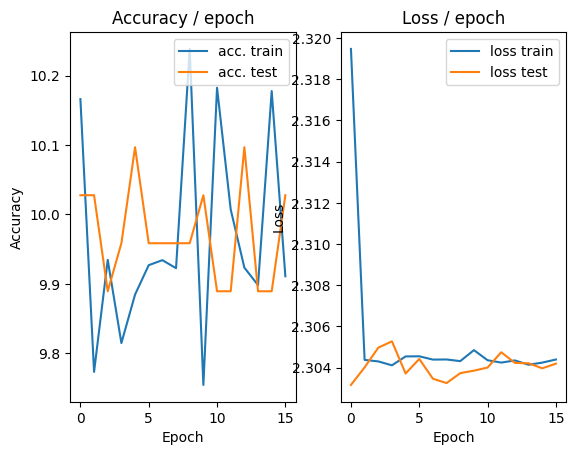

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 2.3024 (2.3024)	Prec@1   7.0 (  7.0)	Prec@5  50.8 ( 50.8)


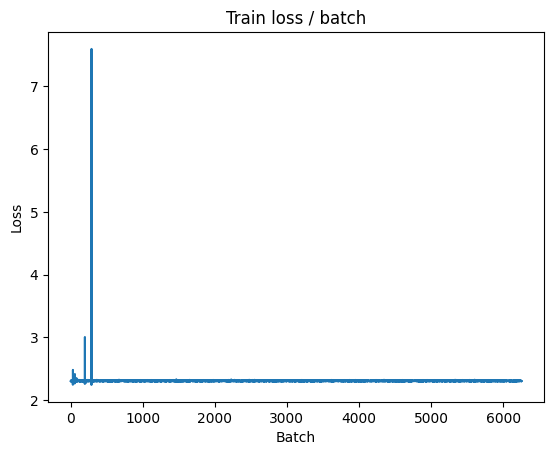

[TRAIN Batch 200/391]	Time 0.017s (0.024s)	Loss 2.3089 (2.3044)	Prec@1   9.4 ( 10.0)	Prec@5  45.3 ( 49.9)


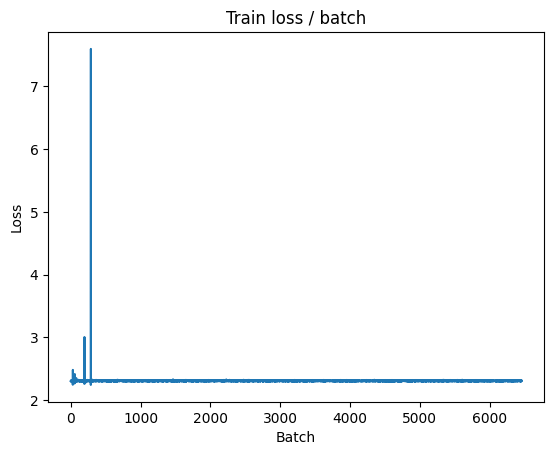


===============> Total time 9s	Avg loss 2.3043	Avg Prec@1  9.99 %	Avg Prec@5 49.69 %

[EVAL Batch 000/079]	Time 0.102s (0.102s)	Loss 2.2990 (2.2990)	Prec@1  10.2 ( 10.2)	Prec@5  52.3 ( 52.3)

===============> Total time 1s	Avg loss 2.3043	Avg Prec@1 10.10 %	Avg Prec@5 50.07 %



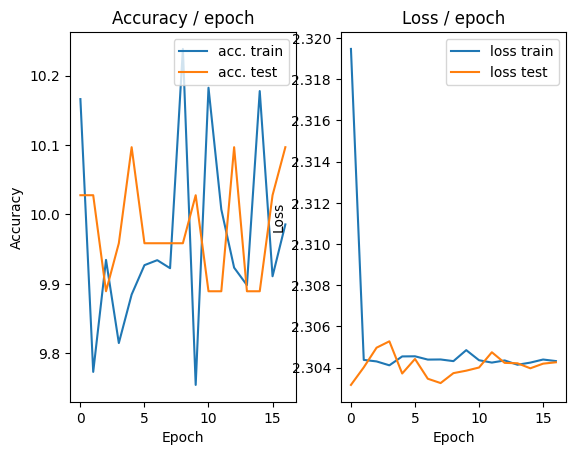

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.143s (0.143s)	Loss 2.2984 (2.2984)	Prec@1  13.3 ( 13.3)	Prec@5  52.3 ( 52.3)


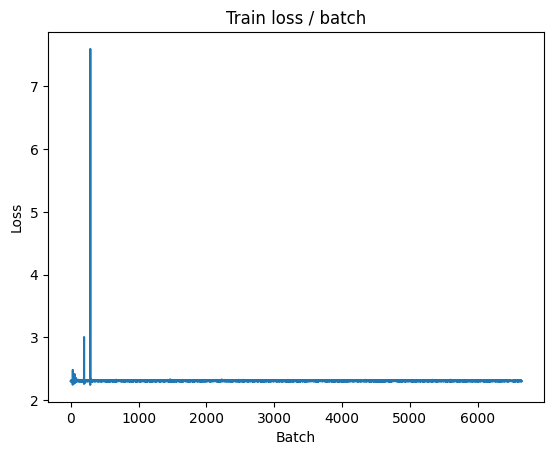

[TRAIN Batch 200/391]	Time 0.011s (0.019s)	Loss 2.2983 (2.3042)	Prec@1  10.9 (  9.9)	Prec@5  56.2 ( 49.9)


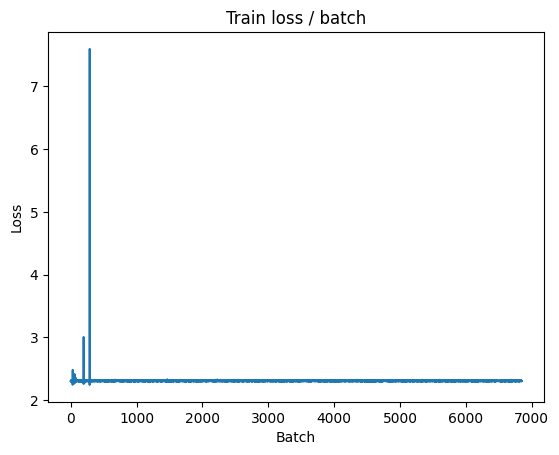


===============> Total time 7s	Avg loss 2.3043	Avg Prec@1  9.86 %	Avg Prec@5 49.96 %

[EVAL Batch 000/079]	Time 0.103s (0.103s)	Loss 2.3031 (2.3031)	Prec@1  14.8 ( 14.8)	Prec@5  49.2 ( 49.2)

===============> Total time 1s	Avg loss 2.3047	Avg Prec@1  9.89 %	Avg Prec@5 49.93 %



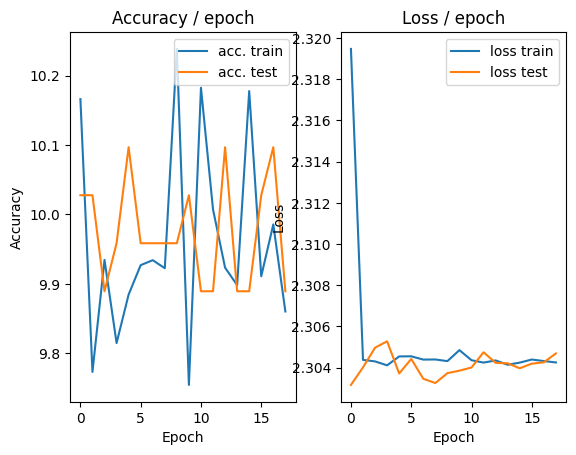

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.202s (0.202s)	Loss 2.3025 (2.3025)	Prec@1  14.8 ( 14.8)	Prec@5  49.2 ( 49.2)


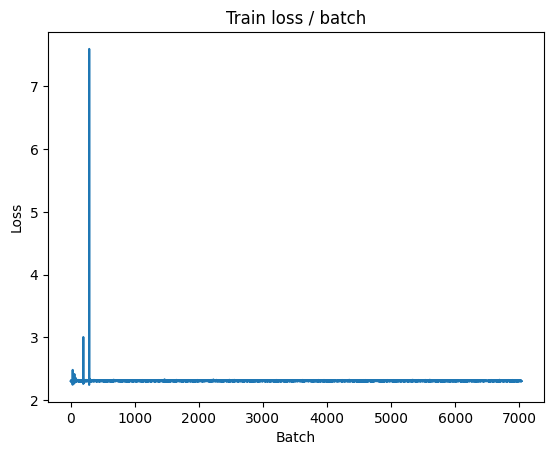

[TRAIN Batch 200/391]	Time 0.028s (0.022s)	Loss 2.3023 (2.3045)	Prec@1  10.9 (  9.9)	Prec@5  53.1 ( 50.0)


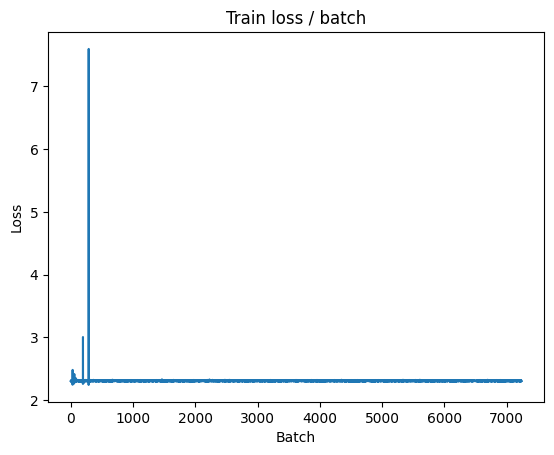


===============> Total time 7s	Avg loss 2.3043	Avg Prec@1 10.01 %	Avg Prec@5 50.08 %

[EVAL Batch 000/079]	Time 0.110s (0.110s)	Loss 2.3045 (2.3045)	Prec@1   8.6 (  8.6)	Prec@5  55.5 ( 55.5)

===============> Total time 1s	Avg loss 2.3052	Avg Prec@1  9.96 %	Avg Prec@5 49.93 %



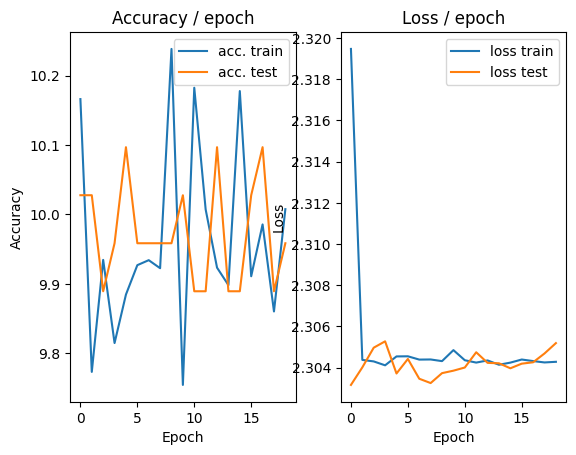

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.162s (0.162s)	Loss 2.3044 (2.3044)	Prec@1   9.4 (  9.4)	Prec@5  54.7 ( 54.7)


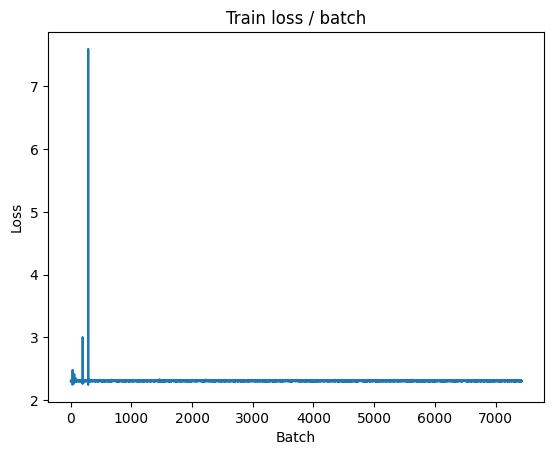

[TRAIN Batch 200/391]	Time 0.009s (0.024s)	Loss 2.2958 (2.3045)	Prec@1  12.5 (  9.7)	Prec@5  58.6 ( 49.5)


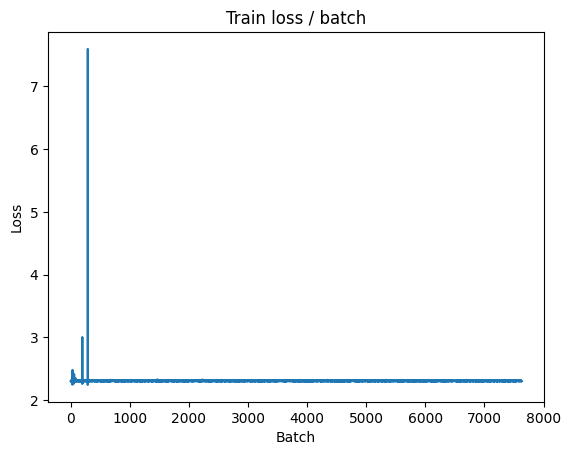


===============> Total time 8s	Avg loss 2.3044	Avg Prec@1  9.66 %	Avg Prec@5 49.94 %

[EVAL Batch 000/079]	Time 0.105s (0.105s)	Loss 2.3028 (2.3028)	Prec@1   7.0 (  7.0)	Prec@5  52.3 ( 52.3)

===============> Total time 1s	Avg loss 2.3051	Avg Prec@1 10.10 %	Avg Prec@5 50.14 %



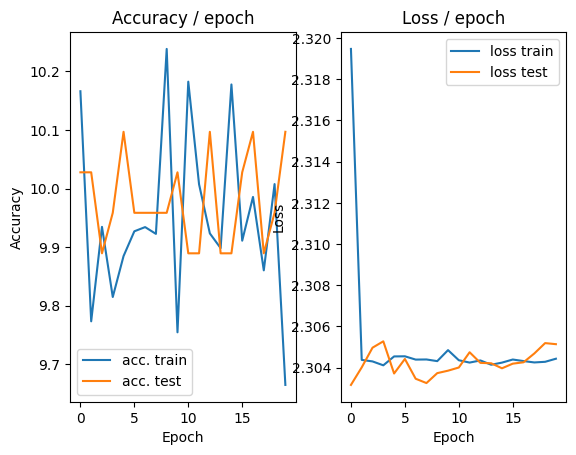

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.148s (0.148s)	Loss 2.3178 (2.3178)	Prec@1   5.5 (  5.5)	Prec@5  50.8 ( 50.8)


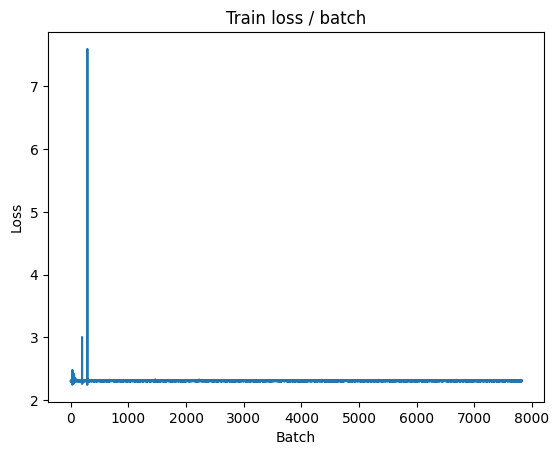

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 2.3060 (2.3046)	Prec@1  10.2 (  9.7)	Prec@5  46.9 ( 49.7)


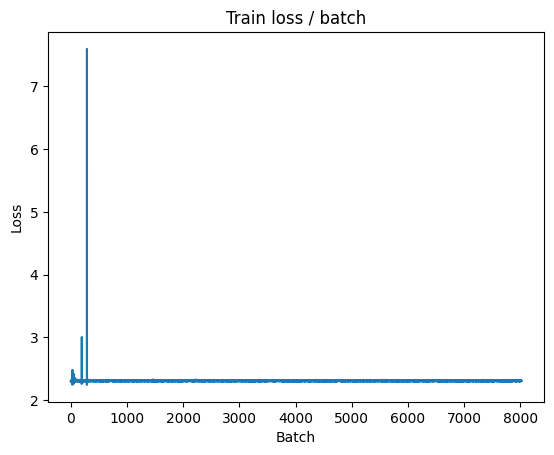


===============> Total time 8s	Avg loss 2.3046	Avg Prec@1  9.84 %	Avg Prec@5 49.72 %

[EVAL Batch 000/079]	Time 0.104s (0.104s)	Loss 2.3065 (2.3065)	Prec@1   8.6 (  8.6)	Prec@5  46.1 ( 46.1)

===============> Total time 1s	Avg loss 2.3034	Avg Prec@1  9.96 %	Avg Prec@5 50.14 %



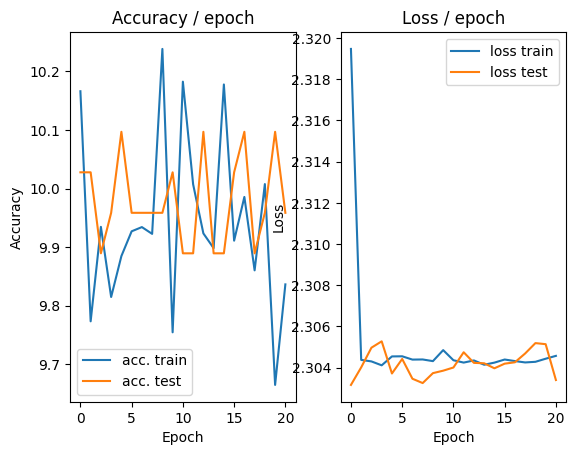

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.143s (0.143s)	Loss 2.3043 (2.3043)	Prec@1  14.1 ( 14.1)	Prec@5  46.1 ( 46.1)


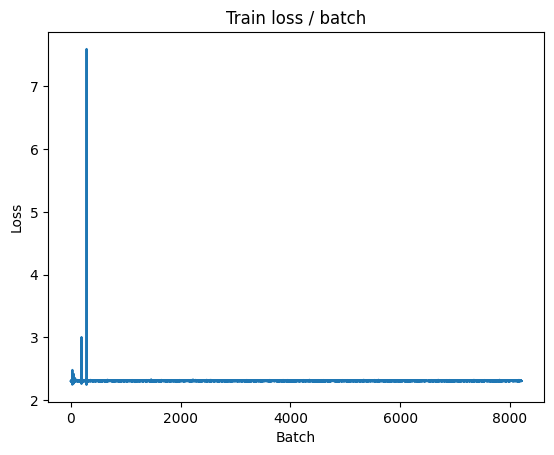

[TRAIN Batch 200/391]	Time 0.017s (0.020s)	Loss 2.2999 (2.3043)	Prec@1  11.7 ( 10.0)	Prec@5  51.6 ( 50.0)


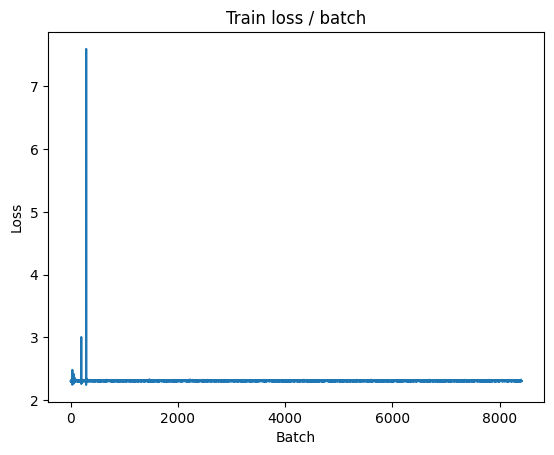


===============> Total time 7s	Avg loss 2.3042	Avg Prec@1 10.13 %	Avg Prec@5 50.08 %

[EVAL Batch 000/079]	Time 0.108s (0.108s)	Loss 2.3078 (2.3078)	Prec@1  11.7 ( 11.7)	Prec@5  44.5 ( 44.5)

===============> Total time 1s	Avg loss 2.3038	Avg Prec@1 10.10 %	Avg Prec@5 50.14 %



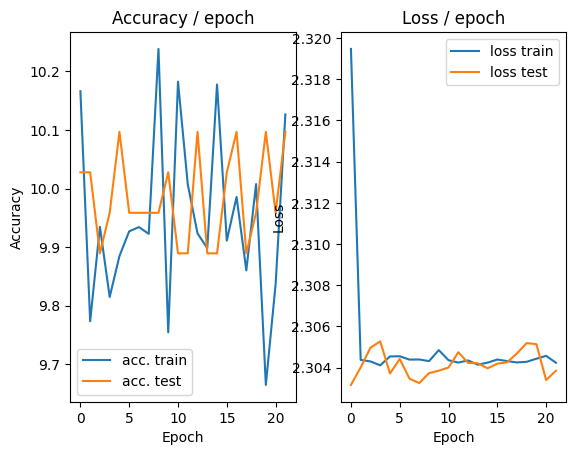

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 2.2948 (2.2948)	Prec@1  14.8 ( 14.8)	Prec@5  58.6 ( 58.6)


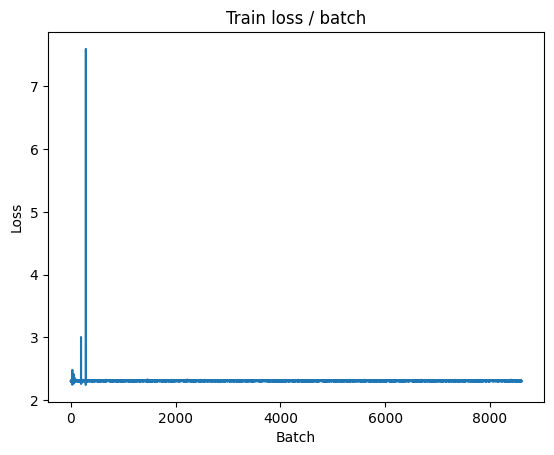

[TRAIN Batch 200/391]	Time 0.025s (0.020s)	Loss 2.2979 (2.3039)	Prec@1   8.6 ( 10.2)	Prec@5  60.2 ( 50.2)


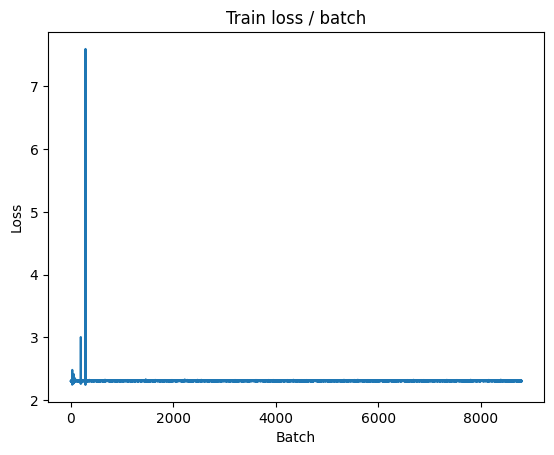


===============> Total time 7s	Avg loss 2.3040	Avg Prec@1 10.08 %	Avg Prec@5 50.32 %

[EVAL Batch 000/079]	Time 0.106s (0.106s)	Loss 2.2987 (2.2987)	Prec@1  10.2 ( 10.2)	Prec@5  53.1 ( 53.1)

===============> Total time 1s	Avg loss 2.3061	Avg Prec@1 10.10 %	Avg Prec@5 49.86 %



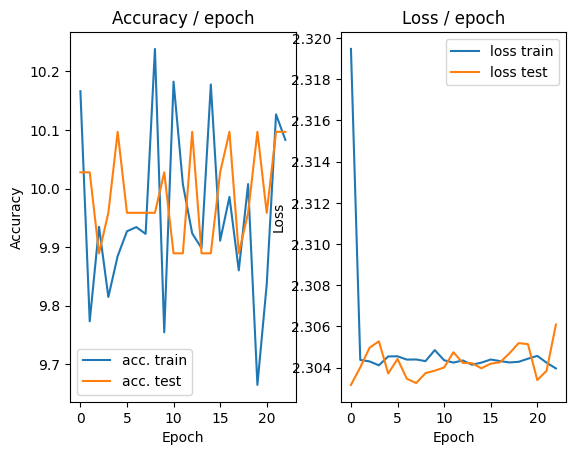

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.224s (0.224s)	Loss 2.3031 (2.3031)	Prec@1  13.3 ( 13.3)	Prec@5  52.3 ( 52.3)


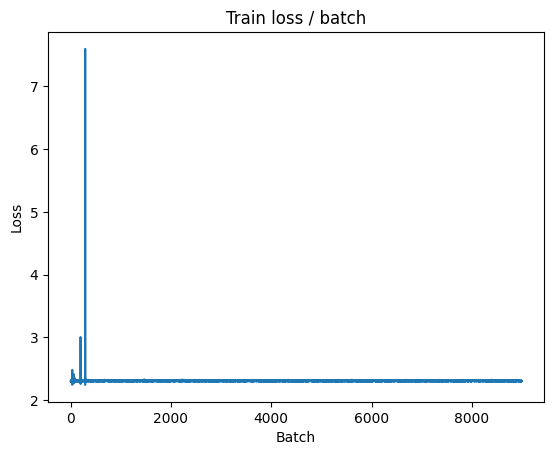

[TRAIN Batch 200/391]	Time 0.008s (0.023s)	Loss 2.3098 (2.3045)	Prec@1   9.4 ( 10.0)	Prec@5  43.8 ( 49.7)


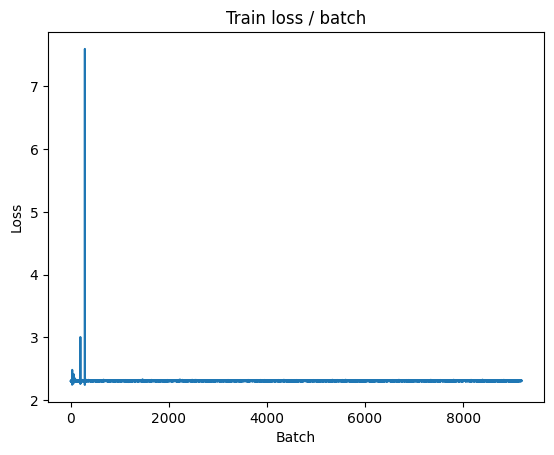


===============> Total time 8s	Avg loss 2.3043	Avg Prec@1  9.99 %	Avg Prec@5 49.93 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 2.3029 (2.3029)	Prec@1   7.8 (  7.8)	Prec@5  57.8 ( 57.8)

===============> Total time 1s	Avg loss 2.3045	Avg Prec@1  9.96 %	Avg Prec@5 50.14 %



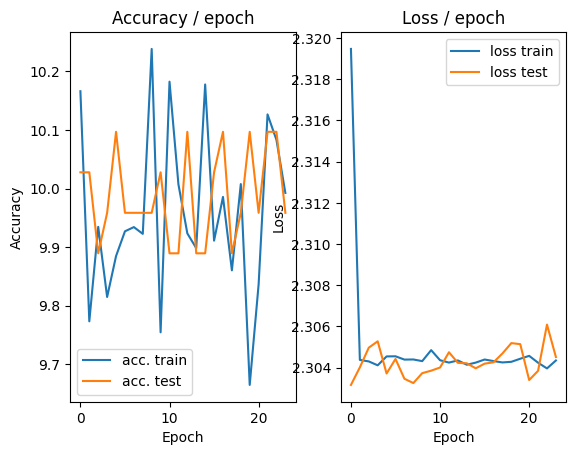

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.143s (0.143s)	Loss 2.2942 (2.2942)	Prec@1  14.8 ( 14.8)	Prec@5  52.3 ( 52.3)


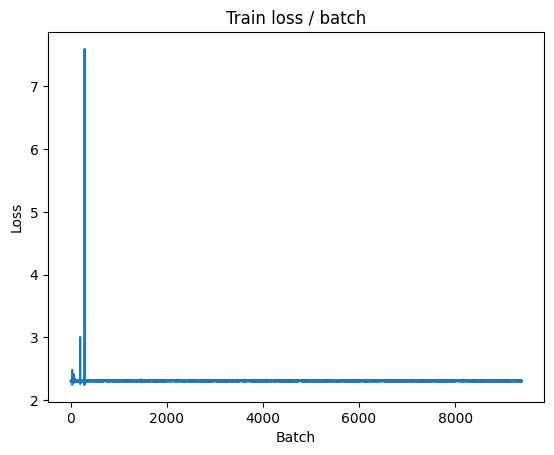

[TRAIN Batch 200/391]	Time 0.025s (0.023s)	Loss 2.3048 (2.3043)	Prec@1   8.6 (  9.9)	Prec@5  45.3 ( 49.8)


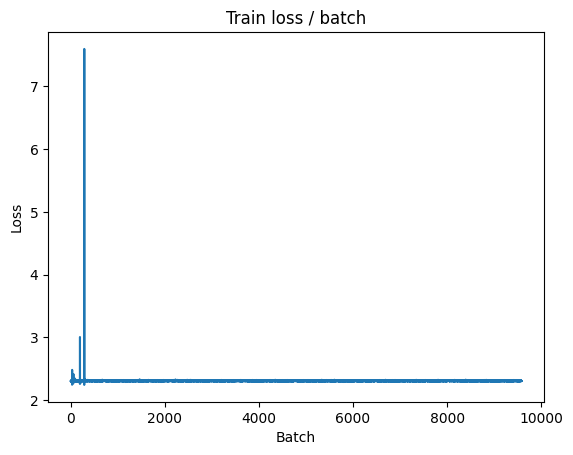


===============> Total time 8s	Avg loss 2.3043	Avg Prec@1  9.98 %	Avg Prec@5 49.96 %

[EVAL Batch 000/079]	Time 0.114s (0.114s)	Loss 2.3085 (2.3085)	Prec@1   7.8 (  7.8)	Prec@5  50.8 ( 50.8)

===============> Total time 1s	Avg loss 2.3041	Avg Prec@1  9.89 %	Avg Prec@5 50.14 %



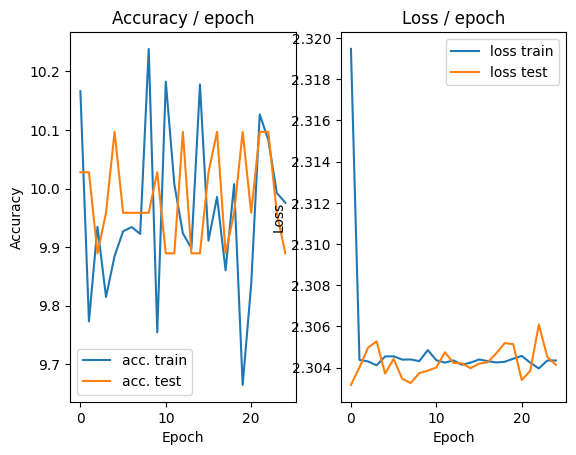

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 2.2986 (2.2986)	Prec@1  11.7 ( 11.7)	Prec@5  55.5 ( 55.5)


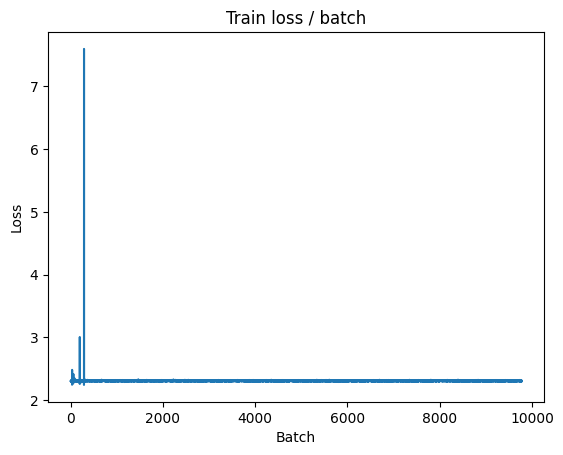

[TRAIN Batch 200/391]	Time 0.011s (0.019s)	Loss 2.3145 (2.3040)	Prec@1  12.5 ( 10.2)	Prec@5  43.0 ( 50.1)


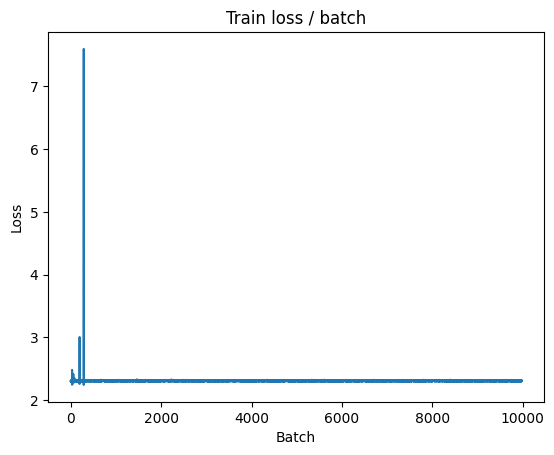


===============> Total time 8s	Avg loss 2.3040	Avg Prec@1 10.28 %	Avg Prec@5 50.16 %

[EVAL Batch 000/079]	Time 0.106s (0.106s)	Loss 2.2938 (2.2938)	Prec@1  14.8 ( 14.8)	Prec@5  57.8 ( 57.8)

===============> Total time 1s	Avg loss 2.3048	Avg Prec@1  9.89 %	Avg Prec@5 50.00 %



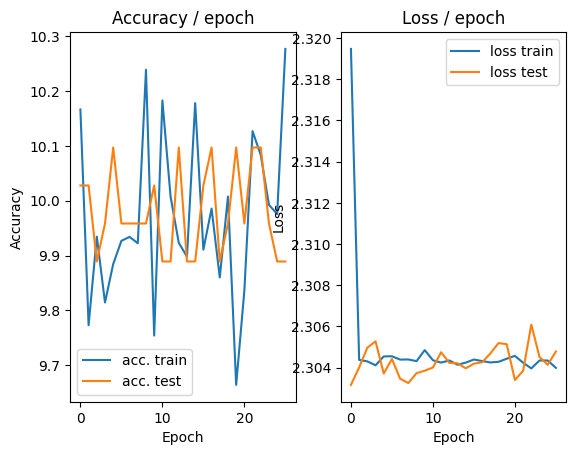

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.159s (0.159s)	Loss 2.3018 (2.3018)	Prec@1   6.2 (  6.2)	Prec@5  55.5 ( 55.5)


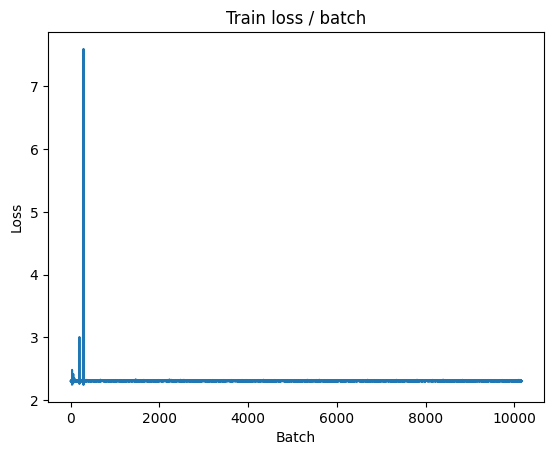

[TRAIN Batch 200/391]	Time 0.019s (0.019s)	Loss 2.3011 (2.3044)	Prec@1  11.7 (  9.9)	Prec@5  51.6 ( 49.8)


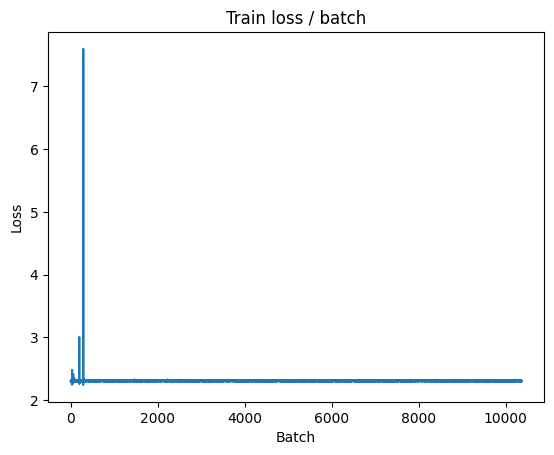


===============> Total time 7s	Avg loss 2.3044	Avg Prec@1  9.92 %	Avg Prec@5 49.89 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 2.3102 (2.3102)	Prec@1   7.8 (  7.8)	Prec@5  44.5 ( 44.5)

===============> Total time 2s	Avg loss 2.3040	Avg Prec@1  9.96 %	Avg Prec@5 49.93 %



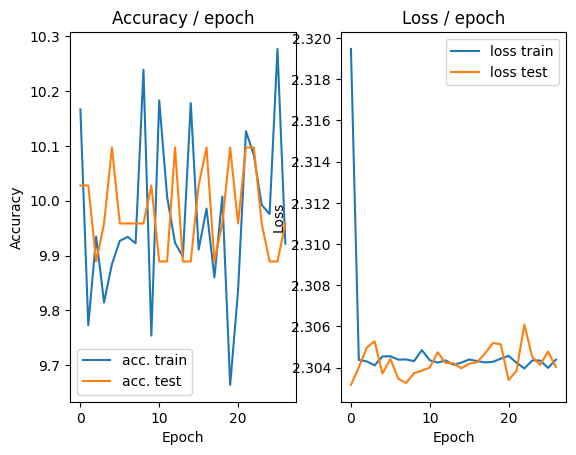

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.158s (0.158s)	Loss 2.3008 (2.3008)	Prec@1  12.5 ( 12.5)	Prec@5  52.3 ( 52.3)


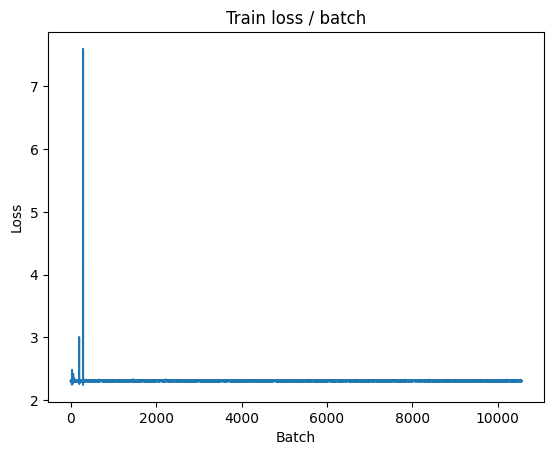

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 2.3048 (2.3045)	Prec@1   7.8 (  9.8)	Prec@5  56.2 ( 49.7)


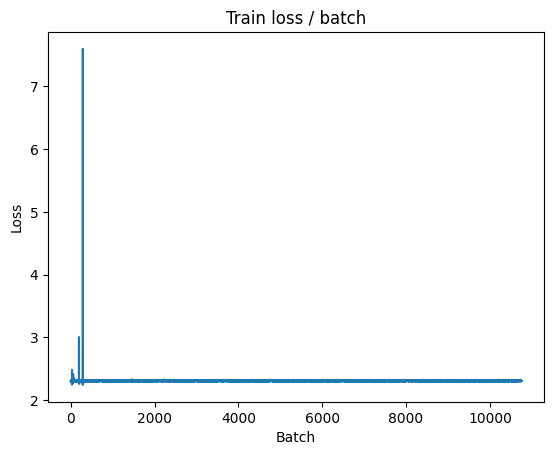


===============> Total time 7s	Avg loss 2.3045	Avg Prec@1  9.88 %	Avg Prec@5 49.75 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 2.3045 (2.3045)	Prec@1  10.2 ( 10.2)	Prec@5  47.7 ( 47.7)

===============> Total time 1s	Avg loss 2.3036	Avg Prec@1 10.03 %	Avg Prec@5 50.07 %



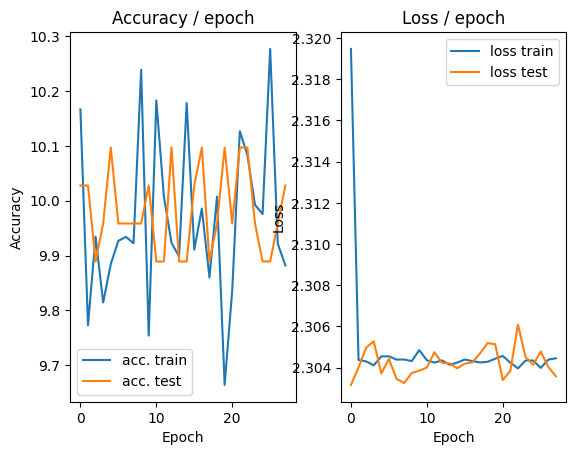

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.200s (0.200s)	Loss 2.3018 (2.3018)	Prec@1  10.2 ( 10.2)	Prec@5  51.6 ( 51.6)


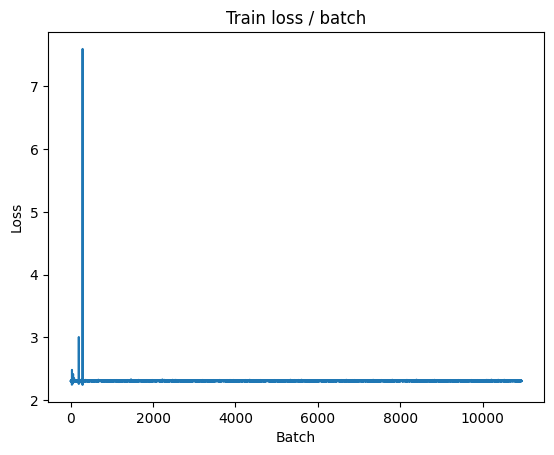

[TRAIN Batch 200/391]	Time 0.031s (0.024s)	Loss 2.3123 (2.3044)	Prec@1   9.4 (  9.7)	Prec@5  46.1 ( 50.1)


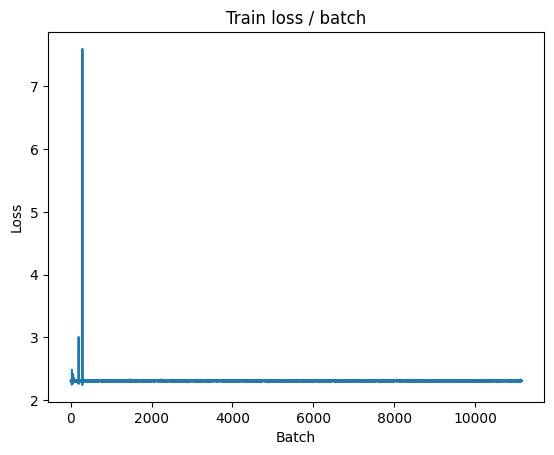


===============> Total time 8s	Avg loss 2.3044	Avg Prec@1  9.71 %	Avg Prec@5 49.89 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 2.3033 (2.3033)	Prec@1   7.0 (  7.0)	Prec@5  50.8 ( 50.8)

===============> Total time 1s	Avg loss 2.3046	Avg Prec@1 10.10 %	Avg Prec@5 49.93 %



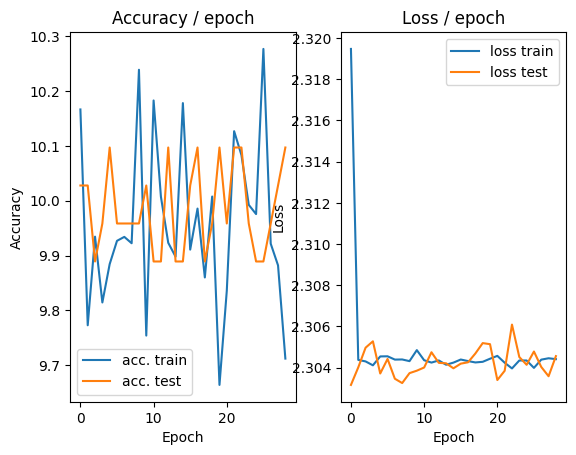

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.164s (0.164s)	Loss 2.2925 (2.2925)	Prec@1  14.8 ( 14.8)	Prec@5  58.6 ( 58.6)


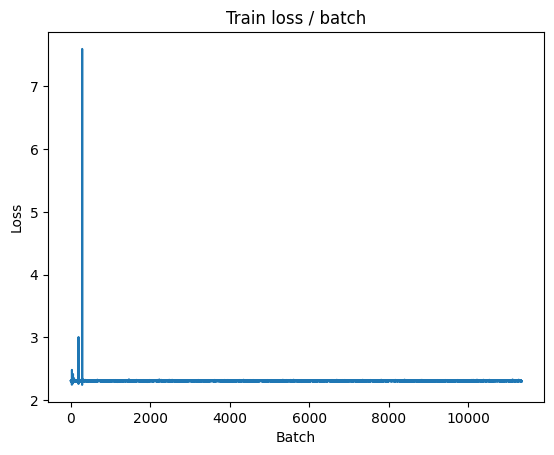

[TRAIN Batch 200/391]	Time 0.053s (0.021s)	Loss 2.3022 (2.3043)	Prec@1   7.0 (  9.9)	Prec@5  52.3 ( 50.0)


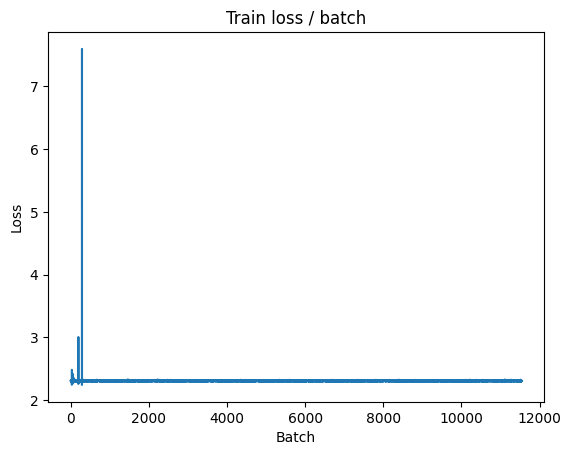


===============> Total time 8s	Avg loss 2.3043	Avg Prec@1  9.92 %	Avg Prec@5 49.98 %

[EVAL Batch 000/079]	Time 0.118s (0.118s)	Loss 2.3090 (2.3090)	Prec@1   8.6 (  8.6)	Prec@5  43.8 ( 43.8)

===============> Total time 1s	Avg loss 2.3042	Avg Prec@1  9.96 %	Avg Prec@5 50.14 %



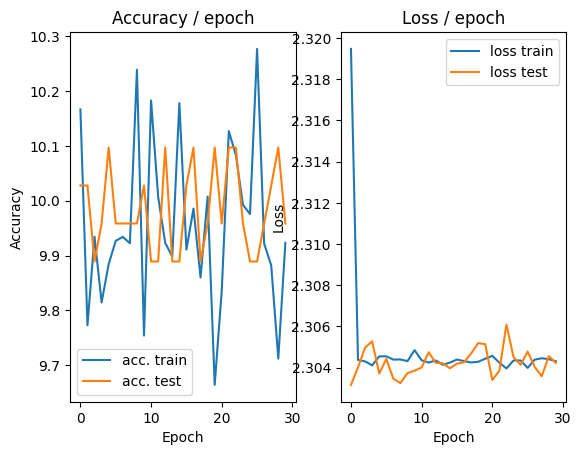

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 2.3105 (2.3105)	Prec@1  11.7 ( 11.7)	Prec@5  47.7 ( 47.7)


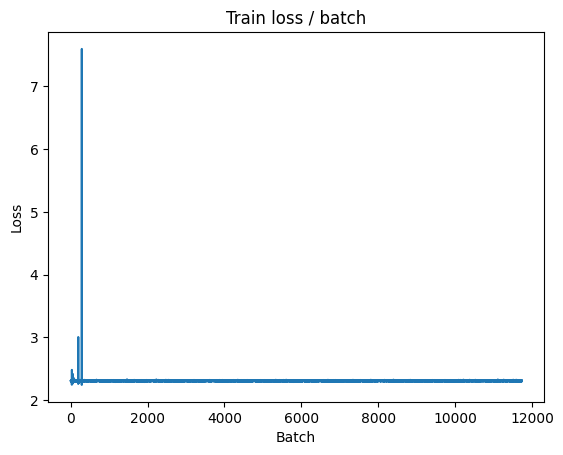

[TRAIN Batch 200/391]	Time 0.023s (0.020s)	Loss 2.3048 (2.3038)	Prec@1  12.5 ( 10.3)	Prec@5  50.8 ( 50.4)


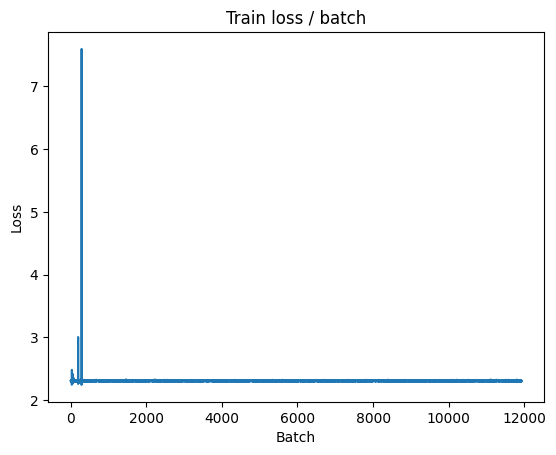


===============> Total time 8s	Avg loss 2.3041	Avg Prec@1 10.05 %	Avg Prec@5 50.15 %

[EVAL Batch 000/079]	Time 0.123s (0.123s)	Loss 2.3028 (2.3028)	Prec@1  10.2 ( 10.2)	Prec@5  50.0 ( 50.0)

===============> Total time 1s	Avg loss 2.3036	Avg Prec@1 10.03 %	Avg Prec@5 50.07 %



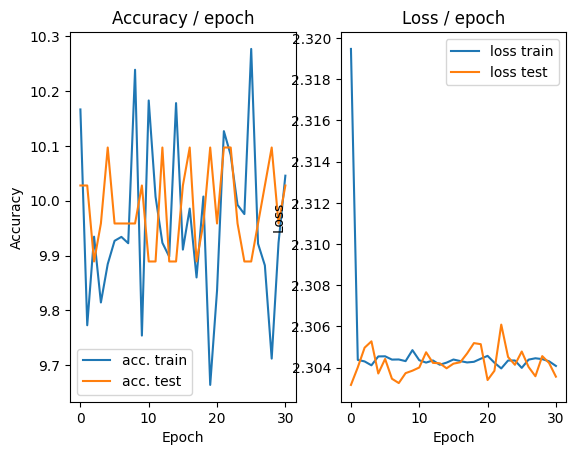

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.164s (0.164s)	Loss 2.3057 (2.3057)	Prec@1  11.7 ( 11.7)	Prec@5  46.1 ( 46.1)


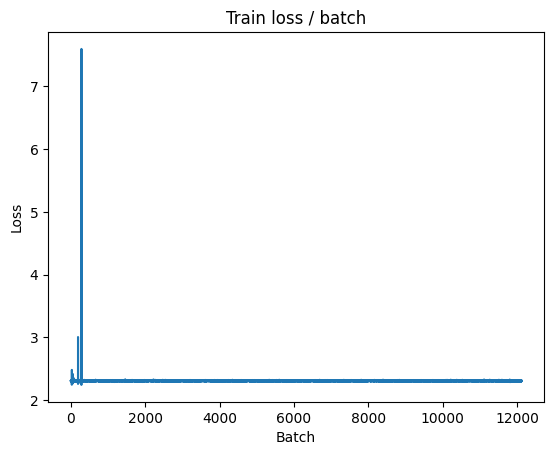

[TRAIN Batch 200/391]	Time 0.006s (0.020s)	Loss 2.3020 (2.3040)	Prec@1  10.9 ( 10.3)	Prec@5  51.6 ( 50.2)


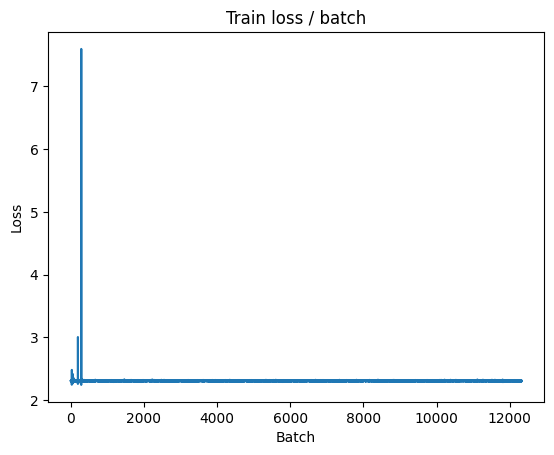


===============> Total time 7s	Avg loss 2.3043	Avg Prec@1 10.15 %	Avg Prec@5 49.94 %

[EVAL Batch 000/079]	Time 0.115s (0.115s)	Loss 2.3006 (2.3006)	Prec@1   7.8 (  7.8)	Prec@5  56.2 ( 56.2)

===============> Total time 1s	Avg loss 2.3034	Avg Prec@1  9.96 %	Avg Prec@5 49.93 %



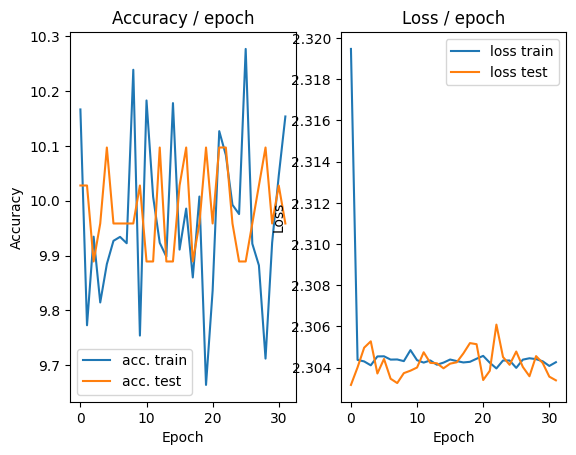

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.222s (0.222s)	Loss 2.3016 (2.3016)	Prec@1   9.4 (  9.4)	Prec@5  50.8 ( 50.8)


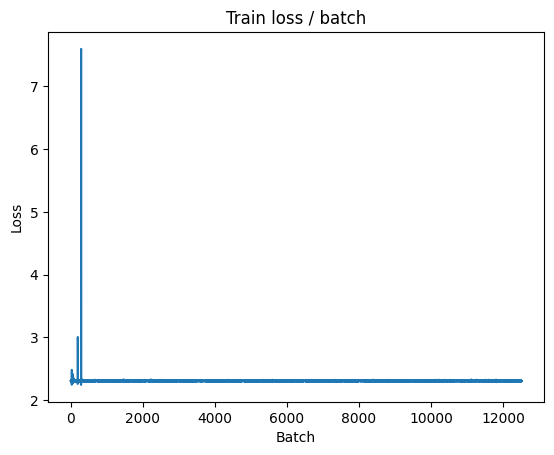

[TRAIN Batch 200/391]	Time 0.012s (0.021s)	Loss 2.3084 (2.3041)	Prec@1  10.9 ( 10.2)	Prec@5  48.4 ( 50.0)


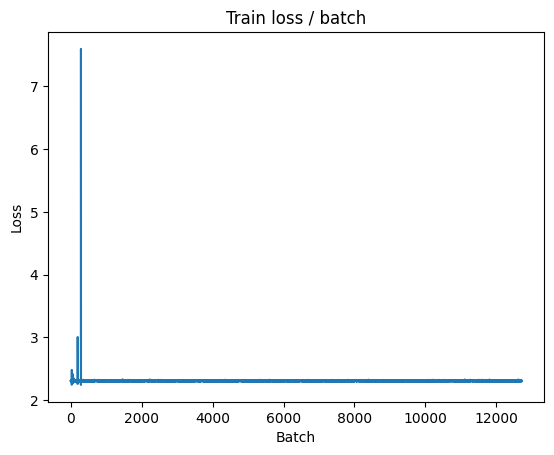


===============> Total time 7s	Avg loss 2.3042	Avg Prec@1  9.95 %	Avg Prec@5 49.97 %

[EVAL Batch 000/079]	Time 0.120s (0.120s)	Loss 2.2957 (2.2957)	Prec@1   8.6 (  8.6)	Prec@5  56.2 ( 56.2)

===============> Total time 1s	Avg loss 2.3052	Avg Prec@1  9.89 %	Avg Prec@5 49.93 %



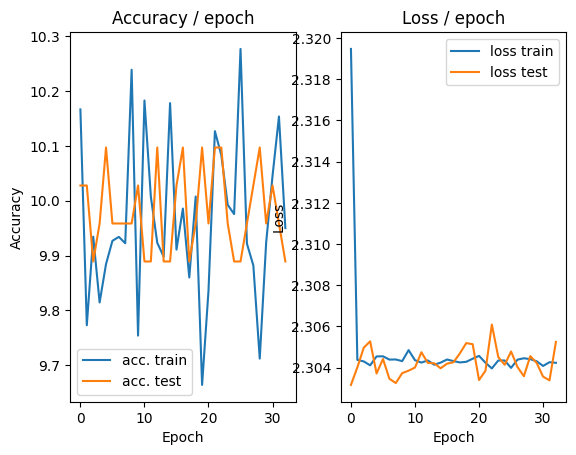

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.177s (0.177s)	Loss 2.3029 (2.3029)	Prec@1   9.4 (  9.4)	Prec@5  50.0 ( 50.0)


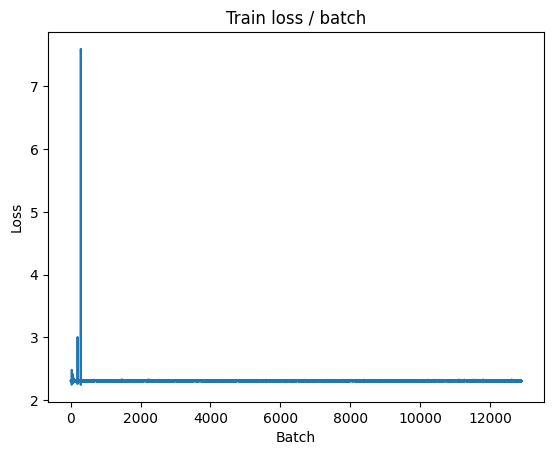

[TRAIN Batch 200/391]	Time 0.016s (0.024s)	Loss 2.3047 (2.3043)	Prec@1   4.7 (  9.7)	Prec@5  50.8 ( 49.6)


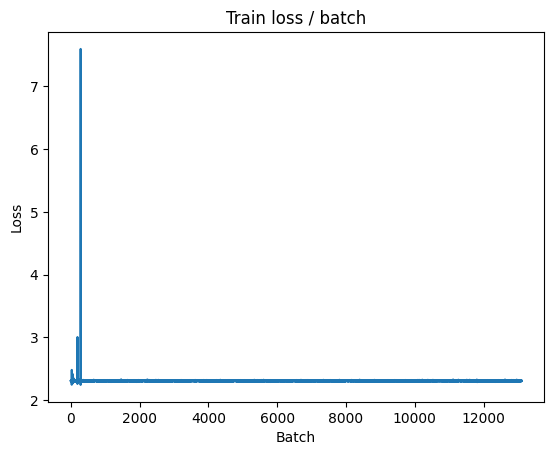


===============> Total time 8s	Avg loss 2.3045	Avg Prec@1  9.81 %	Avg Prec@5 49.51 %

[EVAL Batch 000/079]	Time 0.125s (0.125s)	Loss 2.3110 (2.3110)	Prec@1   7.8 (  7.8)	Prec@5  44.5 ( 44.5)

===============> Total time 1s	Avg loss 2.3037	Avg Prec@1  9.96 %	Avg Prec@5 49.93 %



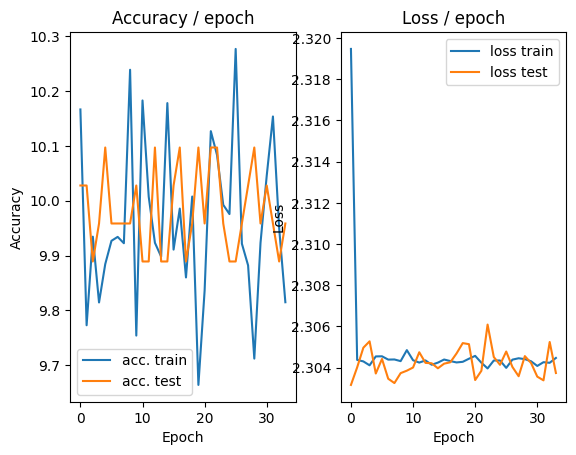

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 2.3026 (2.3026)	Prec@1   7.8 (  7.8)	Prec@5  57.0 ( 57.0)


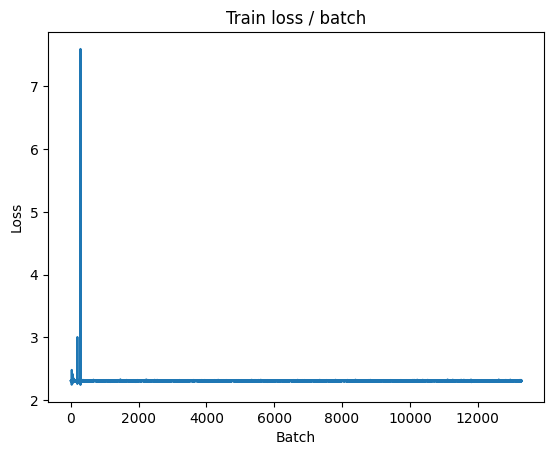

[TRAIN Batch 200/391]	Time 0.018s (0.019s)	Loss 2.3062 (2.3045)	Prec@1  10.2 (  9.6)	Prec@5  46.9 ( 49.8)


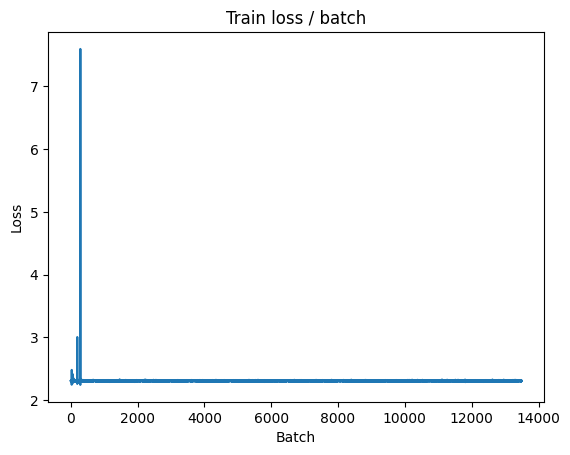


===============> Total time 8s	Avg loss 2.3045	Avg Prec@1  9.56 %	Avg Prec@5 49.74 %

[EVAL Batch 000/079]	Time 0.116s (0.116s)	Loss 2.2997 (2.2997)	Prec@1  14.8 ( 14.8)	Prec@5  50.8 ( 50.8)

===============> Total time 1s	Avg loss 2.3040	Avg Prec@1  9.89 %	Avg Prec@5 49.72 %



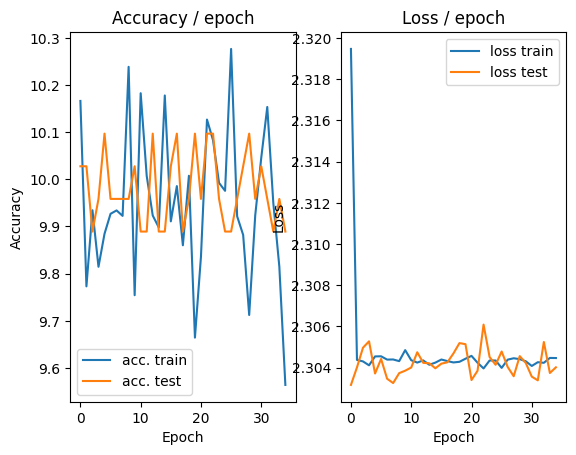

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.168s (0.168s)	Loss 2.3001 (2.3001)	Prec@1  13.3 ( 13.3)	Prec@5  57.0 ( 57.0)


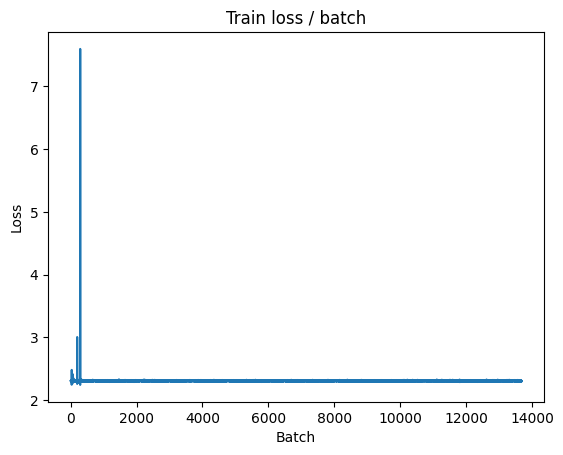

[TRAIN Batch 200/391]	Time 0.009s (0.020s)	Loss 2.2957 (2.3043)	Prec@1  13.3 (  9.9)	Prec@5  57.8 ( 50.2)


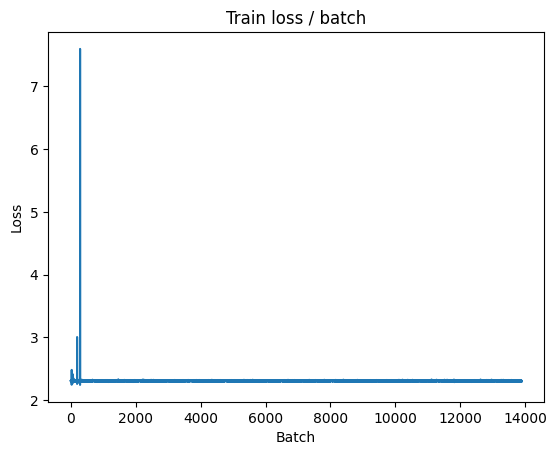


===============> Total time 8s	Avg loss 2.3043	Avg Prec@1  9.93 %	Avg Prec@5 50.30 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 2.2990 (2.2990)	Prec@1  13.3 ( 13.3)	Prec@5  52.3 ( 52.3)

===============> Total time 1s	Avg loss 2.3042	Avg Prec@1 10.10 %	Avg Prec@5 49.93 %



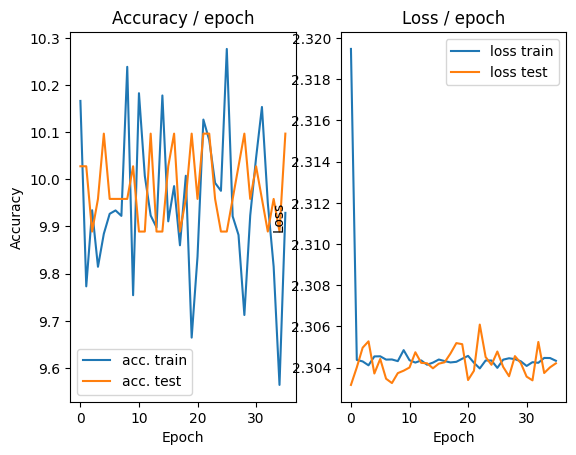

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.173s (0.173s)	Loss 2.3111 (2.3111)	Prec@1  10.2 ( 10.2)	Prec@5  46.9 ( 46.9)


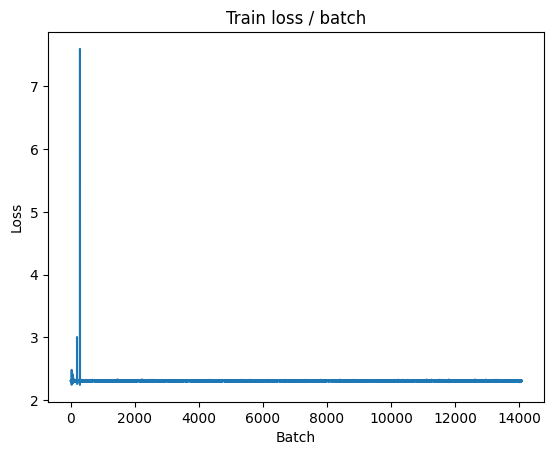

[TRAIN Batch 200/391]	Time 0.019s (0.019s)	Loss 2.2973 (2.3044)	Prec@1  17.2 (  9.9)	Prec@5  53.1 ( 50.2)


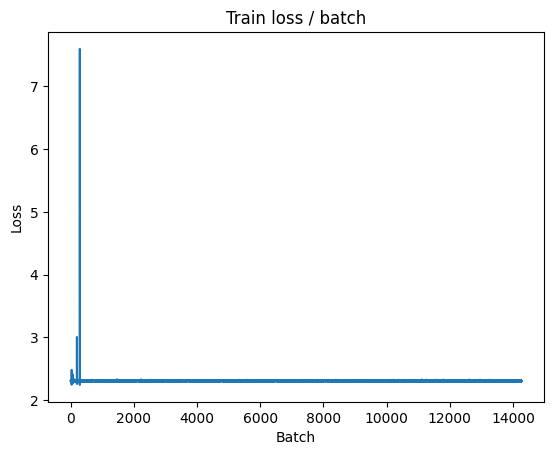


===============> Total time 7s	Avg loss 2.3043	Avg Prec@1  9.91 %	Avg Prec@5 50.27 %

[EVAL Batch 000/079]	Time 0.122s (0.122s)	Loss 2.2979 (2.2979)	Prec@1  10.2 ( 10.2)	Prec@5  53.1 ( 53.1)

===============> Total time 1s	Avg loss 2.3054	Avg Prec@1 10.03 %	Avg Prec@5 50.21 %



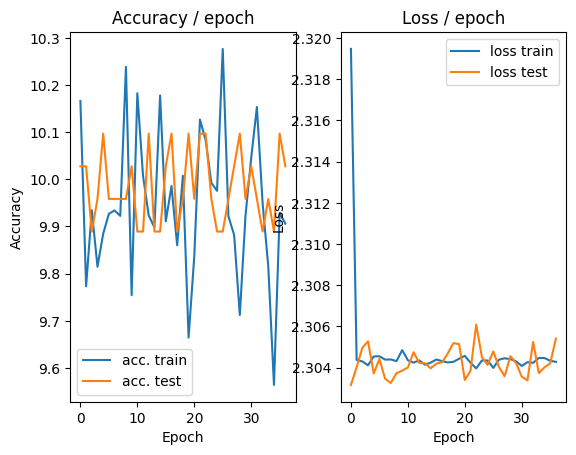

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.194s (0.194s)	Loss 2.3119 (2.3119)	Prec@1   9.4 (  9.4)	Prec@5  50.8 ( 50.8)


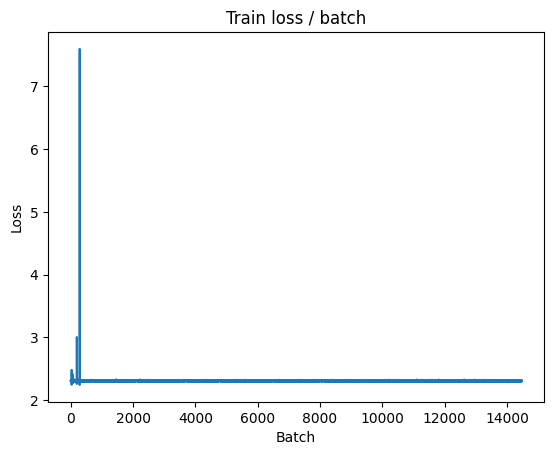

[TRAIN Batch 200/391]	Time 0.013s (0.023s)	Loss 2.3145 (2.3042)	Prec@1   9.4 (  9.7)	Prec@5  42.2 ( 50.3)


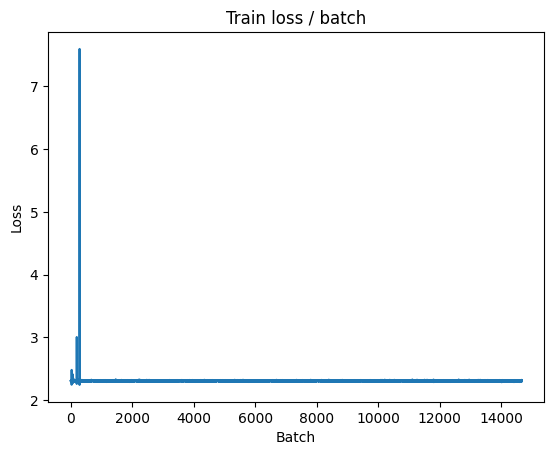


===============> Total time 8s	Avg loss 2.3043	Avg Prec@1  9.79 %	Avg Prec@5 50.09 %

[EVAL Batch 000/079]	Time 0.122s (0.122s)	Loss 2.2968 (2.2968)	Prec@1   8.6 (  8.6)	Prec@5  58.6 ( 58.6)

===============> Total time 1s	Avg loss 2.3036	Avg Prec@1  9.89 %	Avg Prec@5 50.07 %



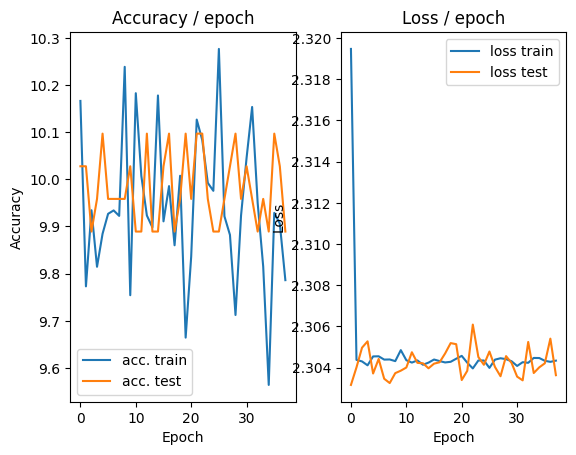

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.183s (0.183s)	Loss 2.3005 (2.3005)	Prec@1   7.8 (  7.8)	Prec@5  54.7 ( 54.7)


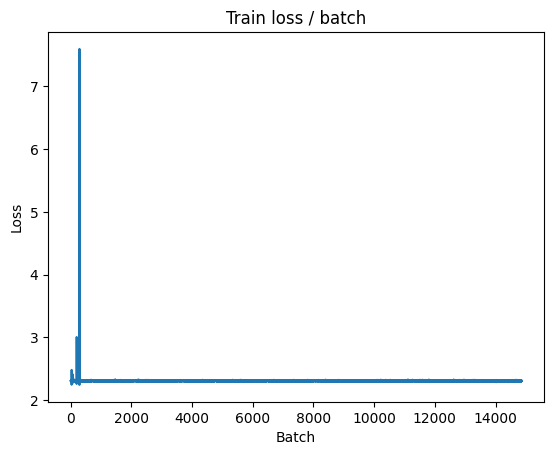

[TRAIN Batch 200/391]	Time 0.026s (0.024s)	Loss 2.2952 (2.3043)	Prec@1  11.7 (  9.9)	Prec@5  57.8 ( 49.8)


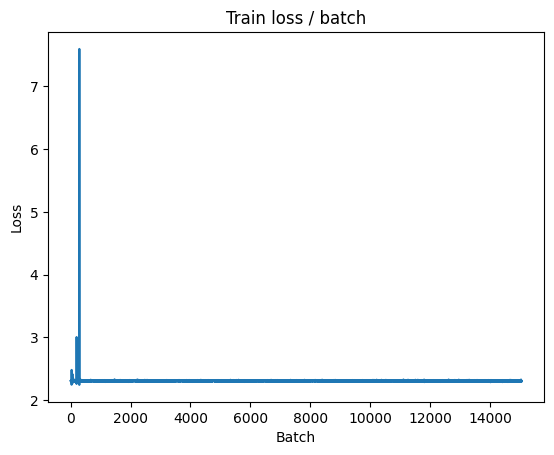


===============> Total time 8s	Avg loss 2.3044	Avg Prec@1  9.96 %	Avg Prec@5 49.97 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 2.3063 (2.3063)	Prec@1   7.8 (  7.8)	Prec@5  51.6 ( 51.6)

===============> Total time 1s	Avg loss 2.3034	Avg Prec@1  9.89 %	Avg Prec@5 49.86 %



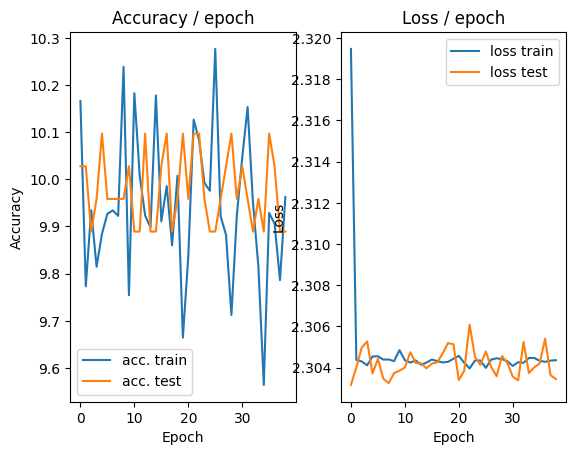

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.171s (0.171s)	Loss 2.3049 (2.3049)	Prec@1   8.6 (  8.6)	Prec@5  50.8 ( 50.8)


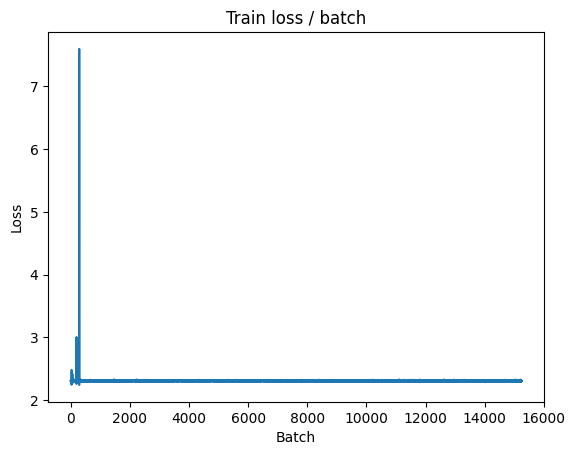

[TRAIN Batch 200/391]	Time 0.018s (0.020s)	Loss 2.3040 (2.3043)	Prec@1  11.7 ( 10.0)	Prec@5  52.3 ( 49.6)


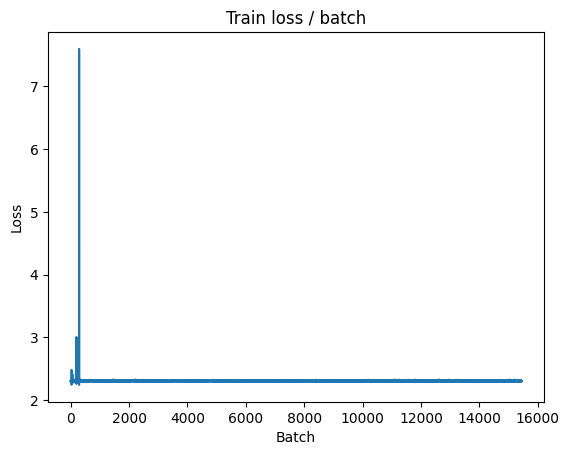


===============> Total time 8s	Avg loss 2.3044	Avg Prec@1  9.87 %	Avg Prec@5 49.74 %

[EVAL Batch 000/079]	Time 0.103s (0.103s)	Loss 2.3104 (2.3104)	Prec@1   7.0 (  7.0)	Prec@5  41.4 ( 41.4)

===============> Total time 1s	Avg loss 2.3043	Avg Prec@1 10.10 %	Avg Prec@5 49.86 %



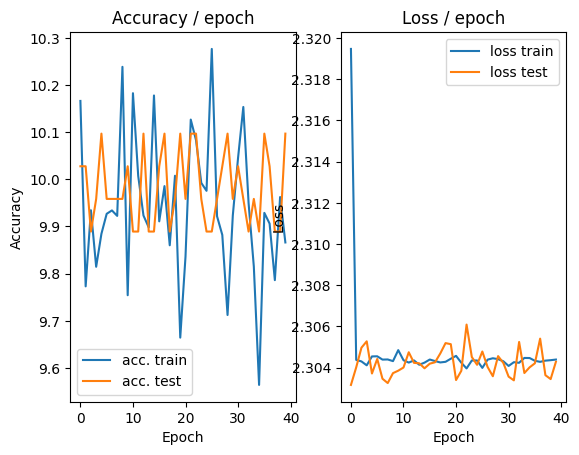

In [ ]:
main(128, 0.9, 40, cuda=True)
# grand lr

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.116s (0.116s)	Loss 2.3030 (2.3030)	Prec@1  10.9 ( 10.9)	Prec@5  46.9 ( 46.9)


<Figure size 640x480 with 0 Axes>

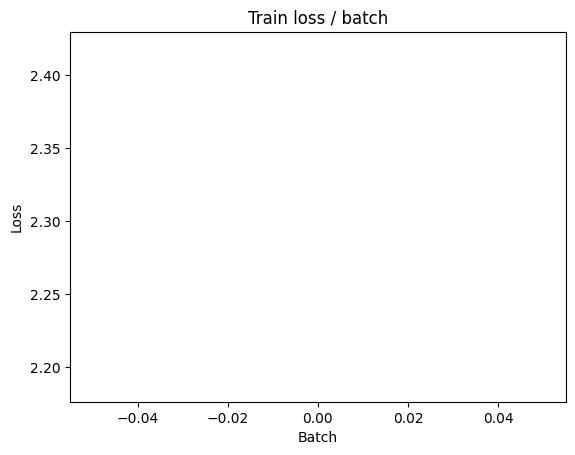

[TRAIN Batch 200/391]	Time 0.018s (0.019s)	Loss 2.3014 (2.3026)	Prec@1  14.1 ( 10.2)	Prec@5  52.3 ( 49.4)


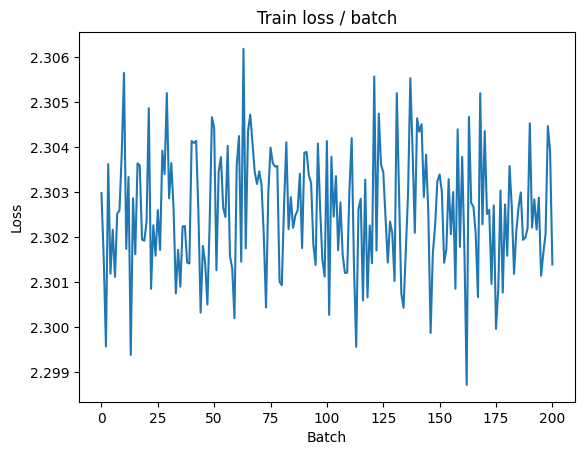


===============> Total time 7s	Avg loss 2.3025	Avg Prec@1 10.00 %	Avg Prec@5 49.71 %

[EVAL Batch 000/079]	Time 0.102s (0.102s)	Loss 2.3020 (2.3020)	Prec@1   8.6 (  8.6)	Prec@5  51.6 ( 51.6)

===============> Total time 1s	Avg loss 2.3023	Avg Prec@1  9.89 %	Avg Prec@5 50.26 %



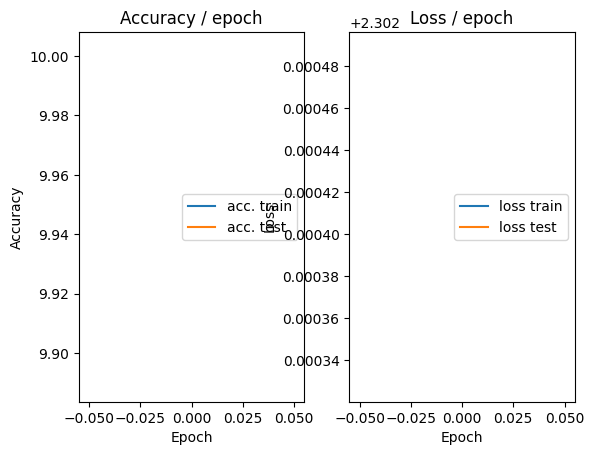

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 2.3010 (2.3010)	Prec@1  10.2 ( 10.2)	Prec@5  58.6 ( 58.6)


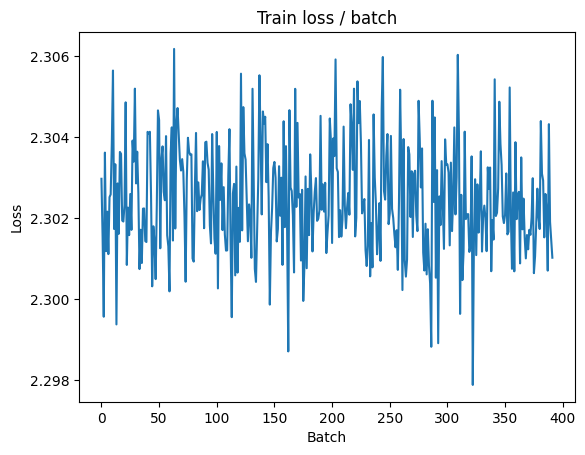

[TRAIN Batch 200/391]	Time 0.015s (0.020s)	Loss 2.3009 (2.3022)	Prec@1   8.6 ( 10.0)	Prec@5  58.6 ( 51.1)


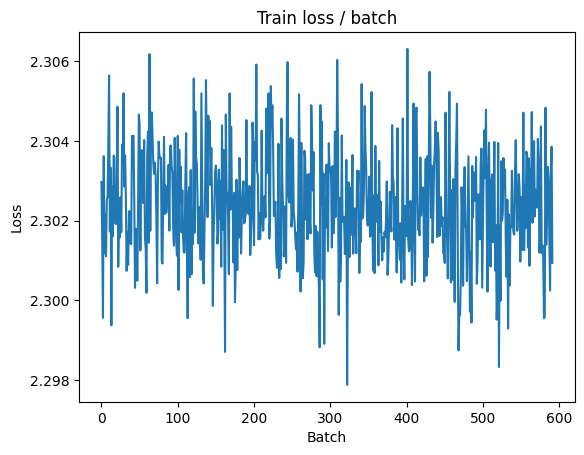


===============> Total time 7s	Avg loss 2.3022	Avg Prec@1 10.24 %	Avg Prec@5 51.24 %

[EVAL Batch 000/079]	Time 0.101s (0.101s)	Loss 2.3017 (2.3017)	Prec@1   9.4 (  9.4)	Prec@5  49.2 ( 49.2)

===============> Total time 1s	Avg loss 2.3020	Avg Prec@1 10.72 %	Avg Prec@5 51.30 %



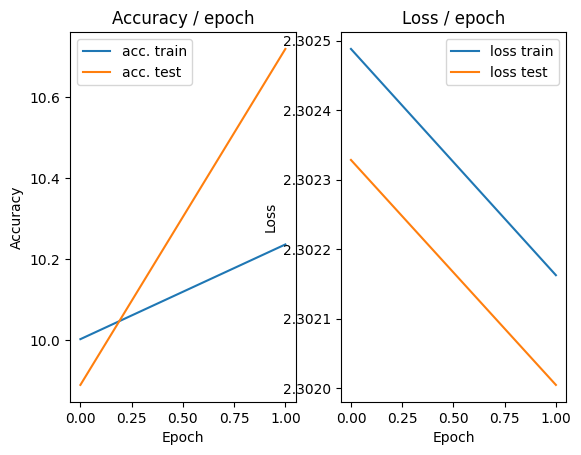

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.116s (0.116s)	Loss 2.3008 (2.3008)	Prec@1  15.6 ( 15.6)	Prec@5  53.9 ( 53.9)


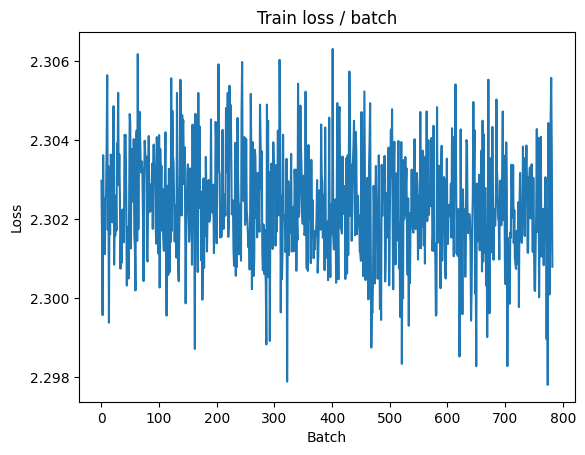

[TRAIN Batch 200/391]	Time 0.007s (0.024s)	Loss 2.3031 (2.3020)	Prec@1  12.5 ( 10.9)	Prec@5  46.1 ( 51.0)


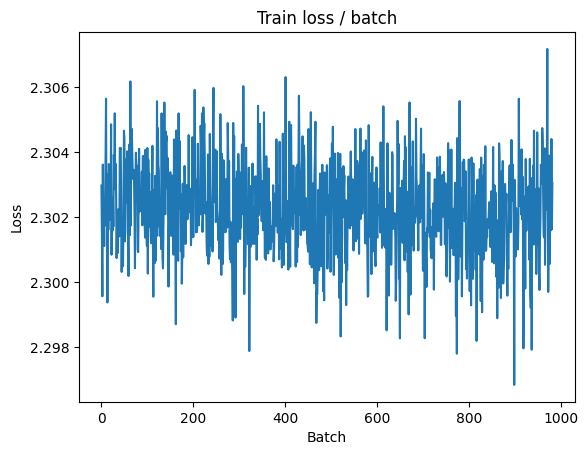


===============> Total time 8s	Avg loss 2.3019	Avg Prec@1 11.24 %	Avg Prec@5 51.32 %

[EVAL Batch 000/079]	Time 0.099s (0.099s)	Loss 2.3013 (2.3013)	Prec@1  10.9 ( 10.9)	Prec@5  48.4 ( 48.4)

===============> Total time 1s	Avg loss 2.3017	Avg Prec@1 12.21 %	Avg Prec@5 50.84 %



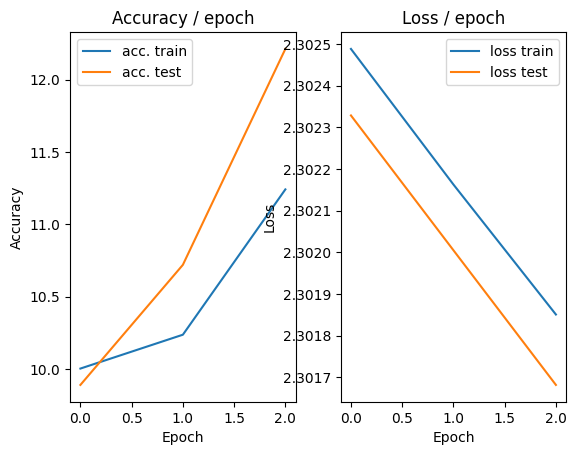

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.140s (0.140s)	Loss 2.3014 (2.3014)	Prec@1  13.3 ( 13.3)	Prec@5  53.1 ( 53.1)


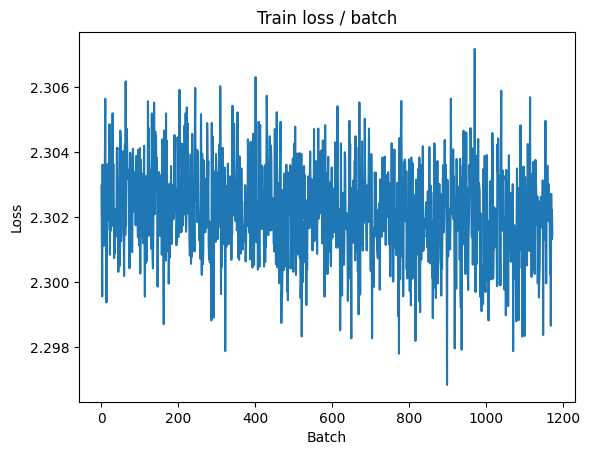

[TRAIN Batch 200/391]	Time 0.009s (0.019s)	Loss 2.3009 (2.3016)	Prec@1  14.8 ( 12.5)	Prec@5  53.1 ( 51.0)


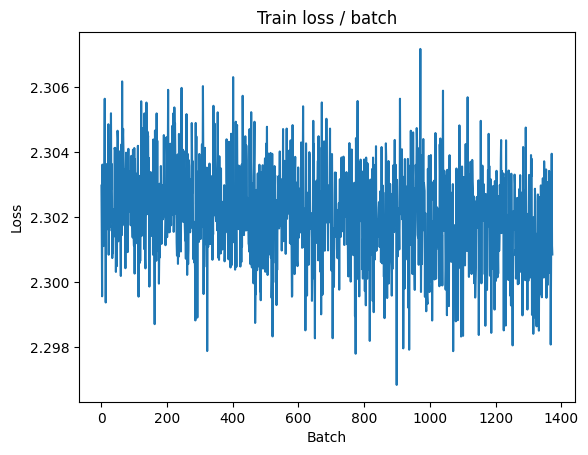


===============> Total time 8s	Avg loss 2.3015	Avg Prec@1 12.50 %	Avg Prec@5 50.91 %

[EVAL Batch 000/079]	Time 0.100s (0.100s)	Loss 2.3010 (2.3010)	Prec@1  10.9 ( 10.9)	Prec@5  48.4 ( 48.4)

===============> Total time 1s	Avg loss 2.3013	Avg Prec@1 12.89 %	Avg Prec@5 50.63 %



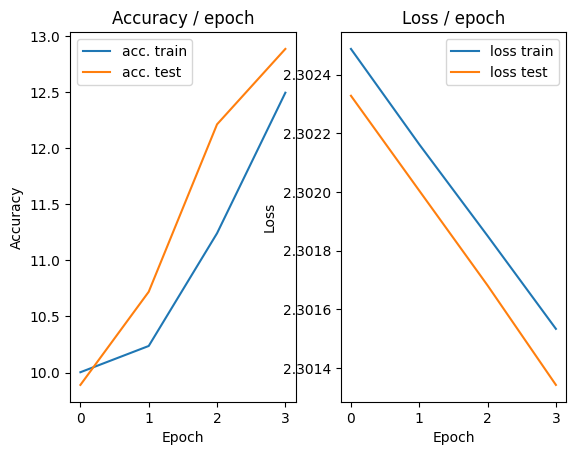

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 2.3027 (2.3027)	Prec@1  14.1 ( 14.1)	Prec@5  46.1 ( 46.1)


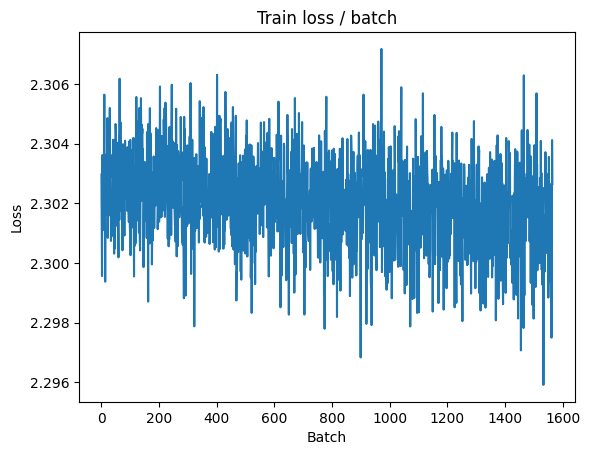

[TRAIN Batch 200/391]	Time 0.010s (0.019s)	Loss 2.3021 (2.3013)	Prec@1  11.7 ( 12.9)	Prec@5  52.3 ( 50.9)


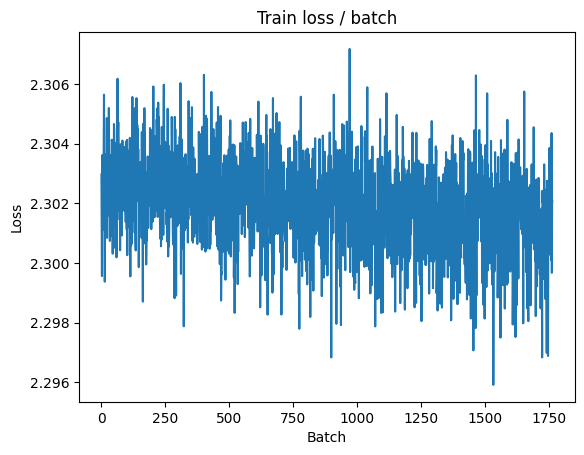


===============> Total time 7s	Avg loss 2.3012	Avg Prec@1 12.82 %	Avg Prec@5 50.99 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 2.3005 (2.3005)	Prec@1  12.5 ( 12.5)	Prec@5  48.4 ( 48.4)

===============> Total time 1s	Avg loss 2.3010	Avg Prec@1 12.71 %	Avg Prec@5 50.75 %



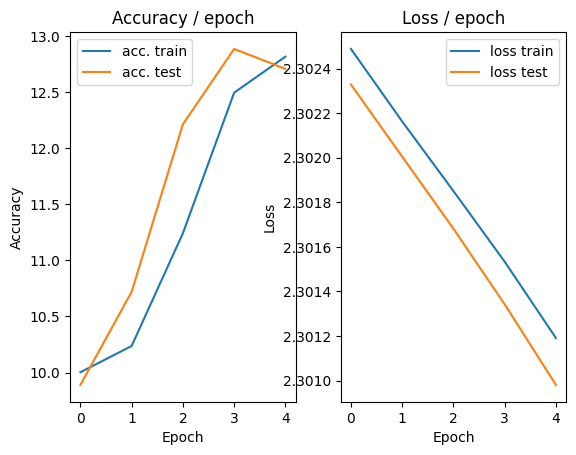

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 2.2996 (2.2996)	Prec@1  14.1 ( 14.1)	Prec@5  58.6 ( 58.6)


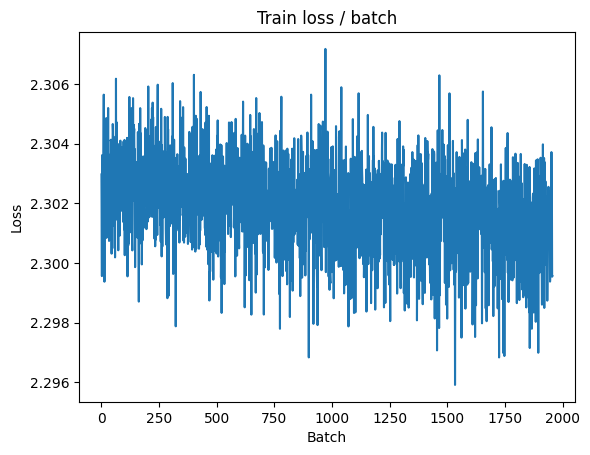

[TRAIN Batch 200/391]	Time 0.037s (0.019s)	Loss 2.2994 (2.3009)	Prec@1  10.2 ( 12.8)	Prec@5  57.0 ( 50.9)


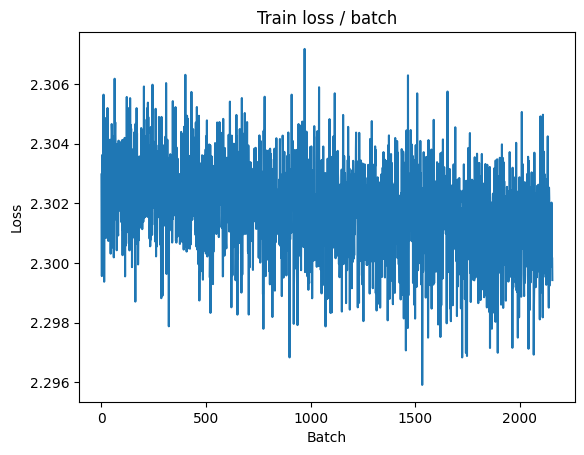


===============> Total time 7s	Avg loss 2.3008	Avg Prec@1 12.60 %	Avg Prec@5 51.00 %

[EVAL Batch 000/079]	Time 0.111s (0.111s)	Loss 2.3000 (2.3000)	Prec@1  12.5 ( 12.5)	Prec@5  47.7 ( 47.7)

===============> Total time 1s	Avg loss 2.3006	Avg Prec@1 12.27 %	Avg Prec@5 50.88 %



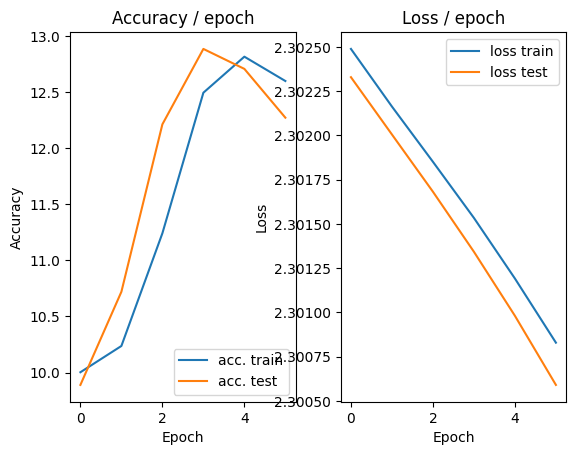

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 2.3011 (2.3011)	Prec@1  10.9 ( 10.9)	Prec@5  46.1 ( 46.1)


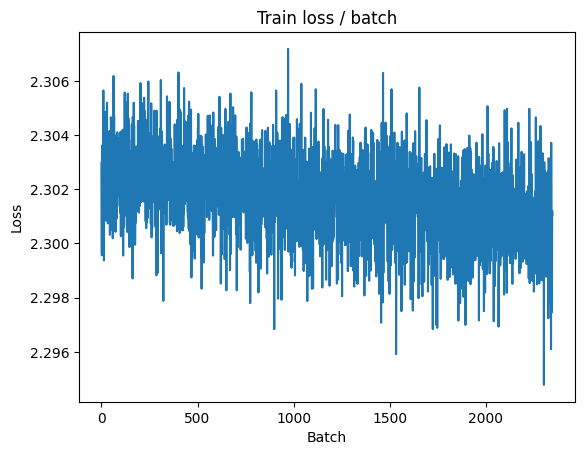

[TRAIN Batch 200/391]	Time 0.028s (0.024s)	Loss 2.3008 (2.3005)	Prec@1  11.7 ( 11.7)	Prec@5  49.2 ( 51.2)


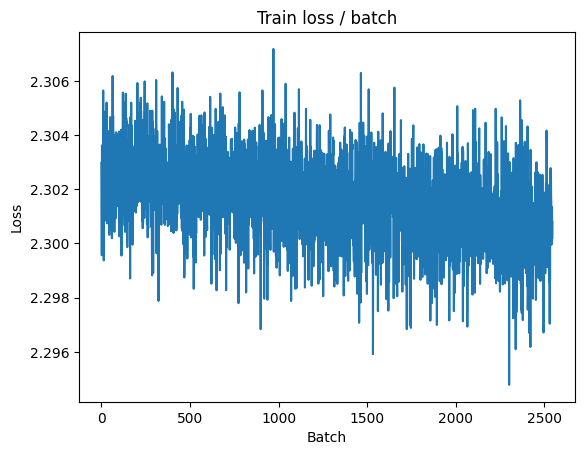


===============> Total time 8s	Avg loss 2.3004	Avg Prec@1 11.80 %	Avg Prec@5 51.08 %

[EVAL Batch 000/079]	Time 0.114s (0.114s)	Loss 2.2995 (2.2995)	Prec@1  10.2 ( 10.2)	Prec@5  47.7 ( 47.7)

===============> Total time 1s	Avg loss 2.3002	Avg Prec@1 11.42 %	Avg Prec@5 50.99 %



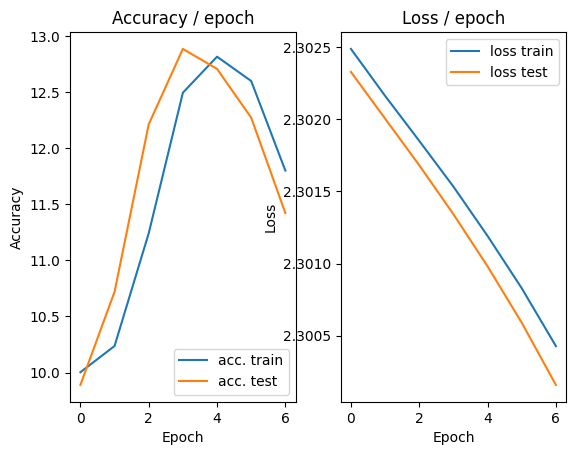

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.156s (0.156s)	Loss 2.3012 (2.3012)	Prec@1   8.6 (  8.6)	Prec@5  53.1 ( 53.1)


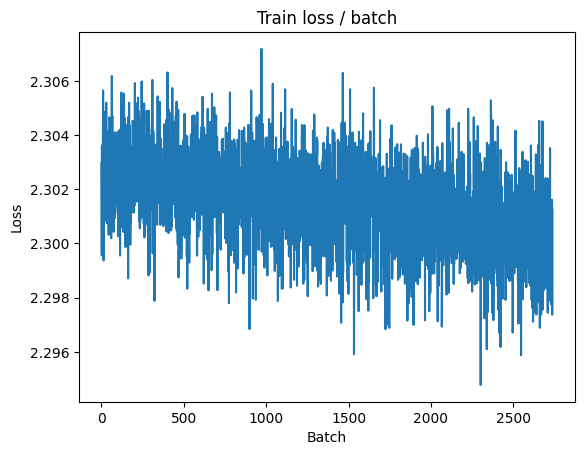

[TRAIN Batch 200/391]	Time 0.040s (0.024s)	Loss 2.2989 (2.3001)	Prec@1  11.7 ( 11.2)	Prec@5  52.3 ( 51.3)


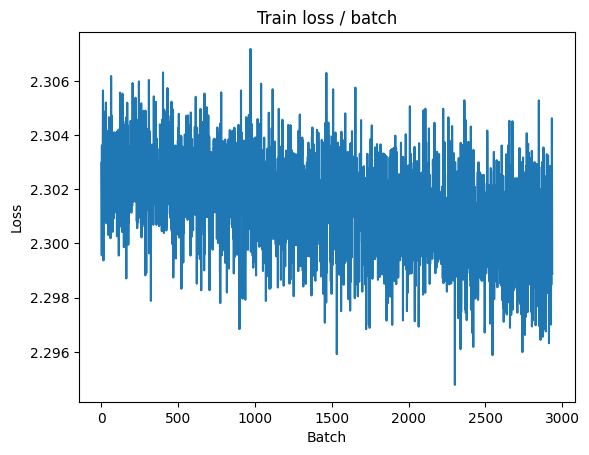


===============> Total time 8s	Avg loss 2.3000	Avg Prec@1 11.04 %	Avg Prec@5 51.40 %

[EVAL Batch 000/079]	Time 0.102s (0.102s)	Loss 2.2989 (2.2989)	Prec@1  10.9 ( 10.9)	Prec@5  47.7 ( 47.7)

===============> Total time 1s	Avg loss 2.2997	Avg Prec@1 10.89 %	Avg Prec@5 50.99 %



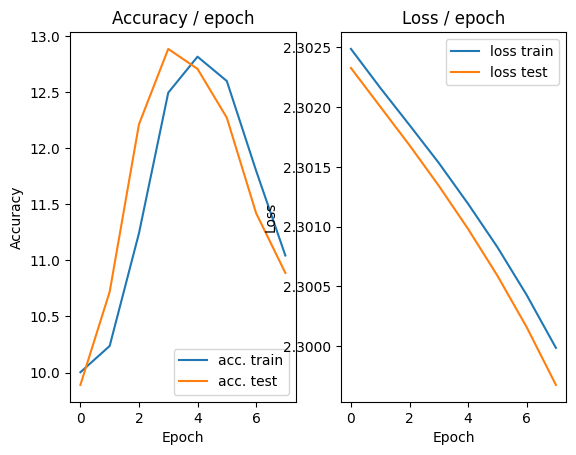

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 2.3008 (2.3008)	Prec@1   9.4 (  9.4)	Prec@5  48.4 ( 48.4)


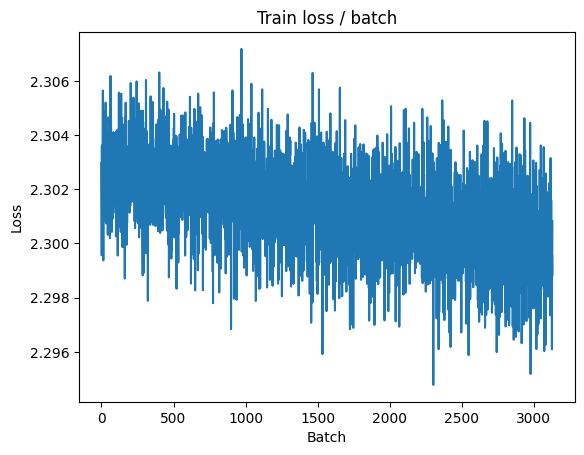

[TRAIN Batch 200/391]	Time 0.025s (0.019s)	Loss 2.2992 (2.2995)	Prec@1  11.7 ( 10.8)	Prec@5  53.9 ( 51.3)


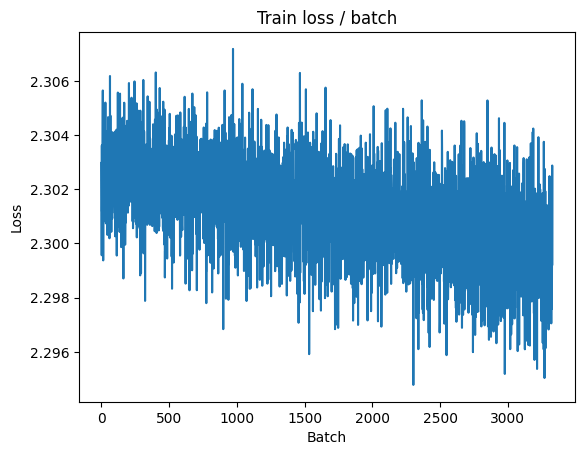


===============> Total time 8s	Avg loss 2.2995	Avg Prec@1 10.71 %	Avg Prec@5 51.46 %

[EVAL Batch 000/079]	Time 0.103s (0.103s)	Loss 2.2982 (2.2982)	Prec@1  10.2 ( 10.2)	Prec@5  47.7 ( 47.7)

===============> Total time 1s	Avg loss 2.2991	Avg Prec@1 10.59 %	Avg Prec@5 51.19 %



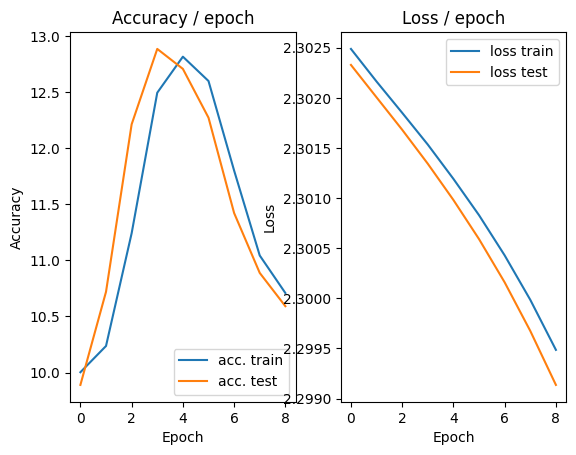

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 2.3011 (2.3011)	Prec@1  11.7 ( 11.7)	Prec@5  46.1 ( 46.1)


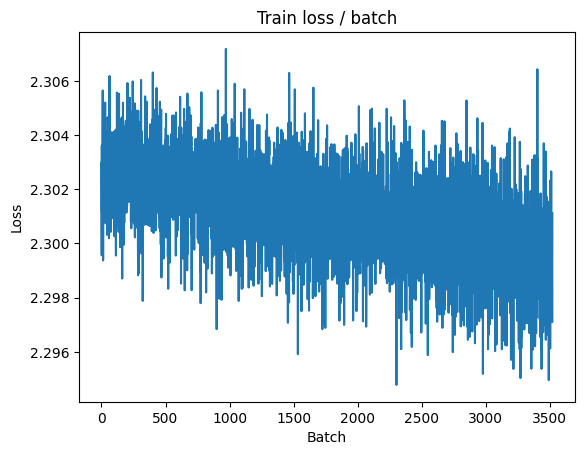

[TRAIN Batch 200/391]	Time 0.010s (0.019s)	Loss 2.2986 (2.2990)	Prec@1   9.4 ( 10.5)	Prec@5  57.0 ( 51.7)


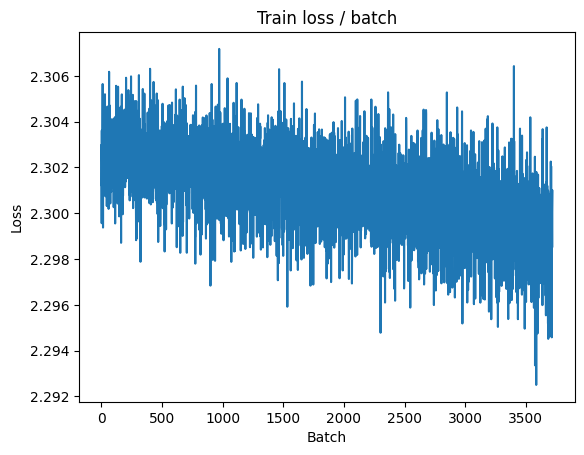


===============> Total time 7s	Avg loss 2.2989	Avg Prec@1 10.38 %	Avg Prec@5 51.63 %

[EVAL Batch 000/079]	Time 0.103s (0.103s)	Loss 2.2974 (2.2974)	Prec@1  10.9 ( 10.9)	Prec@5  48.4 ( 48.4)

===============> Total time 1s	Avg loss 2.2985	Avg Prec@1 10.41 %	Avg Prec@5 51.45 %



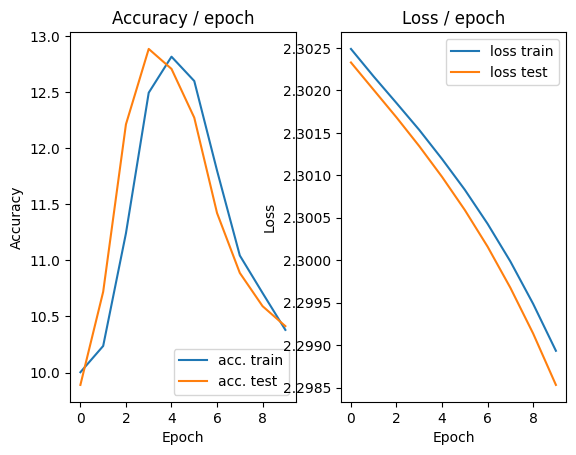

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 2.2995 (2.2995)	Prec@1   7.8 (  7.8)	Prec@5  50.0 ( 50.0)


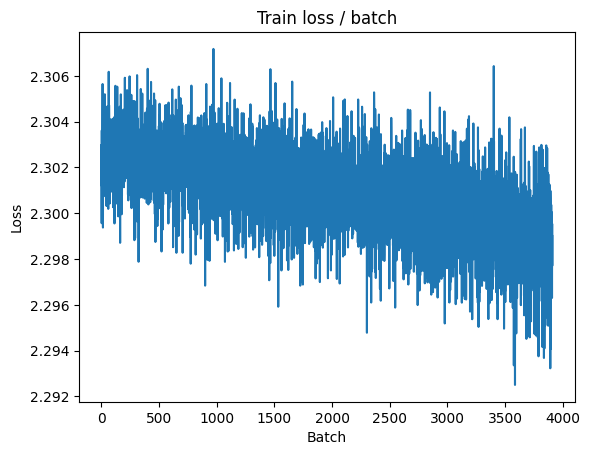

[TRAIN Batch 200/391]	Time 0.031s (0.020s)	Loss 2.2978 (2.2986)	Prec@1  11.7 ( 10.3)	Prec@5  57.8 ( 51.7)


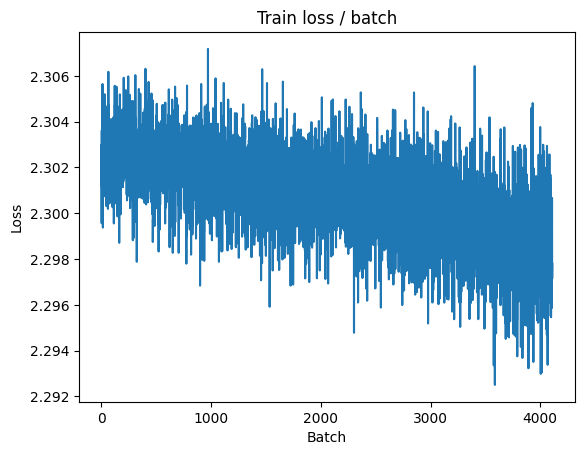


===============> Total time 7s	Avg loss 2.2983	Avg Prec@1 10.22 %	Avg Prec@5 52.02 %

[EVAL Batch 000/079]	Time 0.108s (0.108s)	Loss 2.2966 (2.2966)	Prec@1  10.2 ( 10.2)	Prec@5  49.2 ( 49.2)

===============> Total time 1s	Avg loss 2.2978	Avg Prec@1 10.22 %	Avg Prec@5 51.82 %



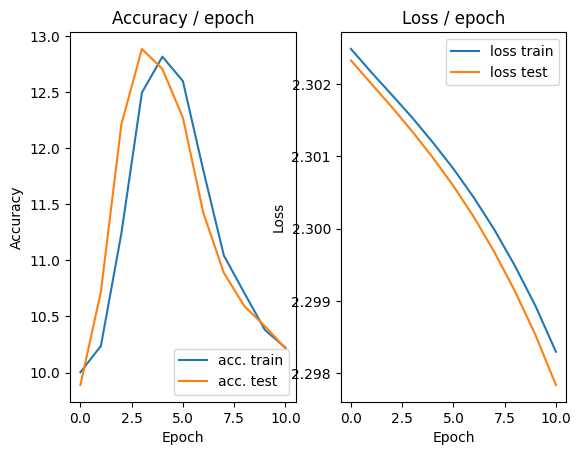

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 2.2976 (2.2976)	Prec@1  12.5 ( 12.5)	Prec@5  56.2 ( 56.2)


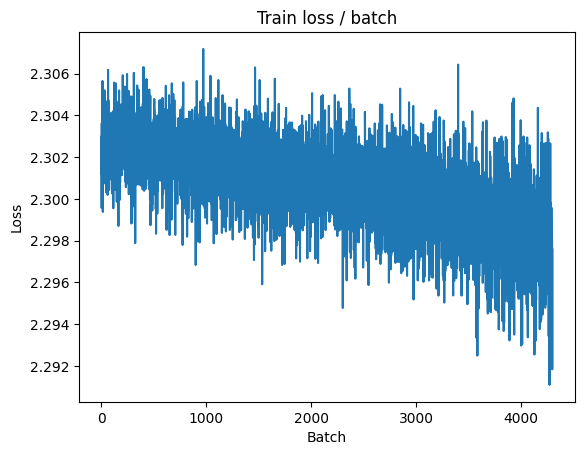

[TRAIN Batch 200/391]	Time 0.036s (0.024s)	Loss 2.2947 (2.2975)	Prec@1  18.0 ( 10.2)	Prec@5  53.1 ( 52.6)


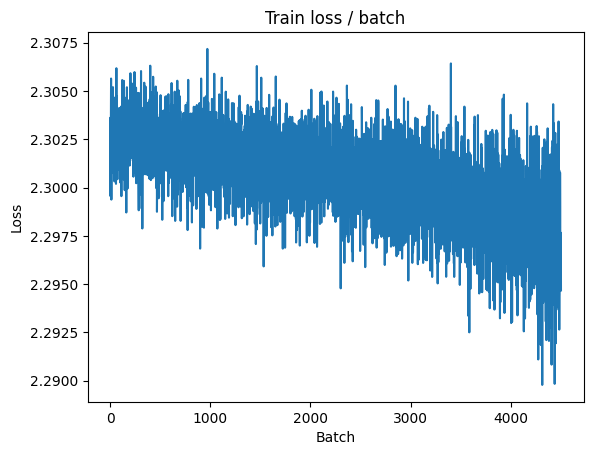


===============> Total time 8s	Avg loss 2.2976	Avg Prec@1 10.11 %	Avg Prec@5 52.27 %

[EVAL Batch 000/079]	Time 0.101s (0.101s)	Loss 2.2955 (2.2955)	Prec@1  10.2 ( 10.2)	Prec@5  49.2 ( 49.2)

===============> Total time 1s	Avg loss 2.2970	Avg Prec@1 10.19 %	Avg Prec@5 52.43 %



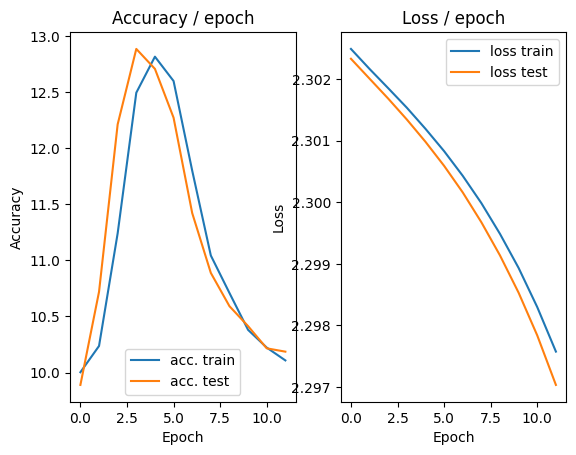

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 2.2920 (2.2920)	Prec@1  10.9 ( 10.9)	Prec@5  53.9 ( 53.9)


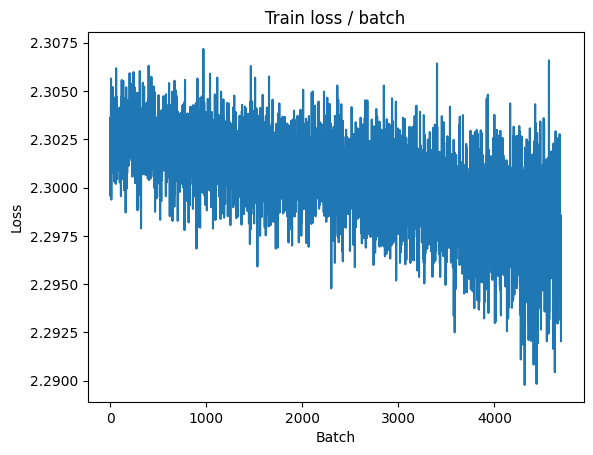

[TRAIN Batch 200/391]	Time 0.016s (0.019s)	Loss 2.2938 (2.2970)	Prec@1  10.9 ( 10.3)	Prec@5  44.5 ( 52.4)


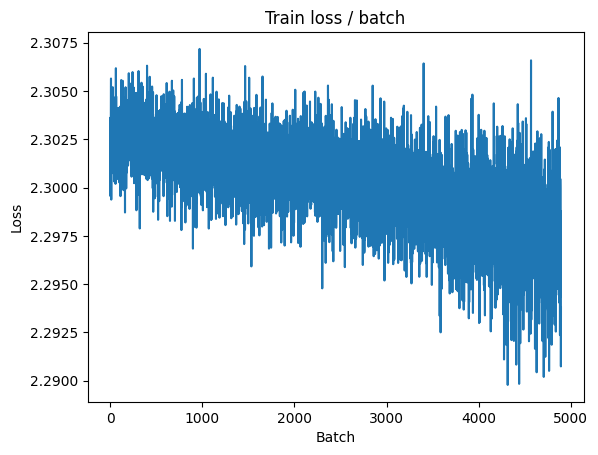


===============> Total time 8s	Avg loss 2.2967	Avg Prec@1 10.08 %	Avg Prec@5 52.79 %

[EVAL Batch 000/079]	Time 0.108s (0.108s)	Loss 2.2943 (2.2943)	Prec@1  10.2 ( 10.2)	Prec@5  52.3 ( 52.3)

===============> Total time 1s	Avg loss 2.2961	Avg Prec@1 10.16 %	Avg Prec@5 52.63 %



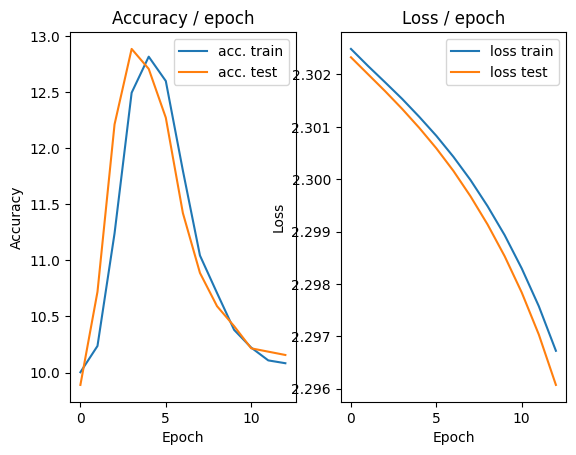

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.150s (0.150s)	Loss 2.2979 (2.2979)	Prec@1   7.0 (  7.0)	Prec@5  52.3 ( 52.3)


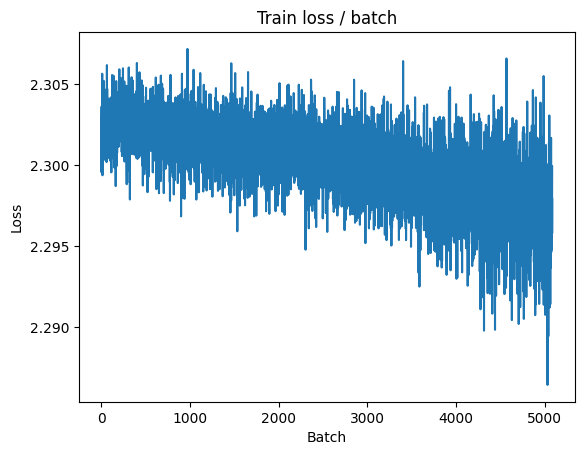

[TRAIN Batch 200/391]	Time 0.009s (0.023s)	Loss 2.2968 (2.2960)	Prec@1   8.6 ( 10.1)	Prec@5  53.9 ( 52.6)


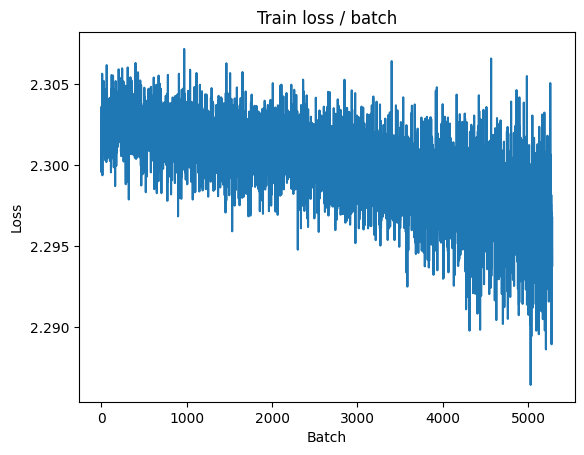


===============> Total time 9s	Avg loss 2.2957	Avg Prec@1 10.01 %	Avg Prec@5 52.92 %

[EVAL Batch 000/079]	Time 0.106s (0.106s)	Loss 2.2928 (2.2928)	Prec@1  10.2 ( 10.2)	Prec@5  51.6 ( 51.6)

===============> Total time 1s	Avg loss 2.2949	Avg Prec@1 10.15 %	Avg Prec@5 52.55 %



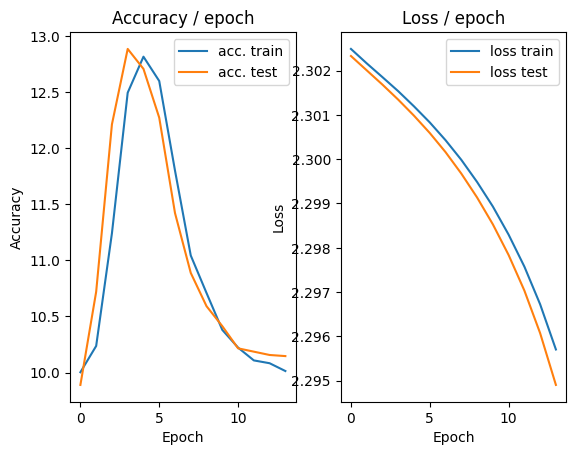

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.150s (0.150s)	Loss 2.2899 (2.2899)	Prec@1   6.2 (  6.2)	Prec@5  63.3 ( 63.3)


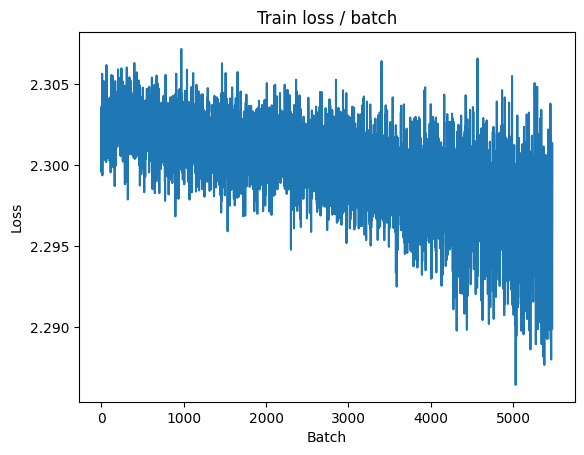

[TRAIN Batch 200/391]	Time 0.022s (0.019s)	Loss 2.2955 (2.2949)	Prec@1  10.2 ( 10.1)	Prec@5  53.1 ( 52.6)


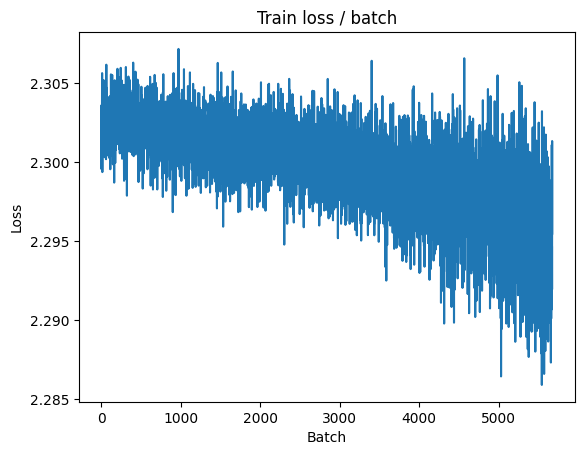


===============> Total time 7s	Avg loss 2.2945	Avg Prec@1 10.01 %	Avg Prec@5 52.67 %

[EVAL Batch 000/079]	Time 0.097s (0.097s)	Loss 2.2910 (2.2910)	Prec@1  10.2 ( 10.2)	Prec@5  50.0 ( 50.0)

===============> Total time 1s	Avg loss 2.2935	Avg Prec@1 10.14 %	Avg Prec@5 52.28 %



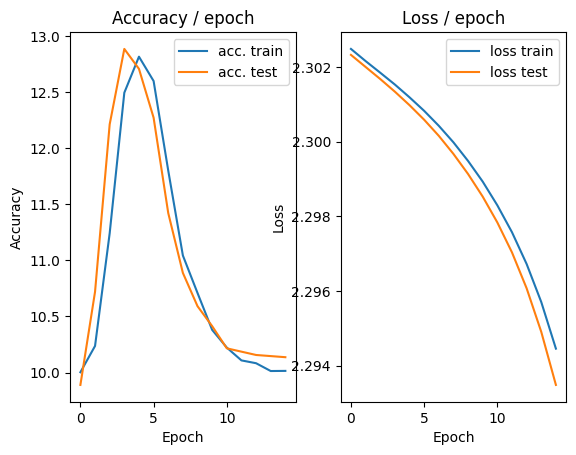

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.208s (0.208s)	Loss 2.2975 (2.2975)	Prec@1  10.2 ( 10.2)	Prec@5  53.1 ( 53.1)


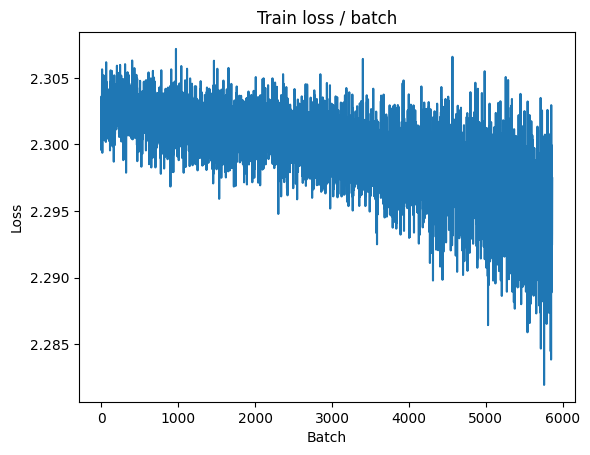

[TRAIN Batch 200/391]	Time 0.011s (0.021s)	Loss 2.2976 (2.2934)	Prec@1   7.8 ( 10.0)	Prec@5  45.3 ( 52.5)


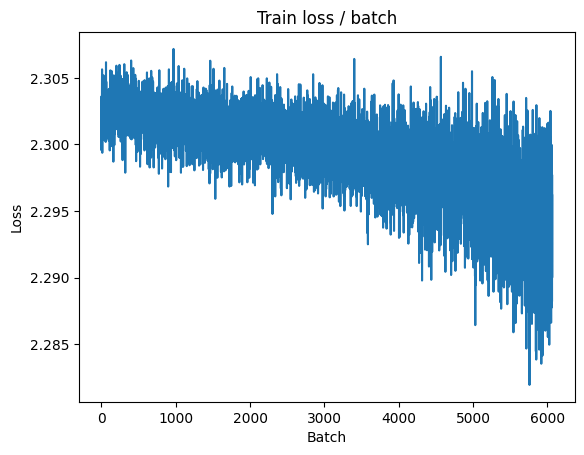


===============> Total time 7s	Avg loss 2.2929	Avg Prec@1 10.03 %	Avg Prec@5 52.59 %

[EVAL Batch 000/079]	Time 0.106s (0.106s)	Loss 2.2888 (2.2888)	Prec@1  10.2 ( 10.2)	Prec@5  49.2 ( 49.2)

===============> Total time 1s	Avg loss 2.2917	Avg Prec@1 10.08 %	Avg Prec@5 52.28 %



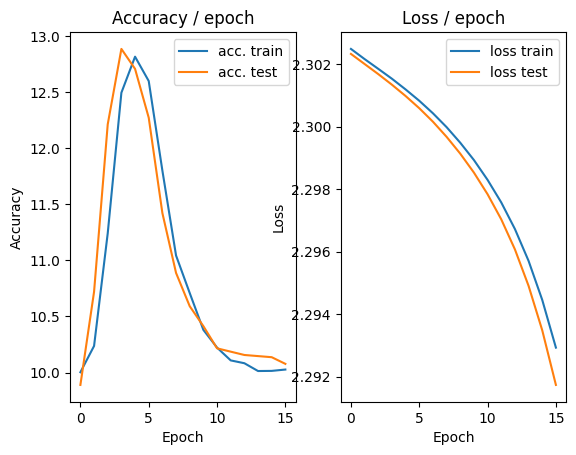

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 2.2932 (2.2932)	Prec@1  10.2 ( 10.2)	Prec@5  47.7 ( 47.7)


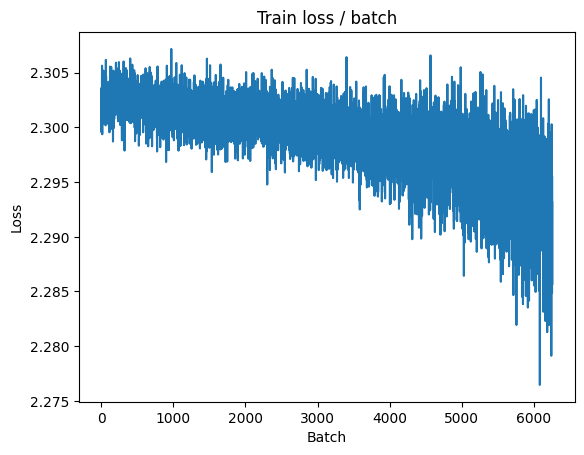

[TRAIN Batch 200/391]	Time 0.025s (0.025s)	Loss 2.2858 (2.2918)	Prec@1  10.2 ( 10.0)	Prec@5  55.5 ( 52.0)


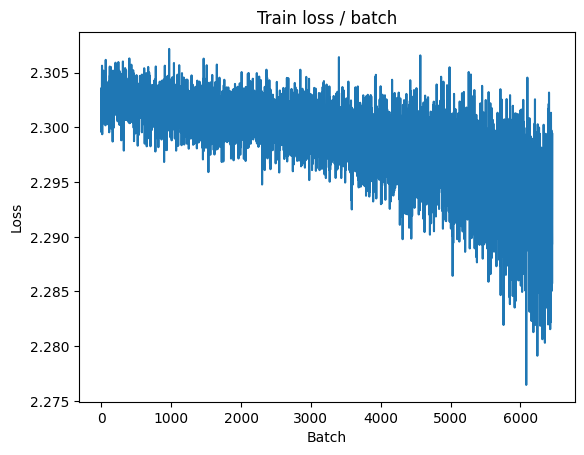


===============> Total time 8s	Avg loss 2.2911	Avg Prec@1 10.05 %	Avg Prec@5 52.50 %

[EVAL Batch 000/079]	Time 0.107s (0.107s)	Loss 2.2861 (2.2861)	Prec@1  10.2 ( 10.2)	Prec@5  50.0 ( 50.0)

===============> Total time 1s	Avg loss 2.2896	Avg Prec@1 10.12 %	Avg Prec@5 52.39 %



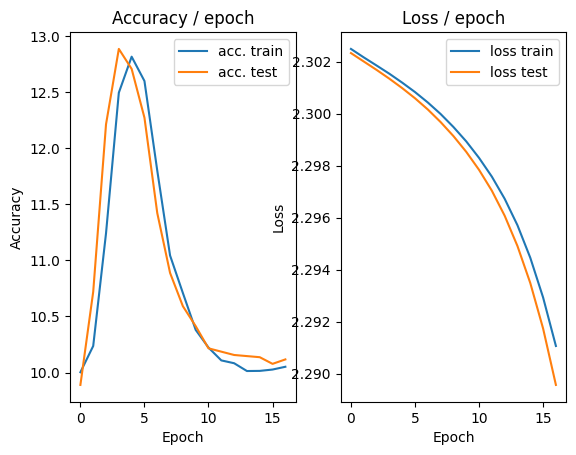

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 2.2803 (2.2803)	Prec@1  14.1 ( 14.1)	Prec@5  53.1 ( 53.1)


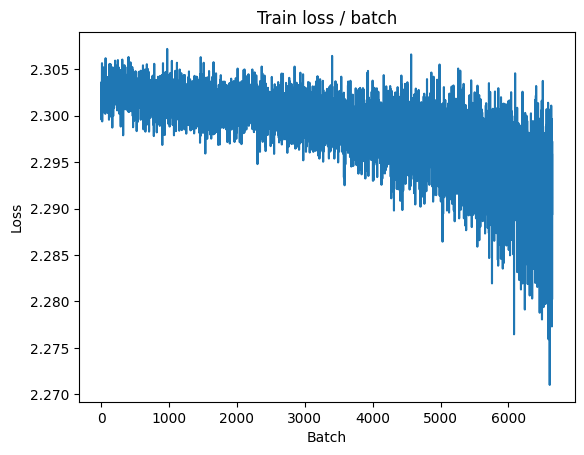

[TRAIN Batch 200/391]	Time 0.008s (0.019s)	Loss 2.2900 (2.2894)	Prec@1  11.7 ( 10.1)	Prec@5  51.6 ( 52.4)


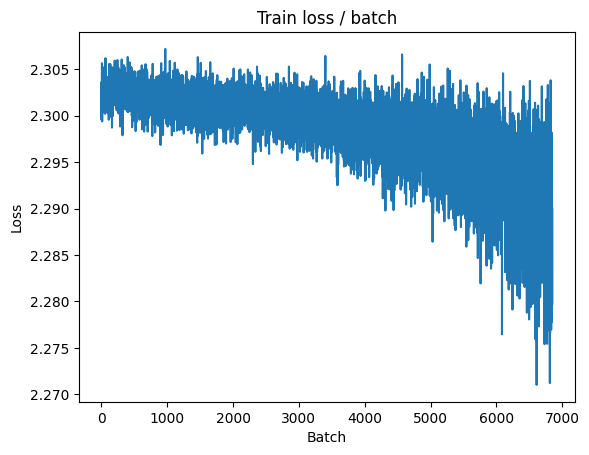


===============> Total time 8s	Avg loss 2.2887	Avg Prec@1 10.10 %	Avg Prec@5 52.61 %

[EVAL Batch 000/079]	Time 0.111s (0.111s)	Loss 2.2827 (2.2827)	Prec@1  10.2 ( 10.2)	Prec@5  50.8 ( 50.8)

===============> Total time 1s	Avg loss 2.2869	Avg Prec@1 10.17 %	Avg Prec@5 52.77 %



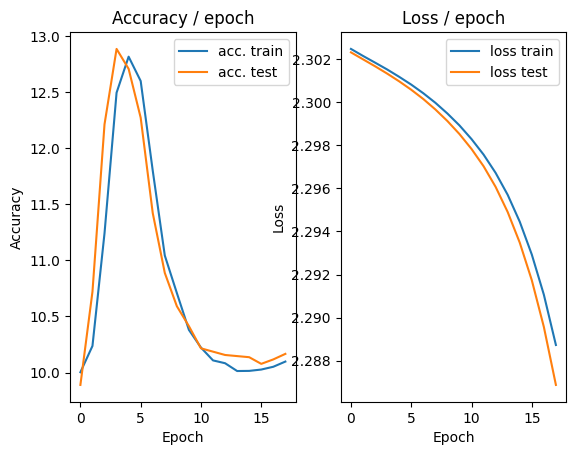

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.160s (0.160s)	Loss 2.2968 (2.2968)	Prec@1  12.5 ( 12.5)	Prec@5  46.9 ( 46.9)


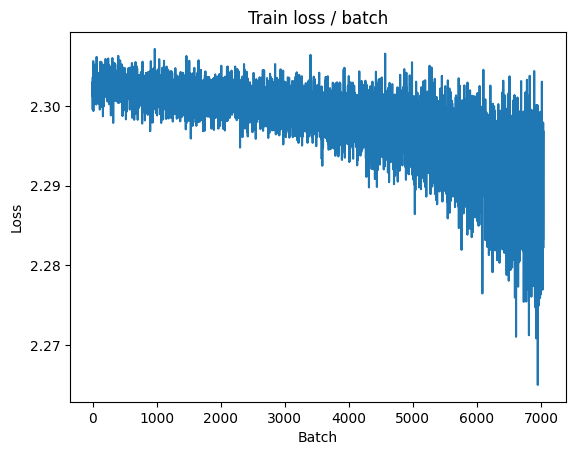

[TRAIN Batch 200/391]	Time 0.035s (0.019s)	Loss 2.2748 (2.2867)	Prec@1  13.3 ( 10.1)	Prec@5  57.0 ( 53.1)


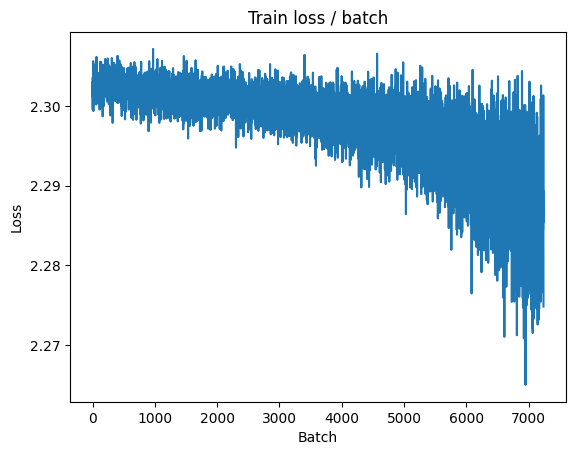


===============> Total time 8s	Avg loss 2.2858	Avg Prec@1 10.15 %	Avg Prec@5 53.19 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 2.2785 (2.2785)	Prec@1  10.2 ( 10.2)	Prec@5  50.0 ( 50.0)

===============> Total time 1s	Avg loss 2.2835	Avg Prec@1 10.23 %	Avg Prec@5 53.59 %



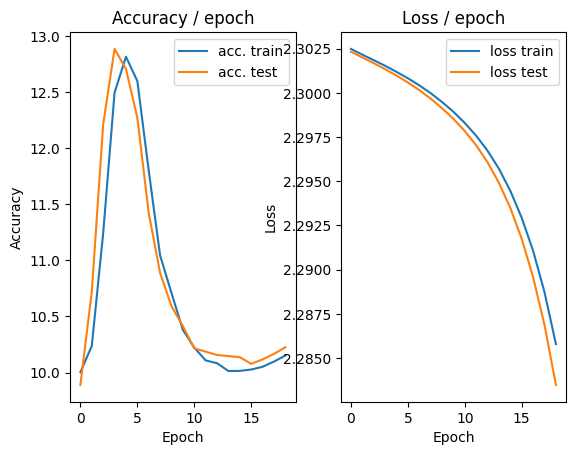

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.165s (0.165s)	Loss 2.2771 (2.2771)	Prec@1  11.7 ( 11.7)	Prec@5  53.9 ( 53.9)


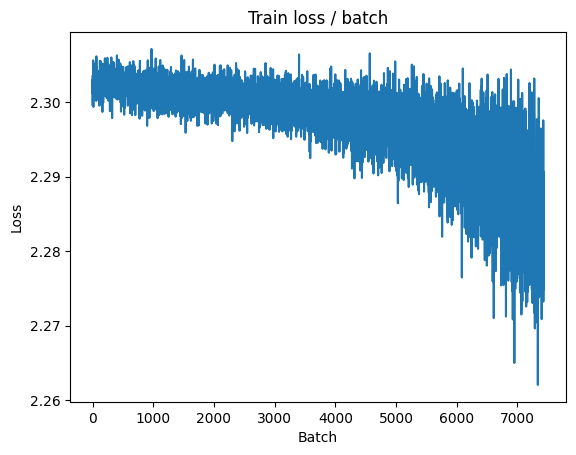

[TRAIN Batch 200/391]	Time 0.008s (0.020s)	Loss 2.2839 (2.2838)	Prec@1   8.6 ( 10.2)	Prec@5  54.7 ( 53.7)


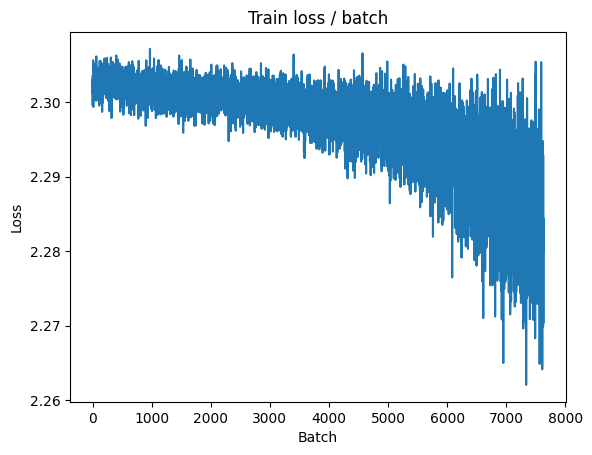


===============> Total time 7s	Avg loss 2.2821	Avg Prec@1 10.26 %	Avg Prec@5 54.21 %

[EVAL Batch 000/079]	Time 0.120s (0.120s)	Loss 2.2732 (2.2732)	Prec@1  10.9 ( 10.9)	Prec@5  50.8 ( 50.8)

===============> Total time 1s	Avg loss 2.2792	Avg Prec@1 10.41 %	Avg Prec@5 54.02 %



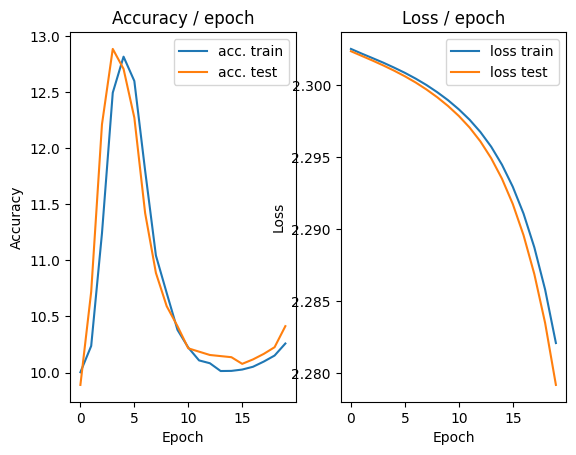

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.243s (0.243s)	Loss 2.2949 (2.2949)	Prec@1   3.1 (  3.1)	Prec@5  48.4 ( 48.4)


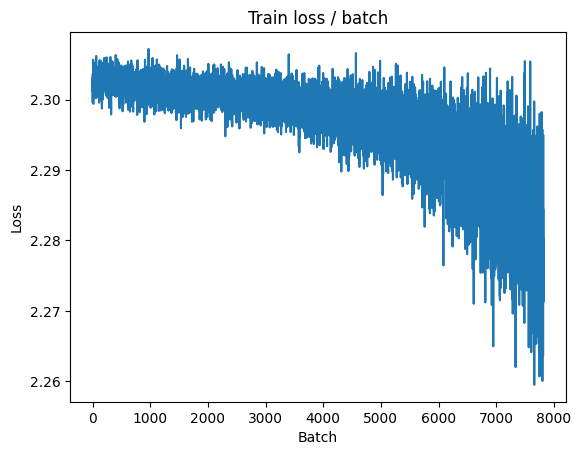

[TRAIN Batch 200/391]	Time 0.030s (0.022s)	Loss 2.2517 (2.2787)	Prec@1  16.4 ( 10.3)	Prec@5  61.7 ( 54.6)


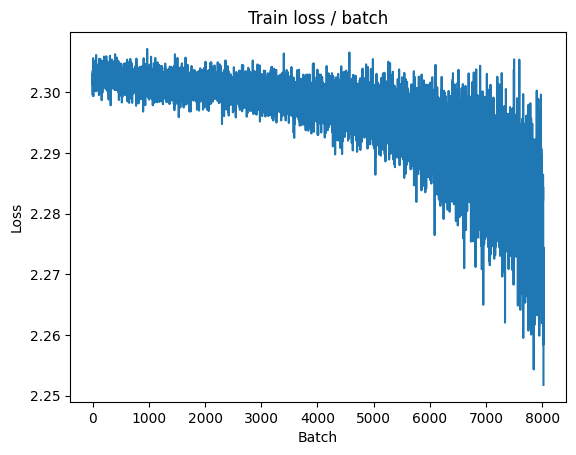


===============> Total time 8s	Avg loss 2.2774	Avg Prec@1 10.46 %	Avg Prec@5 54.87 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 2.2667 (2.2667)	Prec@1  10.9 ( 10.9)	Prec@5  52.3 ( 52.3)

===============> Total time 1s	Avg loss 2.2737	Avg Prec@1 10.69 %	Avg Prec@5 55.46 %



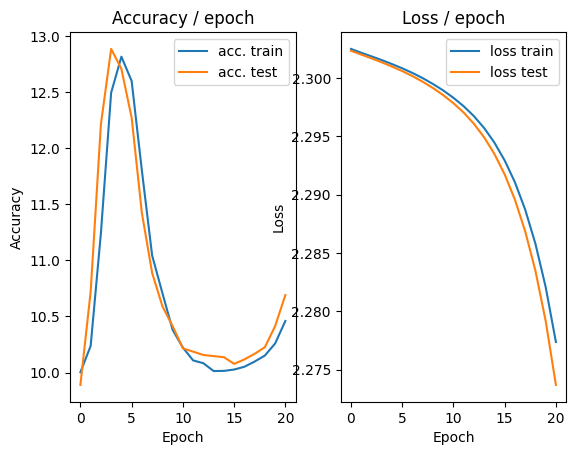

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.175s (0.175s)	Loss 2.2873 (2.2873)	Prec@1   9.4 (  9.4)	Prec@5  54.7 ( 54.7)


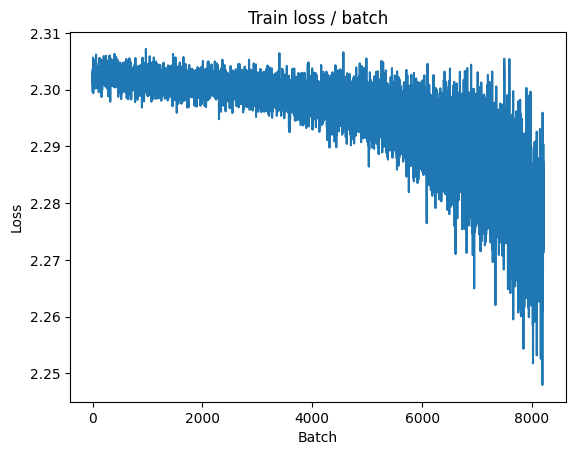

[TRAIN Batch 200/391]	Time 0.019s (0.024s)	Loss 2.2626 (2.2733)	Prec@1  12.5 ( 10.6)	Prec@5  60.9 ( 55.8)


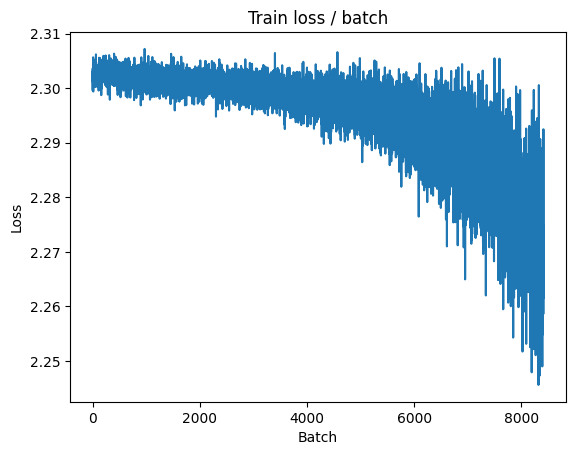


===============> Total time 8s	Avg loss 2.2712	Avg Prec@1 10.82 %	Avg Prec@5 56.25 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 2.2584 (2.2584)	Prec@1  12.5 ( 12.5)	Prec@5  54.7 ( 54.7)

===============> Total time 1s	Avg loss 2.2664	Avg Prec@1 11.16 %	Avg Prec@5 57.12 %



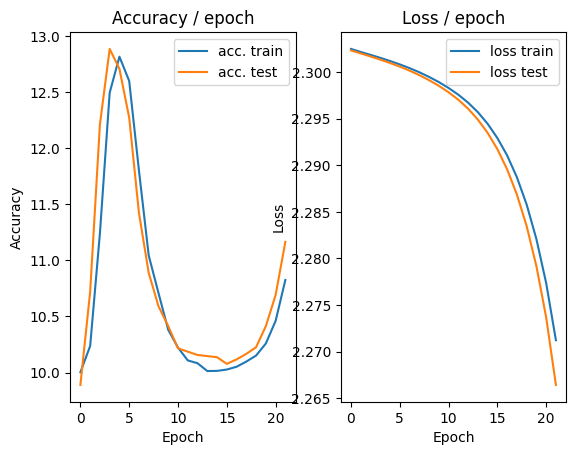

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.177s (0.177s)	Loss 2.2735 (2.2735)	Prec@1   7.8 (  7.8)	Prec@5  53.1 ( 53.1)


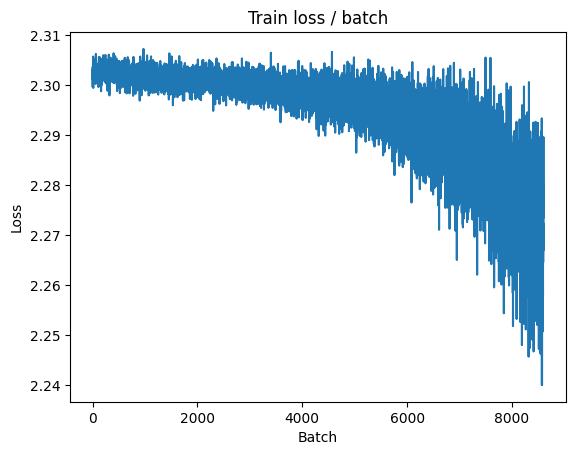

[TRAIN Batch 200/391]	Time 0.035s (0.020s)	Loss 2.2800 (2.2650)	Prec@1   6.2 ( 11.4)	Prec@5  61.7 ( 57.7)


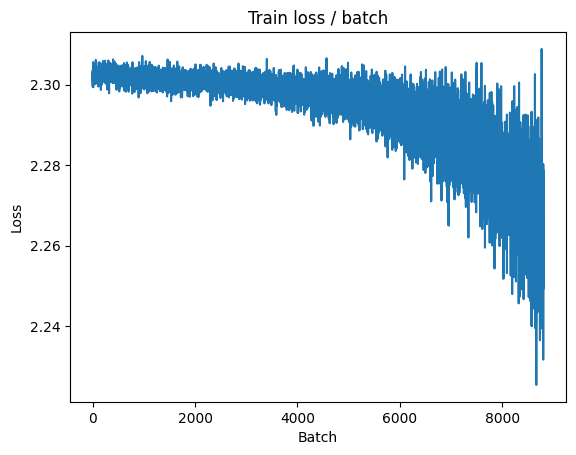


===============> Total time 8s	Avg loss 2.2629	Avg Prec@1 11.70 %	Avg Prec@5 58.35 %

[EVAL Batch 000/079]	Time 0.114s (0.114s)	Loss 2.2471 (2.2471)	Prec@1  15.6 ( 15.6)	Prec@5  57.0 ( 57.0)

===============> Total time 1s	Avg loss 2.2565	Avg Prec@1 12.09 %	Avg Prec@5 59.48 %



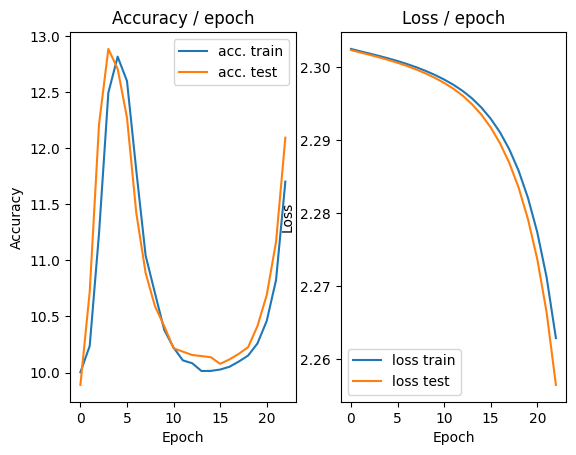

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.175s (0.175s)	Loss 2.2674 (2.2674)	Prec@1  13.3 ( 13.3)	Prec@5  57.8 ( 57.8)


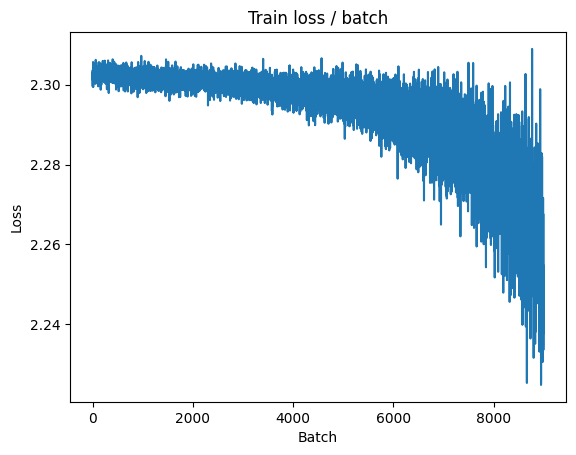

[TRAIN Batch 200/391]	Time 0.009s (0.020s)	Loss 2.2358 (2.2550)	Prec@1  10.9 ( 12.4)	Prec@5  64.1 ( 60.6)


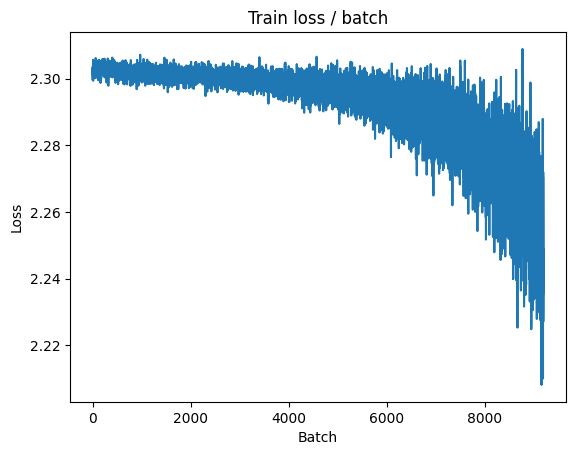


===============> Total time 7s	Avg loss 2.2512	Avg Prec@1 12.75 %	Avg Prec@5 61.33 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 2.2321 (2.2321)	Prec@1  15.6 ( 15.6)	Prec@5  60.2 ( 60.2)

===============> Total time 1s	Avg loss 2.2423	Avg Prec@1 14.19 %	Avg Prec@5 63.43 %



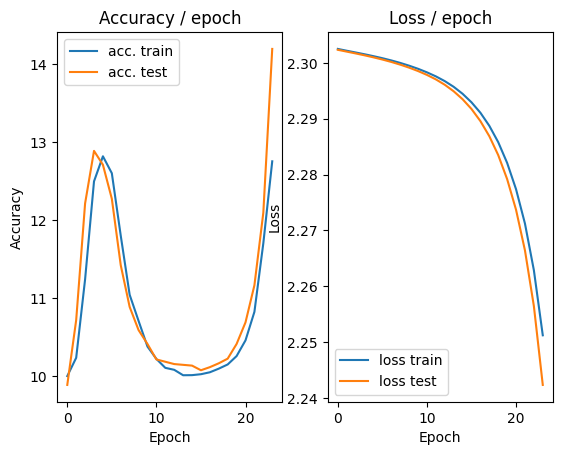

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.147s (0.147s)	Loss 2.2463 (2.2463)	Prec@1  10.2 ( 10.2)	Prec@5  53.9 ( 53.9)


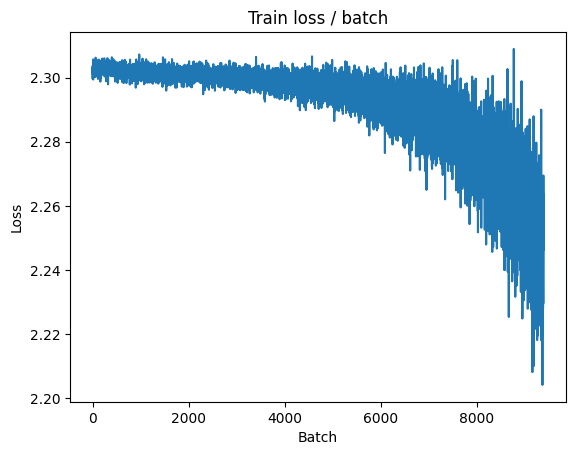

[TRAIN Batch 200/391]	Time 0.028s (0.020s)	Loss 2.2312 (2.2384)	Prec@1  10.2 ( 14.2)	Prec@5  64.1 ( 64.4)


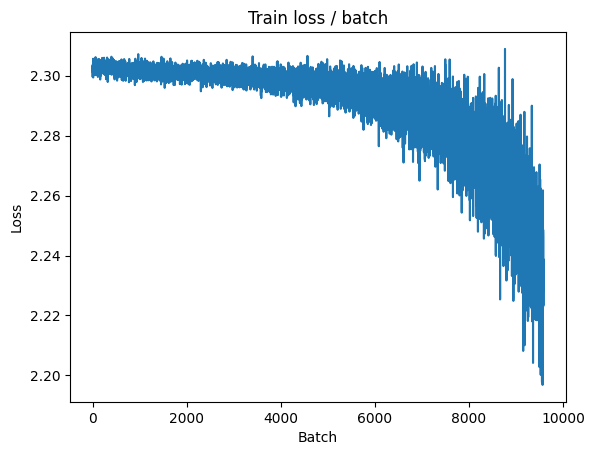


===============> Total time 7s	Avg loss 2.2345	Avg Prec@1 14.88 %	Avg Prec@5 65.20 %

[EVAL Batch 000/079]	Time 0.115s (0.115s)	Loss 2.2106 (2.2106)	Prec@1  16.4 ( 16.4)	Prec@5  68.8 ( 68.8)

===============> Total time 1s	Avg loss 2.2219	Avg Prec@1 17.11 %	Avg Prec@5 67.33 %



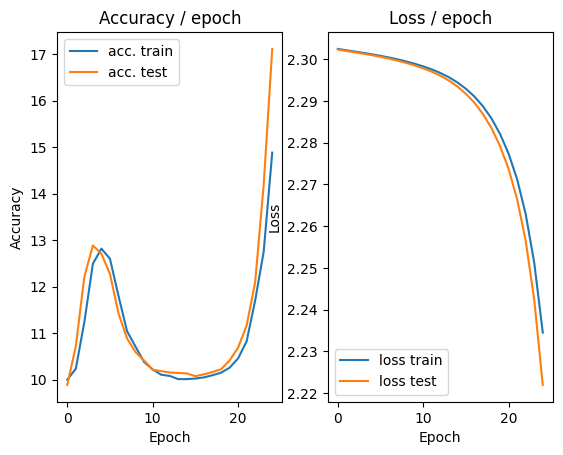

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 2.2442 (2.2442)	Prec@1  11.7 ( 11.7)	Prec@5  64.1 ( 64.1)


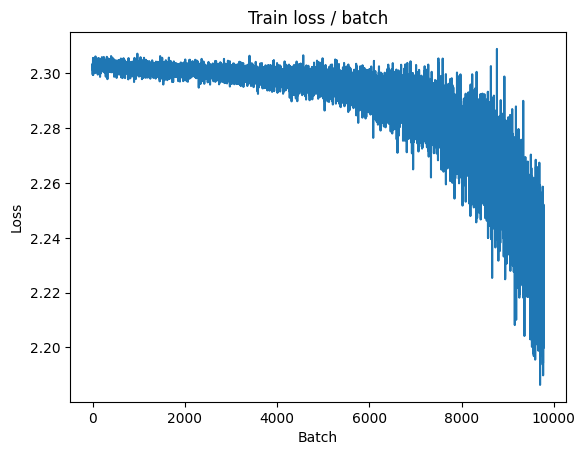

[TRAIN Batch 200/391]	Time 0.015s (0.025s)	Loss 2.2449 (2.2169)	Prec@1  14.8 ( 17.6)	Prec@5  64.1 ( 68.3)


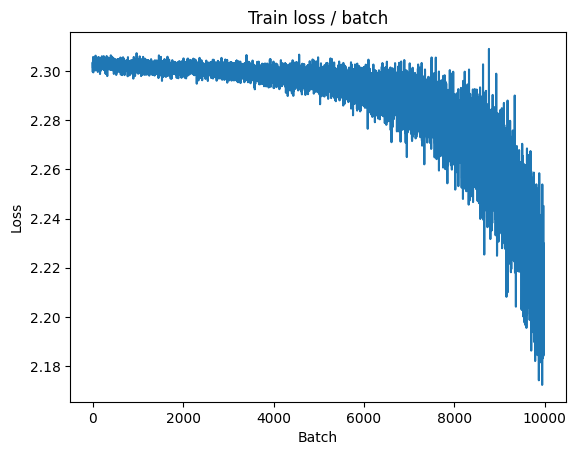


===============> Total time 8s	Avg loss 2.2103	Avg Prec@1 18.03 %	Avg Prec@5 69.16 %

[EVAL Batch 000/079]	Time 0.114s (0.114s)	Loss 2.1812 (2.1812)	Prec@1  18.0 ( 18.0)	Prec@5  71.9 ( 71.9)

===============> Total time 1s	Avg loss 2.1926	Avg Prec@1 19.67 %	Avg Prec@5 71.44 %



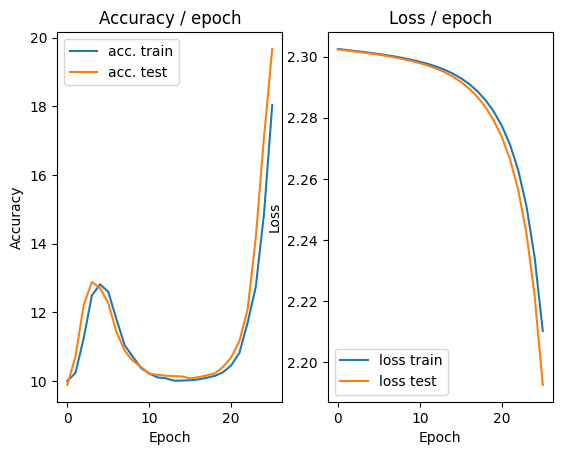

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.175s (0.175s)	Loss 2.1967 (2.1967)	Prec@1  26.6 ( 26.6)	Prec@5  75.0 ( 75.0)


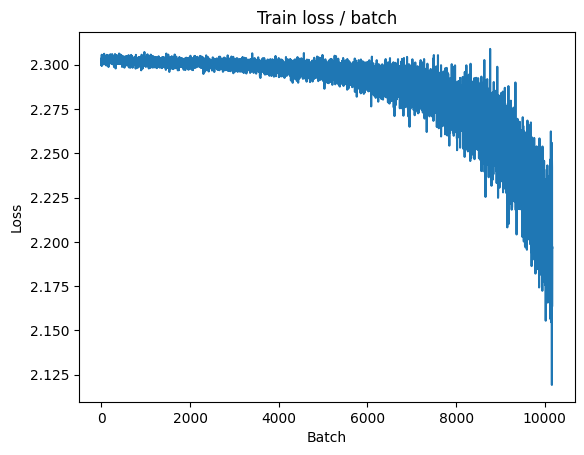

[TRAIN Batch 200/391]	Time 0.009s (0.024s)	Loss 2.1246 (2.1857)	Prec@1  28.1 ( 19.9)	Prec@5  80.5 ( 72.1)


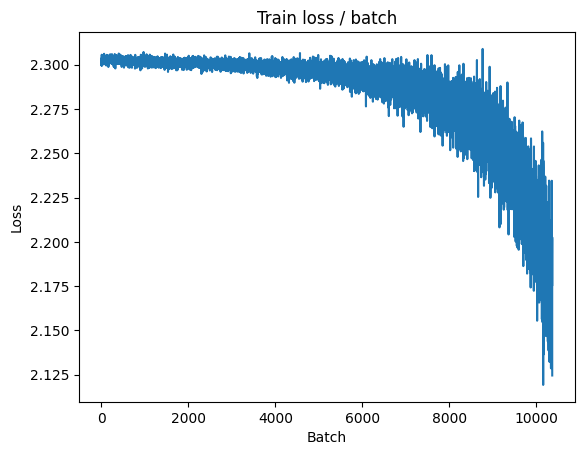


===============> Total time 8s	Avg loss 2.1758	Avg Prec@1 20.50 %	Avg Prec@5 72.82 %

[EVAL Batch 000/079]	Time 0.122s (0.122s)	Loss 2.1406 (2.1406)	Prec@1  25.0 ( 25.0)	Prec@5  75.0 ( 75.0)

===============> Total time 1s	Avg loss 2.1514	Avg Prec@1 22.21 %	Avg Prec@5 73.78 %



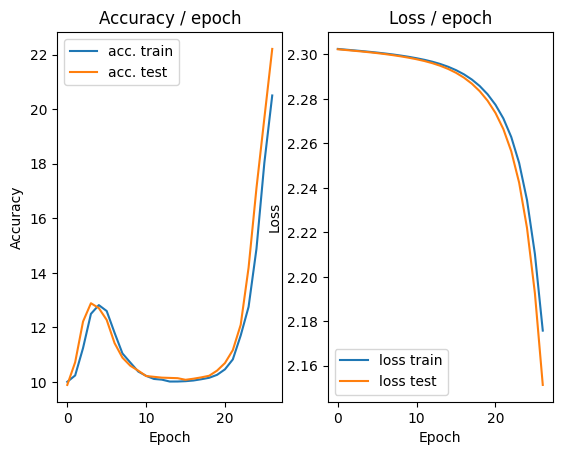

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 2.1426 (2.1426)	Prec@1  18.8 ( 18.8)	Prec@5  70.3 ( 70.3)


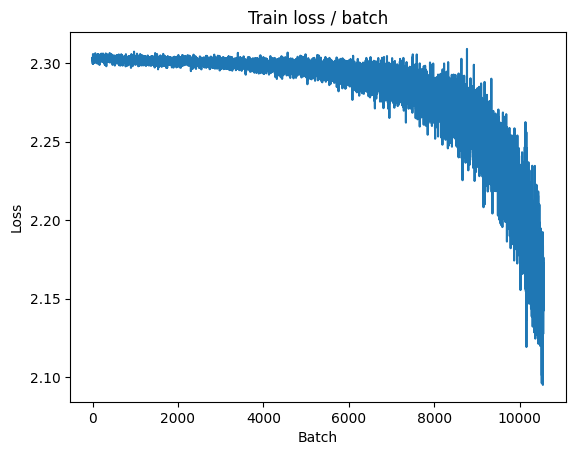

[TRAIN Batch 200/391]	Time 0.022s (0.020s)	Loss 2.0847 (2.1413)	Prec@1  21.9 ( 22.6)	Prec@5  75.0 ( 74.5)


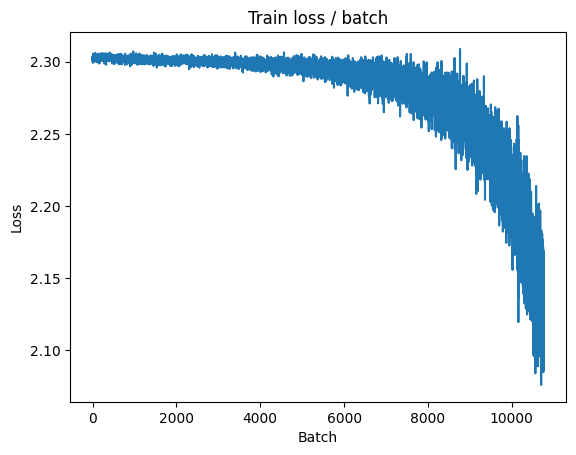


===============> Total time 8s	Avg loss 2.1290	Avg Prec@1 23.01 %	Avg Prec@5 74.84 %

[EVAL Batch 000/079]	Time 0.121s (0.121s)	Loss 2.0914 (2.0914)	Prec@1  31.2 ( 31.2)	Prec@5  79.7 ( 79.7)

===============> Total time 1s	Avg loss 2.0985	Avg Prec@1 25.01 %	Avg Prec@5 75.90 %



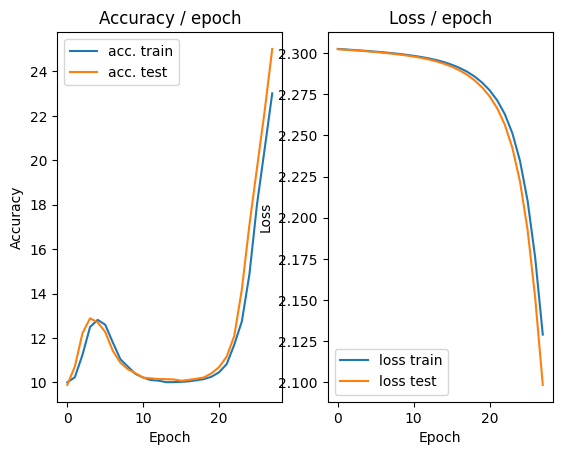

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.198s (0.198s)	Loss 2.0743 (2.0743)	Prec@1  25.8 ( 25.8)	Prec@5  79.7 ( 79.7)


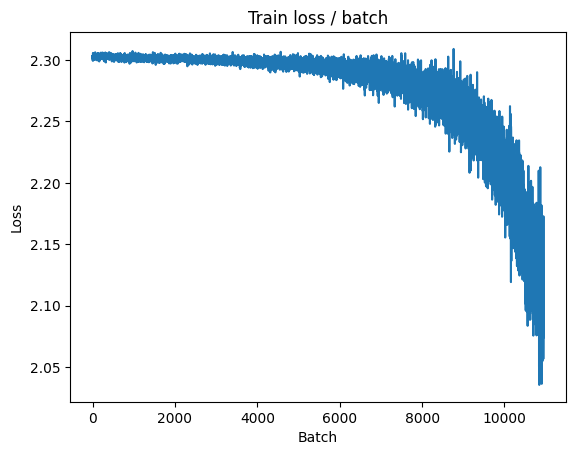

[TRAIN Batch 200/391]	Time 0.028s (0.020s)	Loss 2.0660 (2.0891)	Prec@1  24.2 ( 24.4)	Prec@5  78.1 ( 75.7)


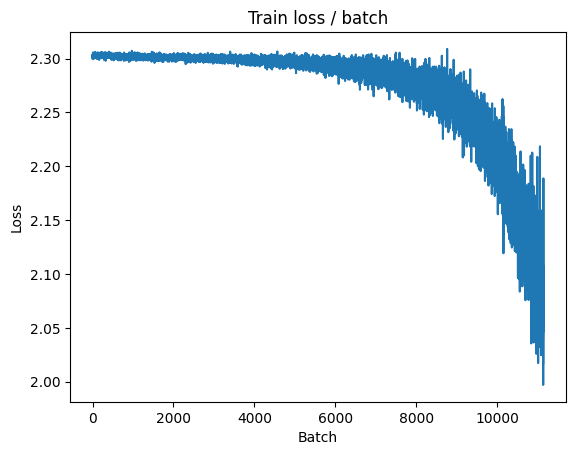


===============> Total time 7s	Avg loss 2.0783	Avg Prec@1 24.64 %	Avg Prec@5 75.86 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 2.0469 (2.0469)	Prec@1  33.6 ( 33.6)	Prec@5  81.2 ( 81.2)

===============> Total time 2s	Avg loss 2.0522	Avg Prec@1 26.03 %	Avg Prec@5 76.31 %



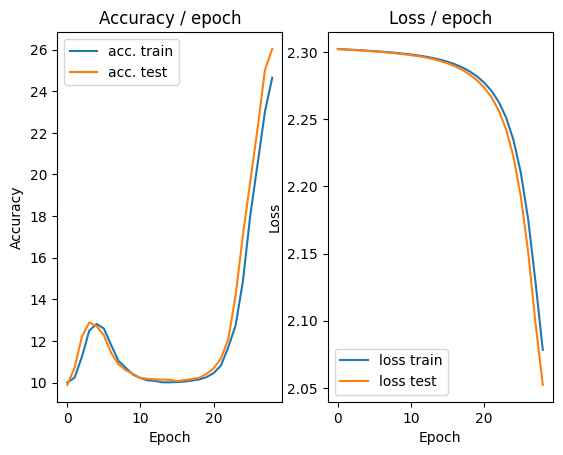

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.190s (0.190s)	Loss 1.9892 (1.9892)	Prec@1  26.6 ( 26.6)	Prec@5  78.1 ( 78.1)


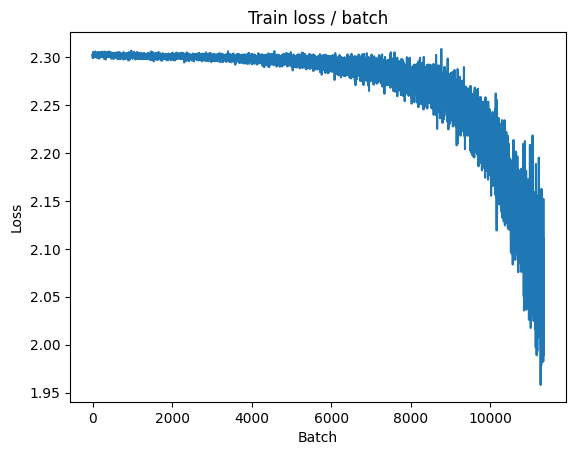

[TRAIN Batch 200/391]	Time 0.032s (0.020s)	Loss 1.9710 (2.0472)	Prec@1  26.6 ( 25.3)	Prec@5  80.5 ( 76.0)


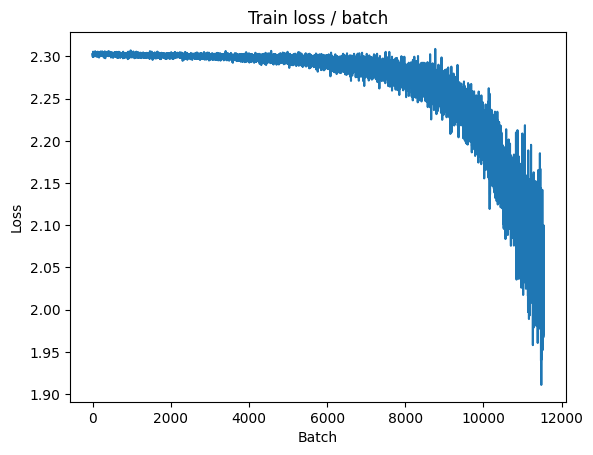


===============> Total time 7s	Avg loss 2.0447	Avg Prec@1 25.45 %	Avg Prec@5 76.02 %

[EVAL Batch 000/079]	Time 0.123s (0.123s)	Loss 2.0280 (2.0280)	Prec@1  30.5 ( 30.5)	Prec@5  79.7 ( 79.7)

===============> Total time 1s	Avg loss 2.0288	Avg Prec@1 26.22 %	Avg Prec@5 76.63 %



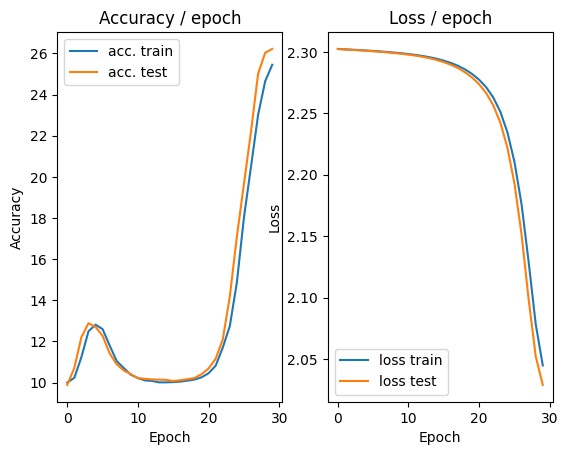

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.167s (0.167s)	Loss 2.1185 (2.1185)	Prec@1  18.8 ( 18.8)	Prec@5  66.4 ( 66.4)


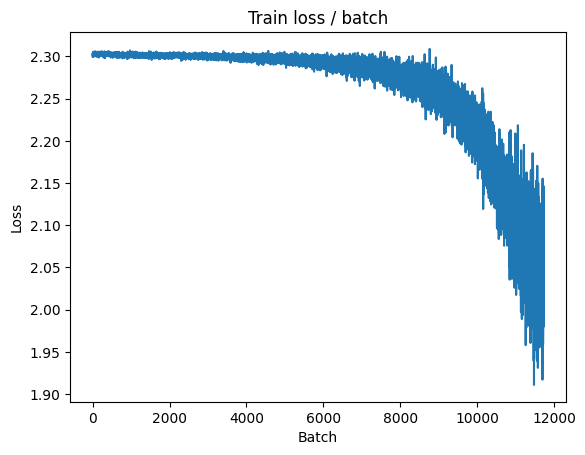

[TRAIN Batch 200/391]	Time 0.028s (0.024s)	Loss 1.9809 (2.0318)	Prec@1  27.3 ( 26.2)	Prec@5  78.1 ( 75.9)


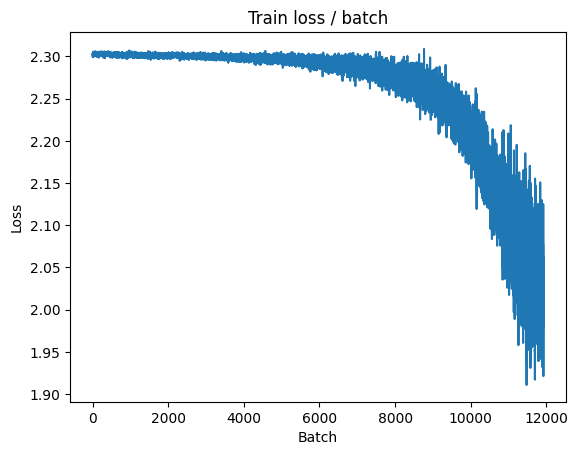


===============> Total time 8s	Avg loss 2.0281	Avg Prec@1 26.06 %	Avg Prec@5 76.07 %

[EVAL Batch 000/079]	Time 0.115s (0.115s)	Loss 2.0155 (2.0155)	Prec@1  32.0 ( 32.0)	Prec@5  80.5 ( 80.5)

===============> Total time 1s	Avg loss 2.0155	Avg Prec@1 26.32 %	Avg Prec@5 76.84 %



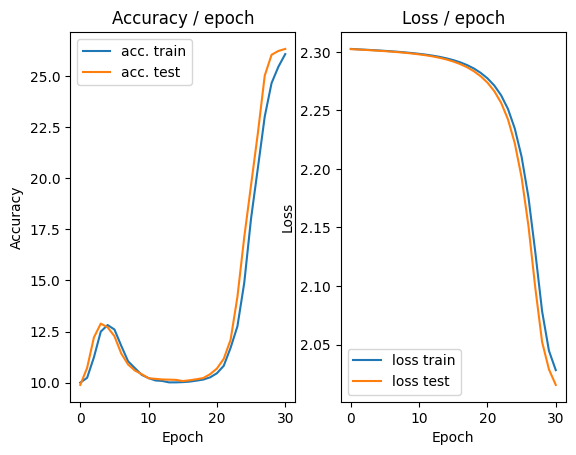

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.142s (0.142s)	Loss 2.0021 (2.0021)	Prec@1  25.0 ( 25.0)	Prec@5  80.5 ( 80.5)


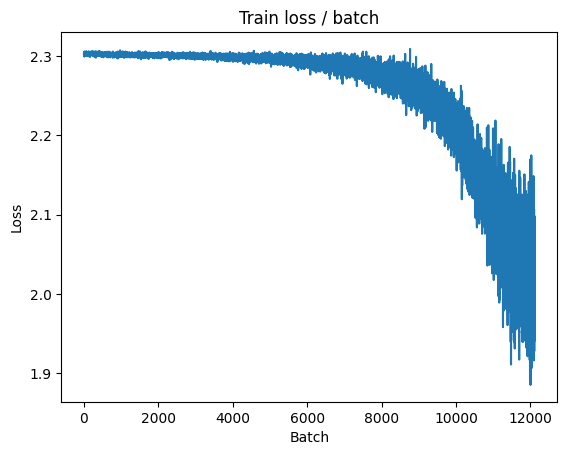

[TRAIN Batch 200/391]	Time 0.054s (0.024s)	Loss 1.9445 (2.0238)	Prec@1  28.9 ( 26.4)	Prec@5  81.2 ( 76.1)


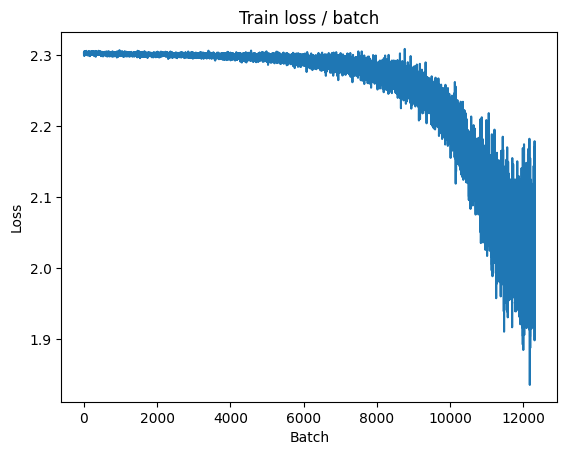


===============> Total time 8s	Avg loss 2.0183	Avg Prec@1 26.12 %	Avg Prec@5 76.43 %

[EVAL Batch 000/079]	Time 0.101s (0.101s)	Loss 2.0093 (2.0093)	Prec@1  32.8 ( 32.8)	Prec@5  79.7 ( 79.7)

===============> Total time 1s	Avg loss 2.0059	Avg Prec@1 26.48 %	Avg Prec@5 76.84 %



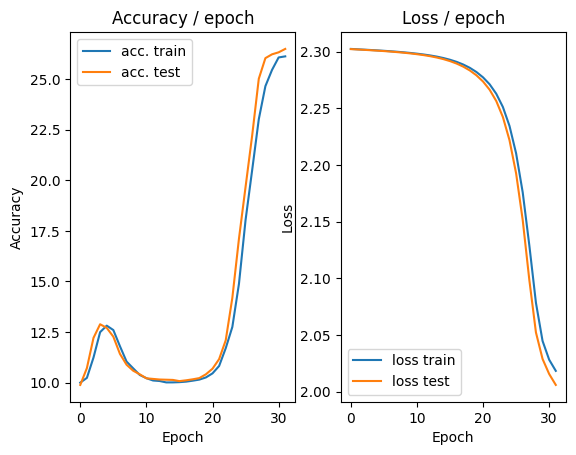

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.200s (0.200s)	Loss 1.9914 (1.9914)	Prec@1  18.0 ( 18.0)	Prec@5  85.2 ( 85.2)


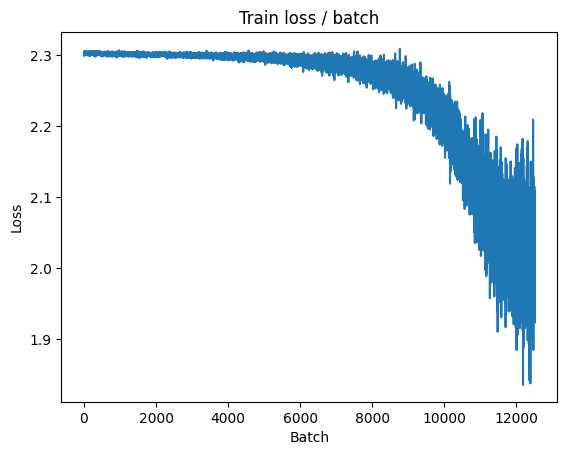

[TRAIN Batch 200/391]	Time 0.008s (0.020s)	Loss 2.0260 (2.0136)	Prec@1  21.9 ( 26.0)	Prec@5  73.4 ( 76.3)


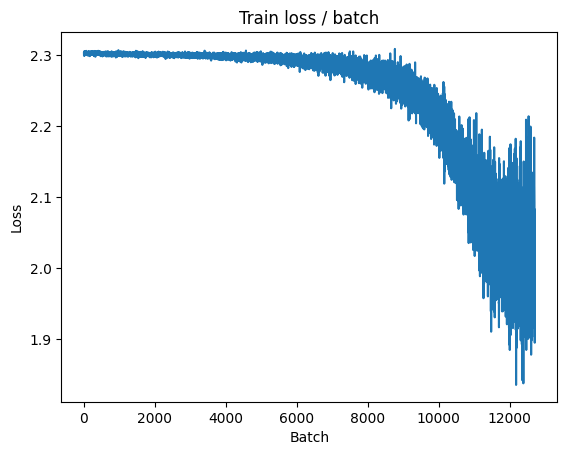


===============> Total time 8s	Avg loss 2.0101	Avg Prec@1 26.34 %	Avg Prec@5 76.64 %

[EVAL Batch 000/079]	Time 0.133s (0.133s)	Loss 2.0028 (2.0028)	Prec@1  32.0 ( 32.0)	Prec@5  78.9 ( 78.9)

===============> Total time 1s	Avg loss 1.9972	Avg Prec@1 27.09 %	Avg Prec@5 77.14 %



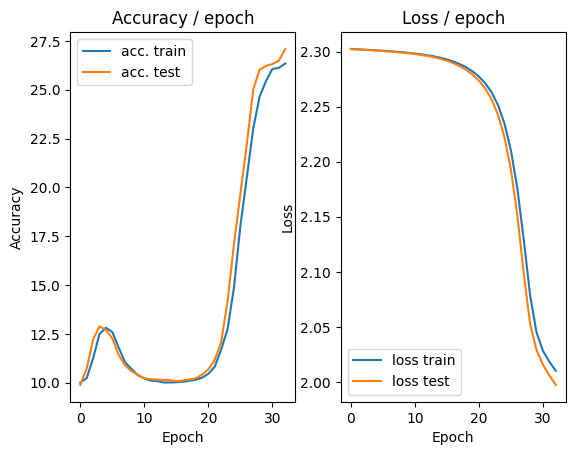

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.197s (0.197s)	Loss 2.0294 (2.0294)	Prec@1  26.6 ( 26.6)	Prec@5  78.1 ( 78.1)


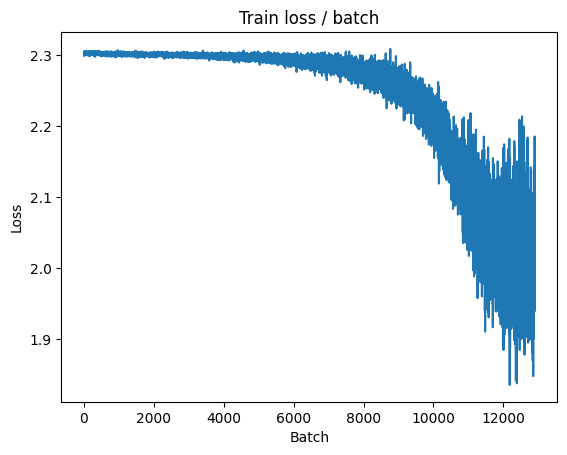

[TRAIN Batch 200/391]	Time 0.027s (0.020s)	Loss 1.9928 (2.0022)	Prec@1  29.7 ( 26.8)	Prec@5  76.6 ( 77.0)


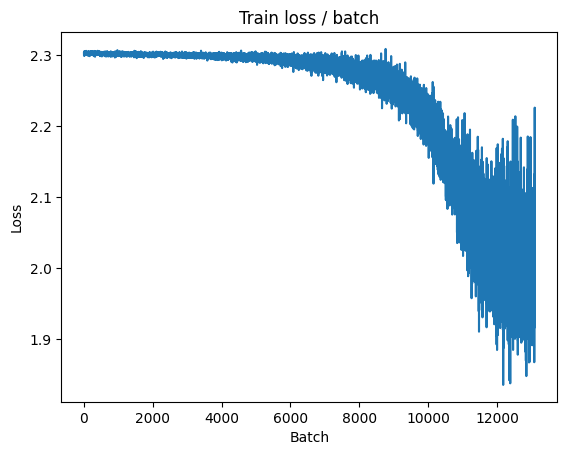


===============> Total time 7s	Avg loss 2.0023	Avg Prec@1 26.77 %	Avg Prec@5 77.01 %

[EVAL Batch 000/079]	Time 0.186s (0.186s)	Loss 1.9907 (1.9907)	Prec@1  32.8 ( 32.8)	Prec@5  80.5 ( 80.5)

===============> Total time 2s	Avg loss 1.9892	Avg Prec@1 27.26 %	Avg Prec@5 77.60 %



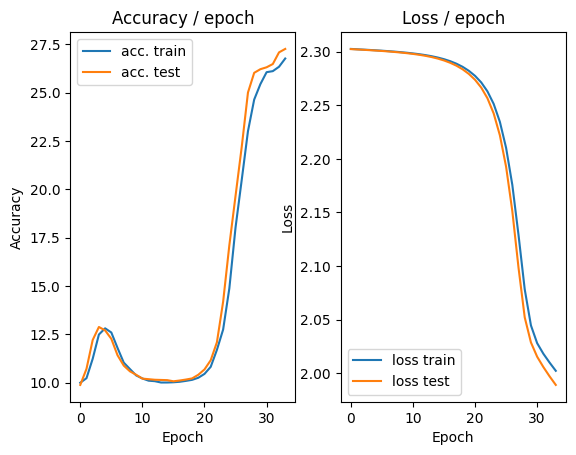

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.571s (0.571s)	Loss 1.9509 (1.9509)	Prec@1  27.3 ( 27.3)	Prec@5  80.5 ( 80.5)


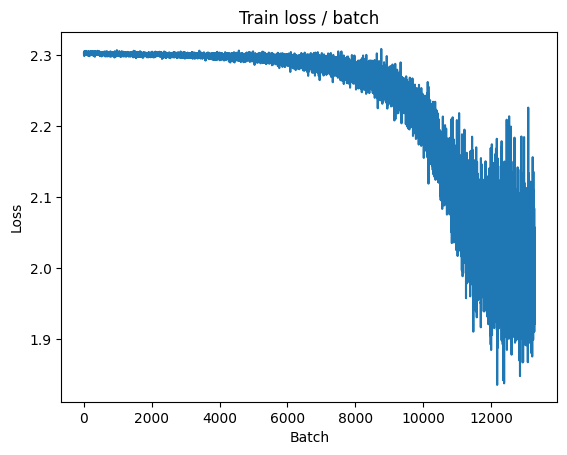

[TRAIN Batch 200/391]	Time 0.026s (0.024s)	Loss 1.9520 (2.0011)	Prec@1  30.5 ( 27.1)	Prec@5  76.6 ( 77.4)


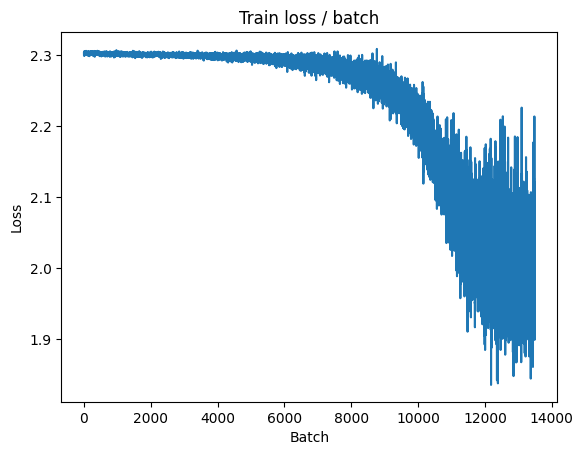


===============> Total time 8s	Avg loss 1.9950	Avg Prec@1 27.09 %	Avg Prec@5 77.50 %

[EVAL Batch 000/079]	Time 0.113s (0.113s)	Loss 1.9894 (1.9894)	Prec@1  29.7 ( 29.7)	Prec@5  80.5 ( 80.5)

===============> Total time 1s	Avg loss 1.9833	Avg Prec@1 27.52 %	Avg Prec@5 77.64 %



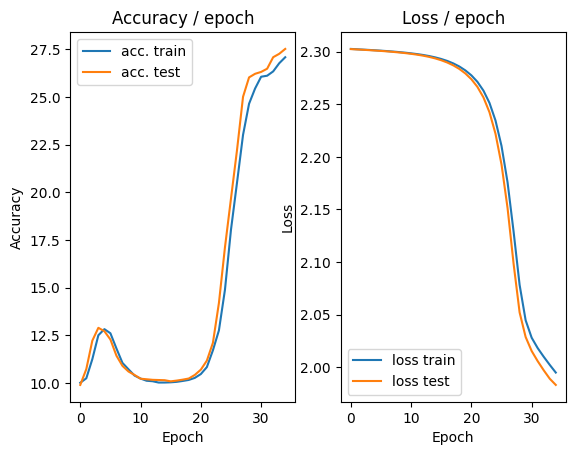

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.338s (0.338s)	Loss 1.9865 (1.9865)	Prec@1  27.3 ( 27.3)	Prec@5  76.6 ( 76.6)


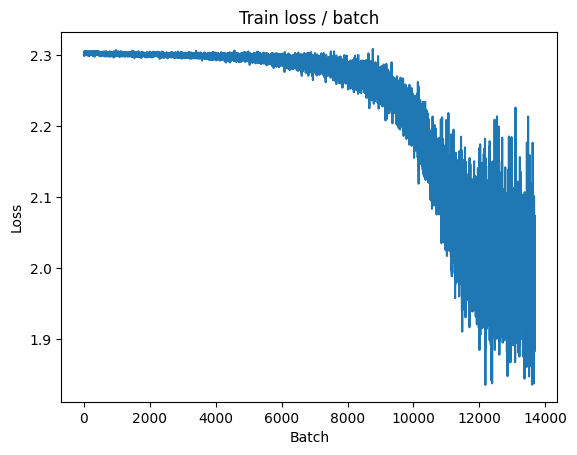

[TRAIN Batch 200/391]	Time 0.019s (0.028s)	Loss 1.9724 (1.9883)	Prec@1  25.0 ( 27.6)	Prec@5  77.3 ( 77.8)


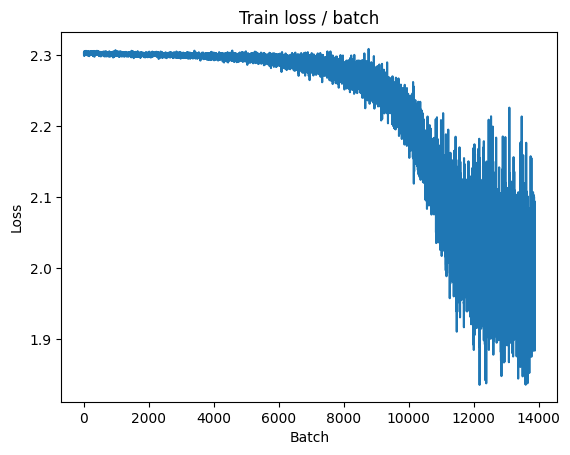


===============> Total time 9s	Avg loss 1.9883	Avg Prec@1 27.34 %	Avg Prec@5 78.08 %

[EVAL Batch 000/079]	Time 0.129s (0.129s)	Loss 1.9750 (1.9750)	Prec@1  32.0 ( 32.0)	Prec@5  78.9 ( 78.9)

===============> Total time 1s	Avg loss 1.9749	Avg Prec@1 27.53 %	Avg Prec@5 78.68 %



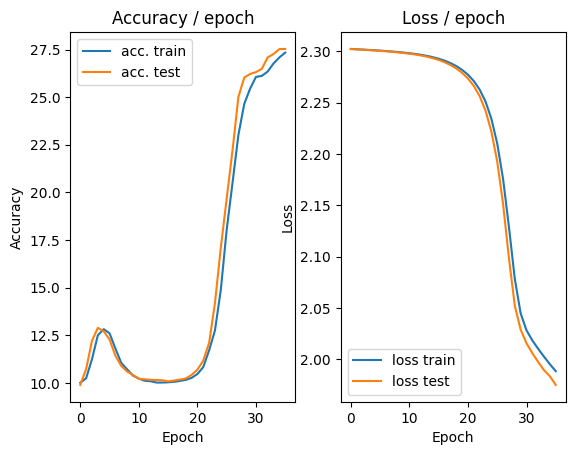

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 1.7854 (1.7854)	Prec@1  37.5 ( 37.5)	Prec@5  88.3 ( 88.3)


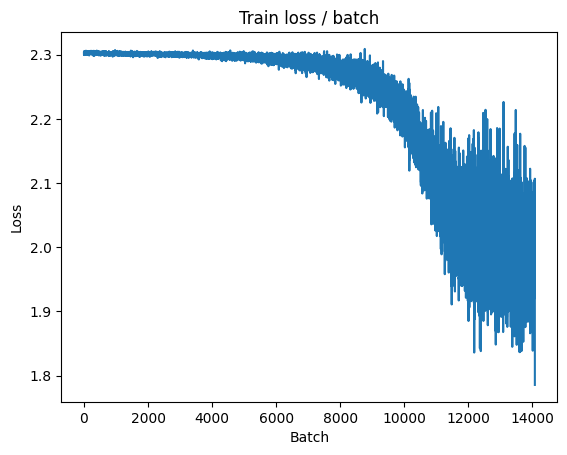

[TRAIN Batch 200/391]	Time 0.011s (0.024s)	Loss 1.9154 (1.9794)	Prec@1  34.4 ( 27.5)	Prec@5  77.3 ( 78.5)


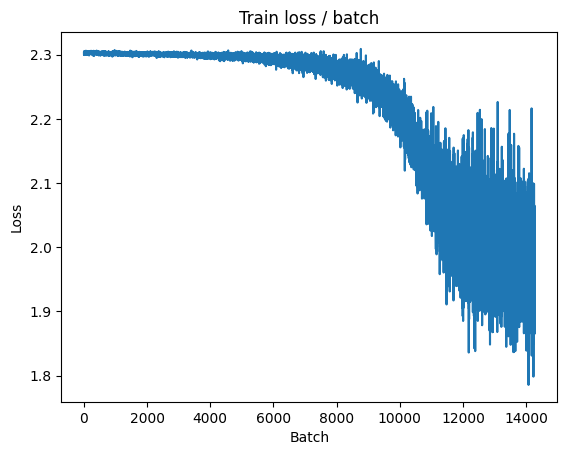


===============> Total time 8s	Avg loss 1.9815	Avg Prec@1 27.56 %	Avg Prec@5 78.48 %

[EVAL Batch 000/079]	Time 0.126s (0.126s)	Loss 1.9702 (1.9702)	Prec@1  28.9 ( 28.9)	Prec@5  80.5 ( 80.5)

===============> Total time 1s	Avg loss 1.9726	Avg Prec@1 27.97 %	Avg Prec@5 78.90 %



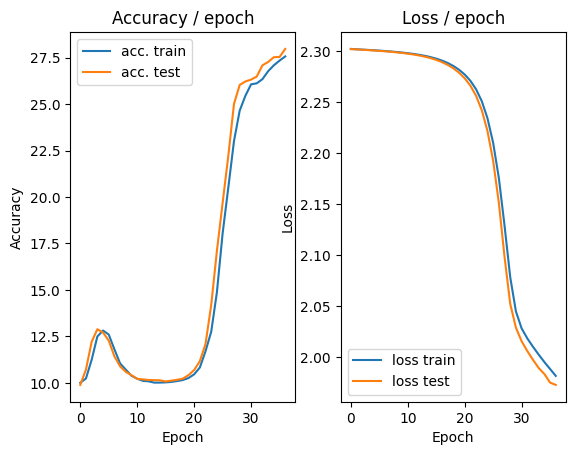

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.194s (0.194s)	Loss 2.0130 (2.0130)	Prec@1  25.0 ( 25.0)	Prec@5  82.0 ( 82.0)


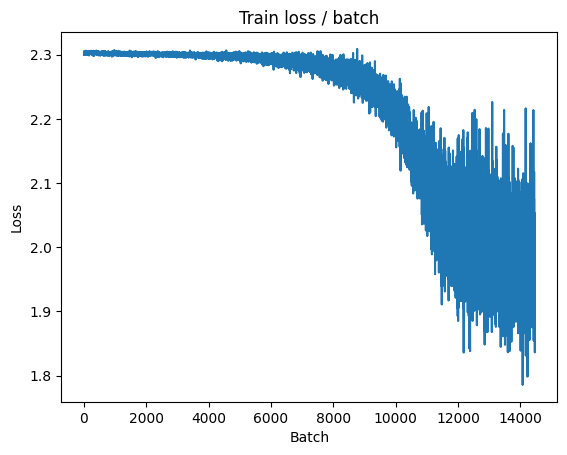

[TRAIN Batch 200/391]	Time 0.012s (0.024s)	Loss 1.9169 (1.9760)	Prec@1  28.1 ( 27.7)	Prec@5  76.6 ( 79.0)


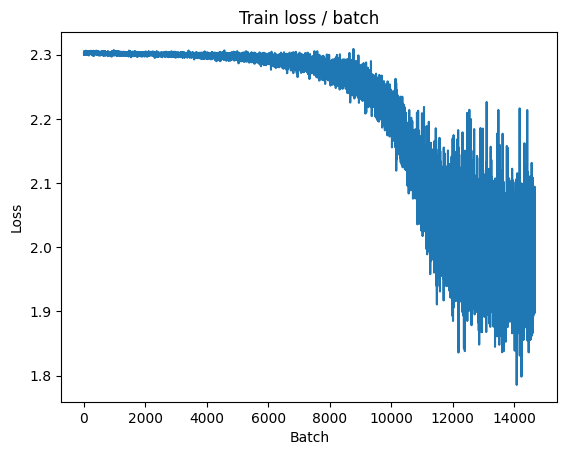


===============> Total time 9s	Avg loss 1.9746	Avg Prec@1 27.86 %	Avg Prec@5 78.85 %

[EVAL Batch 000/079]	Time 0.119s (0.119s)	Loss 1.9643 (1.9643)	Prec@1  32.0 ( 32.0)	Prec@5  81.2 ( 81.2)

===============> Total time 1s	Avg loss 1.9615	Avg Prec@1 28.25 %	Avg Prec@5 79.40 %



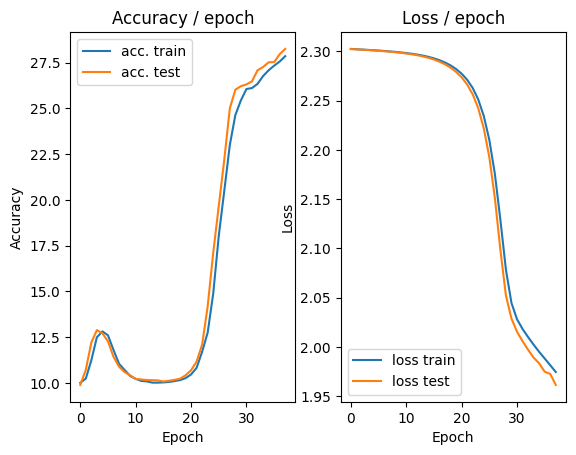

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.177s (0.177s)	Loss 2.0376 (2.0376)	Prec@1  19.5 ( 19.5)	Prec@5  75.8 ( 75.8)


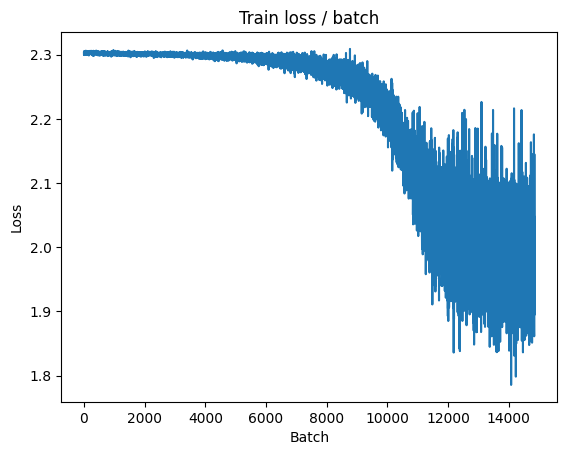

[TRAIN Batch 200/391]	Time 0.008s (0.020s)	Loss 1.9924 (1.9719)	Prec@1  28.1 ( 27.7)	Prec@5  81.2 ( 78.9)


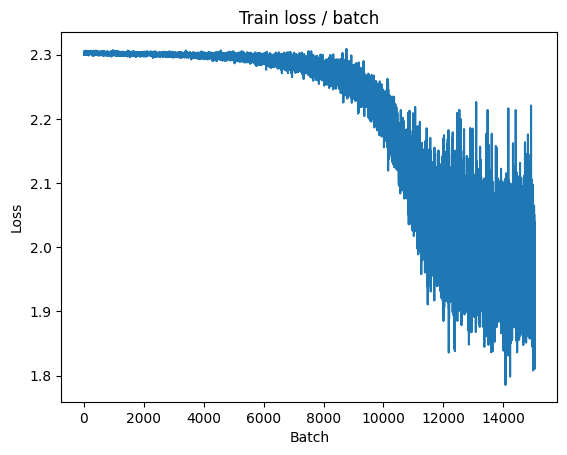


===============> Total time 8s	Avg loss 1.9679	Avg Prec@1 28.16 %	Avg Prec@5 79.23 %

[EVAL Batch 000/079]	Time 0.117s (0.117s)	Loss 1.9544 (1.9544)	Prec@1  31.2 ( 31.2)	Prec@5  80.5 ( 80.5)

===============> Total time 1s	Avg loss 1.9554	Avg Prec@1 28.42 %	Avg Prec@5 79.65 %



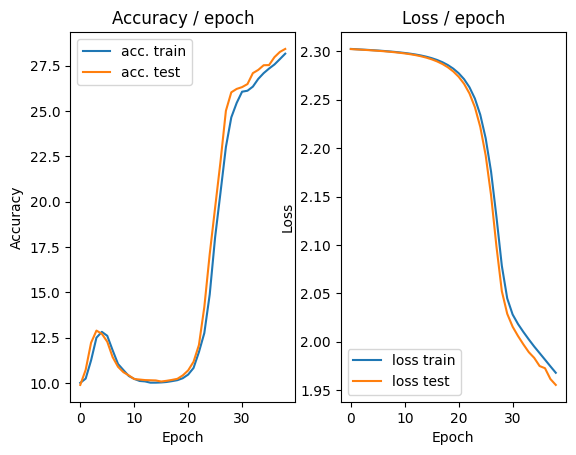

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.220s (0.220s)	Loss 2.1477 (2.1477)	Prec@1  26.6 ( 26.6)	Prec@5  78.1 ( 78.1)


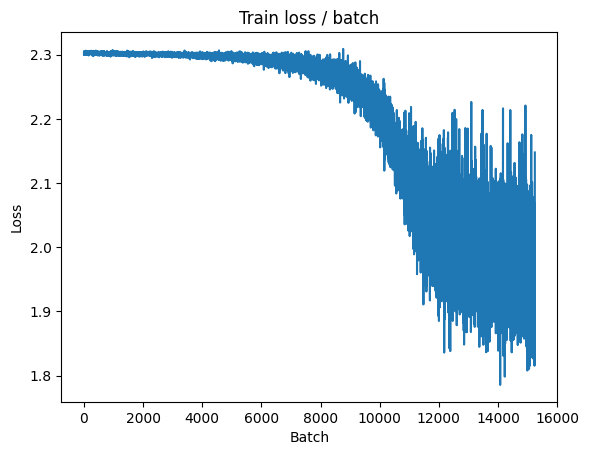

[TRAIN Batch 200/391]	Time 0.012s (0.025s)	Loss 2.0080 (1.9601)	Prec@1  25.8 ( 28.8)	Prec@5  74.2 ( 79.6)


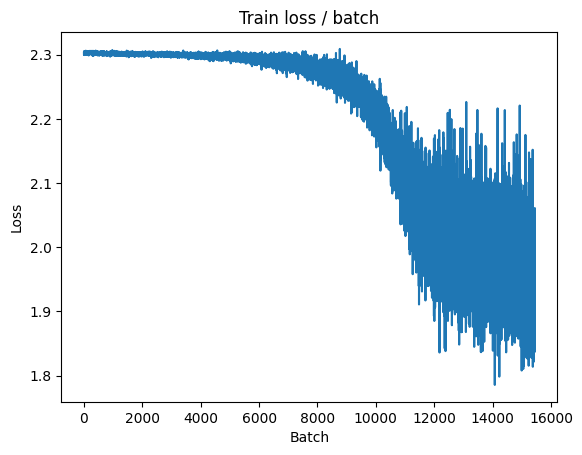


===============> Total time 9s	Avg loss 1.9616	Avg Prec@1 28.38 %	Avg Prec@5 79.39 %

[EVAL Batch 000/079]	Time 0.111s (0.111s)	Loss 1.9518 (1.9518)	Prec@1  32.8 ( 32.8)	Prec@5  82.0 ( 82.0)

===============> Total time 1s	Avg loss 1.9486	Avg Prec@1 28.71 %	Avg Prec@5 79.72 %



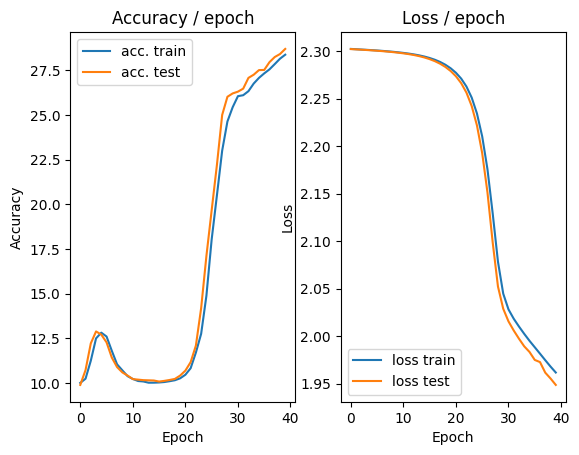

In [ ]:
main(128, 0.001, 40, cuda=True)
# petit lr

In [ ]:
# 3.1

In [ ]:

import torch.nn.functional as F

class ConvNet(nn.Module):
    def __init__(self):
        super(ConvNet, self).__init__()

        self.conv1 = nn.Conv2d(in_channels=3, out_channels=32, kernel_size=5, stride=1, padding=2)
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv2 = nn.Conv2d(in_channels=32, out_channels=64, kernel_size=5, stride=1, padding=2)
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv3 = nn.Conv2d(in_channels=64, out_channels=64, kernel_size=5, stride=1, padding=2)
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.fc4 = nn.Linear(4 * 4 * 64, 1000)   # apres 3 poolings: 32->16->8->4
        self.fc5 = nn.Linear(1000, 10)

    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = self.pool1(x)

        x = F.relu(self.conv2(x))
        x = self.pool2(x)

        x = F.relu(self.conv3(x))
        x = self.pool3(x)

        #  on applatit
        x = x.view(x.size(0), -1)

        # full connected layers
        x = F.relu(self.fc4(x))
        x = self.fc5(x)

        # x = F.softmax(x, dim=1)
        return x




def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.491, 0.482, 0.447],
                         std=[0.202, 0.199, 0.201])
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.491, 0.482, 0.447],
                         std=[0.202, 0.199, 0.201])
        ]))



    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=30, cuda=False):
    print("ici")
    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.155s (0.155s)	Loss 2.3058 (2.3058)	Prec@1   3.1 (  3.1)	Prec@5  45.3 ( 45.3)


<Figure size 640x480 with 0 Axes>

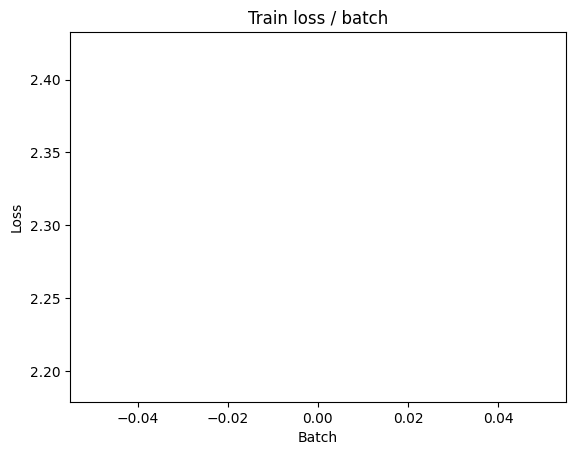

[TRAIN Batch 200/391]	Time 0.009s (0.035s)	Loss 2.1249 (2.2635)	Prec@1  31.2 ( 16.3)	Prec@5  75.0 ( 62.9)


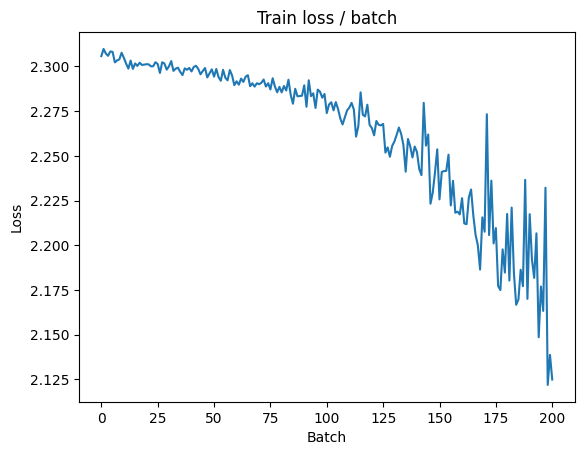


===============> Total time 12s	Avg loss 2.1468	Avg Prec@1 21.54 %	Avg Prec@5 69.82 %

[EVAL Batch 000/079]	Time 0.118s (0.118s)	Loss 1.9102 (1.9102)	Prec@1  33.6 ( 33.6)	Prec@5  79.7 ( 79.7)

===============> Total time 2s	Avg loss 1.9140	Avg Prec@1 31.05 %	Avg Prec@5 80.99 %



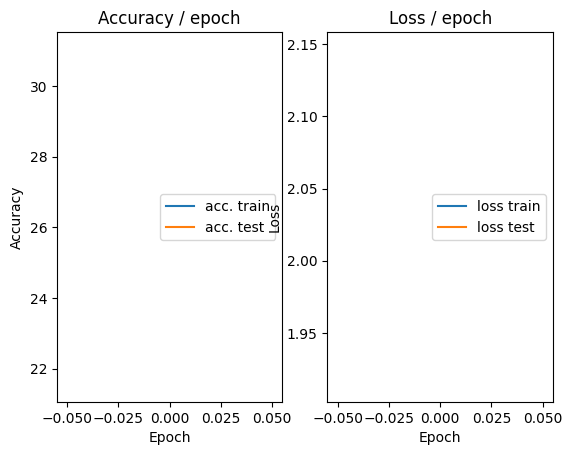

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.168s (0.168s)	Loss 1.8404 (1.8404)	Prec@1  27.3 ( 27.3)	Prec@5  85.2 ( 85.2)


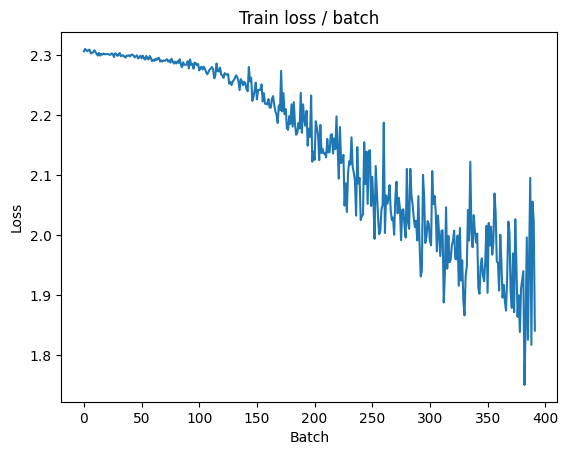

[TRAIN Batch 200/391]	Time 0.051s (0.039s)	Loss 1.7935 (1.8576)	Prec@1  35.9 ( 33.3)	Prec@5  86.7 ( 83.2)


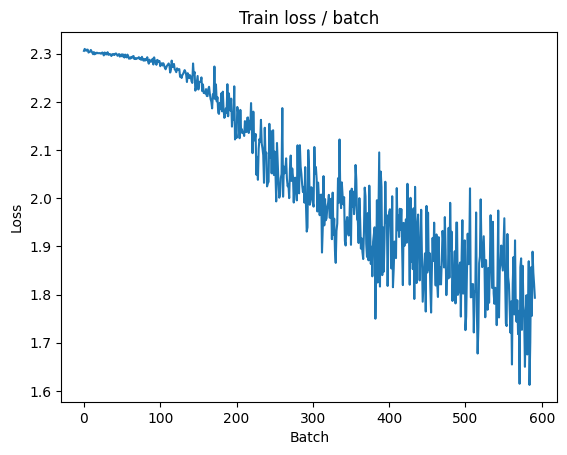


===============> Total time 13s	Avg loss 1.7911	Avg Prec@1 35.40 %	Avg Prec@5 85.21 %

[EVAL Batch 000/079]	Time 0.120s (0.120s)	Loss 1.6002 (1.6002)	Prec@1  45.3 ( 45.3)	Prec@5  85.9 ( 85.9)

===============> Total time 3s	Avg loss 1.6389	Avg Prec@1 39.45 %	Avg Prec@5 88.97 %



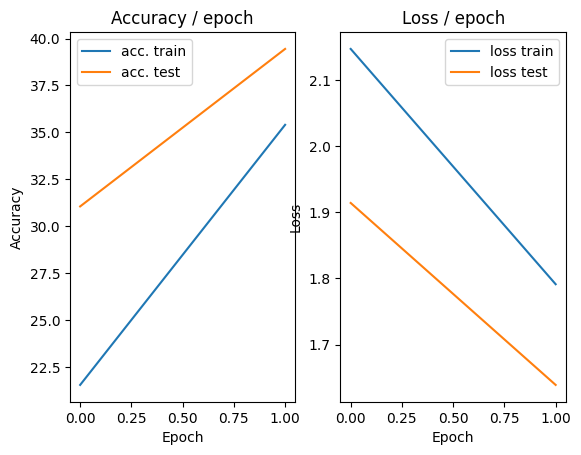

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.145s (0.145s)	Loss 1.6965 (1.6965)	Prec@1  40.6 ( 40.6)	Prec@5  86.7 ( 86.7)


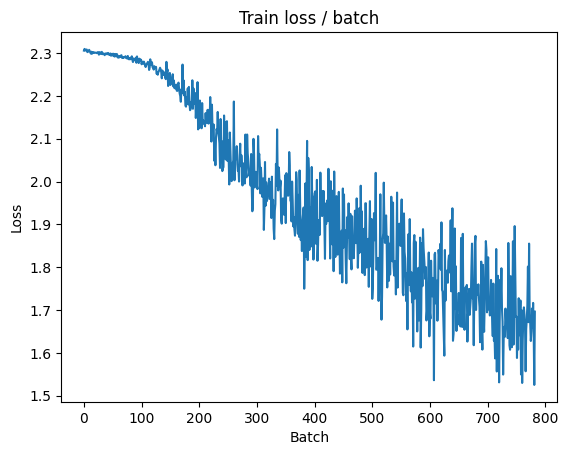

[TRAIN Batch 200/391]	Time 0.044s (0.031s)	Loss 1.5683 (1.6244)	Prec@1  43.0 ( 41.1)	Prec@5  90.6 ( 89.6)


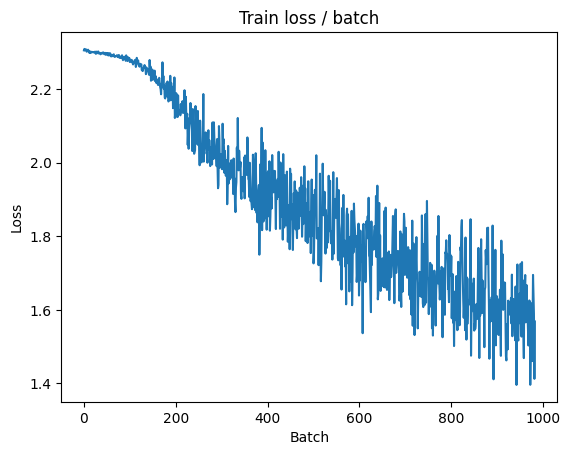


===============> Total time 12s	Avg loss 1.5884	Avg Prec@1 42.59 %	Avg Prec@5 90.20 %

[EVAL Batch 000/079]	Time 0.127s (0.127s)	Loss 1.6409 (1.6409)	Prec@1  43.8 ( 43.8)	Prec@5  89.1 ( 89.1)

===============> Total time 2s	Avg loss 1.6190	Avg Prec@1 42.09 %	Avg Prec@5 89.86 %



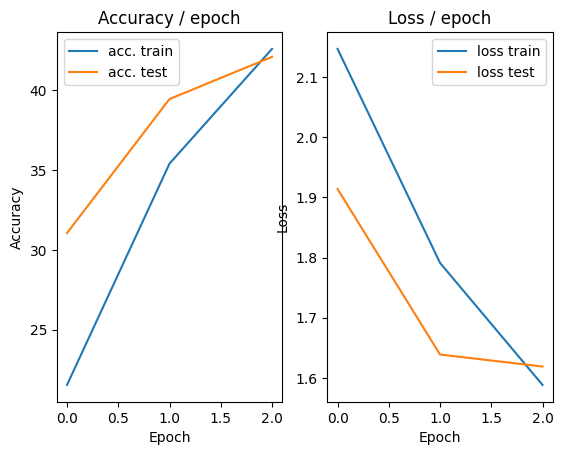

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.159s (0.159s)	Loss 1.6311 (1.6311)	Prec@1  47.7 ( 47.7)	Prec@5  87.5 ( 87.5)


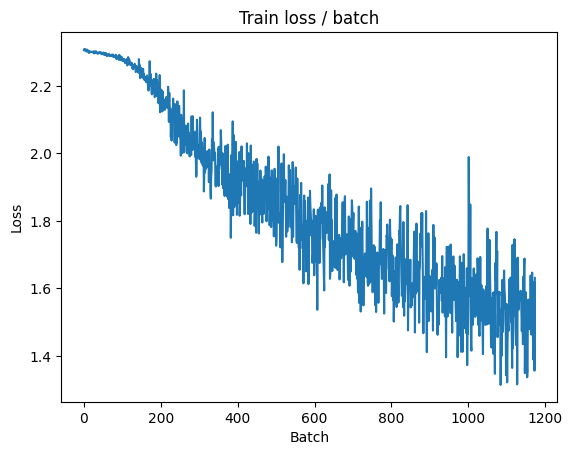

[TRAIN Batch 200/391]	Time 0.012s (0.030s)	Loss 1.3885 (1.4910)	Prec@1  42.2 ( 46.7)	Prec@5  97.7 ( 91.6)


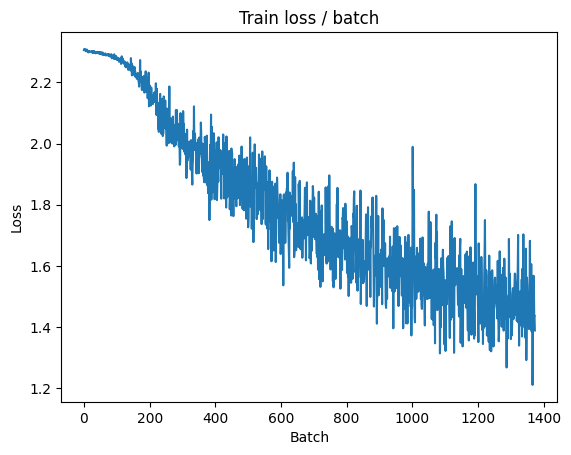


===============> Total time 12s	Avg loss 1.4702	Avg Prec@1 47.40 %	Avg Prec@5 91.98 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 1.3292 (1.3292)	Prec@1  55.5 ( 55.5)	Prec@5  92.2 ( 92.2)

===============> Total time 2s	Avg loss 1.4264	Avg Prec@1 48.73 %	Avg Prec@5 92.69 %



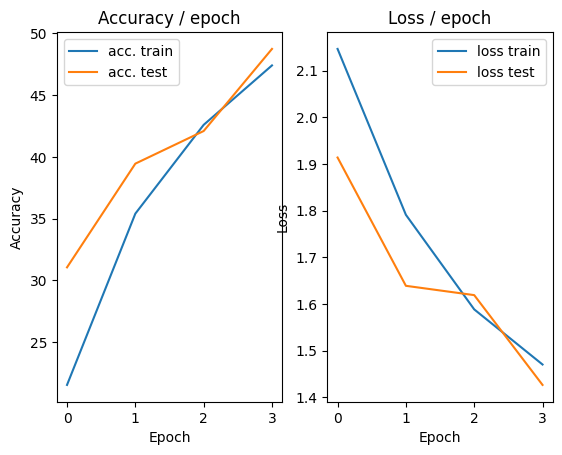

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.148s (0.148s)	Loss 1.5224 (1.5224)	Prec@1  47.7 ( 47.7)	Prec@5  90.6 ( 90.6)


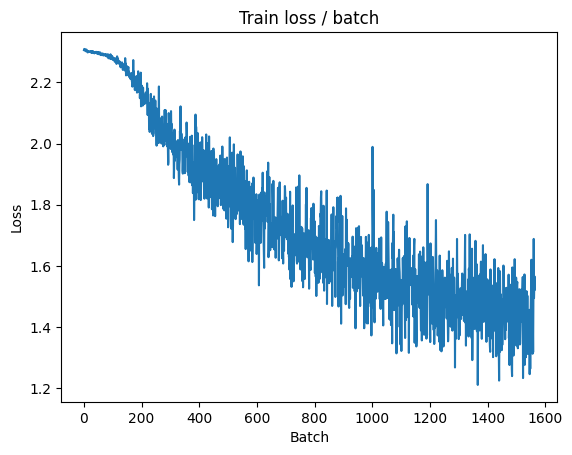

[TRAIN Batch 200/391]	Time 0.030s (0.035s)	Loss 1.4566 (1.3987)	Prec@1  49.2 ( 50.1)	Prec@5  89.8 ( 93.2)


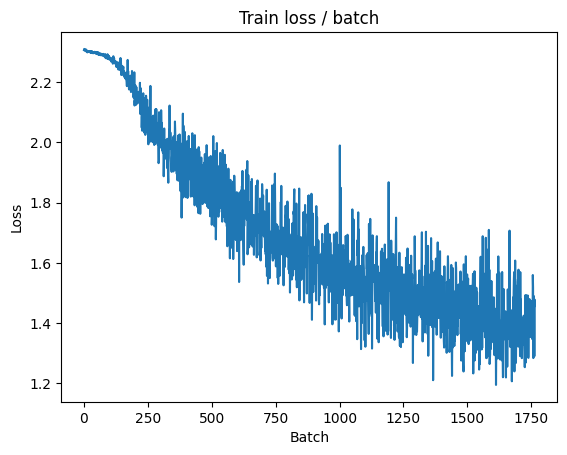


===============> Total time 12s	Avg loss 1.3813	Avg Prec@1 50.55 %	Avg Prec@5 93.39 %

[EVAL Batch 000/079]	Time 0.130s (0.130s)	Loss 1.2503 (1.2503)	Prec@1  61.7 ( 61.7)	Prec@5  92.2 ( 92.2)

===============> Total time 2s	Avg loss 1.3708	Avg Prec@1 50.75 %	Avg Prec@5 93.42 %



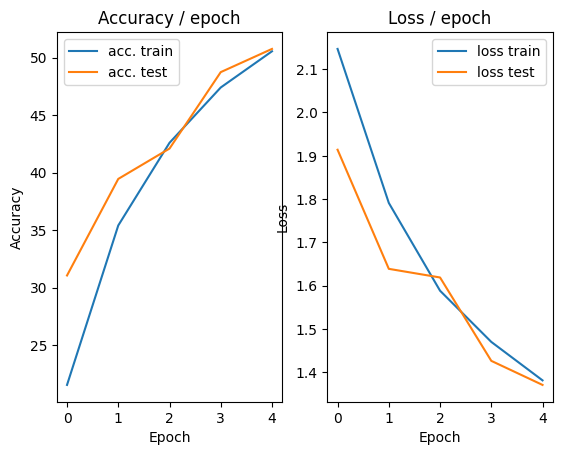

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.148s (0.148s)	Loss 1.5235 (1.5235)	Prec@1  44.5 ( 44.5)	Prec@5  92.2 ( 92.2)


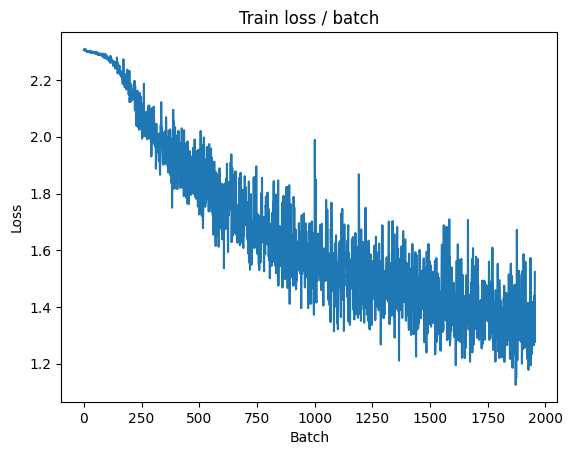

[TRAIN Batch 200/391]	Time 0.013s (0.035s)	Loss 1.2307 (1.3253)	Prec@1  57.0 ( 52.9)	Prec@5  94.5 ( 93.9)


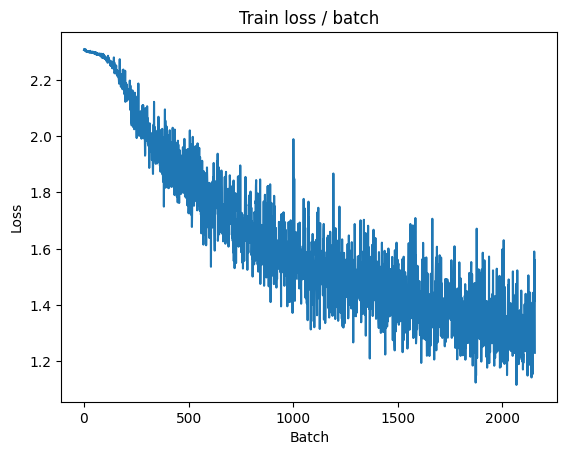


===============> Total time 12s	Avg loss 1.3093	Avg Prec@1 53.43 %	Avg Prec@5 94.11 %

[EVAL Batch 000/079]	Time 0.126s (0.126s)	Loss 1.2102 (1.2102)	Prec@1  59.4 ( 59.4)	Prec@5  93.8 ( 93.8)

===============> Total time 2s	Avg loss 1.2938	Avg Prec@1 52.76 %	Avg Prec@5 94.41 %



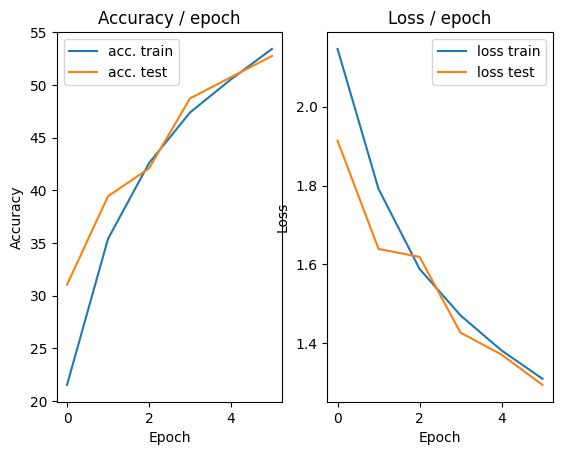

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.290s (0.290s)	Loss 1.2155 (1.2155)	Prec@1  57.0 ( 57.0)	Prec@5  95.3 ( 95.3)


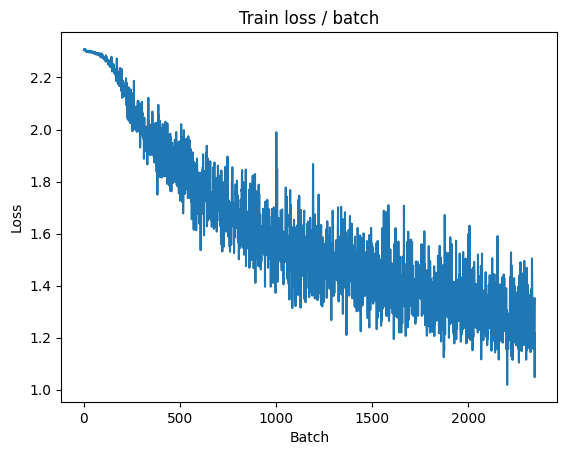

[TRAIN Batch 200/391]	Time 0.051s (0.033s)	Loss 1.2708 (1.2571)	Prec@1  51.6 ( 55.6)	Prec@5  96.9 ( 94.7)


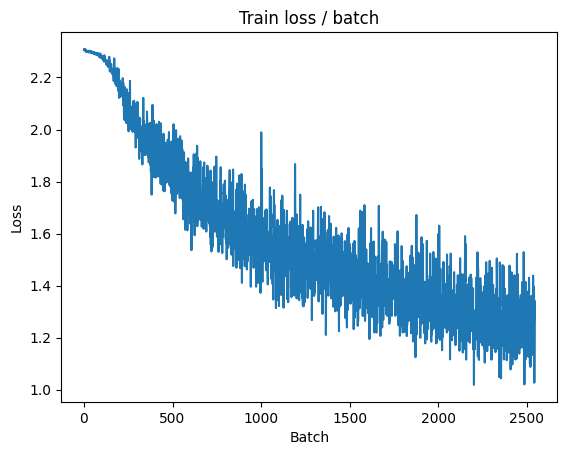


===============> Total time 14s	Avg loss 1.2407	Avg Prec@1 56.09 %	Avg Prec@5 94.90 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 1.1415 (1.1415)	Prec@1  64.8 ( 64.8)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.2113	Avg Prec@1 57.11 %	Avg Prec@5 95.25 %



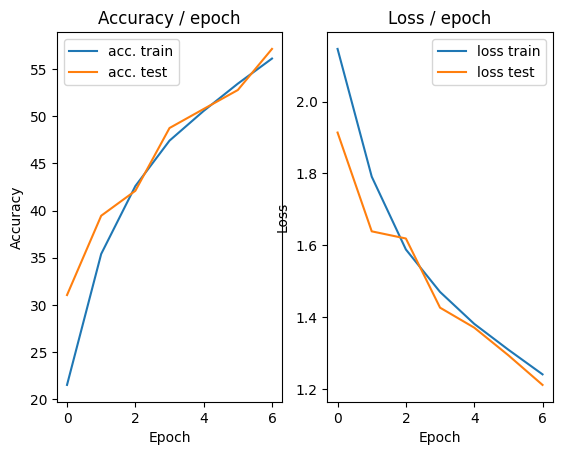

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 1.3229 (1.3229)	Prec@1  57.8 ( 57.8)	Prec@5  93.8 ( 93.8)


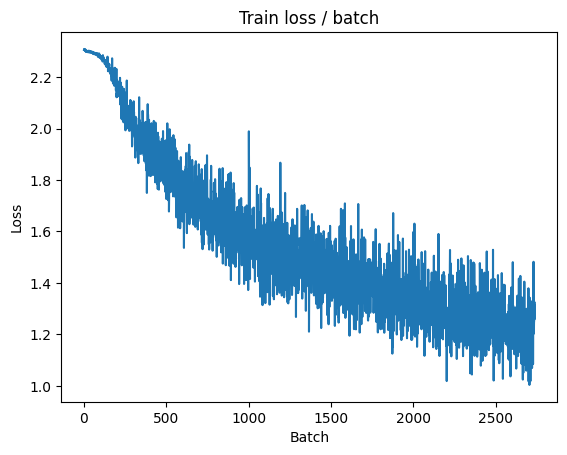

[TRAIN Batch 200/391]	Time 0.033s (0.030s)	Loss 1.3494 (1.1875)	Prec@1  53.9 ( 58.0)	Prec@5  95.3 ( 95.5)


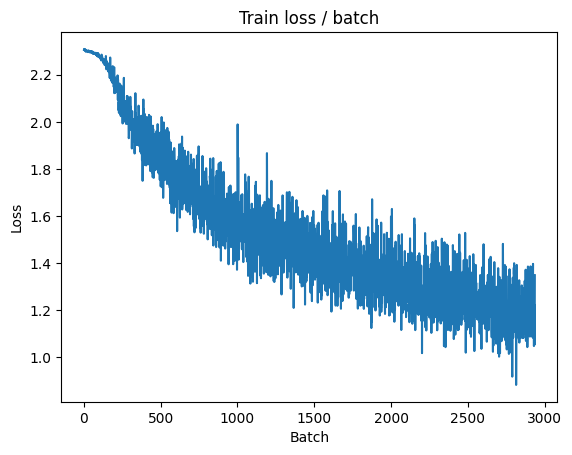


===============> Total time 12s	Avg loss 1.1807	Avg Prec@1 58.37 %	Avg Prec@5 95.45 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 1.0312 (1.0312)	Prec@1  67.2 ( 67.2)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.1533	Avg Prec@1 58.70 %	Avg Prec@5 95.87 %



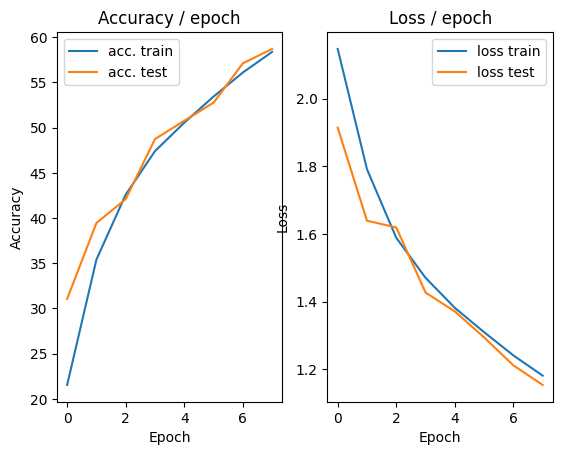

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.214s (0.214s)	Loss 1.1291 (1.1291)	Prec@1  60.2 ( 60.2)	Prec@5  96.1 ( 96.1)


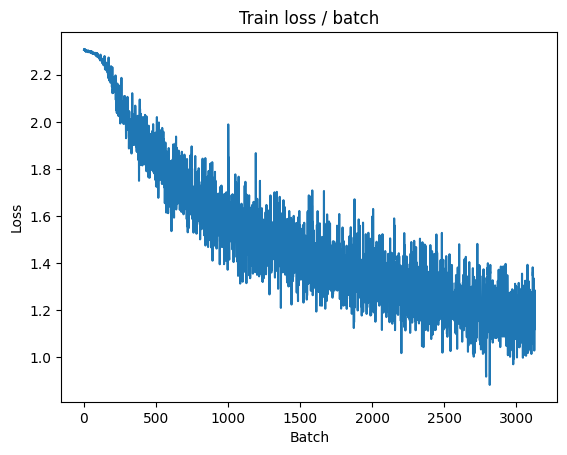

[TRAIN Batch 200/391]	Time 0.038s (0.035s)	Loss 1.1466 (1.1465)	Prec@1  60.2 ( 59.7)	Prec@5  95.3 ( 95.7)


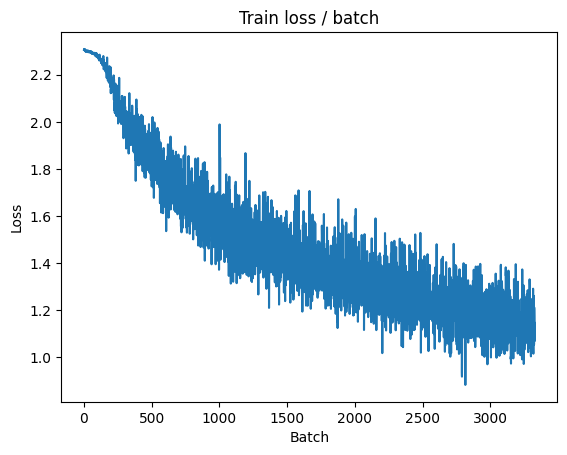


===============> Total time 13s	Avg loss 1.1265	Avg Prec@1 60.28 %	Avg Prec@5 95.87 %

[EVAL Batch 000/079]	Time 0.130s (0.130s)	Loss 0.9914 (0.9914)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.1113	Avg Prec@1 60.63 %	Avg Prec@5 96.05 %



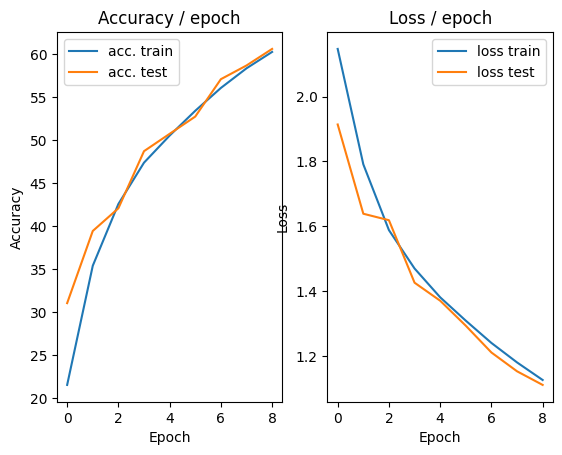

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.167s (0.167s)	Loss 1.0347 (1.0347)	Prec@1  71.1 ( 71.1)	Prec@5  94.5 ( 94.5)


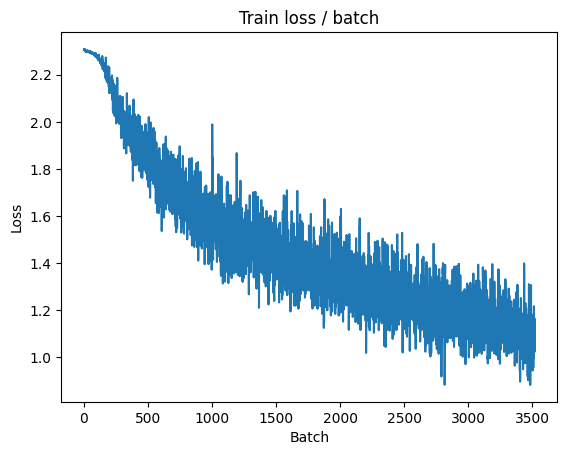

[TRAIN Batch 200/391]	Time 0.013s (0.035s)	Loss 0.9395 (1.0719)	Prec@1  70.3 ( 62.4)	Prec@5  96.9 ( 96.2)


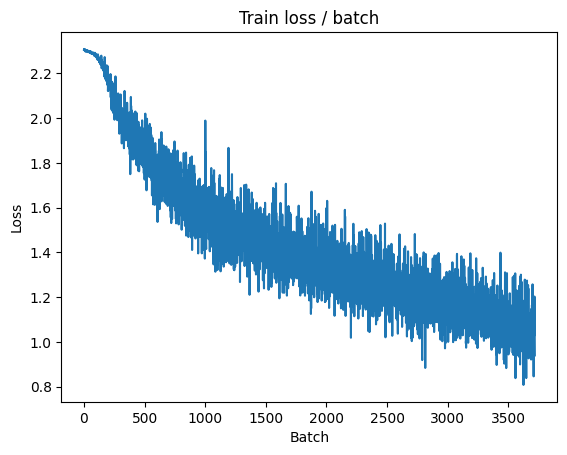


===============> Total time 12s	Avg loss 1.0724	Avg Prec@1 62.36 %	Avg Prec@5 96.30 %

[EVAL Batch 000/079]	Time 0.130s (0.130s)	Loss 0.9915 (0.9915)	Prec@1  68.0 ( 68.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.0847	Avg Prec@1 61.73 %	Avg Prec@5 96.53 %



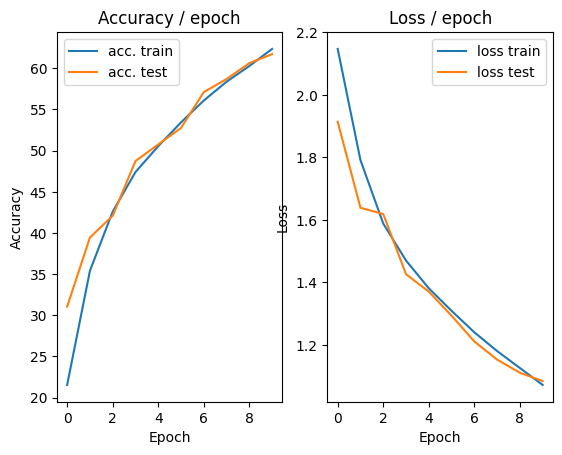

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.270s (0.270s)	Loss 1.1021 (1.1021)	Prec@1  58.6 ( 58.6)	Prec@5  93.8 ( 93.8)


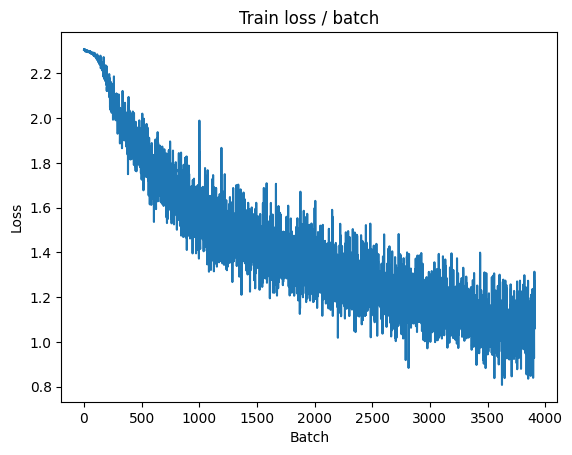

[TRAIN Batch 200/391]	Time 0.028s (0.035s)	Loss 1.0368 (1.0348)	Prec@1  65.6 ( 63.4)	Prec@5  98.4 ( 96.6)


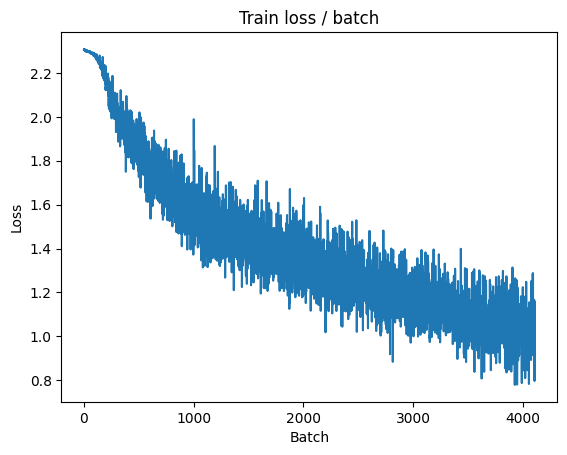


===============> Total time 13s	Avg loss 1.0245	Avg Prec@1 64.05 %	Avg Prec@5 96.53 %

[EVAL Batch 000/079]	Time 0.224s (0.224s)	Loss 0.9709 (0.9709)	Prec@1  71.1 ( 71.1)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.0791	Avg Prec@1 61.67 %	Avg Prec@5 96.27 %



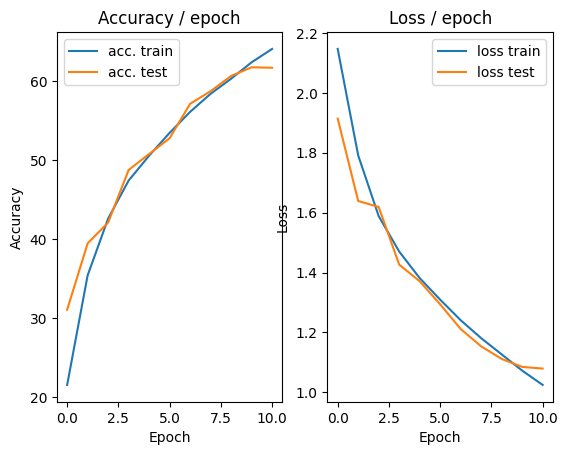

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 1.0053 (1.0053)	Prec@1  61.7 ( 61.7)	Prec@5  98.4 ( 98.4)


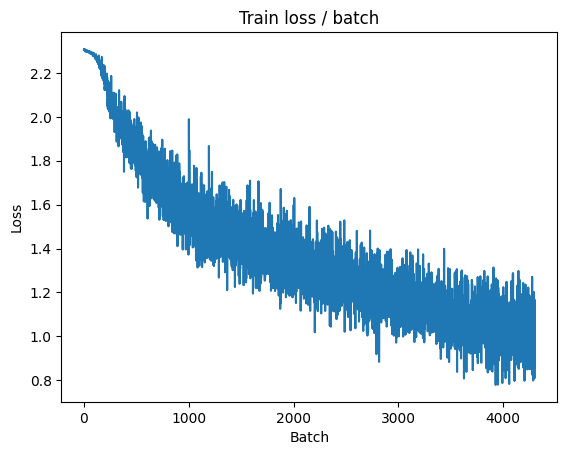

[TRAIN Batch 200/391]	Time 0.063s (0.030s)	Loss 0.8647 (0.9901)	Prec@1  68.8 ( 65.1)	Prec@5  98.4 ( 96.9)


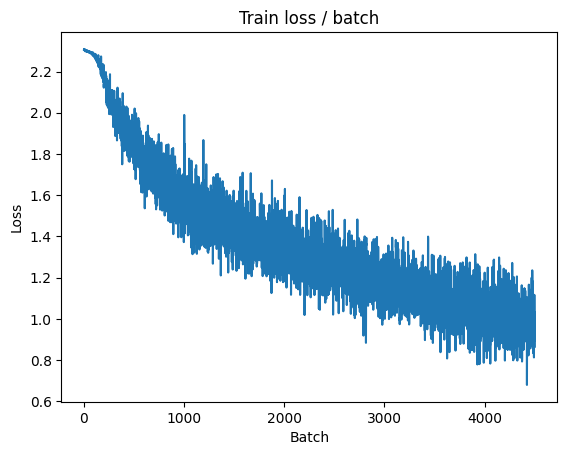


===============> Total time 12s	Avg loss 0.9810	Avg Prec@1 65.61 %	Avg Prec@5 96.92 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 0.9115 (0.9115)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.0409	Avg Prec@1 62.67 %	Avg Prec@5 96.81 %



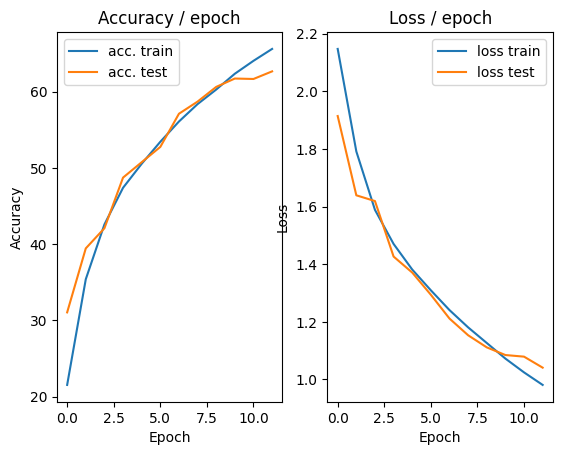

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.157s (0.157s)	Loss 1.2186 (1.2186)	Prec@1  52.3 ( 52.3)	Prec@5  96.9 ( 96.9)


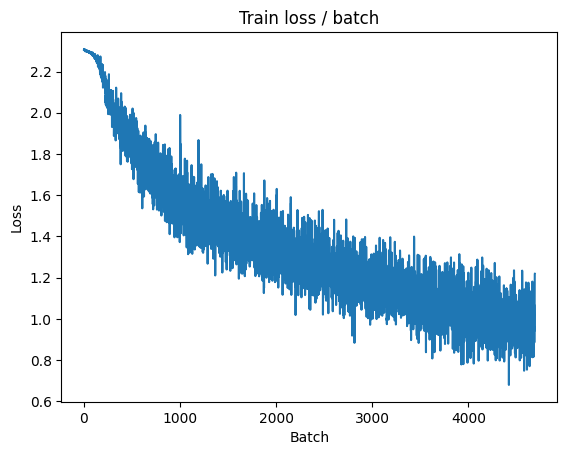

[TRAIN Batch 200/391]	Time 0.064s (0.031s)	Loss 0.9856 (0.9427)	Prec@1  66.4 ( 67.0)	Prec@5  96.1 ( 97.2)


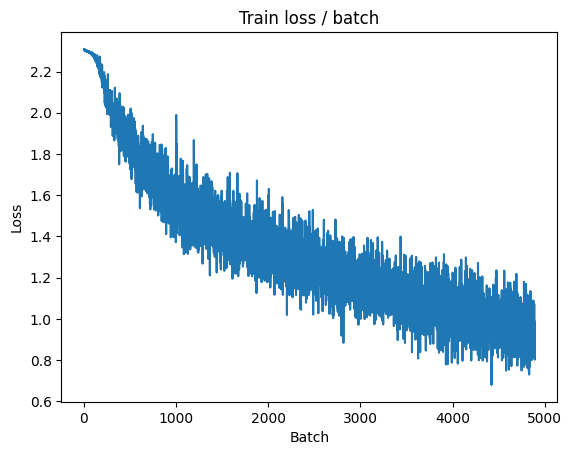


===============> Total time 12s	Avg loss 0.9340	Avg Prec@1 67.29 %	Avg Prec@5 97.20 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 0.9338 (0.9338)	Prec@1  67.2 ( 67.2)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.0487	Avg Prec@1 63.26 %	Avg Prec@5 96.39 %



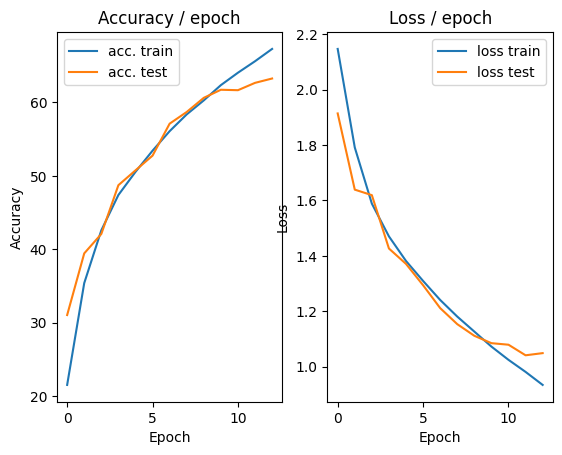

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.163s (0.163s)	Loss 0.9720 (0.9720)	Prec@1  64.8 ( 64.8)	Prec@5  96.1 ( 96.1)


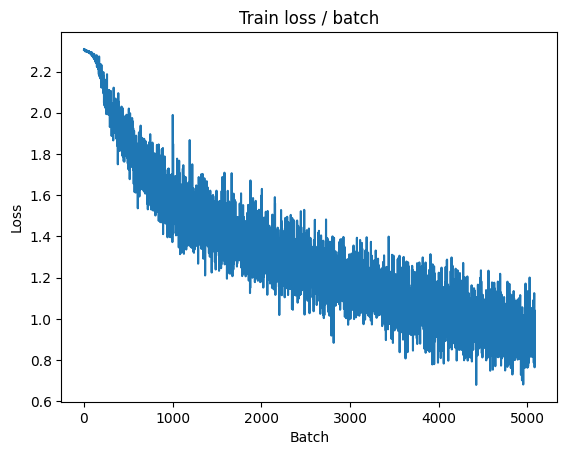

[TRAIN Batch 200/391]	Time 0.013s (0.035s)	Loss 0.9243 (0.9068)	Prec@1  70.3 ( 68.2)	Prec@5  95.3 ( 97.4)


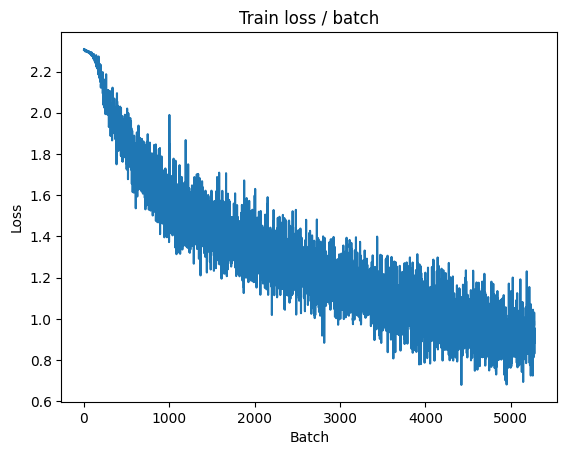


===============> Total time 12s	Avg loss 0.8970	Avg Prec@1 68.69 %	Avg Prec@5 97.48 %

[EVAL Batch 000/079]	Time 0.131s (0.131s)	Loss 0.8464 (0.8464)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9585	Avg Prec@1 66.31 %	Avg Prec@5 97.07 %



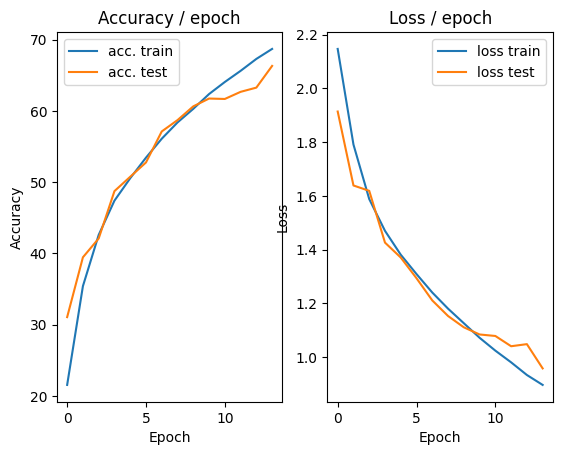

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.172s (0.172s)	Loss 0.8846 (0.8846)	Prec@1  68.8 ( 68.8)	Prec@5  98.4 ( 98.4)


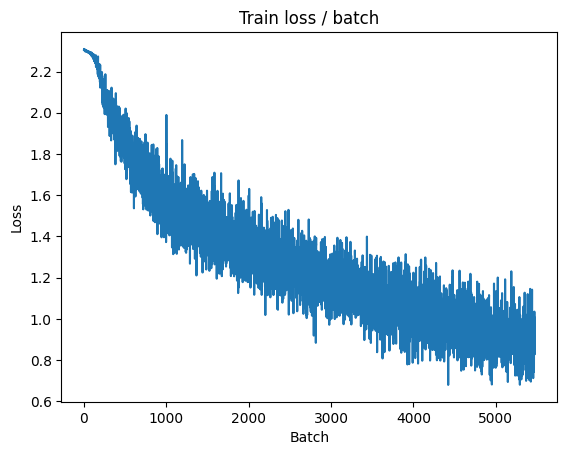

[TRAIN Batch 200/391]	Time 0.048s (0.035s)	Loss 0.9000 (0.8694)	Prec@1  68.0 ( 69.6)	Prec@5  97.7 ( 97.6)


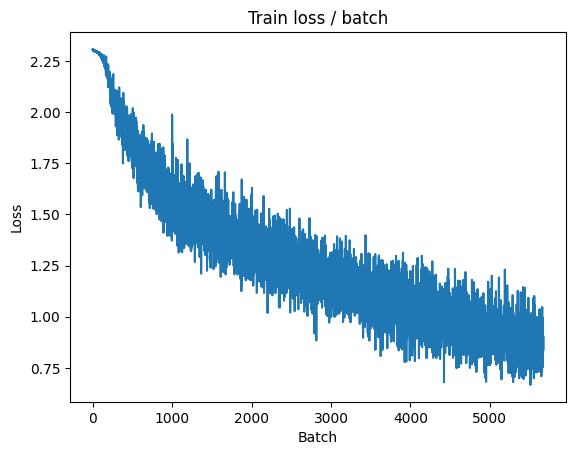


===============> Total time 12s	Avg loss 0.8619	Avg Prec@1 70.04 %	Avg Prec@5 97.67 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 0.7987 (0.7987)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.9431	Avg Prec@1 66.87 %	Avg Prec@5 97.24 %



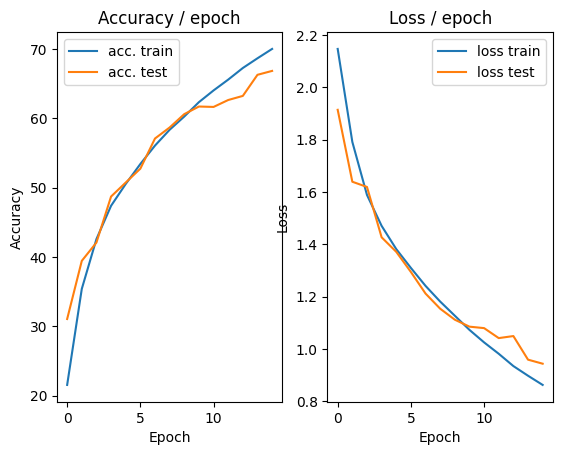

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.164s (0.164s)	Loss 0.8086 (0.8086)	Prec@1  71.9 ( 71.9)	Prec@5  99.2 ( 99.2)


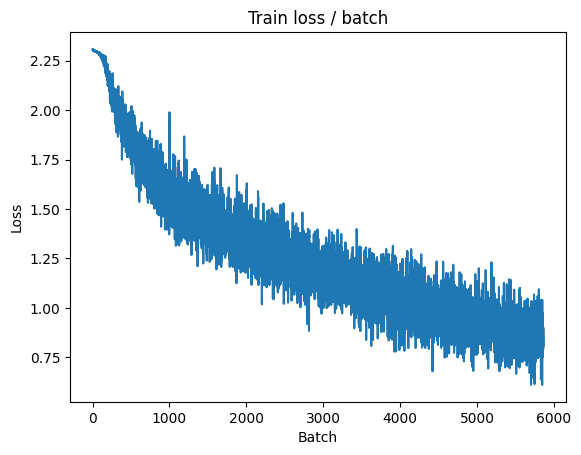

[TRAIN Batch 200/391]	Time 0.042s (0.030s)	Loss 0.8104 (0.8305)	Prec@1  72.7 ( 71.0)	Prec@5  96.9 ( 97.9)


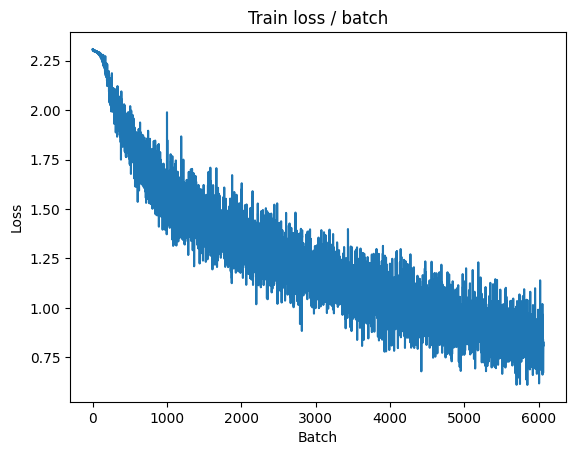


===============> Total time 12s	Avg loss 0.8264	Avg Prec@1 71.14 %	Avg Prec@5 97.91 %

[EVAL Batch 000/079]	Time 0.134s (0.134s)	Loss 0.7550 (0.7550)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9343	Avg Prec@1 66.93 %	Avg Prec@5 97.17 %



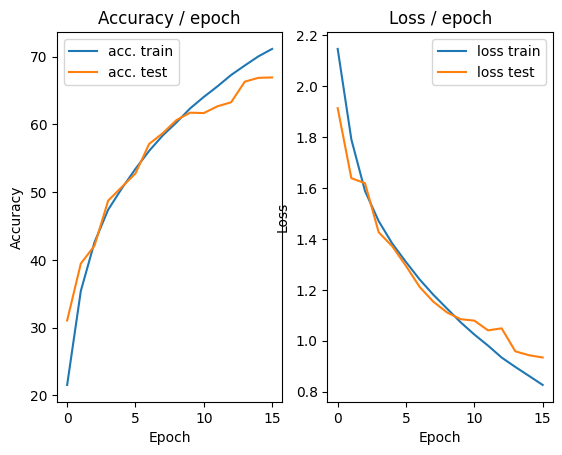

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 0.7317 (0.7317)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)


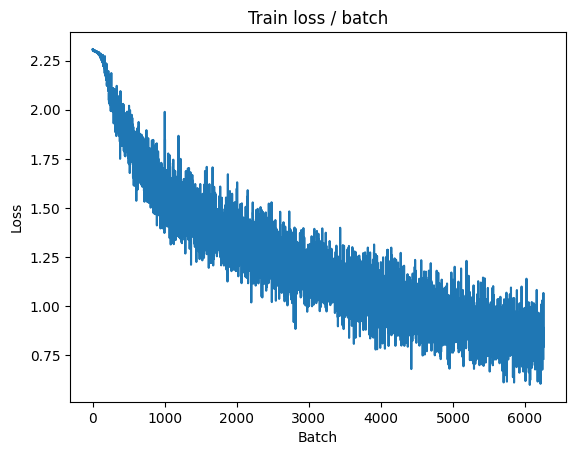

[TRAIN Batch 200/391]	Time 0.011s (0.030s)	Loss 0.7755 (0.7991)	Prec@1  72.7 ( 72.1)	Prec@5  99.2 ( 97.9)


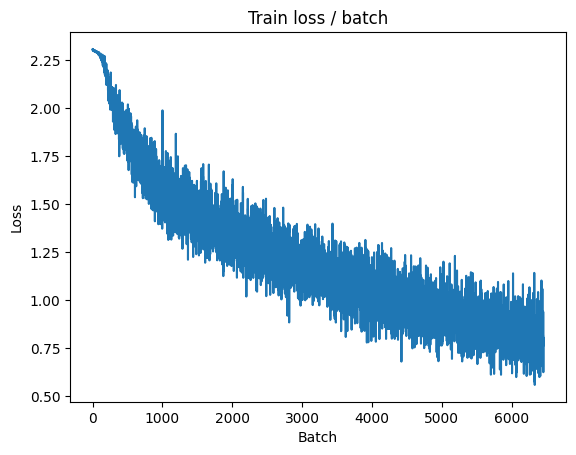


===============> Total time 12s	Avg loss 0.7934	Avg Prec@1 72.37 %	Avg Prec@5 98.05 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.7919 (0.7919)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9381	Avg Prec@1 67.46 %	Avg Prec@5 97.12 %



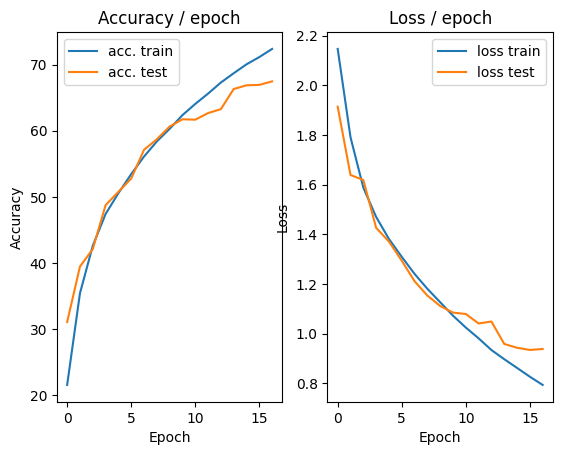

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.161s (0.161s)	Loss 0.6980 (0.6980)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)


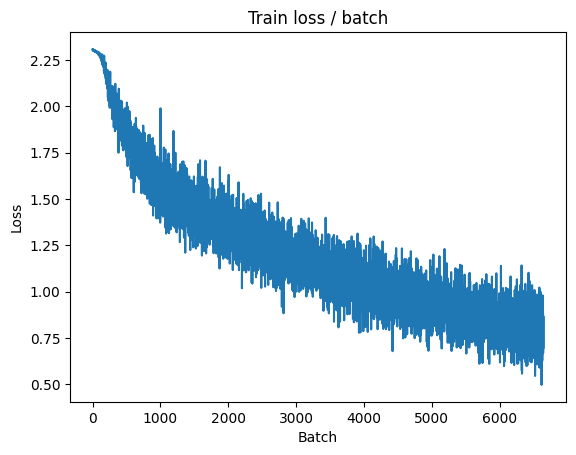

[TRAIN Batch 200/391]	Time 0.062s (0.034s)	Loss 0.8845 (0.7552)	Prec@1  73.4 ( 73.7)	Prec@5  94.5 ( 98.2)


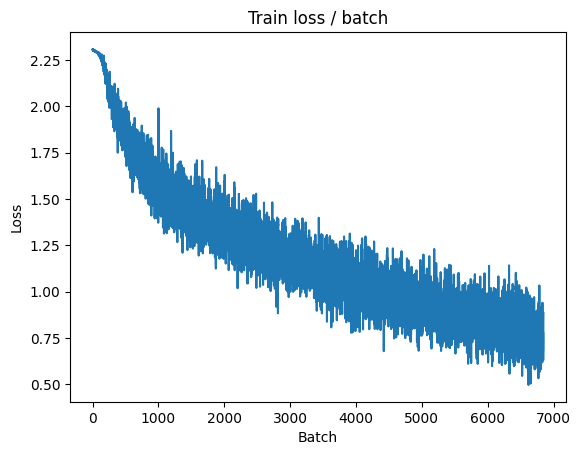


===============> Total time 12s	Avg loss 0.7603	Avg Prec@1 73.66 %	Avg Prec@5 98.25 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.7670 (0.7670)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.9252	Avg Prec@1 67.75 %	Avg Prec@5 97.32 %



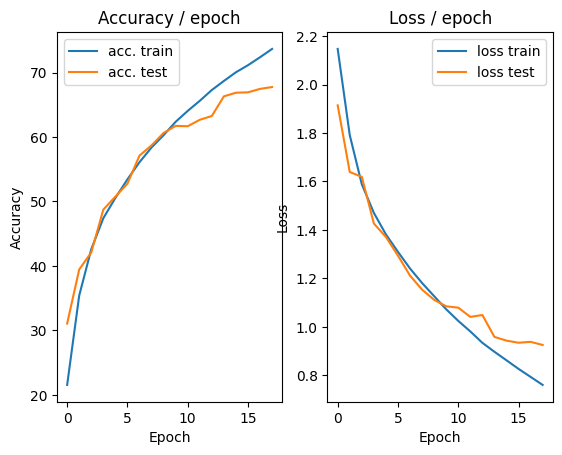

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.171s (0.171s)	Loss 0.6594 (0.6594)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)


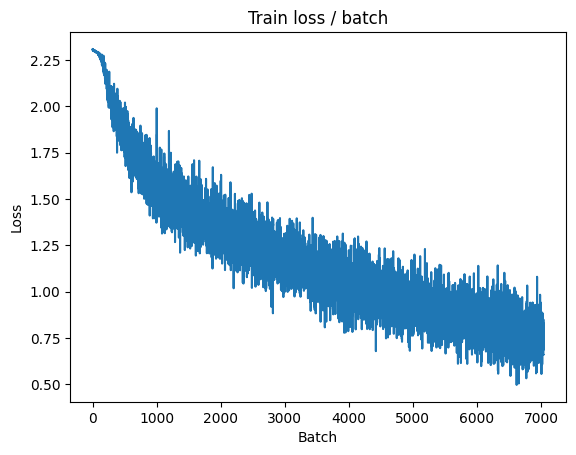

[TRAIN Batch 200/391]	Time 0.051s (0.035s)	Loss 0.6736 (0.7335)	Prec@1  76.6 ( 74.9)	Prec@5  96.9 ( 98.3)


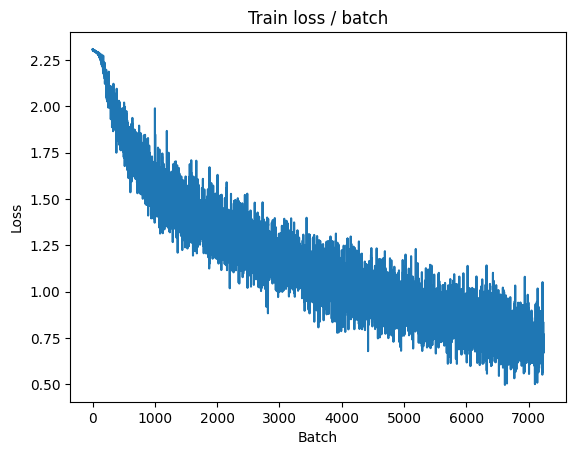


===============> Total time 12s	Avg loss 0.7321	Avg Prec@1 74.85 %	Avg Prec@5 98.36 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 0.7528 (0.7528)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9161	Avg Prec@1 67.85 %	Avg Prec@5 97.53 %



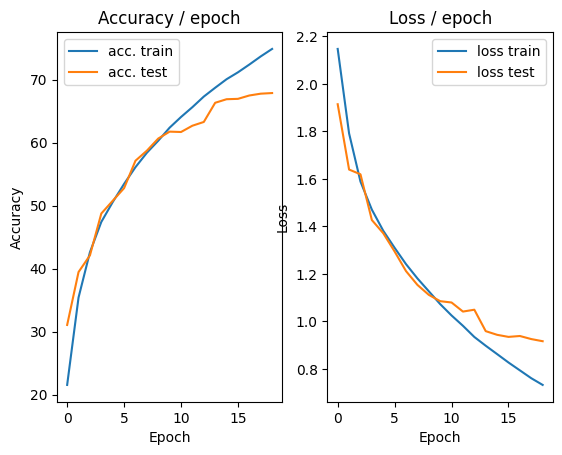

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.222s (0.222s)	Loss 0.6267 (0.6267)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


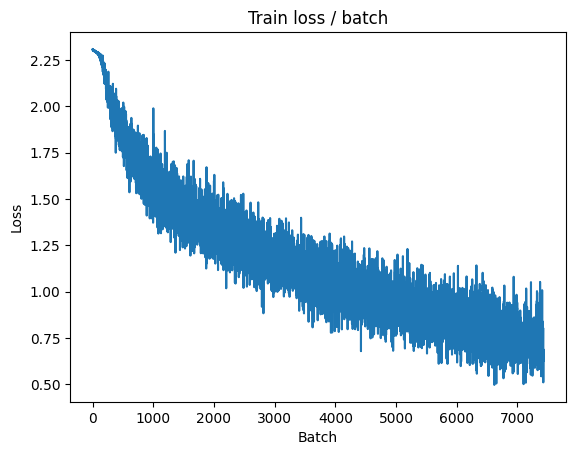

[TRAIN Batch 200/391]	Time 0.012s (0.035s)	Loss 0.6225 (0.6970)	Prec@1  77.3 ( 75.7)	Prec@5  99.2 ( 98.6)


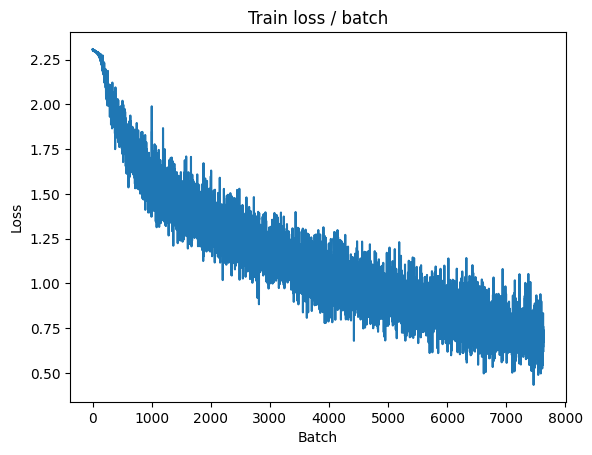


===============> Total time 12s	Avg loss 0.7002	Avg Prec@1 75.80 %	Avg Prec@5 98.52 %

[EVAL Batch 000/079]	Time 0.218s (0.218s)	Loss 0.7340 (0.7340)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8944	Avg Prec@1 68.42 %	Avg Prec@5 97.50 %



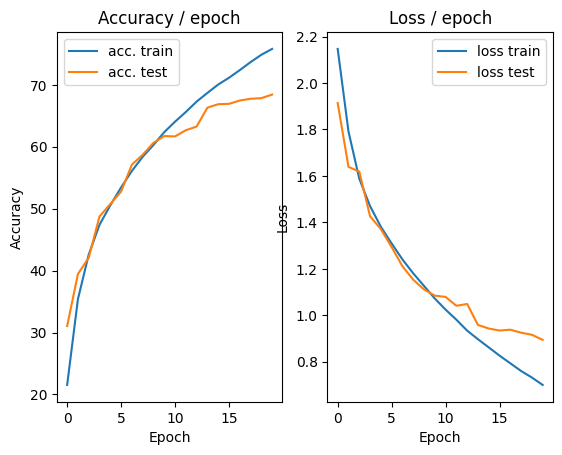

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.179s (0.179s)	Loss 0.9147 (0.9147)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)


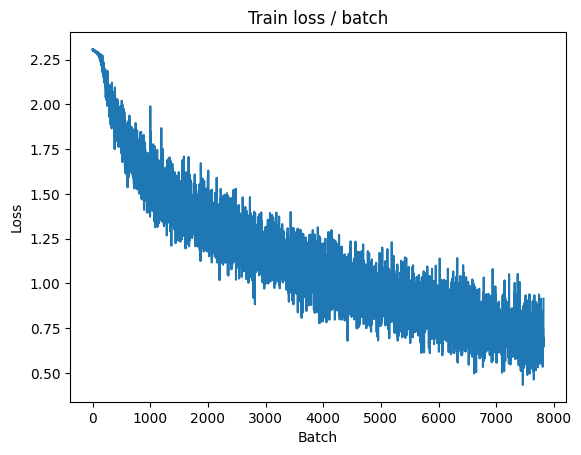

[TRAIN Batch 200/391]	Time 0.011s (0.030s)	Loss 0.8345 (0.6808)	Prec@1  76.6 ( 76.3)	Prec@5  96.1 ( 98.6)


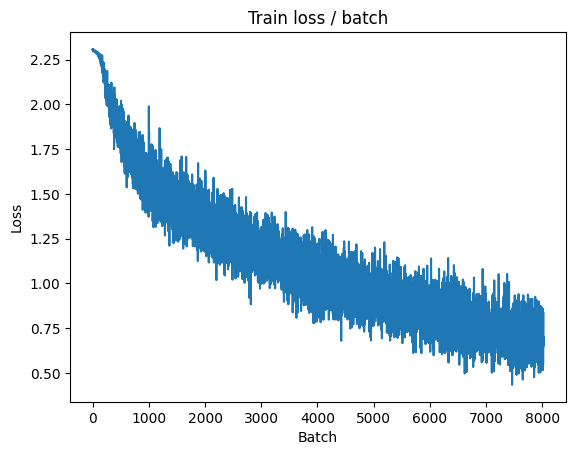


===============> Total time 12s	Avg loss 0.6748	Avg Prec@1 76.60 %	Avg Prec@5 98.60 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 0.7189 (0.7189)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8153	Avg Prec@1 71.47 %	Avg Prec@5 97.99 %



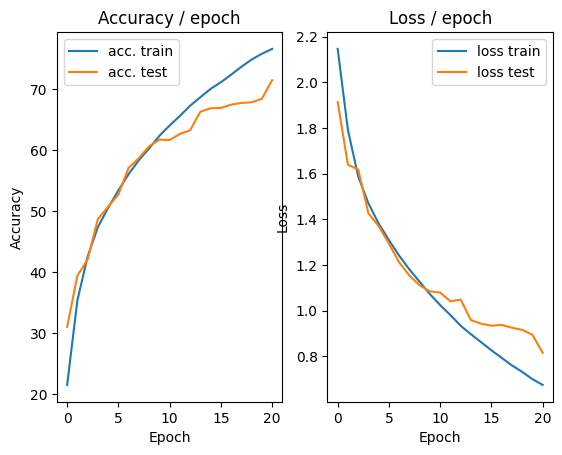

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.5532 (0.5532)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)


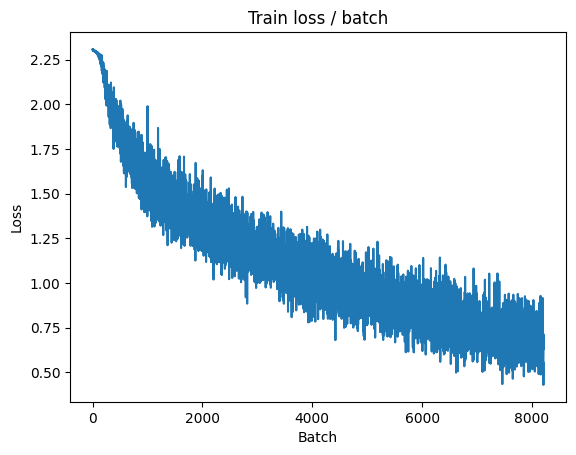

[TRAIN Batch 200/391]	Time 0.074s (0.032s)	Loss 0.7913 (0.6457)	Prec@1  75.0 ( 77.7)	Prec@5  98.4 ( 98.8)


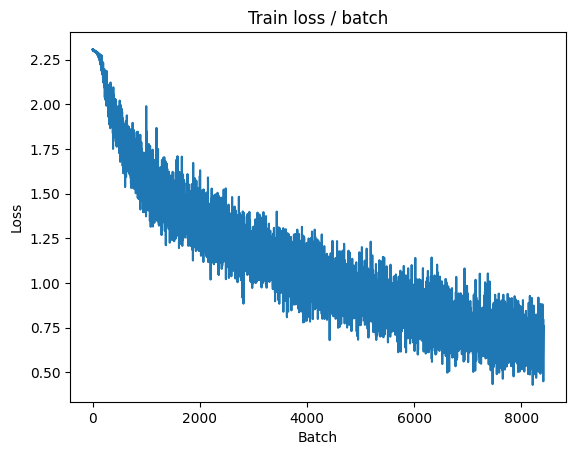


===============> Total time 13s	Avg loss 0.6447	Avg Prec@1 77.80 %	Avg Prec@5 98.77 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 0.7401 (0.7401)	Prec@1  75.0 ( 75.0)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.8752	Avg Prec@1 70.03 %	Avg Prec@5 97.63 %



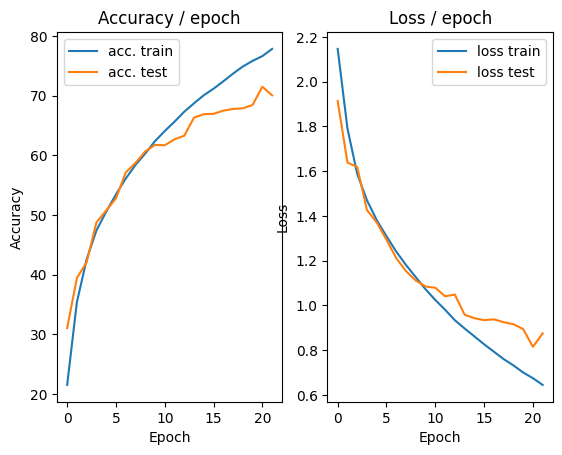

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.171s (0.171s)	Loss 0.6420 (0.6420)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)


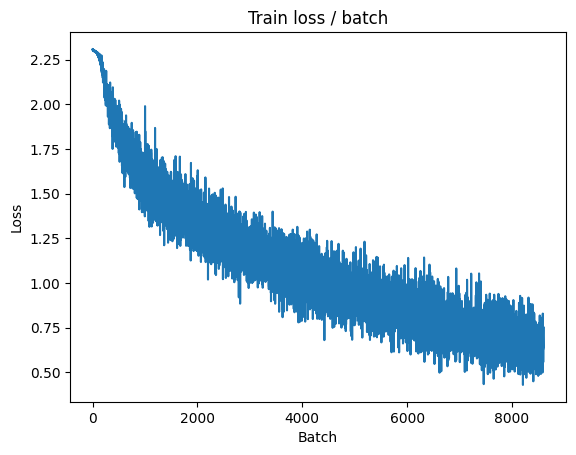

[TRAIN Batch 200/391]	Time 0.045s (0.035s)	Loss 0.6104 (0.6186)	Prec@1  77.3 ( 78.6)	Prec@5  99.2 ( 98.9)


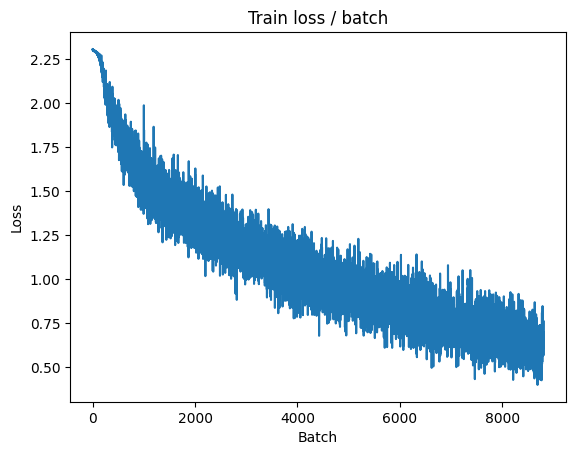


===============> Total time 12s	Avg loss 0.6180	Avg Prec@1 78.60 %	Avg Prec@5 98.89 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.7204 (0.7204)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8457	Avg Prec@1 71.19 %	Avg Prec@5 97.77 %



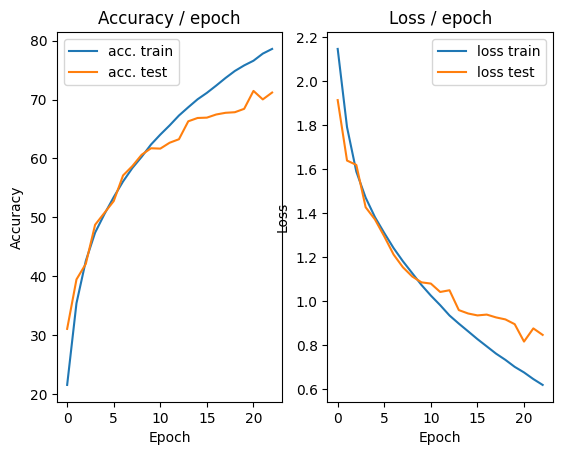

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.241s (0.241s)	Loss 0.6164 (0.6164)	Prec@1  75.0 ( 75.0)	Prec@5 100.0 (100.0)


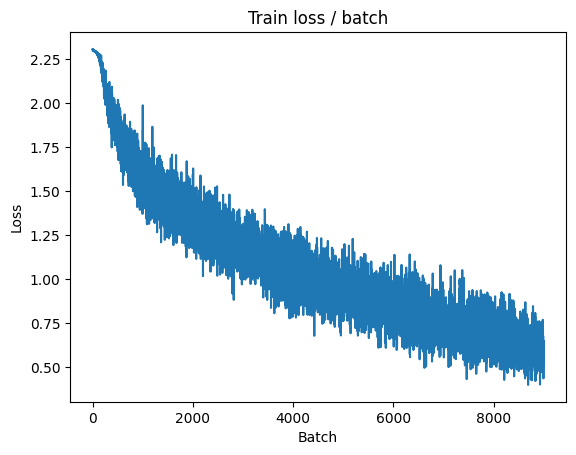

[TRAIN Batch 200/391]	Time 0.044s (0.035s)	Loss 0.5203 (0.5953)	Prec@1  81.2 ( 79.6)	Prec@5 100.0 ( 99.0)


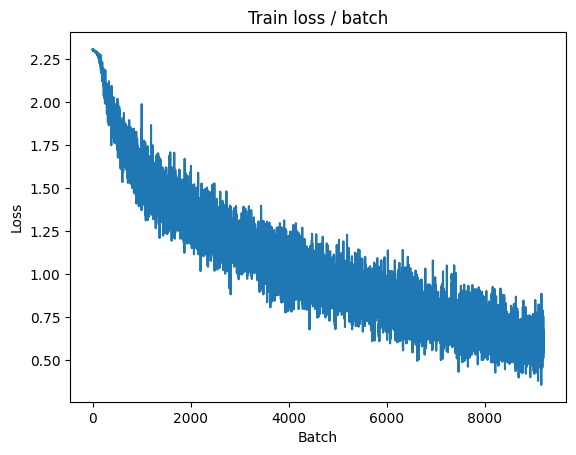


===============> Total time 12s	Avg loss 0.5949	Avg Prec@1 79.37 %	Avg Prec@5 98.98 %

[EVAL Batch 000/079]	Time 0.232s (0.232s)	Loss 0.6711 (0.6711)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8478	Avg Prec@1 71.28 %	Avg Prec@5 97.91 %



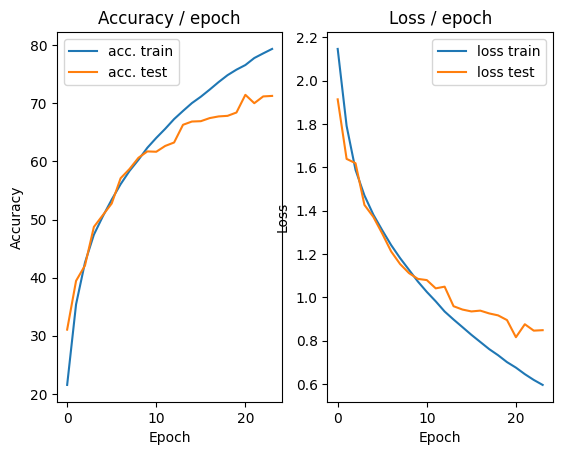

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.227s (0.227s)	Loss 0.6334 (0.6334)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)


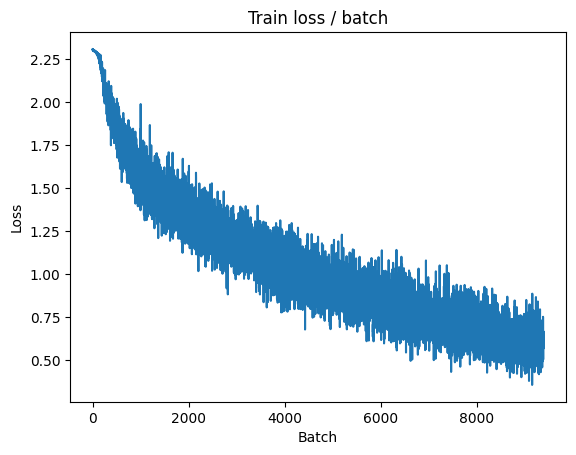

[TRAIN Batch 200/391]	Time 0.029s (0.031s)	Loss 0.5624 (0.5578)	Prec@1  84.4 ( 80.9)	Prec@5  98.4 ( 99.0)


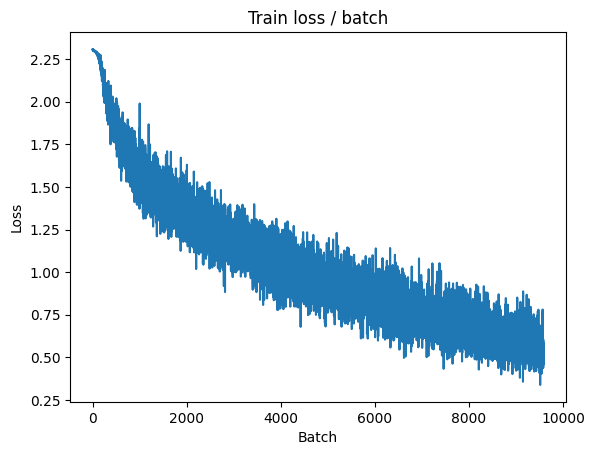


===============> Total time 12s	Avg loss 0.5661	Avg Prec@1 80.43 %	Avg Prec@5 99.06 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.8051 (0.8051)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8464	Avg Prec@1 70.75 %	Avg Prec@5 98.00 %



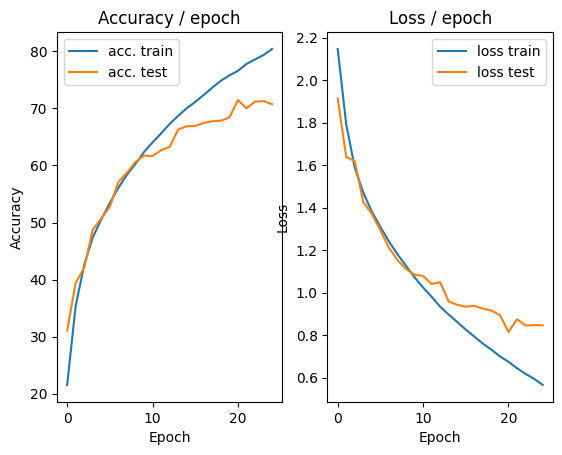

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.191s (0.191s)	Loss 0.6465 (0.6465)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)


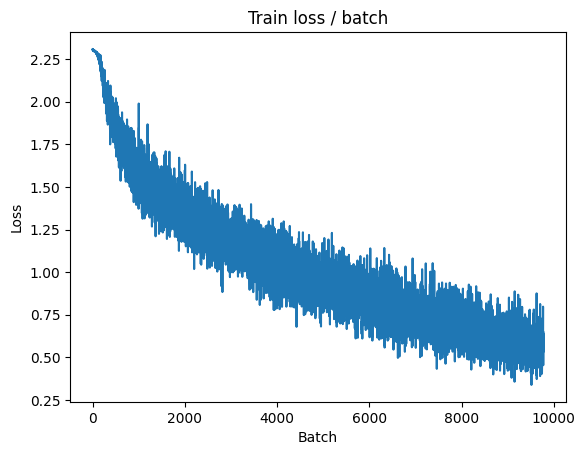

[TRAIN Batch 200/391]	Time 0.051s (0.031s)	Loss 0.6381 (0.5276)	Prec@1  80.5 ( 81.8)	Prec@5  98.4 ( 99.1)


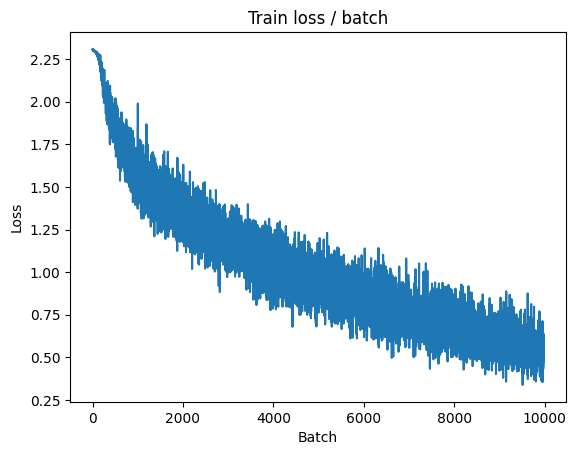


===============> Total time 12s	Avg loss 0.5397	Avg Prec@1 81.39 %	Avg Prec@5 99.14 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 0.6853 (0.6853)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.8118	Avg Prec@1 72.90 %	Avg Prec@5 98.02 %



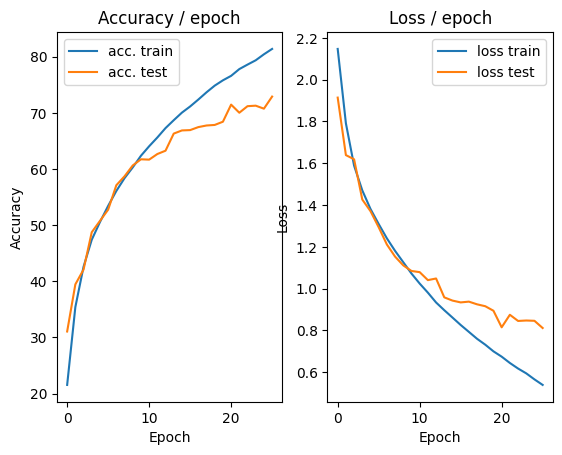

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.200s (0.200s)	Loss 0.3793 (0.3793)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


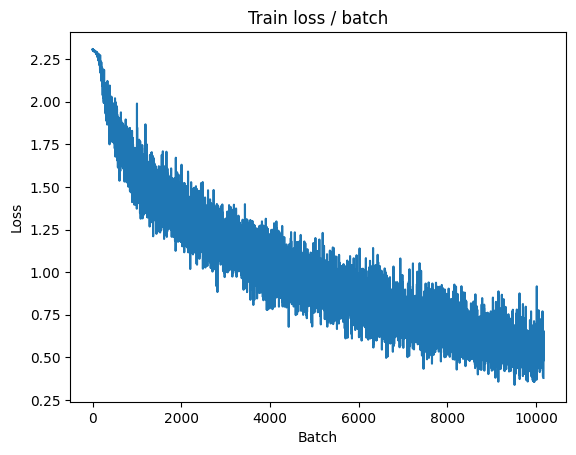

[TRAIN Batch 200/391]	Time 0.046s (0.035s)	Loss 0.5415 (0.5140)	Prec@1  82.0 ( 82.4)	Prec@5 100.0 ( 99.3)


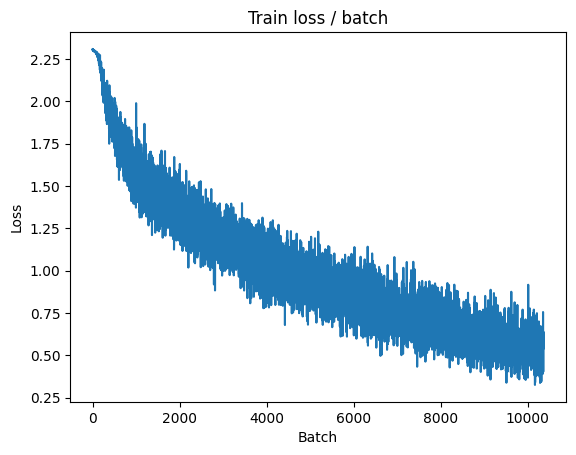


===============> Total time 12s	Avg loss 0.5159	Avg Prec@1 82.24 %	Avg Prec@5 99.30 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.6837 (0.6837)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.8960	Avg Prec@1 69.99 %	Avg Prec@5 97.90 %



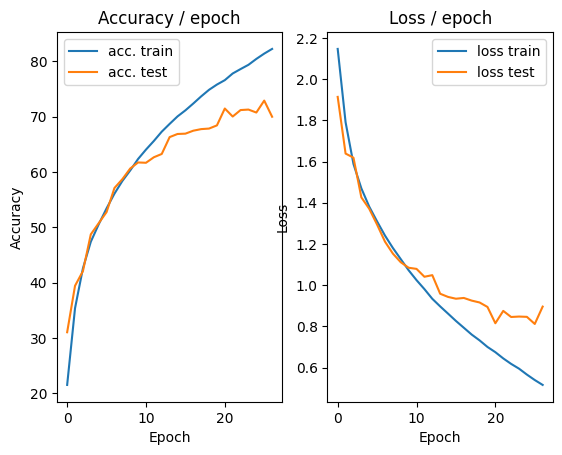

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.210s (0.210s)	Loss 0.6613 (0.6613)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)


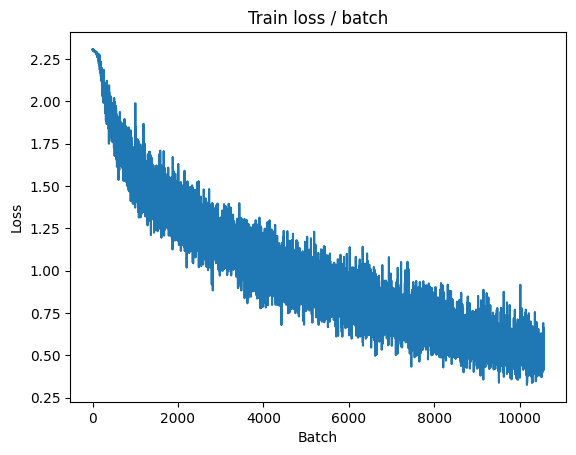

[TRAIN Batch 200/391]	Time 0.047s (0.036s)	Loss 0.6201 (0.4845)	Prec@1  78.9 ( 83.5)	Prec@5  98.4 ( 99.3)


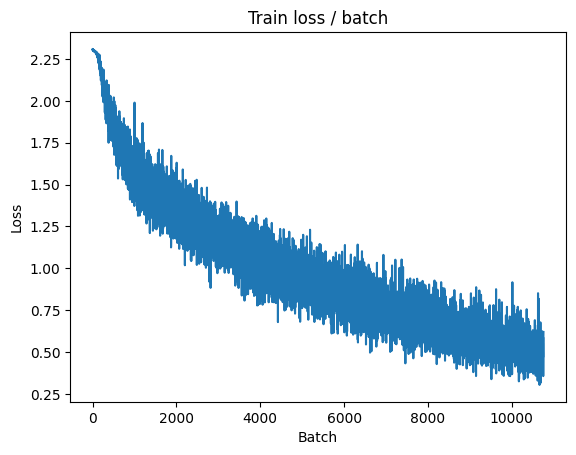


===============> Total time 13s	Avg loss 0.4902	Avg Prec@1 83.12 %	Avg Prec@5 99.28 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.7232 (0.7232)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8136	Avg Prec@1 72.05 %	Avg Prec@5 97.99 %



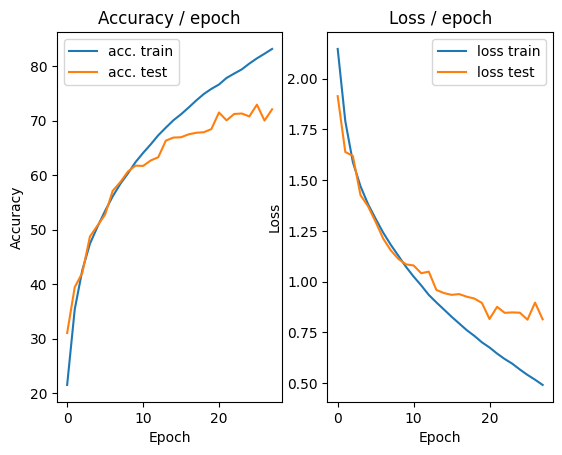

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 0.4182 (0.4182)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


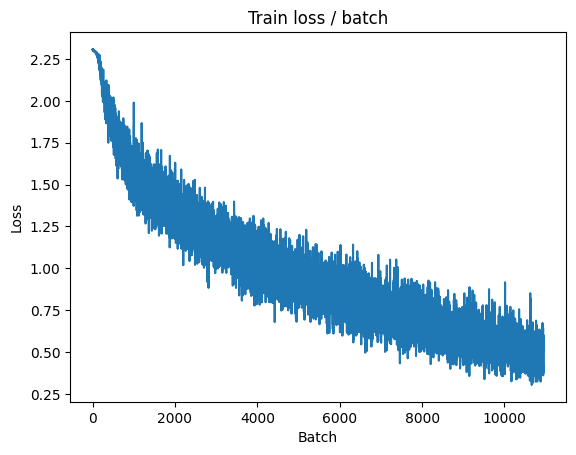

[TRAIN Batch 200/391]	Time 0.015s (0.031s)	Loss 0.3611 (0.4549)	Prec@1  86.7 ( 84.4)	Prec@5 100.0 ( 99.4)


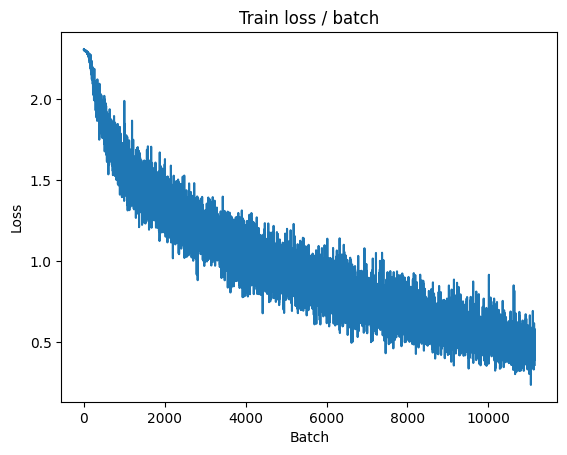


===============> Total time 12s	Avg loss 0.4618	Avg Prec@1 84.13 %	Avg Prec@5 99.38 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 0.6978 (0.6978)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8393	Avg Prec@1 72.54 %	Avg Prec@5 97.77 %



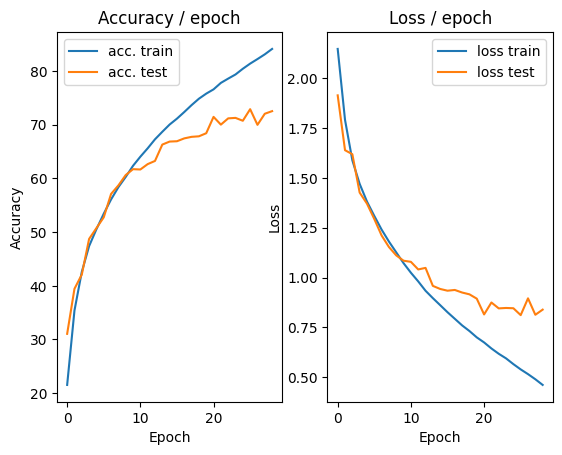

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.217s (0.217s)	Loss 0.4523 (0.4523)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)


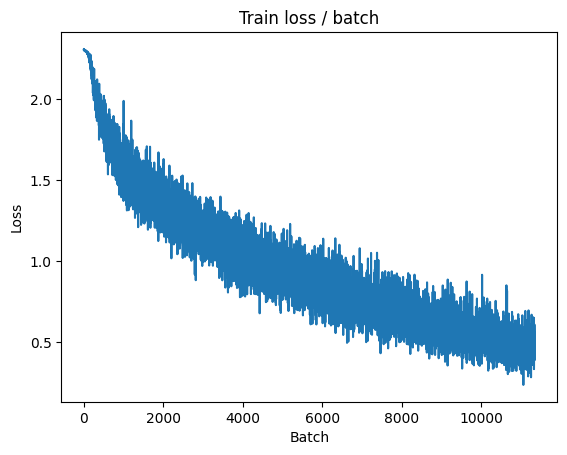

[TRAIN Batch 200/391]	Time 0.052s (0.031s)	Loss 0.4886 (0.4300)	Prec@1  82.8 ( 85.1)	Prec@5  97.7 ( 99.5)


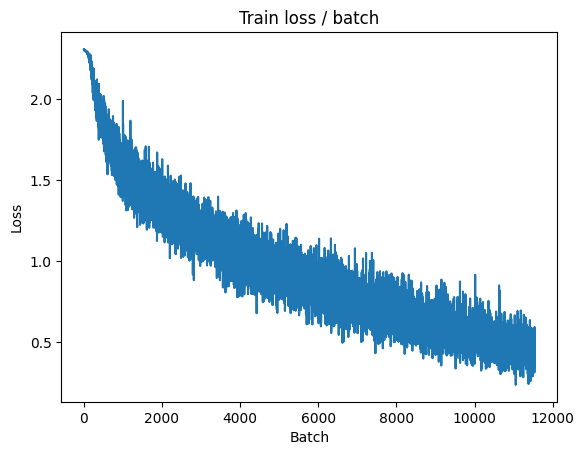


===============> Total time 12s	Avg loss 0.4399	Avg Prec@1 84.79 %	Avg Prec@5 99.46 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.6907 (0.6907)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8377	Avg Prec@1 72.46 %	Avg Prec@5 97.95 %



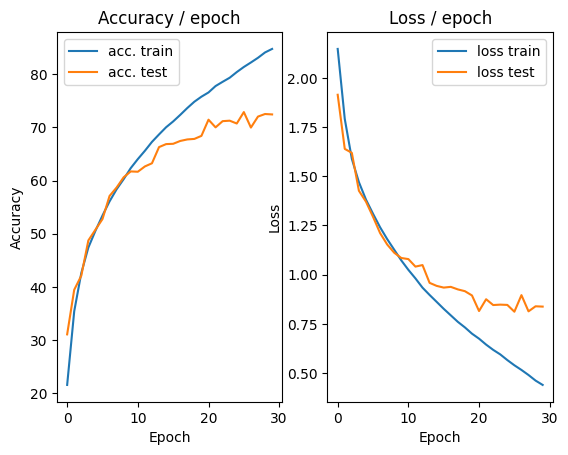

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.150s (0.150s)	Loss 0.4937 (0.4937)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)


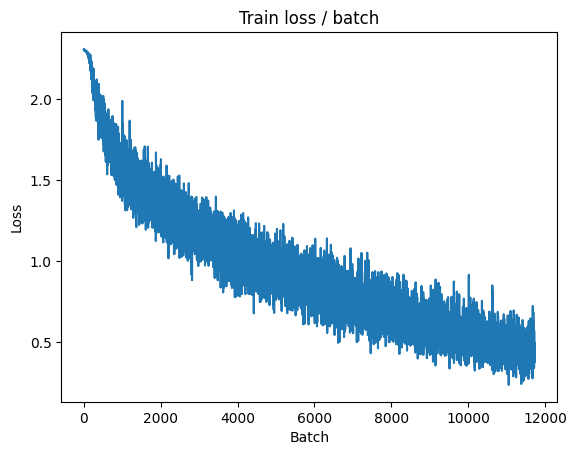

[TRAIN Batch 200/391]	Time 0.010s (0.036s)	Loss 0.4166 (0.4109)	Prec@1  84.4 ( 86.0)	Prec@5  99.2 ( 99.4)


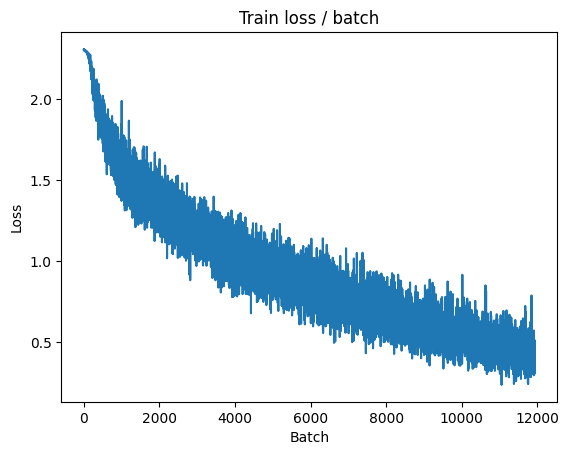


===============> Total time 12s	Avg loss 0.4152	Avg Prec@1 85.79 %	Avg Prec@5 99.49 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 0.7492 (0.7492)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8491	Avg Prec@1 72.25 %	Avg Prec@5 97.95 %



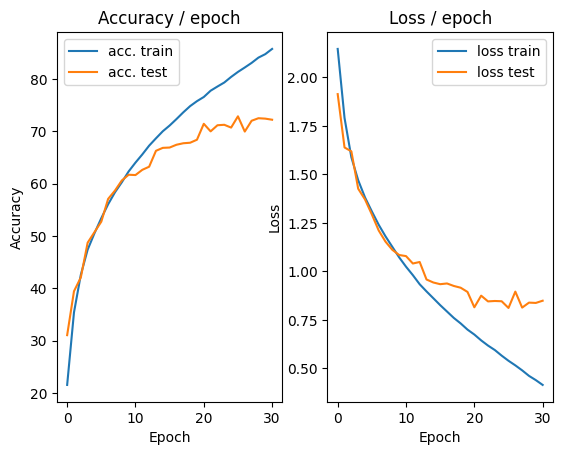

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.246s (0.246s)	Loss 0.4180 (0.4180)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)


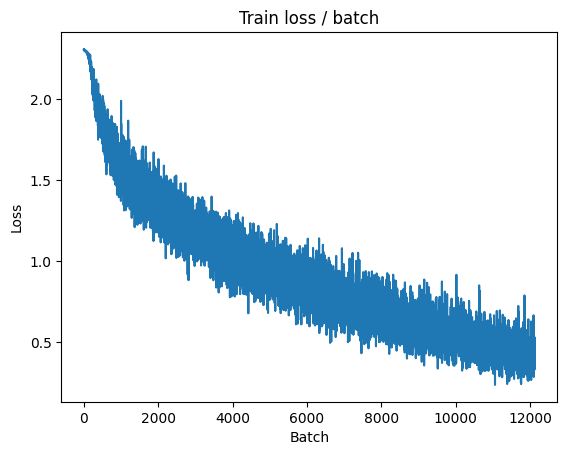

[TRAIN Batch 200/391]	Time 0.013s (0.035s)	Loss 0.4425 (0.3821)	Prec@1  86.7 ( 87.1)	Prec@5  98.4 ( 99.6)


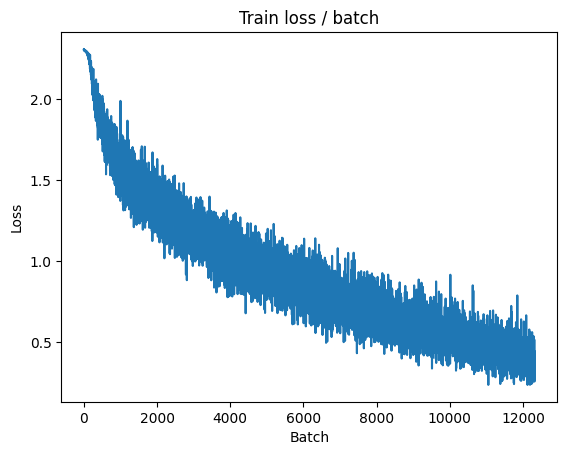


===============> Total time 12s	Avg loss 0.3896	Avg Prec@1 86.58 %	Avg Prec@5 99.61 %

[EVAL Batch 000/079]	Time 0.134s (0.134s)	Loss 0.7488 (0.7488)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.8773	Avg Prec@1 71.73 %	Avg Prec@5 97.98 %



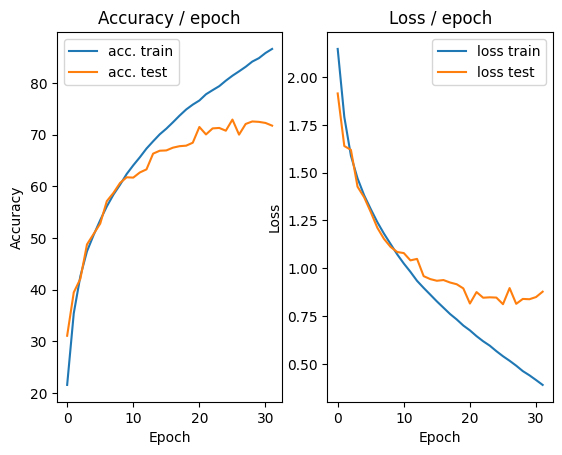

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.287s (0.287s)	Loss 0.3313 (0.3313)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


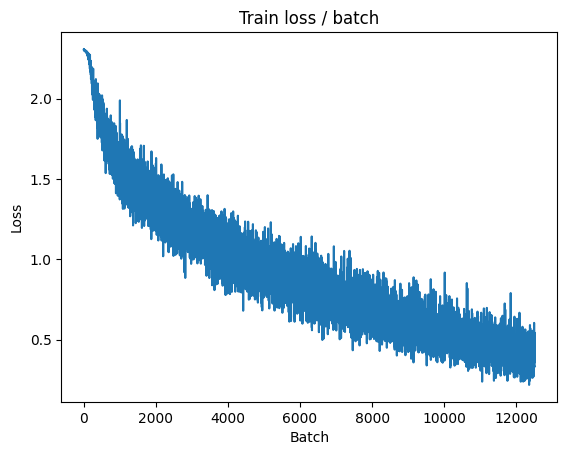

[TRAIN Batch 200/391]	Time 0.009s (0.032s)	Loss 0.2813 (0.3609)	Prec@1  91.4 ( 87.7)	Prec@5 100.0 ( 99.6)


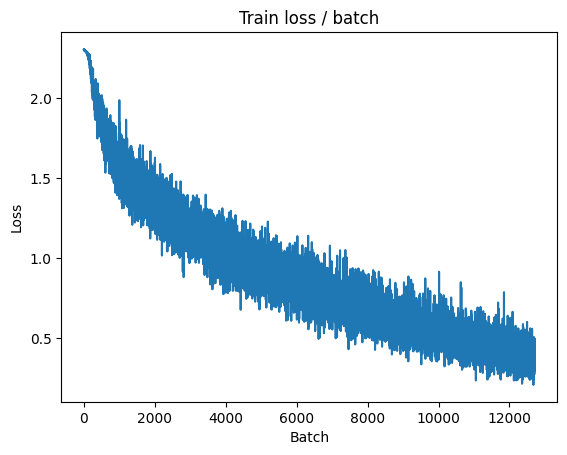


===============> Total time 12s	Avg loss 0.3657	Avg Prec@1 87.47 %	Avg Prec@5 99.64 %

[EVAL Batch 000/079]	Time 0.221s (0.221s)	Loss 0.7433 (0.7433)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8574	Avg Prec@1 73.88 %	Avg Prec@5 97.97 %



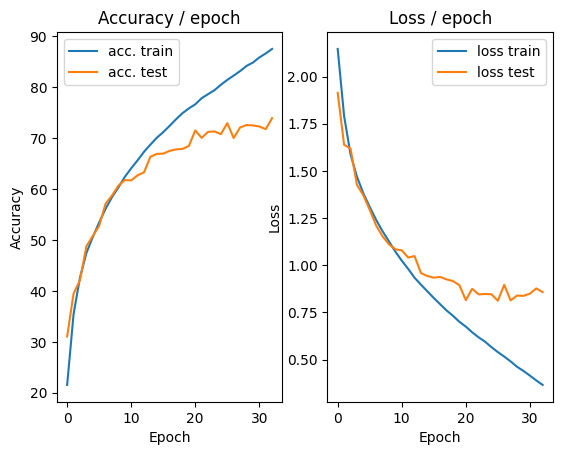

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.212s (0.212s)	Loss 0.4010 (0.4010)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)


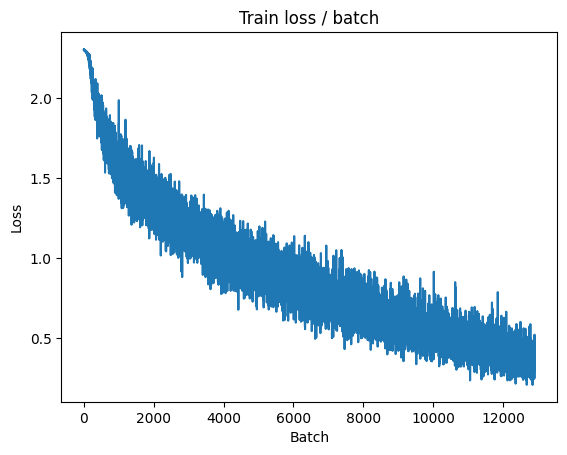

[TRAIN Batch 200/391]	Time 0.046s (0.030s)	Loss 0.2732 (0.3389)	Prec@1  90.6 ( 88.3)	Prec@5  99.2 ( 99.7)


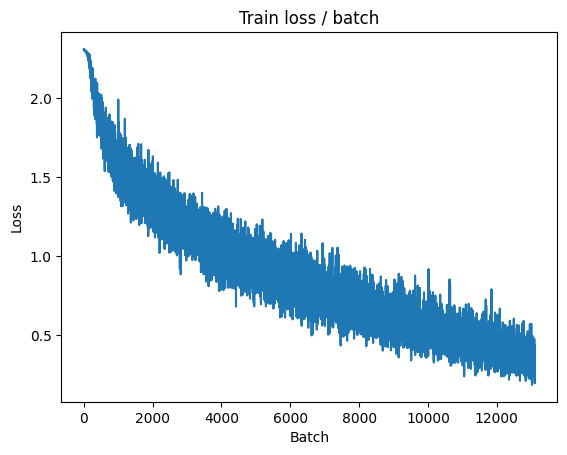


===============> Total time 12s	Avg loss 0.3433	Avg Prec@1 88.25 %	Avg Prec@5 99.68 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.7991 (0.7991)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.8993	Avg Prec@1 72.76 %	Avg Prec@5 97.73 %



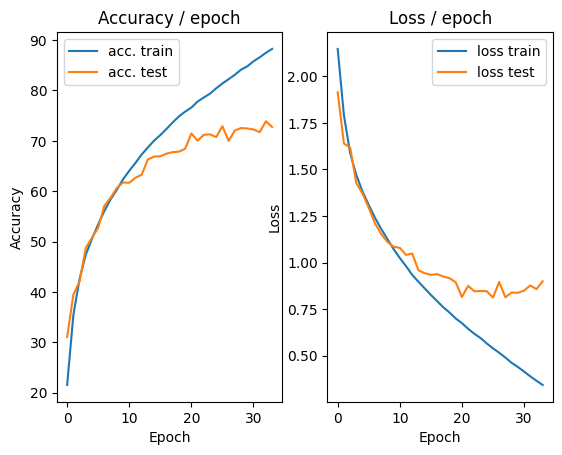

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.216s (0.216s)	Loss 0.3228 (0.3228)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)


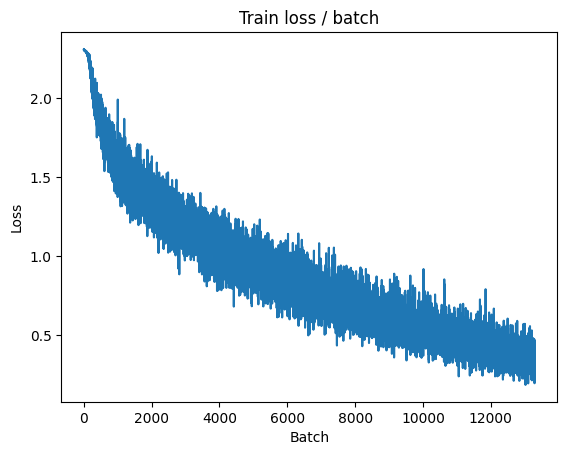

[TRAIN Batch 200/391]	Time 0.054s (0.031s)	Loss 0.3320 (0.3176)	Prec@1  90.6 ( 89.3)	Prec@5 100.0 ( 99.7)


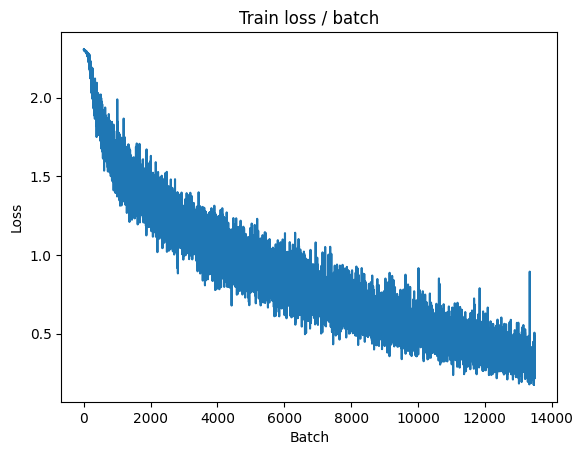


===============> Total time 12s	Avg loss 0.3217	Avg Prec@1 89.12 %	Avg Prec@5 99.71 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 0.8537 (0.8537)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.9402	Avg Prec@1 71.27 %	Avg Prec@5 97.81 %



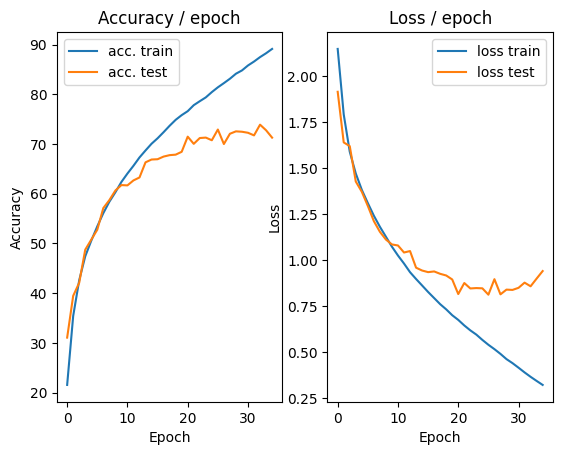

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.209s (0.209s)	Loss 0.2305 (0.2305)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


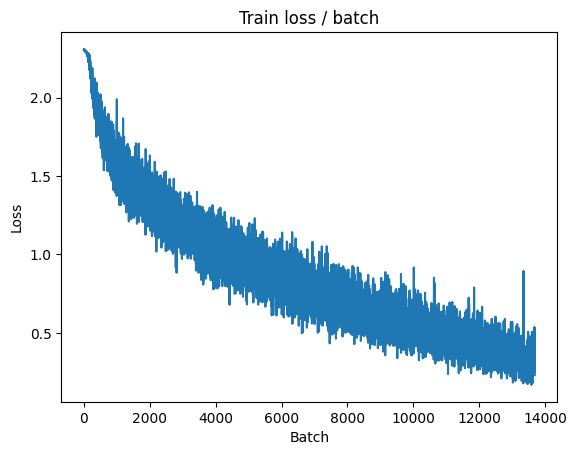

[TRAIN Batch 200/391]	Time 0.039s (0.036s)	Loss 0.2208 (0.2900)	Prec@1  91.4 ( 90.3)	Prec@5 100.0 ( 99.8)


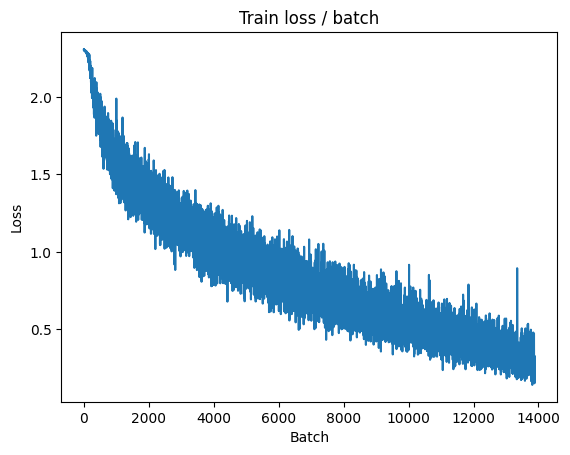


===============> Total time 12s	Avg loss 0.2945	Avg Prec@1 90.15 %	Avg Prec@5 99.77 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 0.8531 (0.8531)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 1.1287	Avg Prec@1 69.82 %	Avg Prec@5 96.95 %



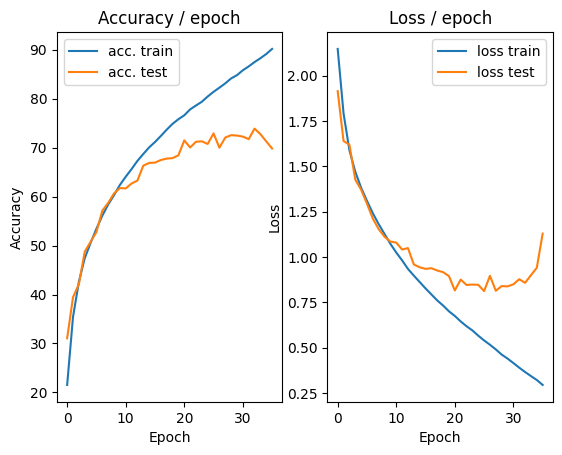

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.210s (0.210s)	Loss 0.3611 (0.3611)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


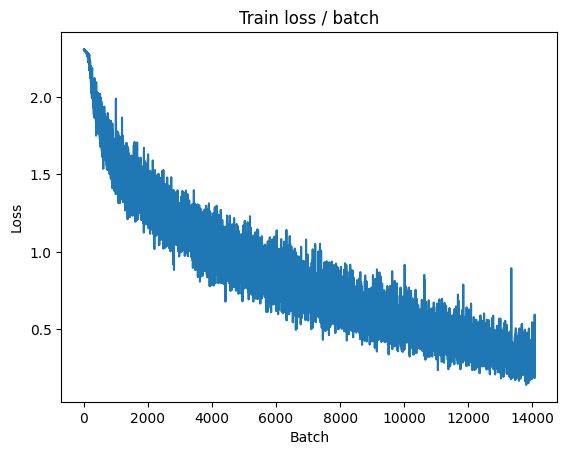

[TRAIN Batch 200/391]	Time 0.036s (0.036s)	Loss 0.3933 (0.2567)	Prec@1  85.2 ( 91.6)	Prec@5  99.2 ( 99.9)


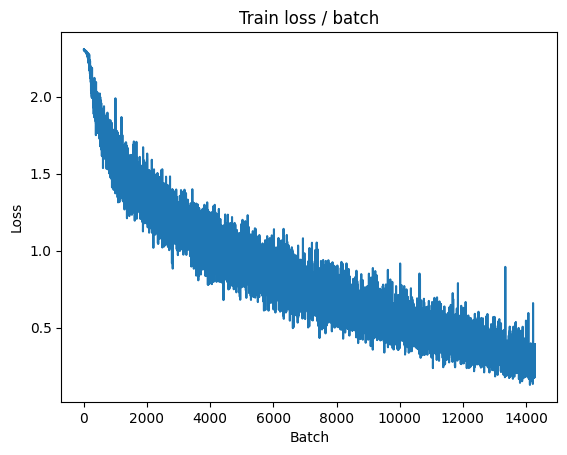


===============> Total time 14s	Avg loss 0.2720	Avg Prec@1 90.92 %	Avg Prec@5 99.84 %

[EVAL Batch 000/079]	Time 0.285s (0.285s)	Loss 0.7519 (0.7519)	Prec@1  73.4 ( 73.4)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.9242	Avg Prec@1 72.81 %	Avg Prec@5 97.96 %



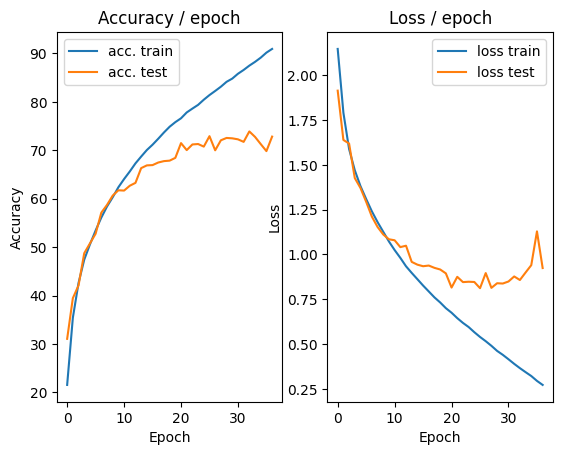

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.228s (0.228s)	Loss 0.2420 (0.2420)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


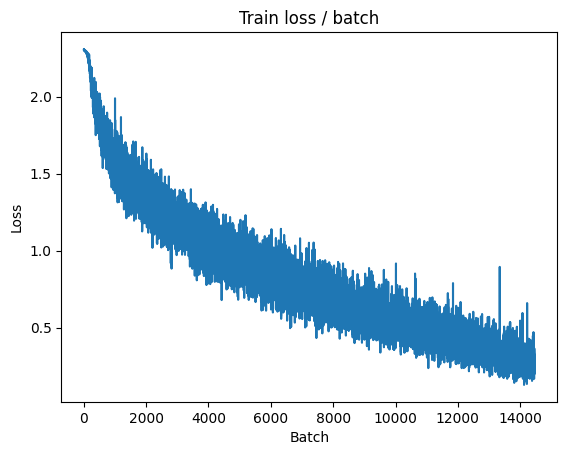

[TRAIN Batch 200/391]	Time 0.047s (0.031s)	Loss 0.2379 (0.2494)	Prec@1  92.2 ( 91.9)	Prec@5 100.0 ( 99.8)


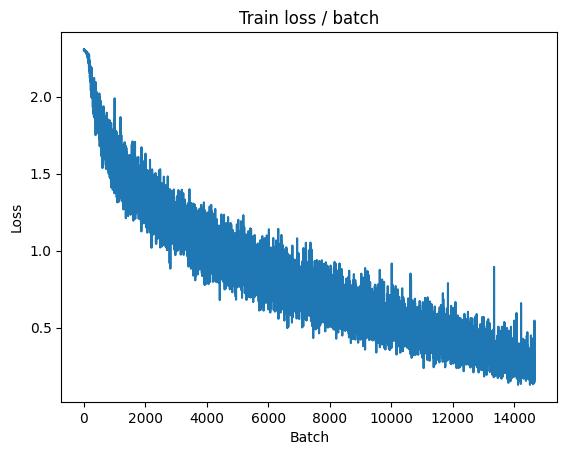


===============> Total time 12s	Avg loss 0.2515	Avg Prec@1 91.80 %	Avg Prec@5 99.85 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.8313 (0.8313)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9846	Avg Prec@1 72.86 %	Avg Prec@5 97.90 %



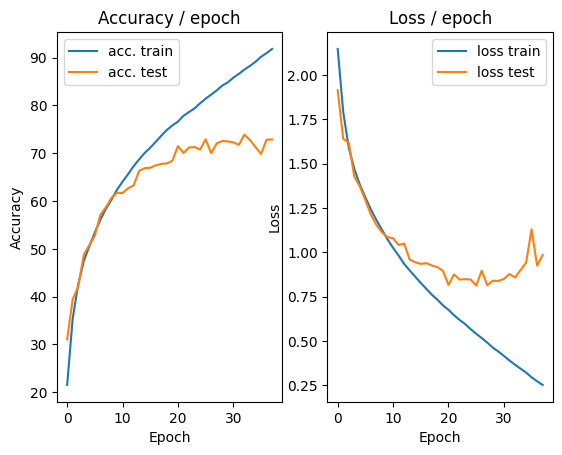

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.197s (0.197s)	Loss 0.3608 (0.3608)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


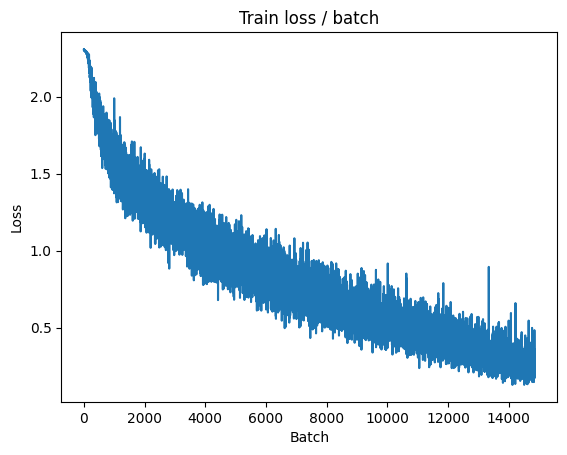

[TRAIN Batch 200/391]	Time 0.014s (0.031s)	Loss 0.1315 (0.2234)	Prec@1  96.9 ( 92.7)	Prec@5 100.0 ( 99.9)


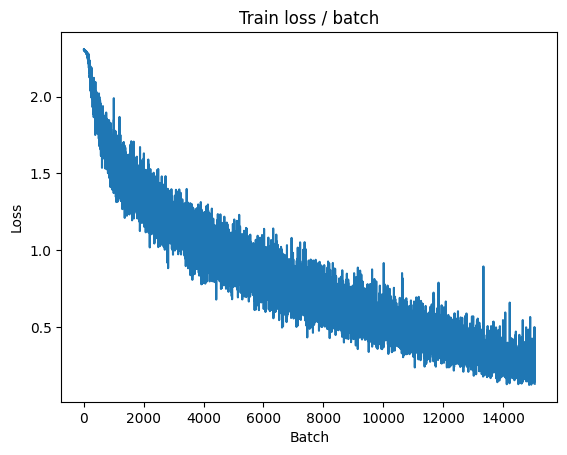


===============> Total time 12s	Avg loss 0.2381	Avg Prec@1 92.16 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 0.8136 (0.8136)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.0003	Avg Prec@1 72.03 %	Avg Prec@5 97.71 %



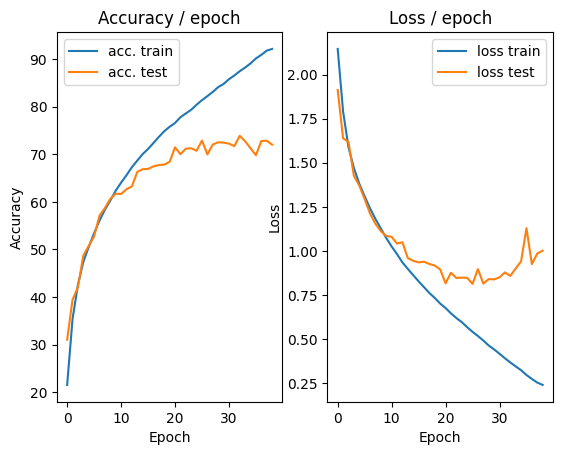

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.229s (0.229s)	Loss 0.2218 (0.2218)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


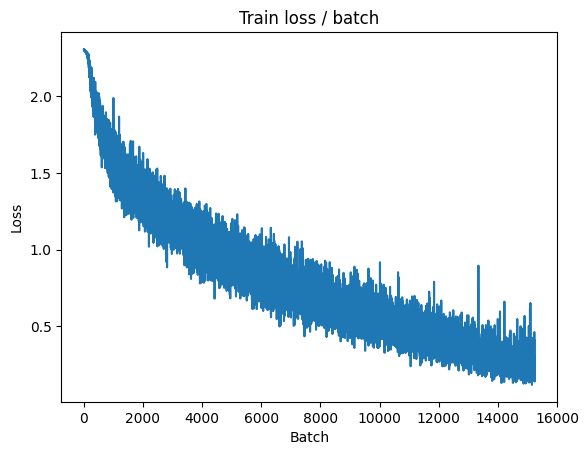

[TRAIN Batch 200/391]	Time 0.008s (0.035s)	Loss 0.1343 (0.1967)	Prec@1  97.7 ( 93.7)	Prec@5 100.0 ( 99.9)


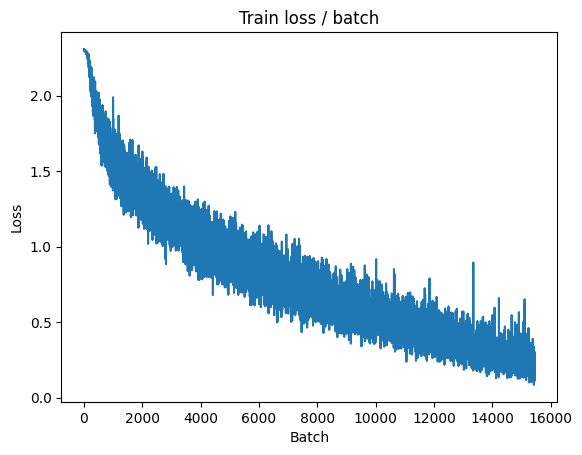


===============> Total time 12s	Avg loss 0.2110	Avg Prec@1 93.21 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.8379 (0.8379)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9444	Avg Prec@1 73.74 %	Avg Prec@5 98.13 %



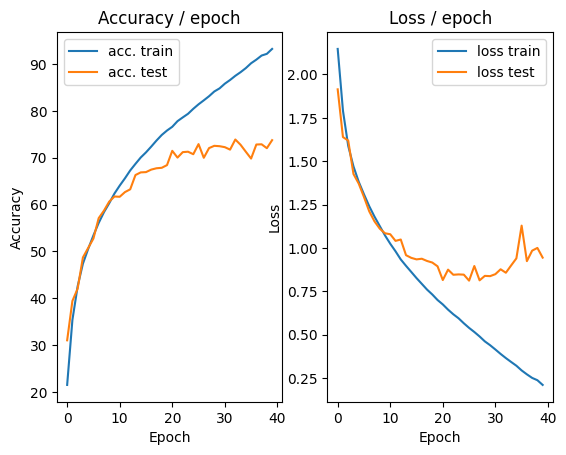

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.1334 (0.1334)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


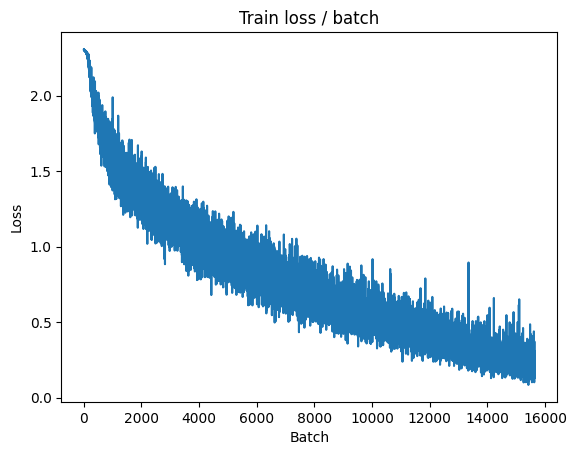

[TRAIN Batch 200/391]	Time 0.012s (0.035s)	Loss 0.1564 (0.1821)	Prec@1  96.1 ( 94.6)	Prec@5 100.0 ( 99.9)


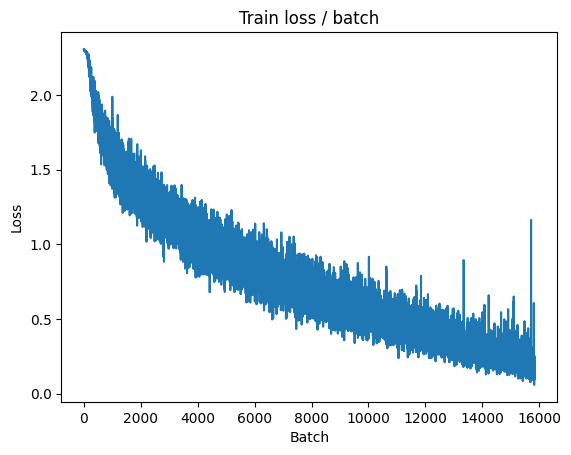


===============> Total time 12s	Avg loss 0.1885	Avg Prec@1 94.10 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 1.0266 (1.0266)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.1416	Avg Prec@1 71.28 %	Avg Prec@5 97.73 %



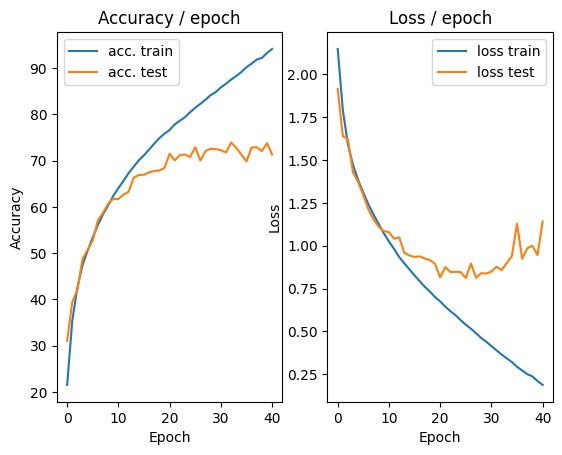

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.289s (0.289s)	Loss 0.1472 (0.1472)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


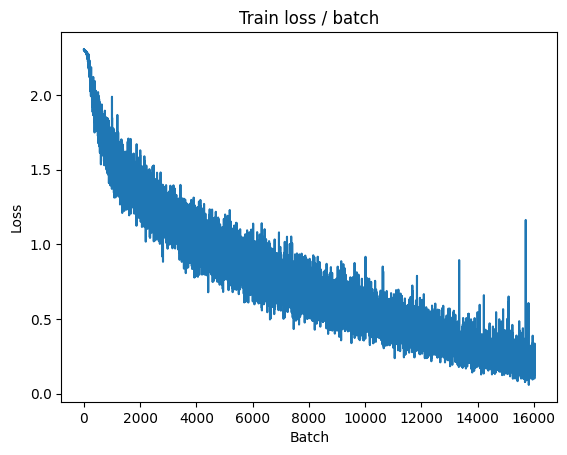

[TRAIN Batch 200/391]	Time 0.014s (0.031s)	Loss 0.1813 (0.1597)	Prec@1  95.3 ( 95.1)	Prec@5 100.0 ( 99.9)


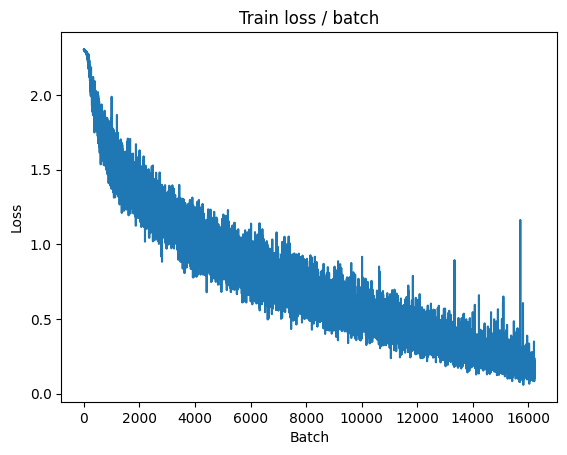


===============> Total time 12s	Avg loss 0.1649	Avg Prec@1 94.83 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 0.9222 (0.9222)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.2239	Avg Prec@1 71.32 %	Avg Prec@5 97.16 %



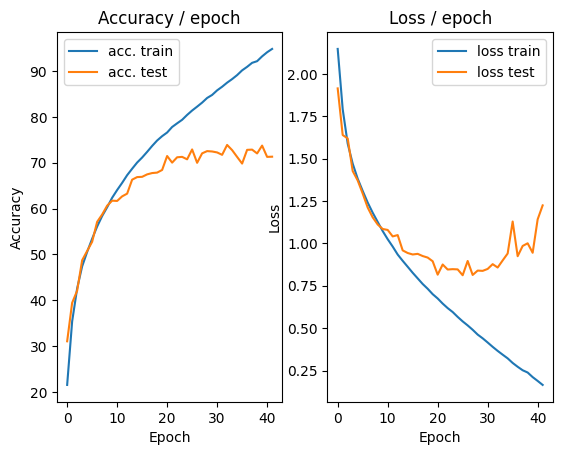

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.246s (0.246s)	Loss 0.3630 (0.3630)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


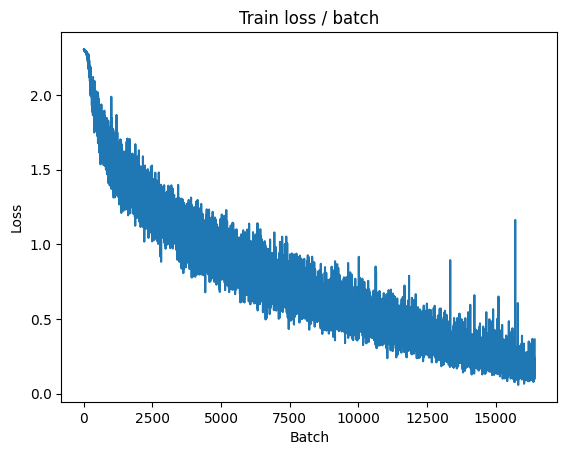

[TRAIN Batch 200/391]	Time 0.029s (0.031s)	Loss 0.1386 (0.1547)	Prec@1  98.4 ( 95.5)	Prec@5  99.2 ( 99.9)


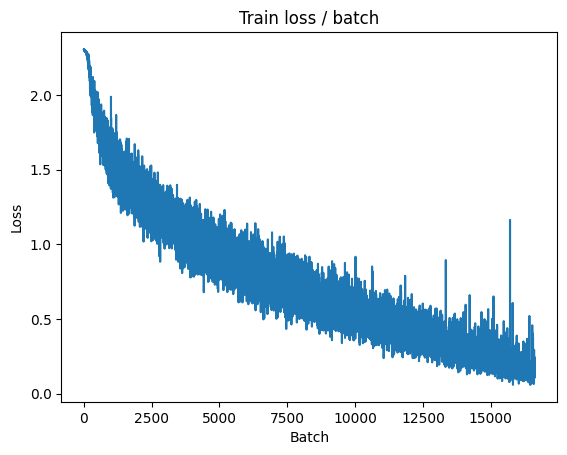


===============> Total time 12s	Avg loss 0.1576	Avg Prec@1 95.24 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.9114 (0.9114)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.0723	Avg Prec@1 73.33 %	Avg Prec@5 97.69 %



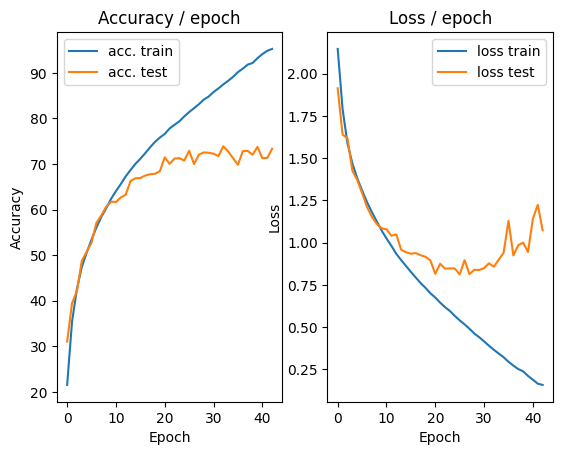

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.226s (0.226s)	Loss 0.1147 (0.1147)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


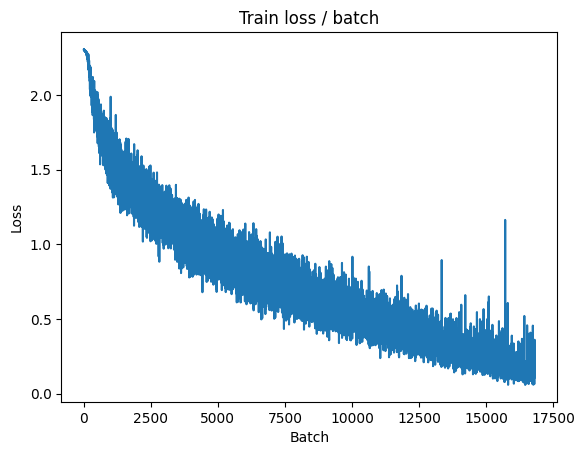

[TRAIN Batch 200/391]	Time 0.068s (0.034s)	Loss 0.0996 (0.1223)	Prec@1  97.7 ( 96.5)	Prec@5 100.0 (100.0)


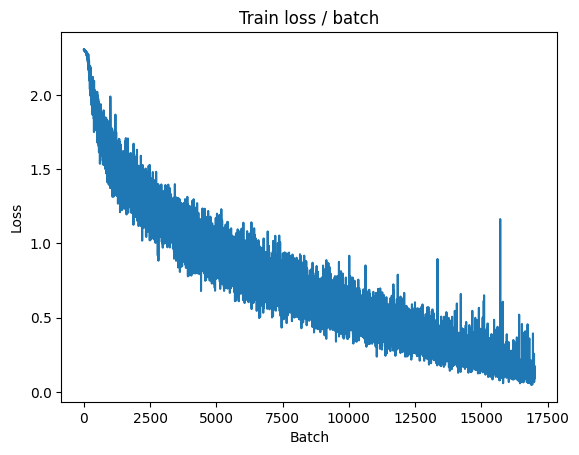


===============> Total time 12s	Avg loss 0.1421	Avg Prec@1 95.84 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.8967 (0.8967)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.1020	Avg Prec@1 73.03 %	Avg Prec@5 97.59 %



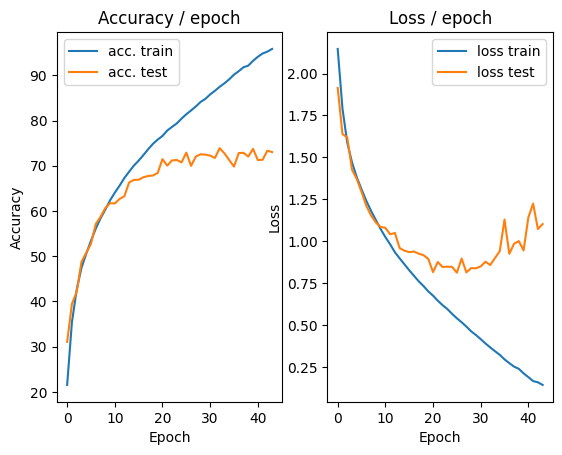

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.183s (0.183s)	Loss 0.1386 (0.1386)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


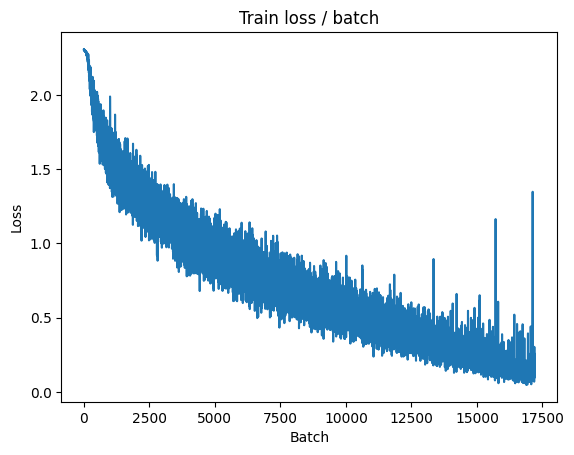

[TRAIN Batch 200/391]	Time 0.038s (0.036s)	Loss 0.0731 (0.1042)	Prec@1  99.2 ( 97.3)	Prec@5 100.0 (100.0)


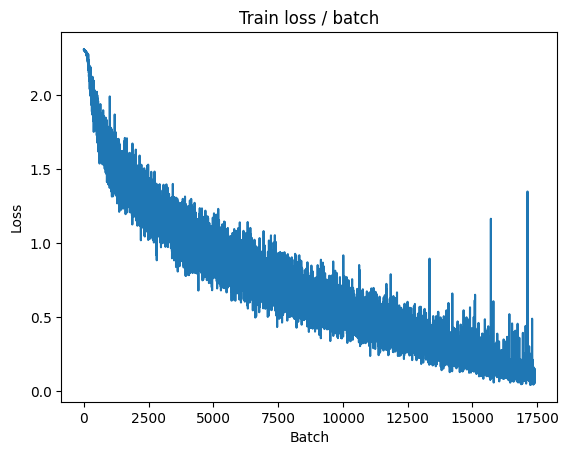


===============> Total time 12s	Avg loss 0.1173	Avg Prec@1 96.73 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 0.9170 (0.9170)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.1539	Avg Prec@1 72.48 %	Avg Prec@5 98.07 %



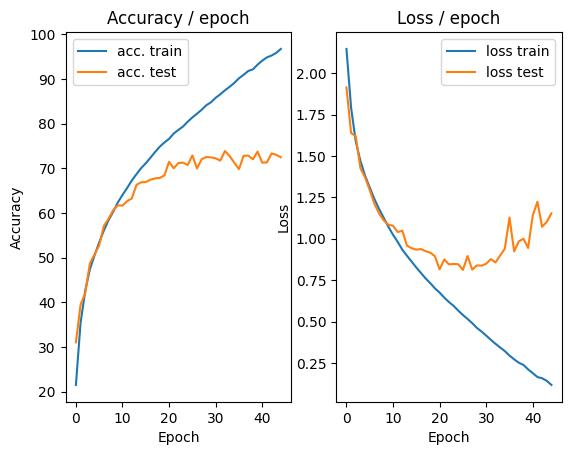

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.287s (0.287s)	Loss 0.1475 (0.1475)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


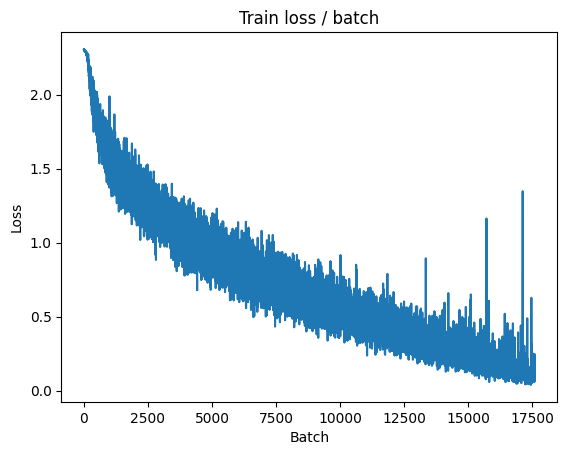

[TRAIN Batch 200/391]	Time 0.050s (0.035s)	Loss 0.1349 (0.0942)	Prec@1  94.5 ( 97.7)	Prec@5 100.0 (100.0)


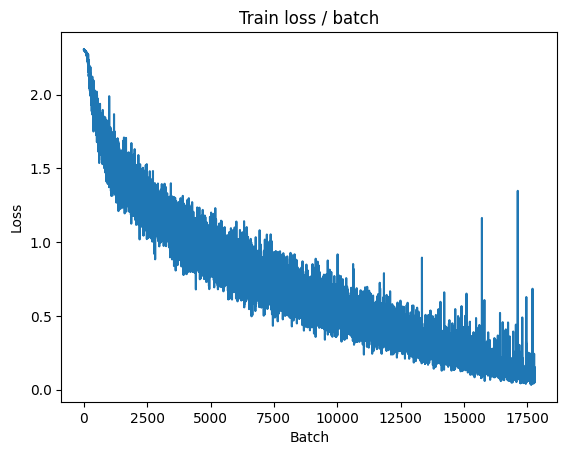


===============> Total time 12s	Avg loss 0.1112	Avg Prec@1 97.09 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.233s (0.233s)	Loss 0.9389 (0.9389)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 1.1320	Avg Prec@1 74.18 %	Avg Prec@5 98.14 %



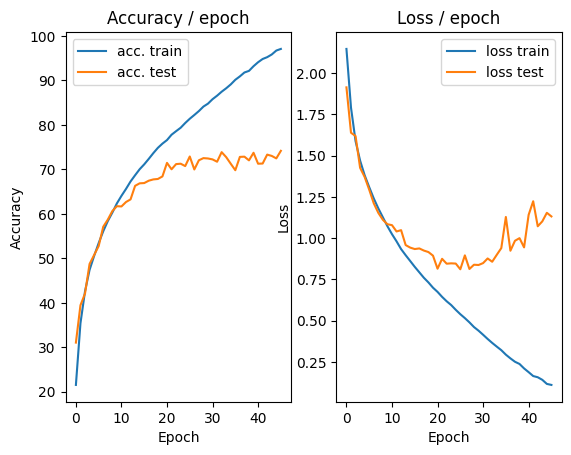

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.252s (0.252s)	Loss 0.0517 (0.0517)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


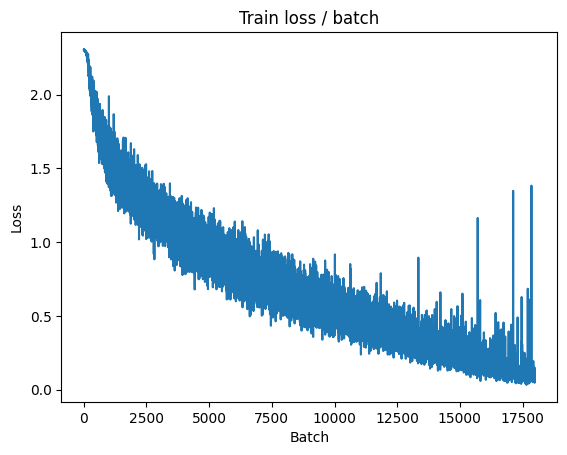

[TRAIN Batch 200/391]	Time 0.011s (0.031s)	Loss 0.0959 (0.1145)	Prec@1  96.9 ( 97.6)	Prec@5 100.0 ( 99.9)


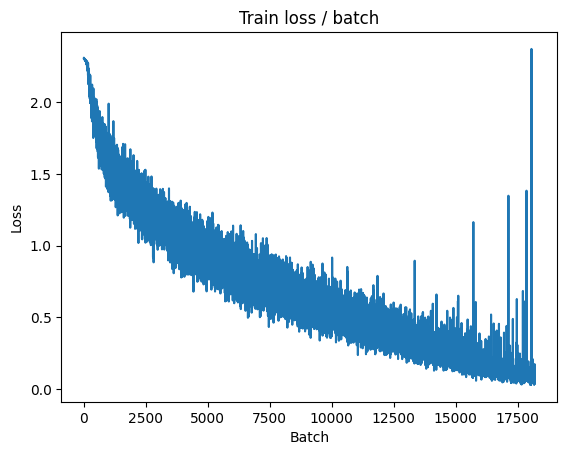


===============> Total time 13s	Avg loss 0.1064	Avg Prec@1 97.46 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.9379 (0.9379)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 1.1210	Avg Prec@1 73.04 %	Avg Prec@5 98.01 %



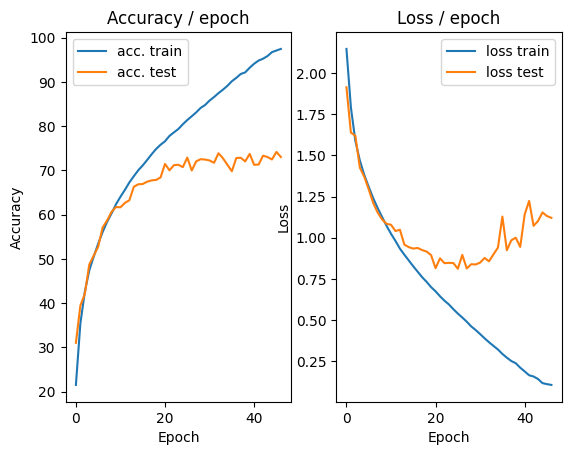

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 0.0682 (0.0682)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


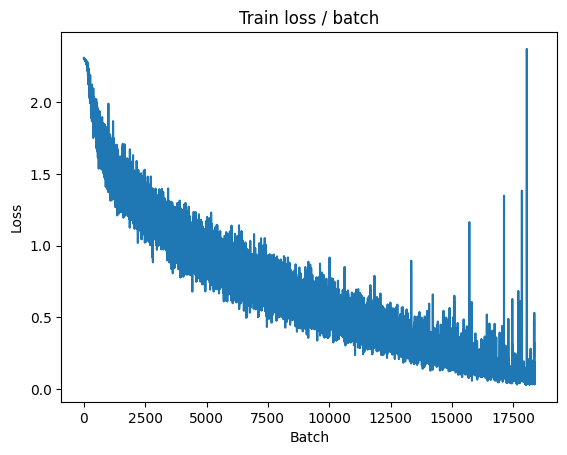

[TRAIN Batch 200/391]	Time 0.064s (0.031s)	Loss 0.0434 (0.0699)	Prec@1  99.2 ( 98.7)	Prec@5 100.0 (100.0)


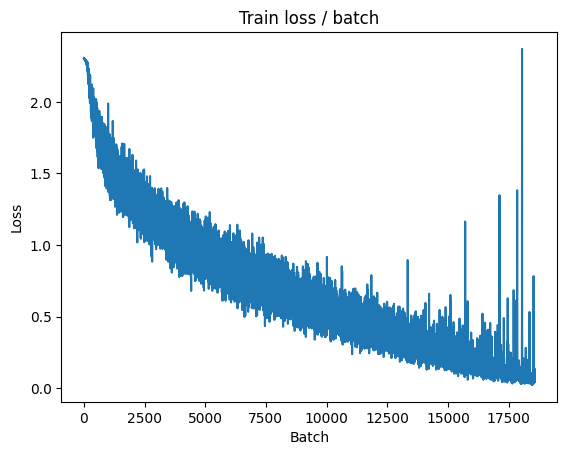


===============> Total time 12s	Avg loss 0.1078	Avg Prec@1 97.66 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 0.9748 (0.9748)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.0550	Avg Prec@1 72.84 %	Avg Prec@5 97.85 %



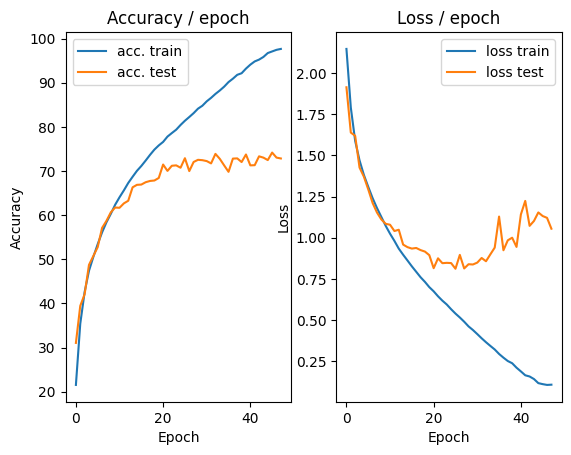

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.234s (0.234s)	Loss 0.1651 (0.1651)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


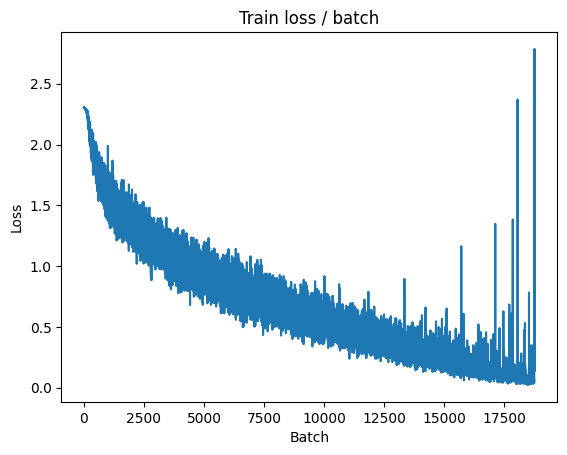

[TRAIN Batch 200/391]	Time 0.009s (0.036s)	Loss 0.0301 (0.0674)	Prec@1 100.0 ( 98.7)	Prec@5 100.0 (100.0)


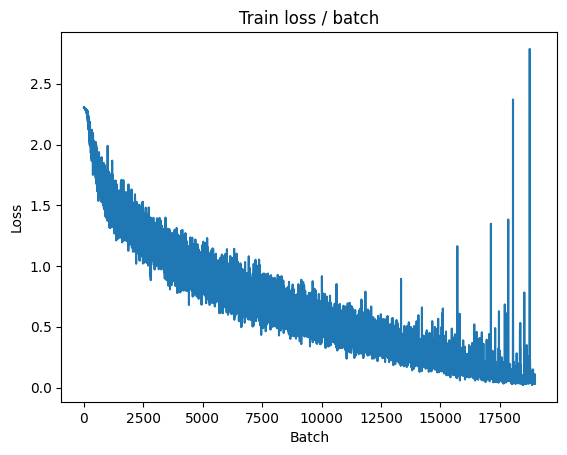


===============> Total time 12s	Avg loss 0.0640	Avg Prec@1 98.69 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 0.9901 (0.9901)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.1899	Avg Prec@1 74.08 %	Avg Prec@5 98.23 %



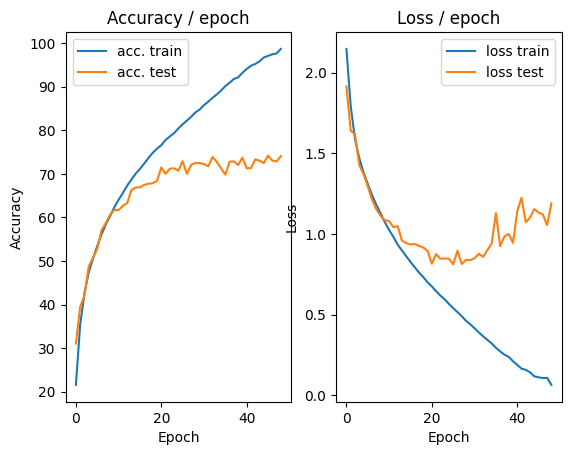

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.254s (0.254s)	Loss 0.0788 (0.0788)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


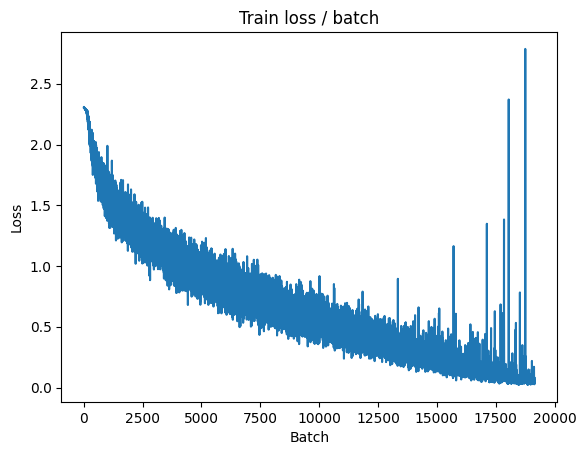

[TRAIN Batch 200/391]	Time 0.014s (0.036s)	Loss 0.0189 (0.0369)	Prec@1 100.0 ( 99.6)	Prec@5 100.0 (100.0)


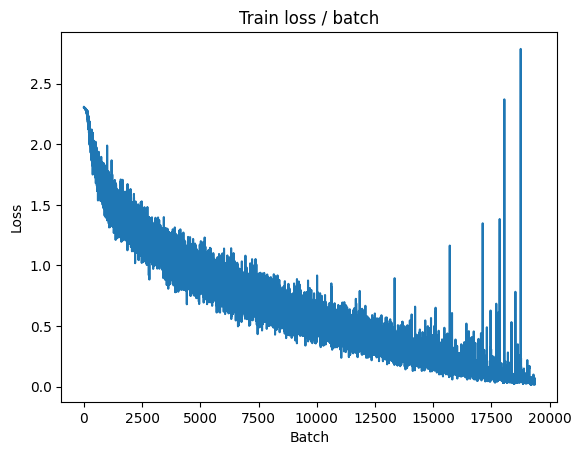


===============> Total time 12s	Avg loss 0.0378	Avg Prec@1 99.48 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 1.0908 (1.0908)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 1.2822	Avg Prec@1 73.80 %	Avg Prec@5 98.15 %



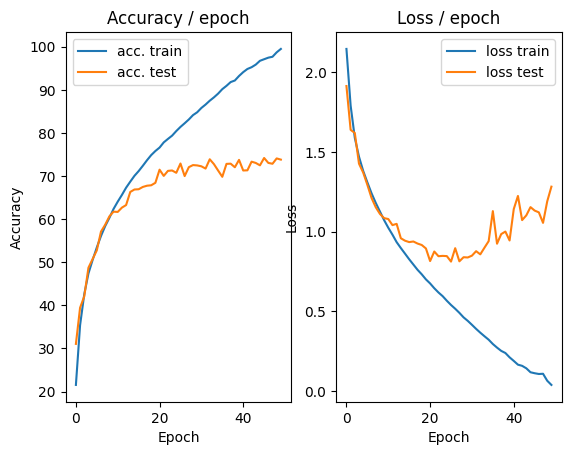

=== EPOCH 51 =====

[TRAIN Batch 000/391]	Time 0.236s (0.236s)	Loss 0.0484 (0.0484)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


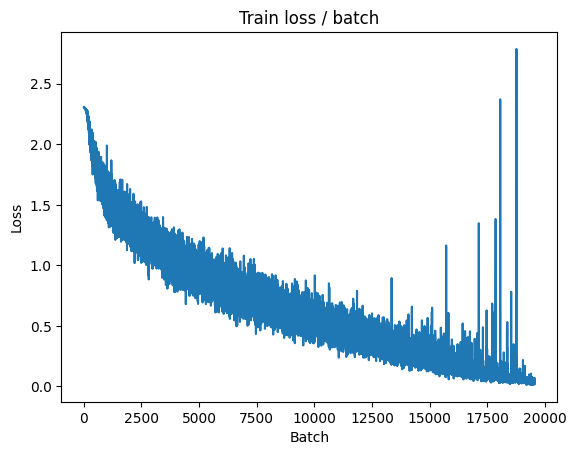

[TRAIN Batch 200/391]	Time 0.015s (0.032s)	Loss 0.0179 (0.0267)	Prec@1 100.0 ( 99.8)	Prec@5 100.0 (100.0)


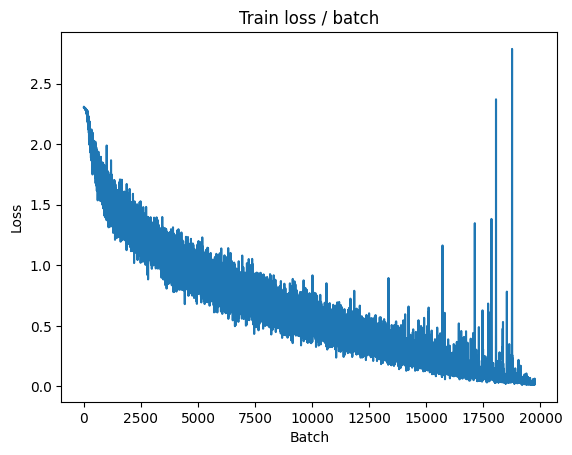


===============> Total time 13s	Avg loss 0.0290	Avg Prec@1 99.69 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 1.0014 (1.0014)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 1.2829	Avg Prec@1 74.40 %	Avg Prec@5 98.07 %



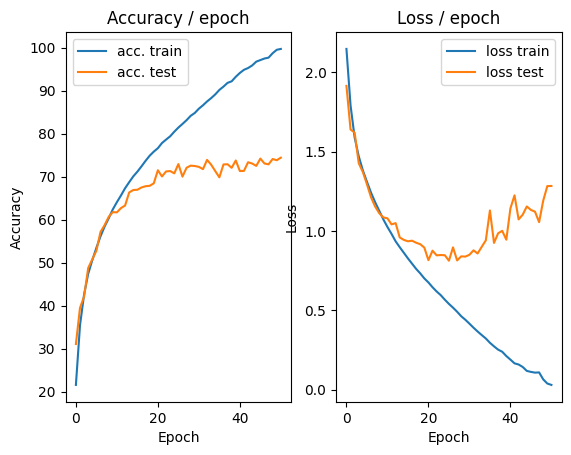

=== EPOCH 52 =====

[TRAIN Batch 000/391]	Time 0.202s (0.202s)	Loss 0.0307 (0.0307)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


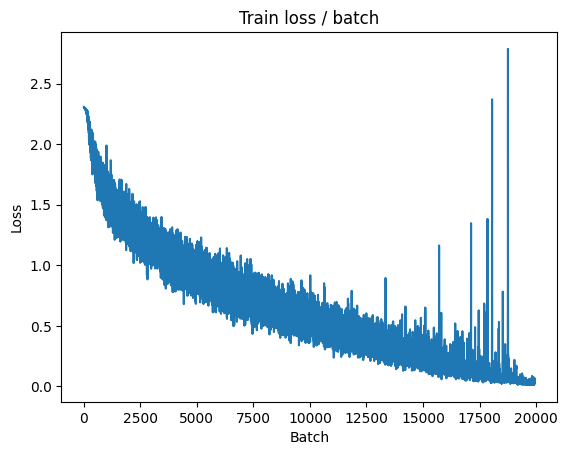

[TRAIN Batch 200/391]	Time 0.057s (0.031s)	Loss 0.0364 (0.0225)	Prec@1  99.2 ( 99.9)	Prec@5 100.0 (100.0)


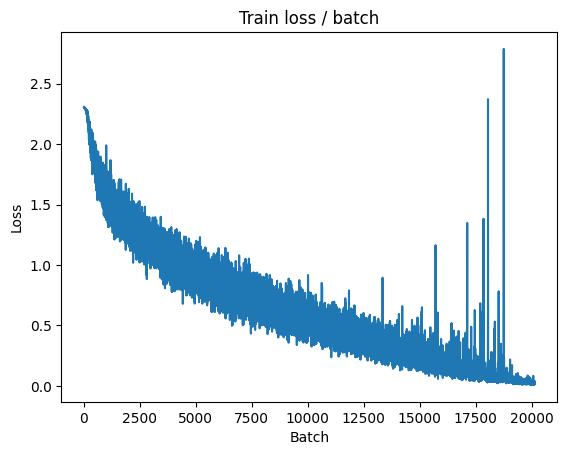


===============> Total time 12s	Avg loss 0.0694	Avg Prec@1 98.80 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.128s (0.128s)	Loss 1.0128 (1.0128)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.2192	Avg Prec@1 74.10 %	Avg Prec@5 98.07 %



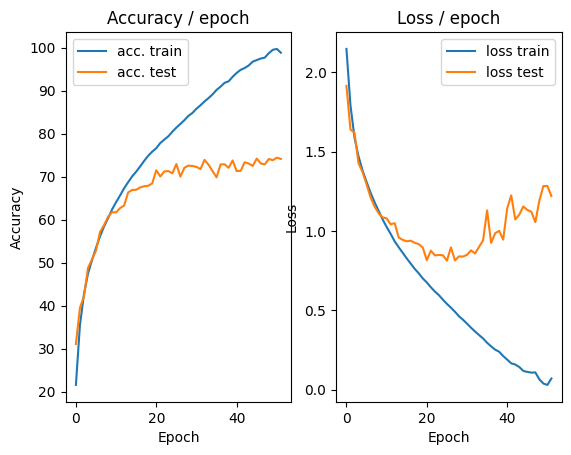

=== EPOCH 53 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 0.0512 (0.0512)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


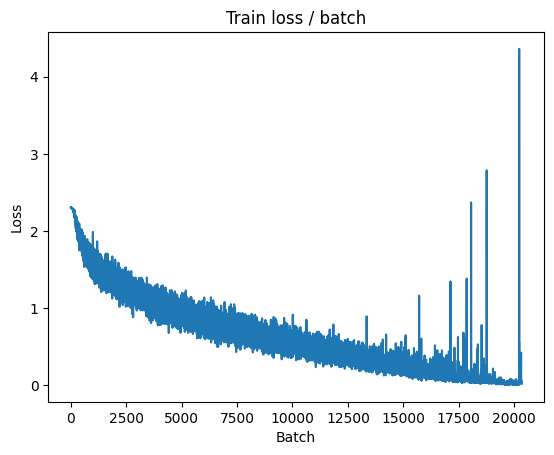

[TRAIN Batch 200/391]	Time 0.030s (0.035s)	Loss 0.0253 (0.0252)	Prec@1 100.0 ( 99.8)	Prec@5 100.0 (100.0)


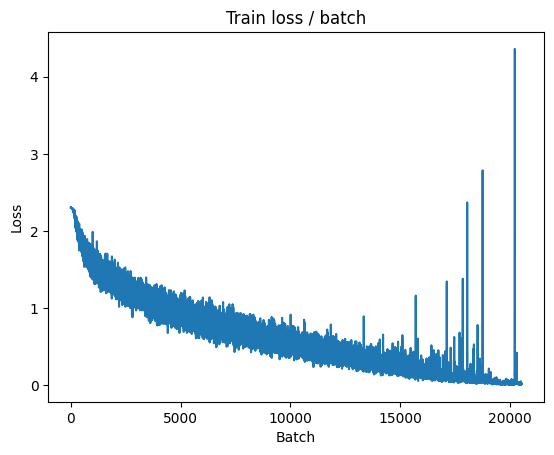


===============> Total time 12s	Avg loss 0.0239	Avg Prec@1 99.85 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 1.1123 (1.1123)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.3145	Avg Prec@1 74.45 %	Avg Prec@5 98.11 %



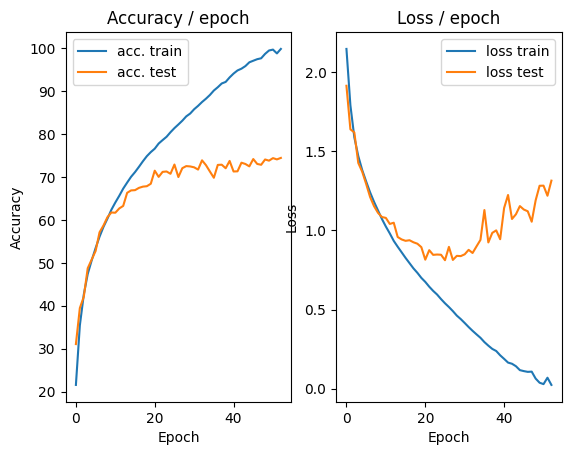

=== EPOCH 54 =====

[TRAIN Batch 000/391]	Time 0.168s (0.168s)	Loss 0.0113 (0.0113)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


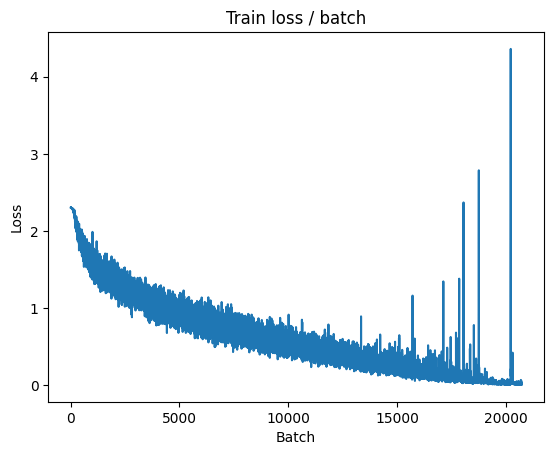

[TRAIN Batch 200/391]	Time 0.017s (0.035s)	Loss 0.0118 (0.0155)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


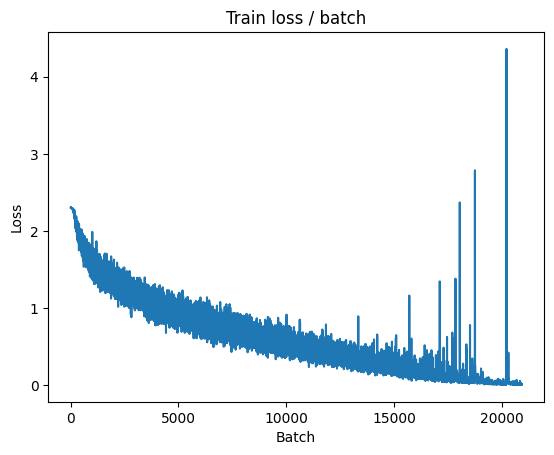


===============> Total time 12s	Avg loss 0.0161	Avg Prec@1 99.94 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 1.0560 (1.0560)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.3604	Avg Prec@1 74.34 %	Avg Prec@5 98.21 %



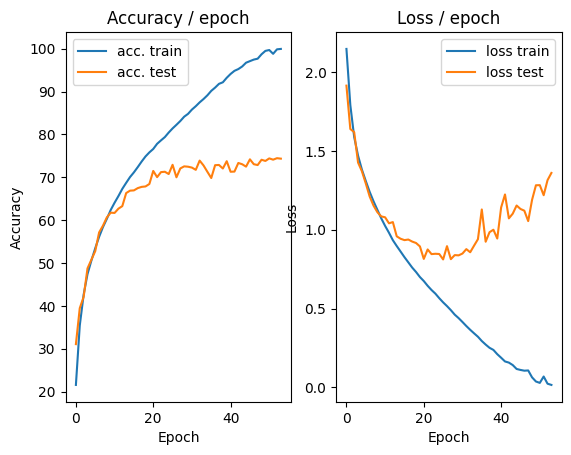

=== EPOCH 55 =====

[TRAIN Batch 000/391]	Time 0.317s (0.317s)	Loss 0.0064 (0.0064)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


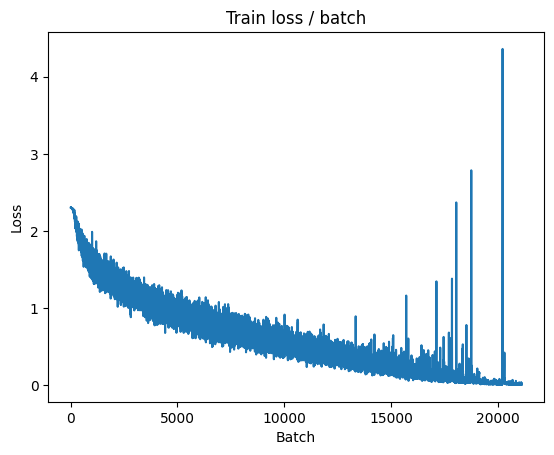

[TRAIN Batch 200/391]	Time 0.065s (0.032s)	Loss 0.0113 (0.0125)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


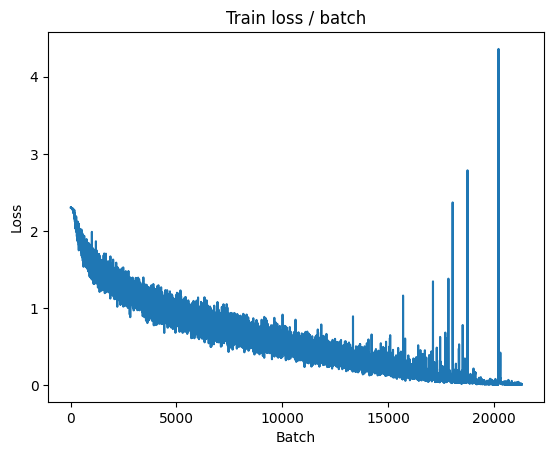


===============> Total time 12s	Avg loss 0.0130	Avg Prec@1 99.97 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.243s (0.243s)	Loss 1.1020 (1.1020)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.3927	Avg Prec@1 74.35 %	Avg Prec@5 98.18 %



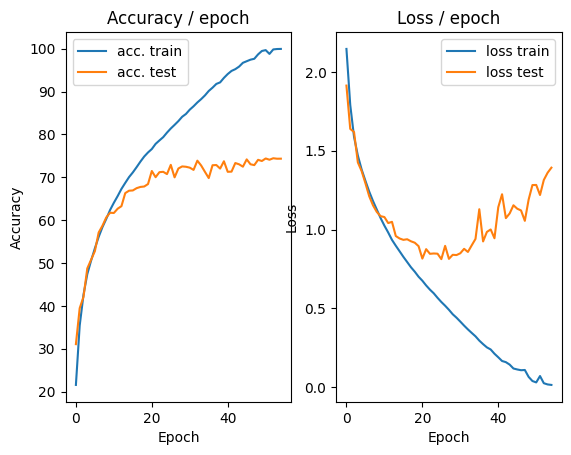

=== EPOCH 56 =====

[TRAIN Batch 000/391]	Time 0.243s (0.243s)	Loss 0.0082 (0.0082)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


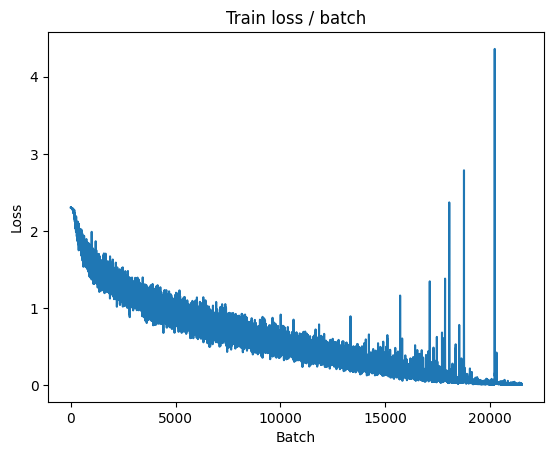

[TRAIN Batch 200/391]	Time 0.011s (0.031s)	Loss 0.0090 (0.0105)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


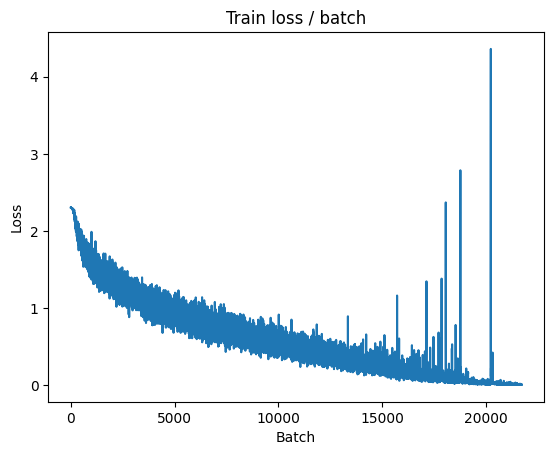


===============> Total time 12s	Avg loss 0.0106	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 1.1490 (1.1490)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 1.4292	Avg Prec@1 74.60 %	Avg Prec@5 98.17 %



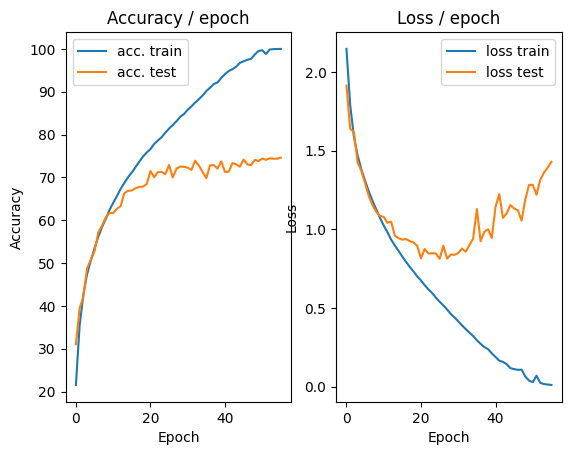

=== EPOCH 57 =====

[TRAIN Batch 000/391]	Time 0.251s (0.251s)	Loss 0.0106 (0.0106)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


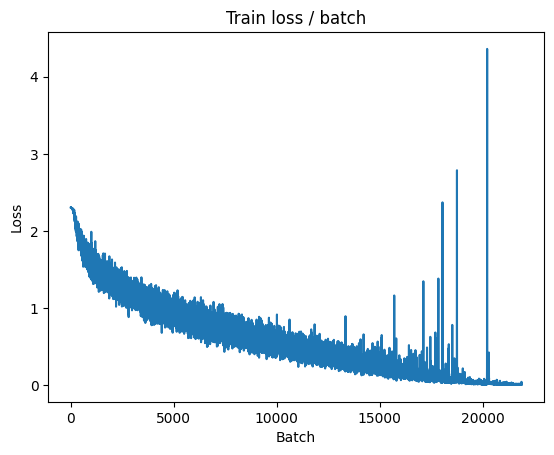

[TRAIN Batch 200/391]	Time 0.076s (0.032s)	Loss 0.0070 (0.0092)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


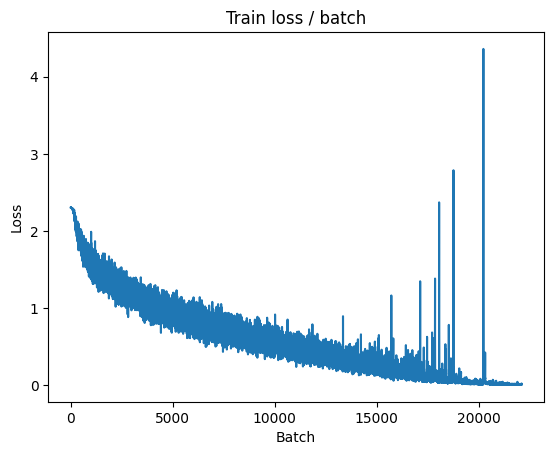


===============> Total time 12s	Avg loss 0.0092	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.131s (0.131s)	Loss 1.1687 (1.1687)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.4516	Avg Prec@1 74.52 %	Avg Prec@5 98.16 %



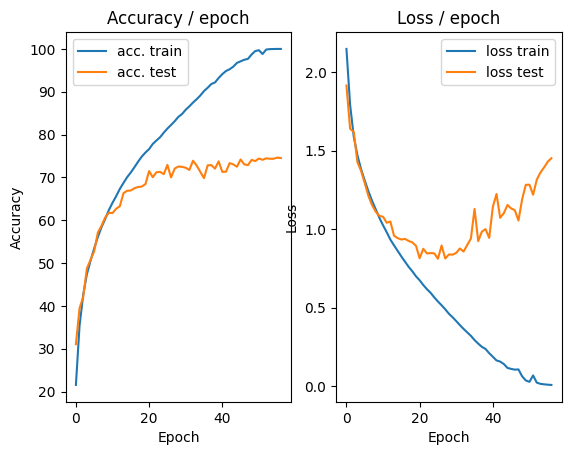

=== EPOCH 58 =====

[TRAIN Batch 000/391]	Time 0.218s (0.218s)	Loss 0.0087 (0.0087)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


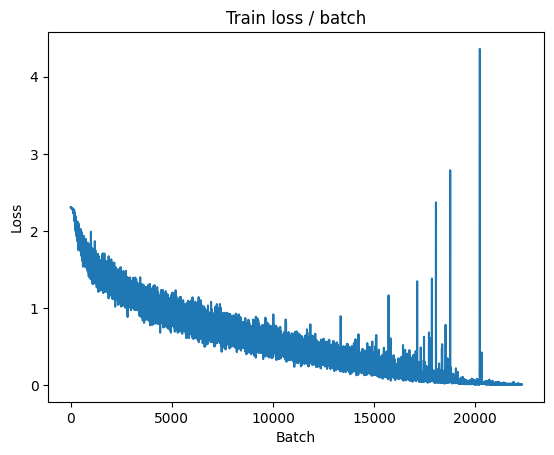

[TRAIN Batch 200/391]	Time 0.013s (0.035s)	Loss 0.0081 (0.0077)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


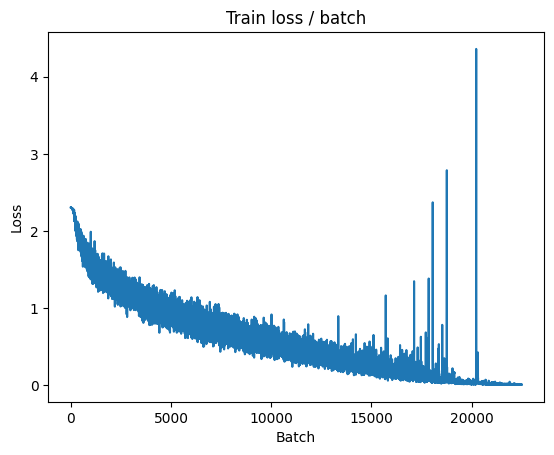


===============> Total time 12s	Avg loss 0.0079	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 1.1918 (1.1918)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 1.4812	Avg Prec@1 74.61 %	Avg Prec@5 98.13 %



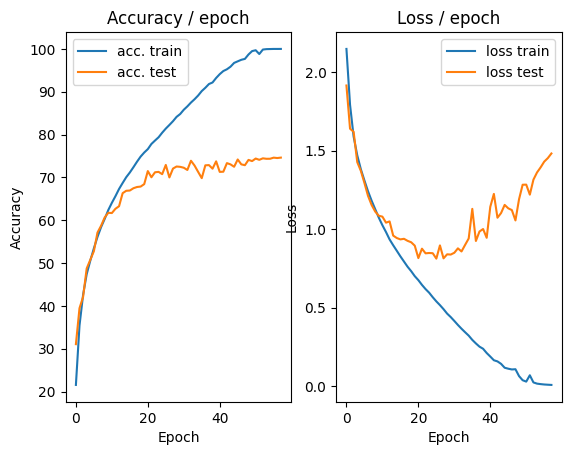

=== EPOCH 59 =====

[TRAIN Batch 000/391]	Time 0.157s (0.157s)	Loss 0.0065 (0.0065)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


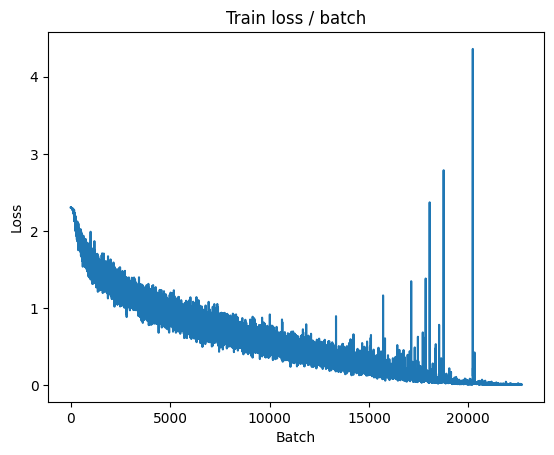

[TRAIN Batch 200/391]	Time 0.040s (0.035s)	Loss 0.0063 (0.0069)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


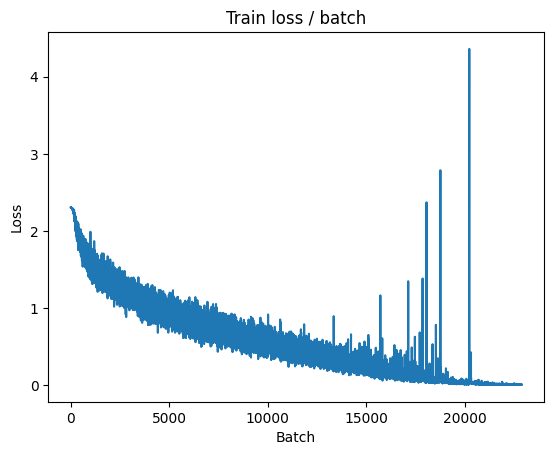


===============> Total time 12s	Avg loss 0.0070	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 1.2351 (1.2351)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 1.5007	Avg Prec@1 74.54 %	Avg Prec@5 98.13 %



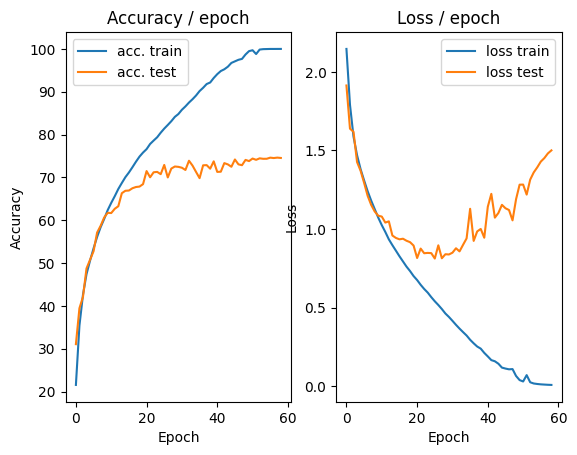

=== EPOCH 60 =====

[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 0.0062 (0.0062)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


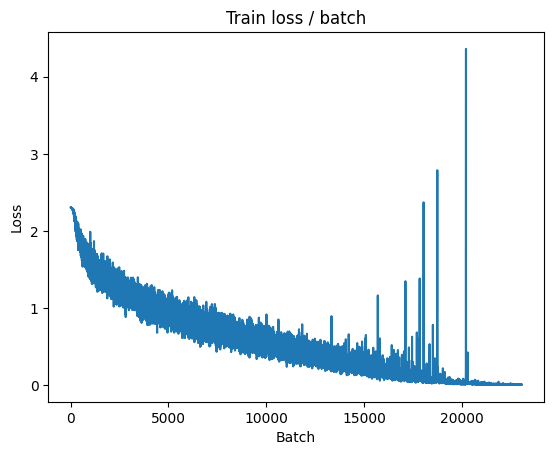

[TRAIN Batch 200/391]	Time 0.047s (0.030s)	Loss 0.0074 (0.0061)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


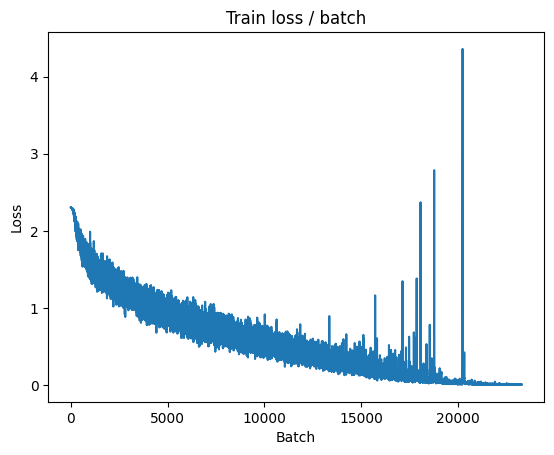


===============> Total time 12s	Avg loss 0.0062	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.125s (0.125s)	Loss 1.2154 (1.2154)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 1.5182	Avg Prec@1 74.67 %	Avg Prec@5 98.12 %



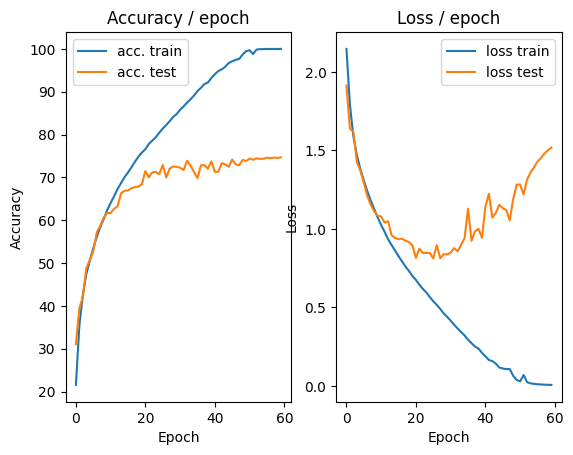

=== EPOCH 61 =====

[TRAIN Batch 000/391]	Time 0.235s (0.235s)	Loss 0.0070 (0.0070)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


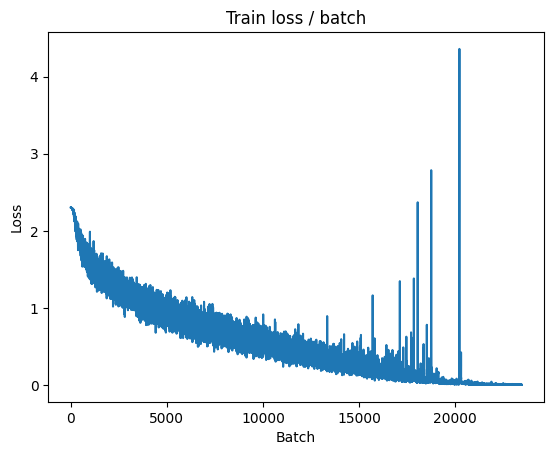

[TRAIN Batch 200/391]	Time 0.010s (0.031s)	Loss 0.0038 (0.0056)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


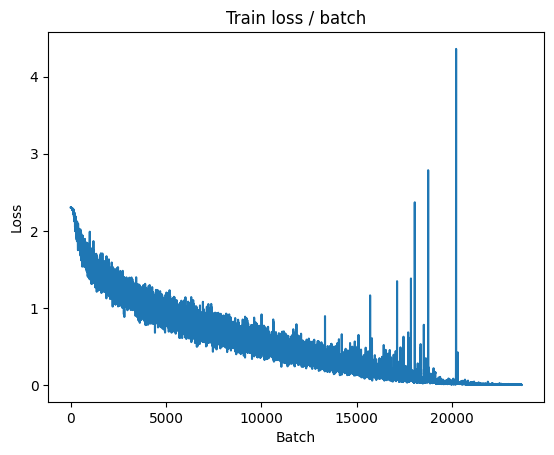


===============> Total time 12s	Avg loss 0.0056	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 1.2440 (1.2440)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 1.5446	Avg Prec@1 74.49 %	Avg Prec@5 98.20 %



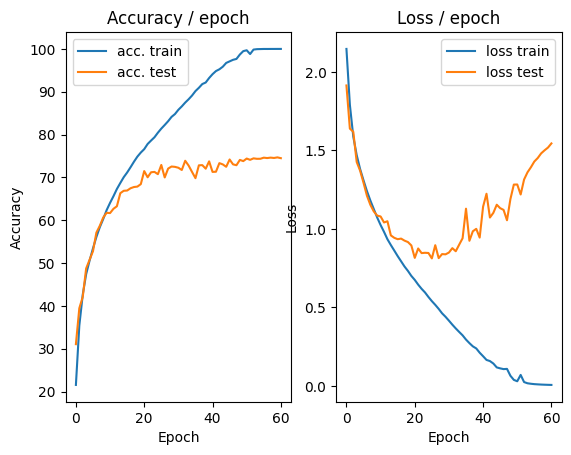

=== EPOCH 62 =====

[TRAIN Batch 000/391]	Time 0.257s (0.257s)	Loss 0.0057 (0.0057)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


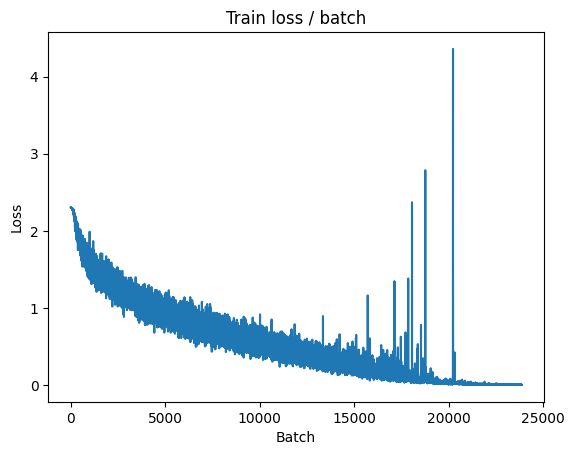

[TRAIN Batch 200/391]	Time 0.078s (0.033s)	Loss 0.0046 (0.0049)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


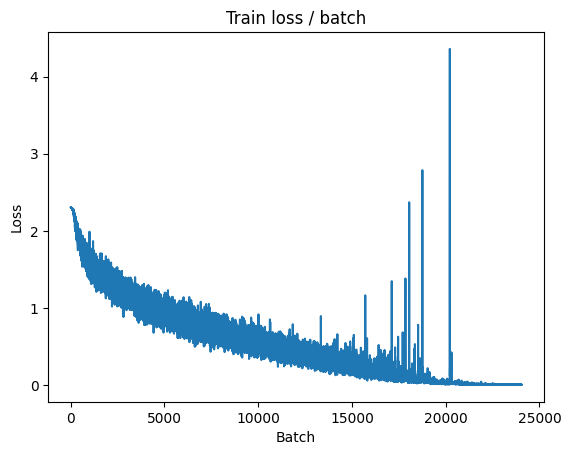


===============> Total time 12s	Avg loss 0.0051	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.201s (0.201s)	Loss 1.2710 (1.2710)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 1.5649	Avg Prec@1 74.38 %	Avg Prec@5 98.15 %



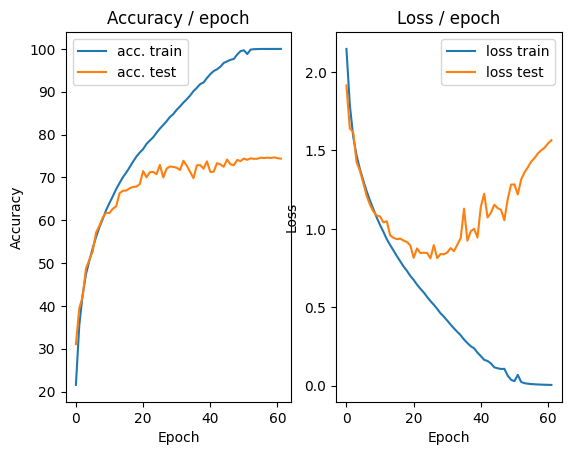

=== EPOCH 63 =====

[TRAIN Batch 000/391]	Time 0.166s (0.166s)	Loss 0.0065 (0.0065)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


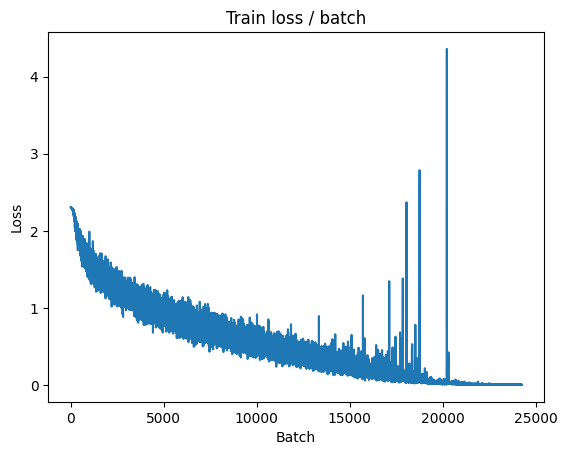

[TRAIN Batch 200/391]	Time 0.039s (0.036s)	Loss 0.0058 (0.0047)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


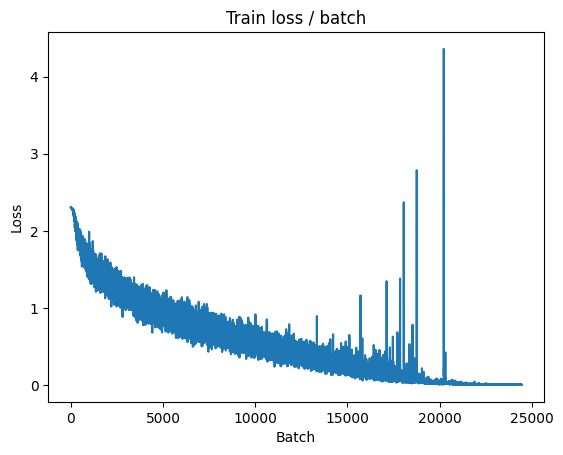


===============> Total time 12s	Avg loss 0.0047	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.130s (0.130s)	Loss 1.2524 (1.2524)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.5786	Avg Prec@1 74.79 %	Avg Prec@5 98.24 %



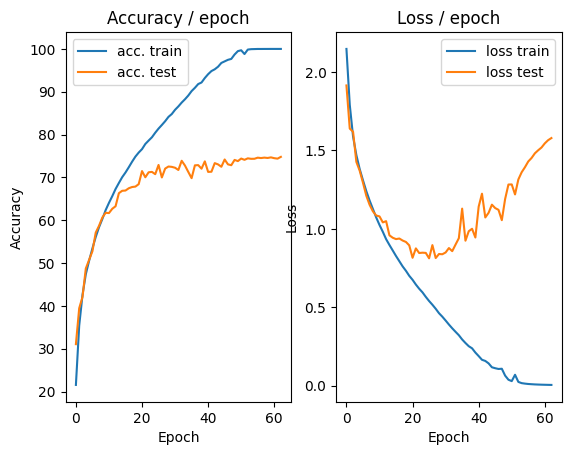

=== EPOCH 64 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 0.0028 (0.0028)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


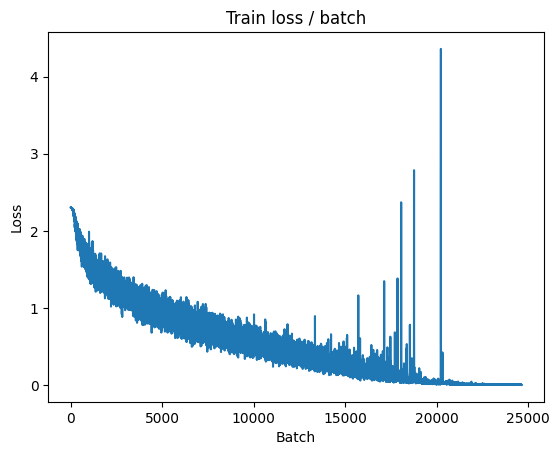

[TRAIN Batch 200/391]	Time 0.017s (0.035s)	Loss 0.0039 (0.0042)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


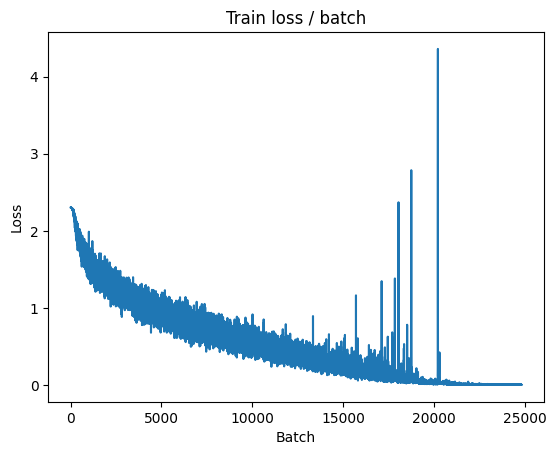


===============> Total time 12s	Avg loss 0.0043	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 1.3064 (1.3064)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 1.5929	Avg Prec@1 74.53 %	Avg Prec@5 98.10 %



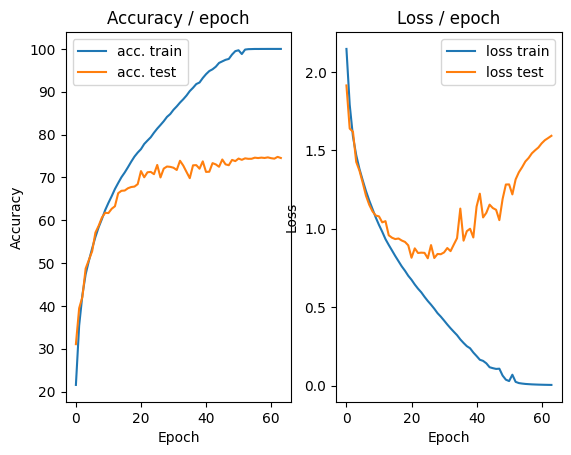

=== EPOCH 65 =====

[TRAIN Batch 000/391]	Time 0.232s (0.232s)	Loss 0.0034 (0.0034)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


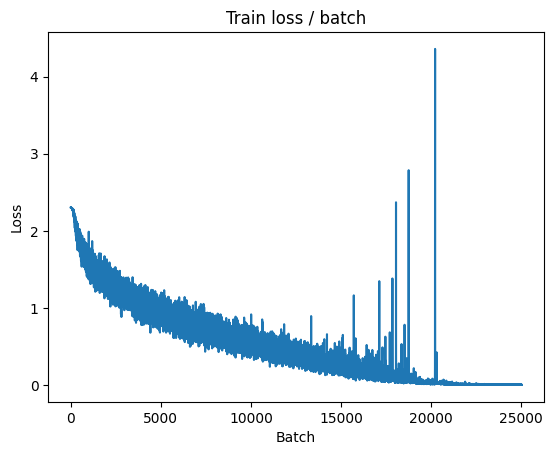

[TRAIN Batch 200/391]	Time 0.011s (0.031s)	Loss 0.0029 (0.0040)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


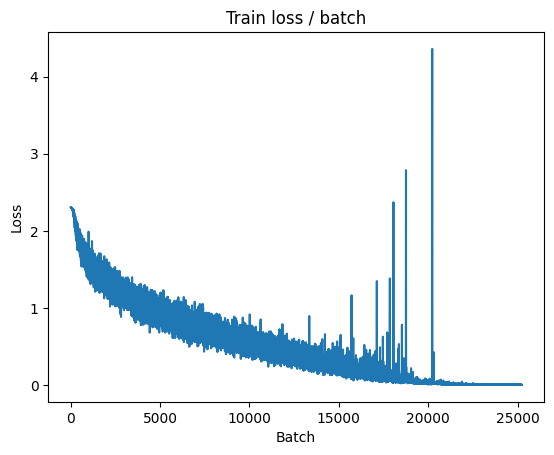


===============> Total time 12s	Avg loss 0.0040	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 1.3303 (1.3303)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 1.6109	Avg Prec@1 74.58 %	Avg Prec@5 98.17 %



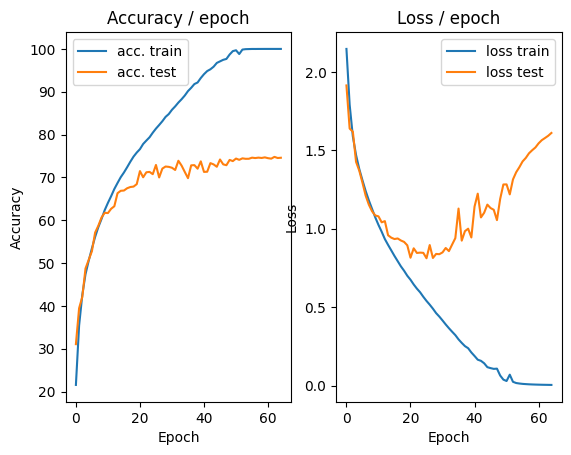

=== EPOCH 66 =====

[TRAIN Batch 000/391]	Time 0.247s (0.247s)	Loss 0.0036 (0.0036)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


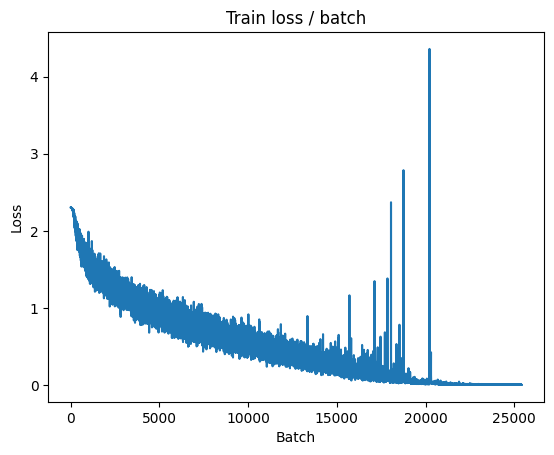

[TRAIN Batch 200/391]	Time 0.008s (0.031s)	Loss 0.0041 (0.0037)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


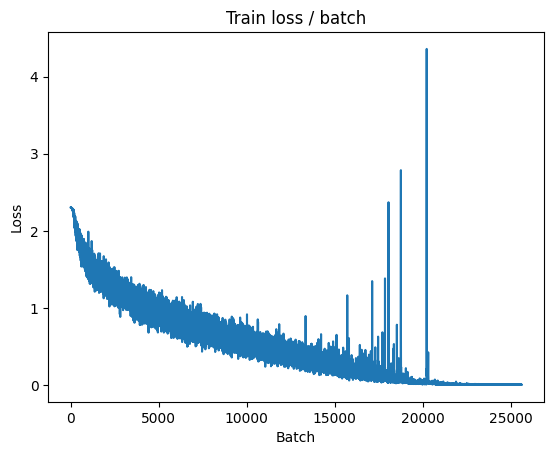


===============> Total time 13s	Avg loss 0.0038	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.130s (0.130s)	Loss 1.3035 (1.3035)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 1.6317	Avg Prec@1 74.55 %	Avg Prec@5 98.20 %



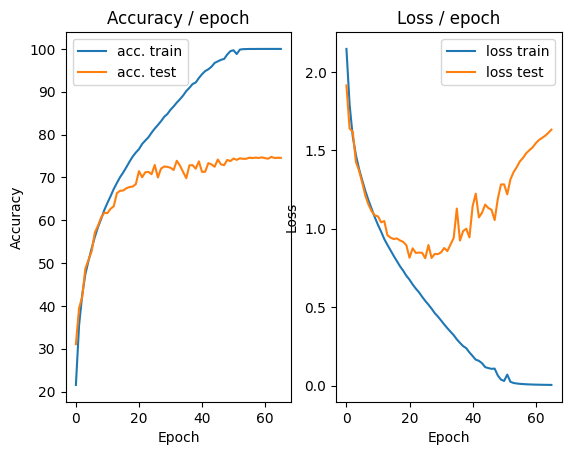

=== EPOCH 67 =====

[TRAIN Batch 000/391]	Time 0.248s (0.248s)	Loss 0.0036 (0.0036)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


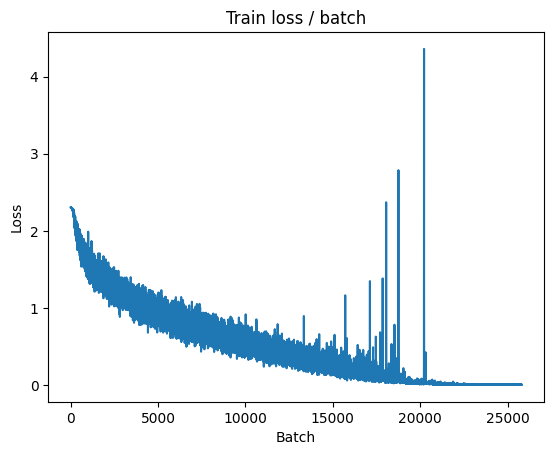

[TRAIN Batch 200/391]	Time 0.047s (0.036s)	Loss 0.0037 (0.0035)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


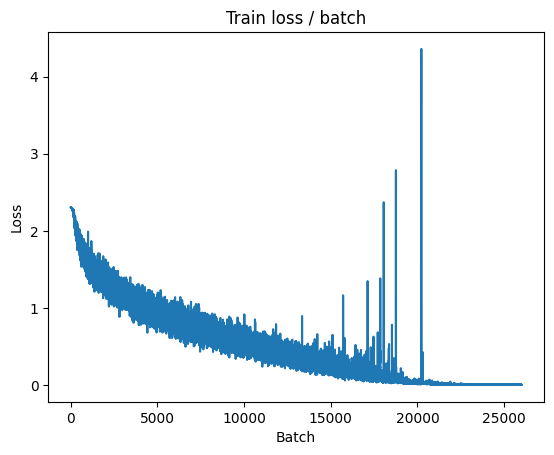


===============> Total time 12s	Avg loss 0.0035	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 1.3163 (1.3163)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 1.6459	Avg Prec@1 74.56 %	Avg Prec@5 98.17 %



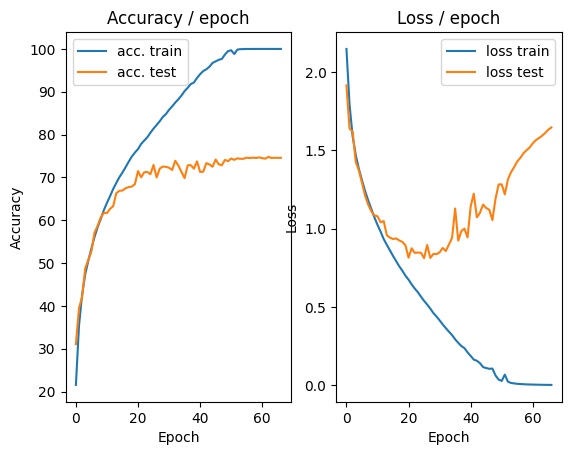

=== EPOCH 68 =====

[TRAIN Batch 000/391]	Time 0.222s (0.222s)	Loss 0.0041 (0.0041)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


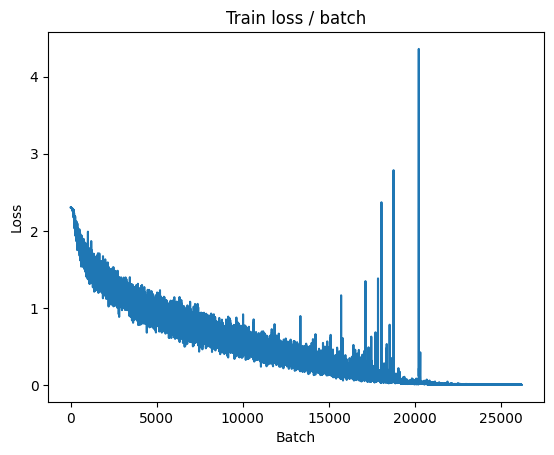

[TRAIN Batch 200/391]	Time 0.054s (0.035s)	Loss 0.0031 (0.0032)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


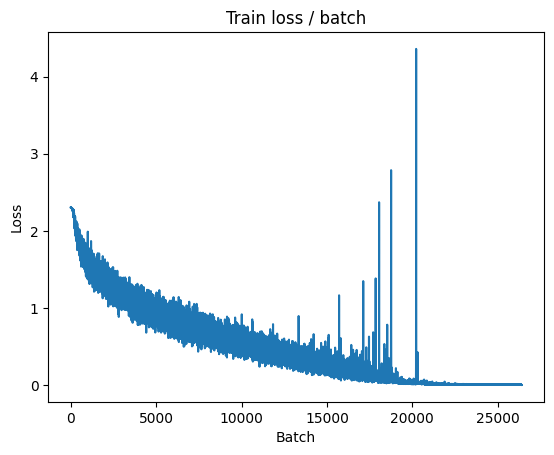


===============> Total time 12s	Avg loss 0.0033	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 1.3224 (1.3224)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 1.6537	Avg Prec@1 74.45 %	Avg Prec@5 98.11 %



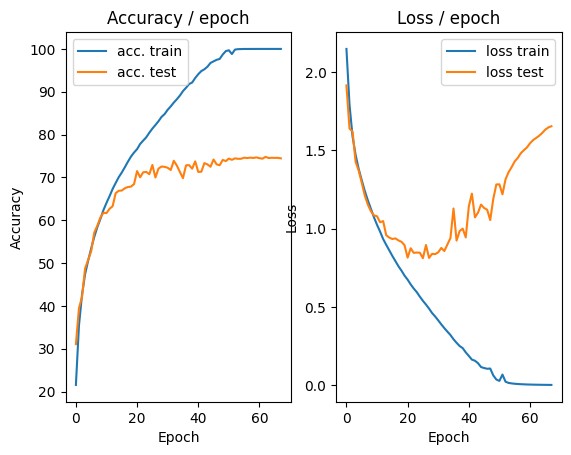

=== EPOCH 69 =====

[TRAIN Batch 000/391]	Time 0.294s (0.294s)	Loss 0.0030 (0.0030)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


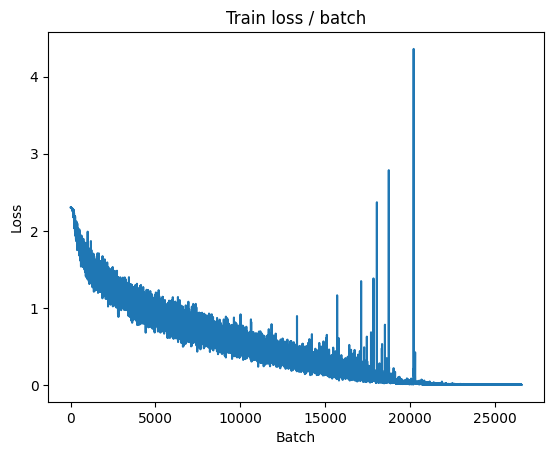

[TRAIN Batch 200/391]	Time 0.009s (0.031s)	Loss 0.0030 (0.0031)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


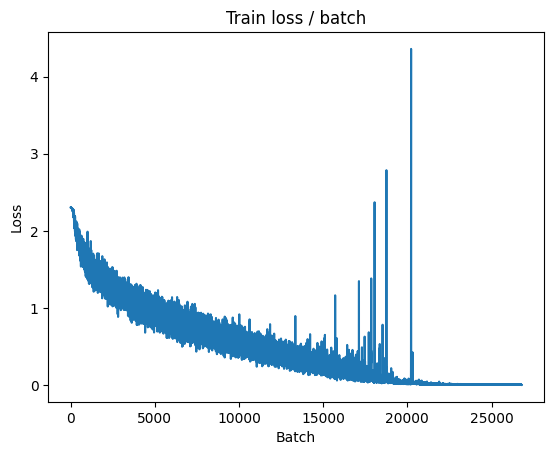


===============> Total time 12s	Avg loss 0.0031	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 1.3269 (1.3269)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 1.6700	Avg Prec@1 74.50 %	Avg Prec@5 98.12 %



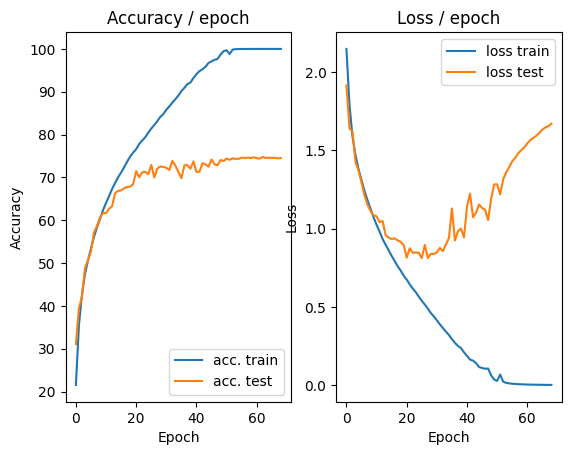

=== EPOCH 70 =====

[TRAIN Batch 000/391]	Time 0.231s (0.231s)	Loss 0.0032 (0.0032)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


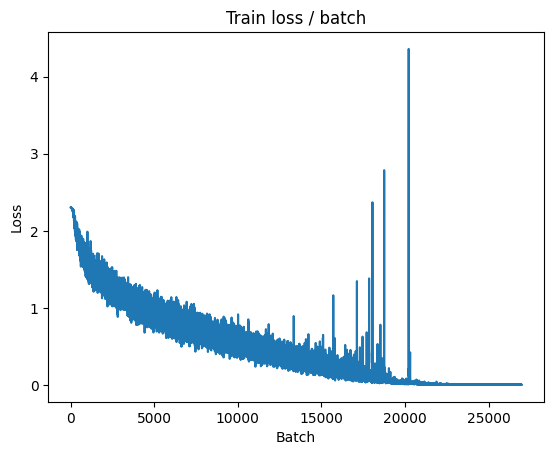

[TRAIN Batch 200/391]	Time 0.041s (0.031s)	Loss 0.0029 (0.0029)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


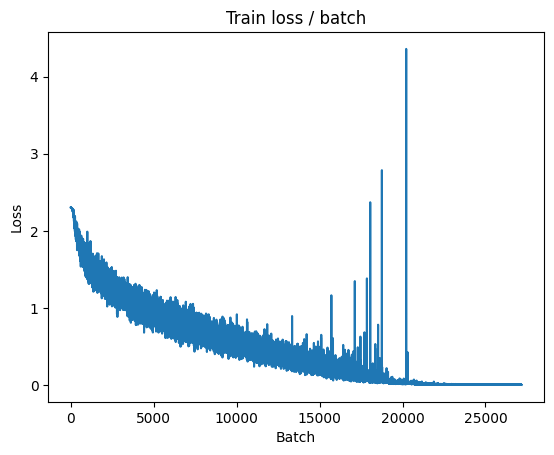


===============> Total time 12s	Avg loss 0.0029	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.166s (0.166s)	Loss 1.3509 (1.3509)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 1.6825	Avg Prec@1 74.67 %	Avg Prec@5 98.08 %



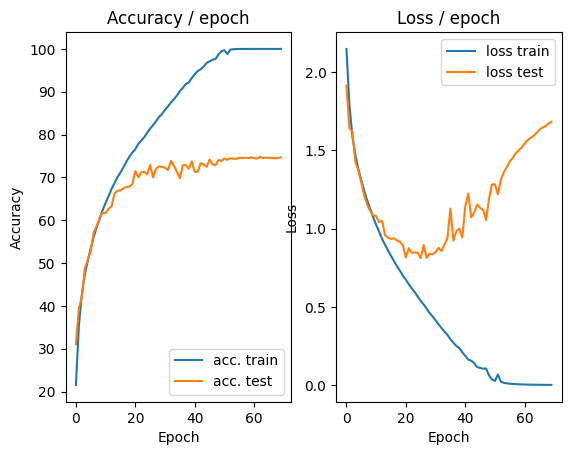

In [ ]:
main(128, 0.01, 70, cuda=True)